In [1]:
# in this notebook, I will try to fit a model relating the mean behavior of L4, L2/3, SST and VIP cells

In [2]:
# load the data

In [1]:
import pyute as ut
import autograd.numpy as np
import matplotlib.pyplot as plt
import sklearn
import h5py
import pdb
import scipy.optimize as sop
from mpl_toolkits.mplot3d import Axes3D
import sklearn.discriminant_analysis as skd
import autograd.scipy.special as ssp
from autograd import elementwise_grad as egrad
from autograd import grad
from autograd import jacobian
from autograd import hessian
import size_contrast_analysis as sca
import scipy.stats as sst
import sim_utils
from importlib import reload
reload(sim_utils)
import calnet.utils
import calnet.fitting_spatial_feature_opto
import opto_utils
import glob
import scipy.signal as ssi
import calnet.calnet as cc
import calnet.dynamics as dyn
%matplotlib notebook

/Users/dan/Documents/code/downloads/OASIS/oasis/functions.py:14: UserWarning: Could not find cvxpy. Don't worry, you can still use OASIS, just not the slower interior point methods we compared to in the papers.
  "just not the slower interior point methods we compared to in the papers.")


In [2]:
npfile = np.load('rs_vm_denoise_200605.npy',allow_pickle=True)[()]#,{'rs':rs,'rs_denoise':rs_denoise},allow_pickle=True)
rs = npfile['rs']
rs_denoise = npfile['rs_denoise']

In [3]:
nsize,ncontrast,ndir = 6,6,8
ori_dirs = [[0,1,2,3,4,5,6,7]]#[[0,4],[2,6]] #[[0,4],[1,3,5,7],[2,6]]
nT = len(ori_dirs)
nS = len(rs_denoise[0])

def sum_to_1(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nansum(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

def norm_to_mean(r):
    R = r.reshape((r.shape[0],-1))
    R = R/np.nanmean(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
    return R

Rs = [[None,None] for i in range(len(rs))]
Rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]
rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]

for iR,r in enumerate(rs):#_denoise):
    print(iR)
    for ialign in range(nS):
        Rs[iR][ialign] = sum_to_1(r[ialign][:,:nsize,:])
#         Rs[iR][ialign] = von_mises_denoise(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir)))

kernel = np.ones((1,2,2))
kernel = kernel/kernel.sum()

for iR,r in enumerate(rs):
    for ialign in range(nS):
        for iori in range(nT):
            Rso[iR][ialign][iori] = np.nanmean(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir))[:,:,:,ori_dirs[iori]],-1)
            Rso[iR][ialign][iori][:,:,0] = np.nanmean(Rso[iR][ialign][iori][:,:,0],1)[:,np.newaxis]
            Rso[iR][ialign][iori][:,1:,1:] = ssi.convolve(Rso[iR][ialign][iori],kernel,'valid')
            Rso[iR][ialign][iori] = Rso[iR][ialign][iori].reshape(Rso[iR][ialign][iori].shape[0],-1)

0
1
2
3
4


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


In [4]:
npyfile = np.load('data/celltype_rate_summary_exptwise_200828.npy',allow_pickle=True)[()]
rs = npyfile['rs']
rs_sem = npyfile['rs_sem']
roi_ids = npyfile['roi_ids']
expt_ids = npyfile['expt_ids']

reload(opto_utils)
rso = [None for irun in range(2)]
rso_sem = [None for irun in range(2)]
for irun in range(2):
    rso[irun] = [None for icelltype in range(len(rs[irun]))]
    rso_sem[irun] = [None for icelltype in range(len(rs_sem[irun]))]
    for icelltype in range(len(rs[irun])):
        if not rs[irun][icelltype][0] is None or not rs[irun][icelltype][1] is None:
            rso[irun][icelltype],rso_sem[irun][icelltype] = opto_utils.sort_both_by_pref_dir(rs[irun][icelltype].copy(),rs_sem[irun][icelltype].copy())
            for ialign in range(2):
                these_expt_ids = expt_ids[irun][icelltype][ialign]
                for expt_id in np.unique(these_expt_ids):
                    mn = np.nanmean(rso[irun][icelltype][ialign][these_expt_ids==expt_id])
                    rso[irun][icelltype][ialign][these_expt_ids==expt_id] = rso[irun][icelltype][ialign][these_expt_ids==expt_id]/mn
                    rso_sem[irun][icelltype][ialign][these_expt_ids==expt_id] = rso_sem[irun][icelltype][ialign][these_expt_ids==expt_id]/mn

rsexpt = [None for irun in range(2)]
rsexpt_sem = [None for irun in range(2)]
for irun in range(2):
    rsexpt[irun] = [None for itype in range(len(rso[irun]))]
    rsexpt_sem[irun] = [None for itype in range(len(rso[irun]))]
    for itype in range(len(rsexpt[irun])):
        rsexpt[irun][itype] = [None for ialign in range(len(rso[irun][itype]))]
        rsexpt_sem[irun][itype] = [None for ialign in range(len(rso[irun][itype]))]
        for ialign in range(len(rsexpt[irun][itype])):
            if not rso[irun][itype][ialign] is None:
                this_nexpt = int(expt_ids[irun][itype][ialign].max()+1)
                that_nexpt = int(expt_ids[1-irun][itype][ialign].max()+1)
                and_nexpt = int(expt_ids[irun][itype][1-ialign].max()+1)
                the_other_nexpt = int(expt_ids[1-irun][itype][1-ialign].max()+1)
                nexpt = np.max(np.array((this_nexpt,that_nexpt,and_nexpt,the_other_nexpt)))
                rsexpt[irun][itype][ialign] = np.nan*np.ones((nexpt,)+rso[irun][itype][ialign].shape[1:])
                rsexpt_sem[irun][itype][ialign] = np.nan*np.ones((nexpt,)+rso[irun][itype][ialign].shape[1:])
                for iexpt in range(nexpt):
                    if np.any(expt_ids[irun][itype][ialign]==iexpt):
                        rsexpt[irun][itype][ialign][iexpt] = np.nanmean(rso[irun][itype][ialign][expt_ids[irun][itype][ialign]==iexpt],0)
                        rsexpt_sem[irun][itype][ialign][iexpt] = np.nanmean(rso_sem[irun][itype][ialign][expt_ids[irun][itype][ialign]==iexpt],0)

/Users/dan/Documents/code/adesnal/opto_utils.py:316: RuntimeWarning: Mean of empty slice
  rs_ori = np.nanmean(rs_ori,idim) #np.nanmean(rs_ori,1)
/Users/dan/Documents/code/adesnal/opto_utils.py:325: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  rs_sort[ir][iroi] = rs_sort[ir][iroi][slicer]
/Users/dan/Documents/code/adesnal/opto_utils.py:328: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  others_sort[iother][ir][iroi] = others_sort[iother][ir][iroi][other_slicers[iother]]
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.p

In [5]:
len(expt_ids)

2

In [9]:
nS = 2
nT = 1
ndims = 5
ncelltypes = 5
def compute_XY(Rso):
        Yhat = [[None for iT in range(nT)] for iS in range(nS)]
        Xhat = [[None for iT in range(nT)] for iS in range(nS)]
        Ypc_list = [[None for iT in range(nT)] for iS in range(nS)]
        Xpc_list = [[None for iT in range(nT)] for iS in range(nS)]
        for iS in range(nS):
                mx = np.zeros((ncelltypes,))
                yy = [None for icelltype in range(ncelltypes)]
                for icelltype in range(ncelltypes):
                        yy[icelltype] = np.nanmean(Rso[icelltype][iS][0],0)
                        mx[icelltype] = np.nanmax(yy[icelltype])
                for iT in range(nT):
                        y = [np.nanmean(Rso[icelltype][iS][iT]/mx[icelltype],axis=0)[:,np.newaxis] for icelltype in range(1,ncelltypes)]#
                        Ypc_list[iS][iT] = [None for icelltype in range(1,ncelltypes)]
                        for icelltype in range(1,ncelltypes):
                                print((icelltype,iS,iT))
                                rss = Rso[icelltype][iS][iT].copy() #.reshape(Rs[icelltype][ialign].shape[0],-1)
                                rss = rss[np.isnan(rss).sum(1)==0]
                        #         print(rss.max())
                        #         rss[rss<0] = 0
                        #         rss = rss[np.random.randn(rss.shape[0])>0]
                                try:
                                        u,s,v = np.linalg.svd(rss-np.mean(rss,0)[np.newaxis])
                                        Ypc_list[iS][iT][icelltype-1] = [(s[idim],v[idim]) for idim in range(ndims)]
                        #                 print('yep on Y')
                        #                 print(np.min(np.sum(rs[icelltype][iS][iT],axis=1)))
                                except:
                        #                 print('nope on Y')
                                        print(np.mean(np.isnan(rss)))
                                        print(np.min(np.sum(rs[icelltype][iS][iT],axis=1)))
                        Yhat[iS][iT] = np.concatenate(y,axis=1)
                #         x = sim_utils.columnize(Rso[0][iS][iT])[:,np.newaxis]
                        icelltype = 0
                        x = np.nanmean(Rso[icelltype][iS][iT]/mx[icelltype],0)[:,np.newaxis]#/mx[icelltype]
                #         opto_column = np.concatenate((np.zeros((nN,)),np.zeros((nNO/2,)),np.ones((nNO/2,))),axis=0)[:,np.newaxis]
                        Xhat[iS][iT] = np.concatenate((x,np.ones_like(x)),axis=1)
                #         Xhat[iS][iT] = np.concatenate((x,np.ones_like(x),opto_column),axis=1)
                        icelltype = 0
                        rss = Rso[icelltype][iS][iT].copy()
                        rss = rss[np.isnan(rss).sum(1)==0]
                #         try:
                        u,s,v = np.linalg.svd(rss-rss.mean(0)[np.newaxis])
                        Xpc_list[iS][iT] = [None for iinput in range(2)]
                        Xpc_list[iS][iT][0] = [(s[idim],v[idim]) for idim in range(ndims)]
                        Xpc_list[iS][iT][1] = [(0,np.zeros((Xhat[0][0].shape[0],))) for idim in range(ndims)]
                #         except:
                #             print('nope on X')
                #             print(np.mean(np.isnan(rss)))
                #             print(np.min(np.sum(Rso[icelltype][iS][iT],axis=1)))
        return Yhat,Xhat,Ypc_list,Xpc_list
Yhat, Xhat, Ypc_list, Xpc_list = compute_XY(Rso)#ut.compute_or_load_cached(

# )
nN,nP = Xhat[0][0].shape
nQ = Yhat[0][0].shape[1]

(1, 0, 0)
(2, 0, 0)
(3, 0, 0)
(4, 0, 0)
(1, 1, 0)
(2, 1, 0)
(3, 1, 0)
(4, 1, 0)


In [10]:
Yhat[0][0].shape

(36, 4)

In [11]:
def compute_f_(Eta,Xi,s02):
    return sim_utils.f_miller_troyer(Eta,Xi**2+np.concatenate([s02 for ipixel in range(nS*nT)]))

def compute_fprime_m_(Eta,Xi,s02):
    return sim_utils.fprime_miller_troyer(Eta,Xi**2+np.concatenate([s02 for ipixel in range(nS*nT)]))*Xi

def compute_fprime_s_(Eta,Xi,s02):
    s2 = Xi**2+np.concatenate((s02,s02),axis=0)
    return sim_utils.fprime_s_miller_troyer(Eta,s2)*(Xi/s2)

def sorted_r_eigs(w):
    drW,prW = np.linalg.eig(w)
    srtinds = np.argsort(drW)
    return drW[srtinds],prW[:,srtinds]

# def gen_Weight(W,K,kappa):
#     WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
#     WW1 = np.concatenate((W*K[np.newaxis,:]*kappa,W),axis=1)
#     WW = np.concatenate((WW0,WW1),axis=0)
#     return WW

def u_fn(XX,YY,Wx,Wy,k,kappa):
    WWx,WWy = [gen_Weight(W,k,kappa) for W in [Wx,Wy]]
    return u_fn_WW(XX,YY,WWx,WWy)# XX @ WWx + YY @ WWy

def u_fn_WW(XX,YY,WWx,WWy):
    return XX @ WWx + YY @ WWy

def compute_steady_state(Wlist,Niter=int(4e2),max_val=2.5,Ny=50,fix_dim=None,stim_vals=None,dt=1e-2,perturbation_size=5e-2):
    Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wlist
    nQ = Wmy.shape[0]
    nN = Eta.shape[0]
    nS = int(Eta.shape[1]/nQ)
    
    if fix_dim is None:
        fix_dim = [None]
        Nfix = 1
        yvals = (0,)
        Ny = 1
        max_val = 0
    else:
        Nfix = len(fix_dim)
        yvals = np.linspace(0,max_val,Ny)
    
    if stim_vals is None:
        stim_vals = np.arange(nN)
    Nstim = len(stim_vals)
    
    fval = compute_f_(Eta,Xi,s02)
    resEta = Eta - u_fn(XX,fval,Wmx,Wmy,k,kappa)
    resXi = Xi - u_fn(XX,fval,Wsx,Wsy,k,kappa)
    
    def fY(XX,YY):
        return compute_f_(resEta[stim_val]+u_fn(XX,YY,Wmx,Wmy,k,kappa),resXi[stim_val]+u_fn(XX,YY,Wsx,Wsy,k,kappa),s02)
    def predict_YY_fix_dim(XX,YY0,fix_dim=None,run_backward=False,):
        def dYYdt(YY):
            return -YY + fY(XX,YY)
        YY = np.zeros((Niter+1,nS*nQ))
        YY[0] = YY0 #np.zeros((nN,nS*nQ))
        dYY = np.zeros_like(YY[0])
        iiter = 0
        while iiter < Niter: #np.abs(dYY).sum()>1e-8*np.abs(YY).sum():
            dYY = dt*dYYdt(YY[iiter])
            if not fix_dim is None:
                dYY[fix_dim] = 0
            if run_backward:
                dYY = -dYY
            YY[iiter+1] = YY[iiter] + dYY
            iiter = iiter+1
        return YY
    
    YY_ss = np.zeros((Nfix,Nstim,Ny,Niter+1,nS*nQ))
    YY0 = compute_f_(Eta,Xi,s02)
    for istim,stim_val in enumerate(stim_vals): #range(nN):
        print(istim)
        for iy,yval in enumerate(yvals):
            for ifix in range(Nfix):
                yy0 = YY0[stim_val] + perturbation_size*np.random.randn(*(YY0[stim_val].shape))
                if not fix_dim[ifix] is None:
                    yy0[fix_dim[ifix]] = yval
                YY_ss[ifix,istim,iy] = predict_YY_fix_dim(XX[stim_val],yy0,fix_dim=fix_dim[ifix])
    if fix_dim[0] is None:
        YY_ss = YY_ss[0,:,0,:,:]
    return YY_ss

In [12]:
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_halo_data_for_sim_vip_full_info.npy',allow_pickle=True)[()]
Yhat_opto = npyfile['Yhat_opto']

In [13]:
Yhat_opto.shape

(72, 16)

In [14]:
weights_files = glob.glob('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200714c/*.npy')
weights_files.sort()

In [15]:
    def gen_Weight(W,K,kappa,T):
        return calnet.utils.gen_Weight_k_kappa_t(W,K,kappa,T,nS=nS,nT=nT)


In [16]:
    calnet_data_fold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'
    ca_data_file = calnet_data_fold+'rs_200828.npy'
    opto_silencing_data_file = calnet_data_fold+'vip_halo_data_for_sim_vip_full_info.npy'
    opto_activation_data_file = calnet_data_fold+'vip_chrimson_data_for_sim.npy'
    
    opto_dict = np.load(opto_silencing_data_file,allow_pickle=True)[()]

    Yhat_opto = opto_dict['Yhat_opto']
    Yhat_opto = np.nanmean(np.reshape(Yhat_opto,(nN,2,nS,2,nQ)),3).reshape((nN*2,-1))
    Yhat_opto = Yhat_opto/Yhat_opto[0::2].max(0)[np.newaxis,:]
    print(Yhat_opto.shape)
    h_opto = opto_dict['h_opto']
    dYY1 = Yhat_opto[1::2]-Yhat_opto[0::2]
    for to_overwrite in [1,2]:
        dYY1[:,to_overwrite] = dYY1[:,to_overwrite+4]
    for to_overwrite in [7]:
        dYY1[:,to_overwrite] = dYY1[:,to_overwrite-4]
    YYhat_halo = Yhat_opto.reshape((36,2,-1))

    opto_dict = np.load(opto_activation_data_file,allow_pickle=True)[()]

    Yhat_opto = opto_dict['Yhat_opto']
    Yhat_opto = np.nanmean(np.reshape(Yhat_opto,(nN,2,nS,2,nQ)),3).reshape((nN*2,-1))
    Yhat_opto = Yhat_opto/Yhat_opto[0::2].max(0)[np.newaxis,:]
    print(Yhat_opto.shape)
    h_opto = opto_dict['h_opto']
    dYY2 = Yhat_opto[1::2]-Yhat_opto[0::2]
    YYhat_chrimson = Yhat_opto.reshape((36,2,-1))

(72, 8)
(72, 8)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/autograd/tracer.py:48: RuntimeWarning: Mean of empty slice
  return f_raw(*args, **kwargs)


In [17]:
# reload(calnet.utils)
# YYhat_halo_sim = calnet.utils.simulate_opto_effect(YYhat,YYhat_halo)
# YYhat_chrimson_sim = calnet.utils.simulate_opto_effect(YYhat,YYhat_chrimson)

In [18]:
# itype = 0
# lbls = ['pc','sst','vip','pv']
# def this_scatter_size_contrast(xdata,ydata):
#     if np.sum(np.isnan(xdata))==0 and np.sum(np.isnan(ydata))==0:
#         sca.scatter_size_contrast(xdata,ydata,nsize=6,ncontrast=6,mn=0)
# for itype in range(4):
#     plt.figure(figsize=(7.5,5))
#     plt.subplot(2,3,1)
#     this_scatter_size_contrast(YYhat[:,itype],YYhat[:,itype]+dYY1[:,itype])
#     plt.title('YYhat + dYY_halo')
#     plt.subplot(2,3,2)
#     this_scatter_size_contrast(YYhat_halo_sim[:,0,itype],YYhat_halo_sim[:,1,itype])
#     plt.title('linearly transformed YYhat')
#     plt.subplot(2,3,3)
#     this_scatter_size_contrast(YYhat_halo[:,0,itype],YYhat_halo[:,1,itype])
#     plt.title('YYhat_halo')
#     plt.subplot(2,3,4)
#     this_scatter_size_contrast(YYhat[:,itype],YYhat[:,itype]+dYY2[:,itype])
#     plt.title('YYhat + dYY_chrimson')
#     plt.subplot(2,3,5)
#     this_scatter_size_contrast(YYhat_chrimson_sim[:,0,itype],YYhat_chrimson_sim[:,1,itype])
#     plt.title('linearly transformed YYhat')
#     plt.subplot(2,3,6)
#     this_scatter_size_contrast(YYhat_chrimson[:,0,itype],YYhat_chrimson[:,1,itype])
#     plt.title('YYhat_chrimson')
#     for iplot in range(6):
#         plt.subplot(2,3,iplot+1)
#         ut.erase_top_right()
#         plt.xlabel('PC event rate, \n light off')
#         plt.ylabel('PC event rate, \n light on')
#     plt.tight_layout()
# #     plt.savefig('figures/dYY_discrepancy_%s.eps'%lbls[itype])

In [28]:
def read_list(Wstar_dict):
    try:
        Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
        bl = np.zeros((nQ,))
        amp = np.ones((nQ*nS*nT,))
    except:
        try:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
            amp = np.ones((nQ*nS*nT,))
        except:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
    return Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp

In [21]:
basefold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'
subfold = 'weights_201215b/'
plots_fold = basefold + 'fit_graphics/' + subfold
ut.mkdir(plots_fold)
weights_fold = basefold + 'weights/' + subfold
weights_files = glob.glob(weights_fold+'*.npy')
weights_files.sort()
nfiles = len(weights_files)
weights_filenames = [weights_file.split('/')[-1][:-4] for weights_file in weights_files]
# weights_filenames = [s.split('/')[-1][:-4] for s in weights_files]


In [22]:
Wstar_dict = np.load(weights_files[0],allow_pickle=True)[()]

In [23]:
# trystars_i,trystars_j = [0],[0]
# itry = 0
# Wmx,Wmy,Wsx,Wsy,s02,k,kappa,T,XX,XXp,Eta,Xi,h = Wt[trystars_i[itry]][trystars_j[itry]]
# Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,XXp,Eta,Xi = Wstar_dict['as_list']
# def gen_Weight(W,K,kappa):
#     WW0 = np.concatenate((W,W*K[np.newaxis,:]),axis=1)
#     WW1 = np.concatenate((W*K[np.newaxis,:]*kappa,W),axis=1)
#     WW = np.concatenate((WW0,WW1),axis=0)
#     return WW

def u_fn(XX,YY,Wx,Wy,k,kappa,T):
    WWx,WWy = [gen_Weight(W,k,kappa,T) for W in [Wx,Wy]]
    return u_fn_WW(XX,YY,WWx,WWy)# XX @ WWx + YY @ WWy

def u_fn_WW(XX,YY,WWx,WWy):
    return XX @ WWx + YY @ WWy

def colorful_scatter(a,b):
    for icelltype in range(ncelltypes-1):
        plt.scatter(a[:,icelltype],b[:,icelltype],s=10)

# for weights_file in weights_files:
#     plt.close('all')
#     Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
# #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
# #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
# #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
    
#     weights_filename = weights_file.split('/')[-1][:-4]

#     XXhat = np.concatenate([np.concatenate(x,axis=1) for x in Xhat],axis=1)
#     YYhat = np.concatenate([np.concatenate(x,axis=1) for x in Yhat],axis=1)
#     YY = compute_f_(Eta,Xi,s02)
#     Etastar = u_fn(XX,YY,Wmx,Wmy,K,kappa,T)
#     Xistar = u_fn(XX,YY,Wsx,Wsy,K,kappa,T)
# #     amp = np.ones_like(amp)
#     YY =  amp*YY + np.tile(bl,nS*nT)[np.newaxis]
#     YYstar = amp*compute_f_(Etastar,Xistar,s02) + np.tile(bl,nS*nT)[np.newaxis]
#     nrows = 3
#     ncols = 2
#     plt.figure(1,figsize=(2*ncols,2*nrows))
#     plt.subplot(nrows,ncols,1)
#     colorful_scatter(YYhat,YY)
#     plt.xlabel('Measured Y')
#     plt.ylabel('Modeled Y')
#     plt.plot((0,1),(0,1),c='k')
#     plt.subplot(nrows,ncols,2)
#     plt.scatter(XXhat,XX,s=10)
#     plt.xlabel('Measured X')
#     plt.ylabel('Modeled X')
#     plt.plot((0,1),(0,1),c='k')
#     plt.subplot(nrows,ncols,3)
#     colorful_scatter(Eta,Etastar)
#     plt.xlabel('Modeled input current')
#     plt.ylabel('Self-consistent input current')
#     lim = np.max(np.abs(Etastar))
#     plt.plot((-lim,lim),(-lim,lim),c='k')
#     plt.subplot(nrows,ncols,4)
#     colorful_scatter(Xi,Xistar)
#     plt.xlabel('Modeled input current var')
#     plt.ylabel('Self-consistent input current var')
#     lim = np.max(np.abs(Xistar))
#     plt.plot((-lim,lim),(-lim,lim),c='k')
#     plt.subplot(nrows,ncols,5)
#     colorful_scatter(YY,YYstar)
#     plt.xlabel('Modeled Y')
#     plt.ylabel('Self-consistent Y')
#     plt.plot((0,1),(0,1),c='k')
#     plt.subplot(nrows,ncols,6)
#     colorful_scatter(YYhat,YYstar)
#     plt.xlabel('Measured Y')
#     plt.ylabel('Self-consistent Y')
#     plt.plot((0,1),(0,1),c='k')
#     plt.tight_layout()
# #     plt.savefig(plots_fold+weights_filename+'.jpg',dpi=300)

In [24]:
# nfiles = len(weights_files)a
# Ts = np.zeros((nfiles,nQ))
# Ks = np.zeros((nfiles,nQ))
# Wmys = np.zeros((nfiles,nQ,nQ))
# couplings = np.zeros((nfiles,nN,nQ*nS*nT,nQ*nS*nT))
# Xcouplings = np.zeros((nfiles,nN,nP*nS*nT,nQ*nS*nT))
# for iwt,weights_file in enumerate(weights_files):
#     Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#     WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T)
#     WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T)
#     tiled_s02 = np.tile(s02,nS*nT)
#     Ts[iwt] = T
#     Ks[iwt] = K
#     Wmys[iwt] = Wmy
#     for istim in range(nN):
#         Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
#         couplings[iwt,istim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#         Xcouplings[iwt,istim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)

In [25]:
nsize,ncontrast = 6,6

In [29]:
Wpcpc = np.zeros((len(weights_files),nsize,ncontrast))
max_eig = np.zeros((len(weights_files),nsize,ncontrast))
min_eig = np.zeros((len(weights_files),nsize,ncontrast))
vs = np.zeros((len(weights_files),nsize,ncontrast,4,4))
for iwt in range(len(weights_files)):
    Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=2,nT=1)
    tiled_s02 = np.tile(s02,nS*nT)
#     plt.figure()
    Weff = np.zeros((nsize,ncontrast,4,4))
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))
        Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
        Weff[iistim,jjstim] = WWmy[[0,3,4,7]][:,[0,3,4,7]] @ Phi[[0,3,4,7]][:,[0,3,4,7]]
        Wpcpc[iwt,iistim,jjstim] = Wmy[0,0] * Phi[0,0]
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(nsize,ncontrast))
#         plt.subplot(nsize,ncontrast,istim+1)
#         plt.imshow(Weff[iistim,jjstim],vmin=Weff.min(),vmax=Weff.max())
        w,v = np.linalg.eig(Weff[iistim,jjstim].T)
        vs[iwt,iistim,jjstim] = v[:,np.argsort(w)]
        max_eig[iwt,iistim,jjstim] = np.max(w)
        min_eig[iwt,iistim,jjstim] = np.min(w)
    # plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:22: ComplexWarning: Casting complex values to real discards the imaginary part
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:23: ComplexWarning: Casting complex values to real discards the imaginary part
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:24: ComplexWarning: Casting complex values to real discards the imaginary part


In [30]:
reload(calnet.utils)
Wpcpc = np.zeros((len(weights_files),nsize,ncontrast))
YYs = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
YY1s = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
YY2s = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
h1s = np.zeros((len(weights_files),))
h2s = np.zeros((len(weights_files),))
bls = np.zeros((len(weights_files),nQ))
amps = np.zeros((len(weights_files),nQ*nS*nT))
losses = np.zeros((len(weights_files),))
for iwt in range(len(weights_files)):
    Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    tiled_s02 = np.tile(s02,nS*nT)
    YYs[iwt] = amp*compute_f_(Eta,Xi,s02).reshape((nsize,ncontrast,-1)) + np.tile(bl,nS*nT)[np.newaxis]
    YY12,_ = amp*calnet.utils.compute_f_fprime_t_avg(Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1=h1,h2=h2,perturbation=0,opto=True) + np.tile(bl,nS*nT)[np.newaxis]
    YY1s[iwt] = YY12[:nN].reshape((nsize,ncontrast,nQ*nS*nT))
    YY2s[iwt] = YY12[nN:].reshape((nsize,ncontrast,nQ*nS*nT))
#     YY1s[iwt] = compute_f_(Eta1,Xi,s02).reshape((nsize,ncontrast,-1))
#     YY2s[iwt] = compute_f_(Eta2,Xi,s02).reshape((nsize,ncontrast,-1))
    h1s[iwt] = h1
    h2s[iwt] = h2
    bls[iwt] = bl
    amps[iwt] = amp
    losses[iwt] = Wstar_dict['loss']
    

In [31]:
losses = np.zeros((len(weights_files),))
for iwt in range(len(weights_files)):
    Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
    losses[iwt] = Wstar_dict['loss']

In [32]:
len(weights_files)


429

In [33]:
# plt.figure()
# for itype in range(4):
#     plt.subplot(2,2,itype+1)
#     plt.imshow(np.nanmean(YYstemp[:,:,:,itype],0))

In [34]:
YYstemp = YYs.copy()

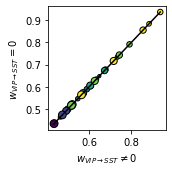

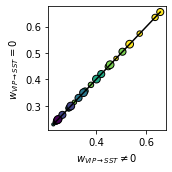

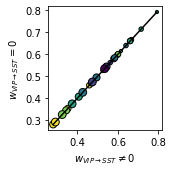

In [35]:
for itype in [0,1,2]:
    plt.figure(figsize=(2.5,2.5))
    sca.scatter_size_contrast(np.nanmean(YYstemp[:,:,:,itype],0),np.nanmean(YYs[:,:,:,itype],0))
    plt.xlabel(r'$w_{VIP\rightarrow SST} \neq 0$')
    plt.ylabel(r'$w_{VIP\rightarrow SST} = 0$')
    plt.tight_layout()

In [36]:
YYs.shape

(429, 6, 6, 8)

(array([ 6.,  8., 22., 50., 88., 91., 98., 55.,  9.,  2.]),
 array([20.33055625, 21.20298126, 22.07540626, 22.94783127, 23.82025628,
        24.69268128, 25.56510629, 26.43753129, 27.3099563 , 28.18238131,
        29.05480631]),
 <BarContainer object of 10 artists>)

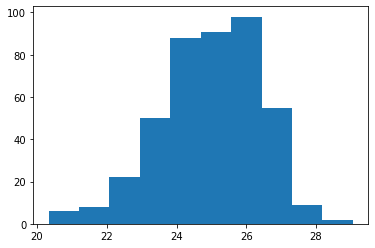

In [37]:
plt.figure()
plt.hist(losses[losses<100])

(array([  3.,   6.,  25.,  67., 112.,  90.,  63.,  43.,  16.,   4.]),
 array([0.30676439, 0.32770943, 0.34865447, 0.36959952, 0.39054456,
        0.4114896 , 0.43243464, 0.45337968, 0.47432473, 0.49526977,
        0.51621481]),
 <BarContainer object of 10 artists>)

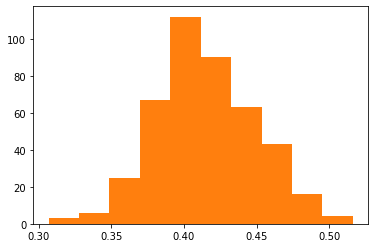

In [38]:
plt.figure()
plt.hist(YY1s.min(1).min(1)[:,0])
plt.hist(YY2s.min(1).min(1)[:,0])

(array([ 1.,  0.,  0.,  0.,  2.,  0.,  0.,  1.,  2.,  0.,  1.,  1.,  0.,
         1.,  0.,  0.,  1.,  2.,  1.,  1.,  1.,  1.,  1.,  1.,  2.,  4.,
         1.,  3.,  5.,  3.,  5.,  2.,  4.,  5.,  8.,  8.,  2.,  7.,  3.,
         6.,  4., 11.,  8.,  9., 13., 10.,  9.,  9.,  7.,  8.,  6., 10.,
        11.,  8., 11.,  8.,  4.,  8., 13., 12., 11., 11., 13.,  7.,  8.,
        10.,  9., 14.,  7.,  8., 12.,  7.,  8.,  7.,  7.,  6.,  4.,  2.,
         1.,  1.,  2.,  2.,  1.,  1.,  0.,  0.,  1.,  1.,  0.,  1.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  1.,  0.,  1.]),
 array([20.33055625, 20.41779875, 20.50504125, 20.59228375, 20.67952625,
        20.76676875, 20.85401125, 20.94125375, 21.02849626, 21.11573876,
        21.20298126, 21.29022376, 21.37746626, 21.46470876, 21.55195126,
        21.63919376, 21.72643626, 21.81367876, 21.90092126, 21.98816376,
        22.07540626, 22.16264876, 22.24989126, 22.33713376, 22.42437627,
        22.51161877, 22.59886127, 22.68610377, 22.77334627, 22.860588

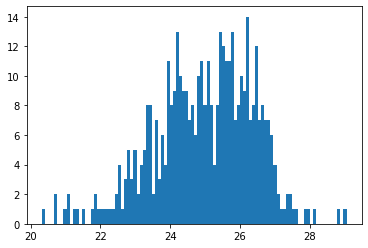

In [39]:
plt.figure()
plt.hist(losses[losses<1e3],bins=100)

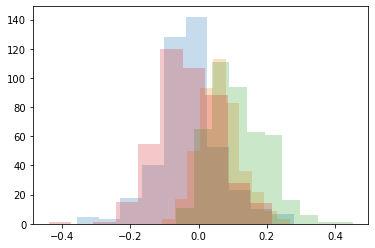

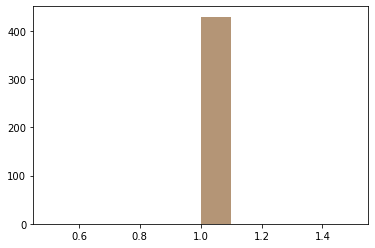

In [40]:
plt.figure()
for itype in range(nQ):
    plt.hist(bls[:,itype],alpha=0.25)
plt.figure()
for itype in range(nQ):
    plt.hist(amps[:,itype],alpha=0.25)

In [41]:
lkat = losses < np.nanpercentile(losses,10)


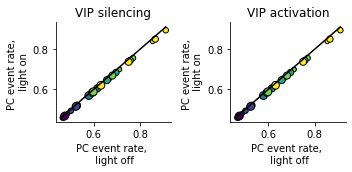

In [42]:
itype = 0
plt.figure(figsize=(5,2.5))
titles = ['VIP silencing','VIP activation']
for iyy,yy in enumerate([YY1s,YY2s]):
    plt.subplot(1,2,iyy+1)
    for iwt in [np.argmin(losses)]:#range(YYs.shape[0]):#
        sca.scatter_size_contrast(YYs[iwt,:,:,itype],yy[iwt,:,:,itype])#,mn=0.5,mx=1.25)
    plt.title(titles[iyy])
    plt.xlabel('PC event rate, \n light off')
    plt.ylabel('PC event rate, \n light on')
    ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/bidi_nonlinear_pc_scatter_size_contrast_best.eps')

In [43]:
def compute_smi(arr):
    return arr[:,-1]/arr.max(1)
smis,smi1s,smi2s = [compute_smi(yy) for yy in [YYs,YY1s,YY2s]]
smis_all = np.concatenate([s[:,np.newaxis] for s in [smis,smi1s,smi2s]],axis=1)

NameError: name 'compute_smi' is not defined

In [50]:
opto_colors = [np.array((0,0,0)),np.array((1,0.8,0)),np.array((1,0,0))]

<IPython.core.display.Javascript object>


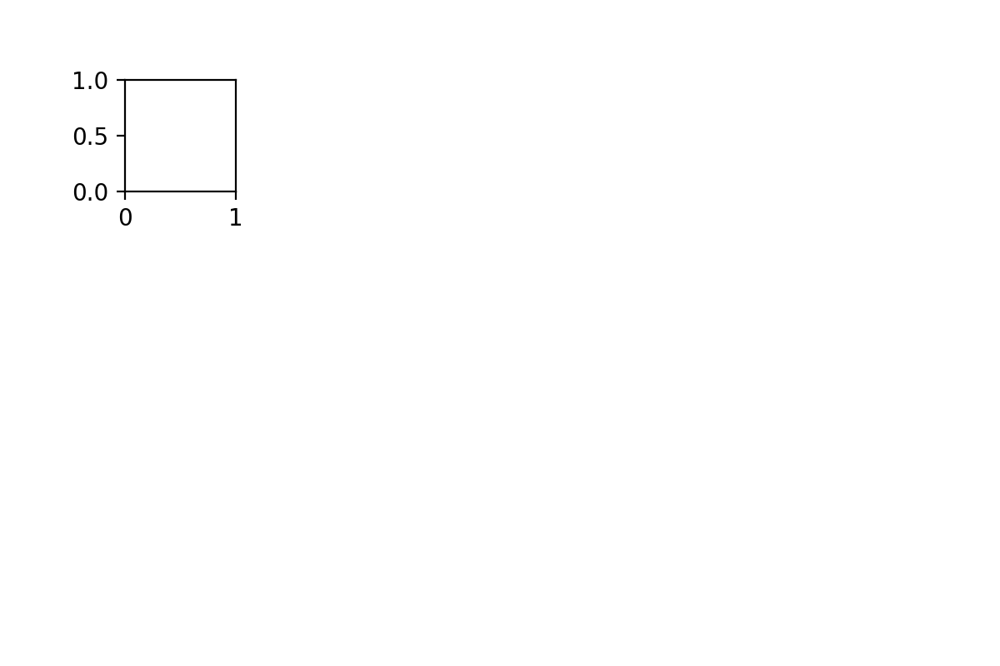

NameError: name 'smis_all' is not defined

In [51]:
plt.figure(figsize=(6,4))
x = np.arange(6)
for iwt in range(nfiles):
    plt.subplot(4,6,iwt+1)
    ut.plot_bootstrapped_errorbars_hillel(x,smis_all[iwt:iwt+1,:],colors = opto_colors)
    plt.xticks(x,ucontrast)
    plt.ylabel('SMI')
    plt.xlabel('contrast (%)')
    plt.axis('off')
    plt.ylim((0.5,1.1))
# plt.legend(['baseline','VIP silencing','VIP activation'])
    plt.tight_layout()
#     plt.plot(smi1s[iwt])
#     plt.plot(smi2s[iwt])

<IPython.core.display.Javascript object>


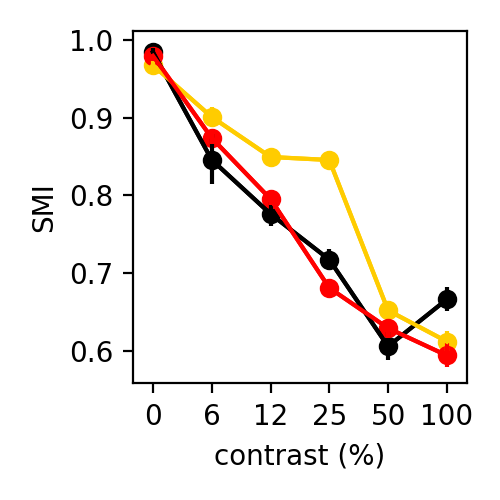

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.979613170987218


In [1287]:
plt.figure(figsize=(2.5,2.5))
x = np.arange(6)
ut.plot_bootstrapped_errorbars_hillel(x,smis_all,colors = opto_colors)
plt.xticks(x,ucontrast)
plt.ylabel('SMI')
plt.xlabel('contrast (%)')
# plt.legend(['baseline','VIP silencing','VIP activation'])
plt.tight_layout()
#     plt.plot(smi1s[iwt])
#     plt.plot(smi2s[iwt])

<IPython.core.display.Javascript object>


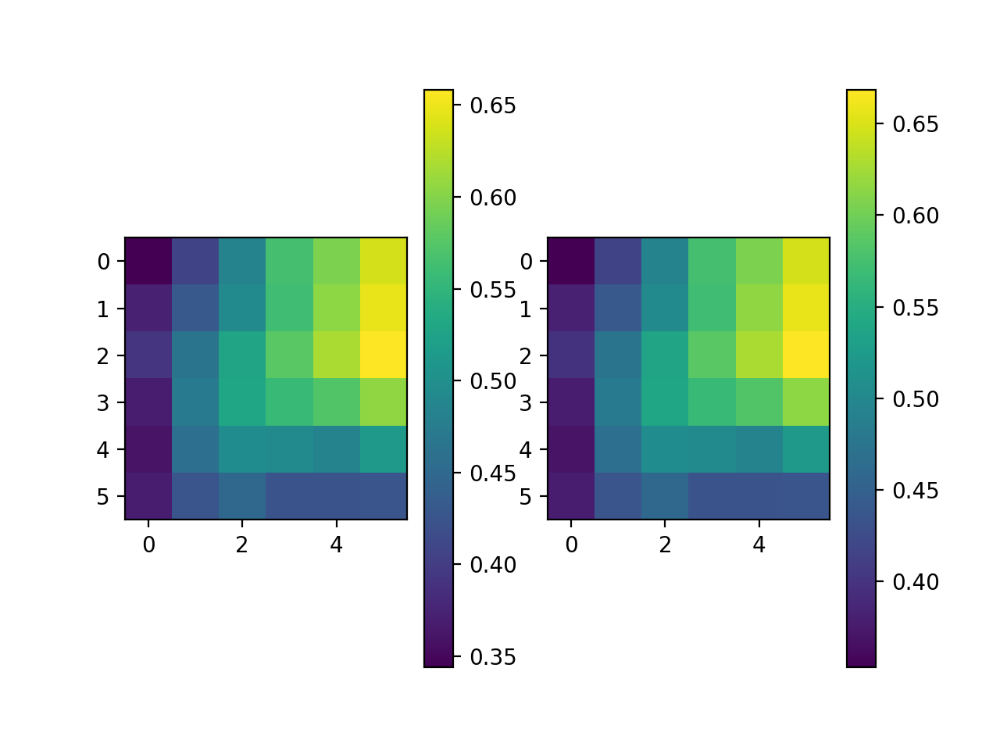

In [45]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(np.nanmean(min_eig,0))
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(np.nanmean(max_eig,0))
plt.colorbar()

<IPython.core.display.Javascript object>


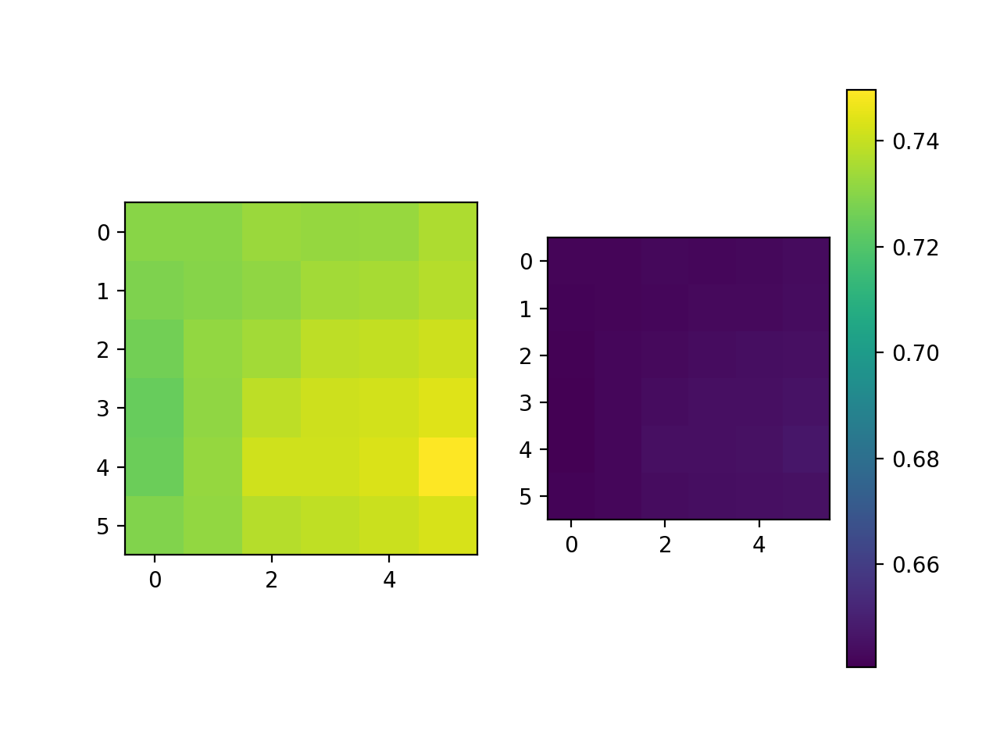

In [332]:
plt.figure()
data = np.nanmean(vs[:,:,:,:,:]/np.sign(vs[:,:,:,0:1,:]),0)
for idata in range(2):
    plt.subplot(1,2,idata+1)
    plt.imshow(data[:,:,idata,1],vmin=data.min(),vmax=data.max())
plt.colorbar()

<IPython.core.display.Javascript object>


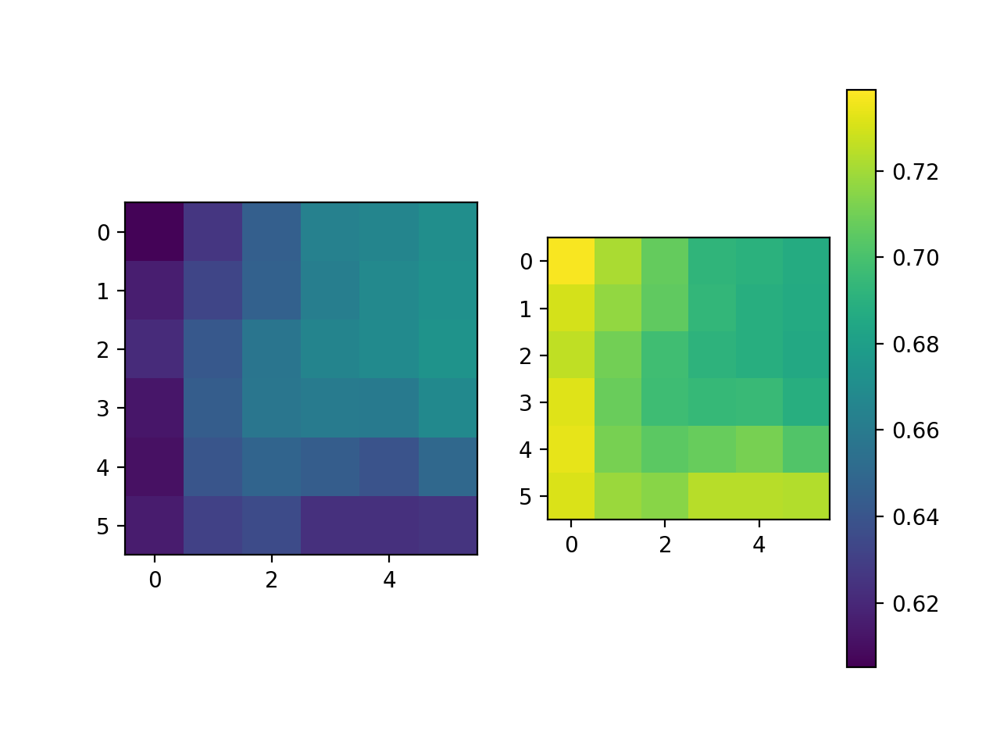

In [46]:
plt.figure()
data = np.nanmean(vs[:,:,:,:,:]/np.sign(vs[:,:,:,0:1,:]),0)
for idata in range(2):
    plt.subplot(1,2,idata+1)
    plt.imshow(data[:,:,idata,1],vmin=data.min(),vmax=data.max())
plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


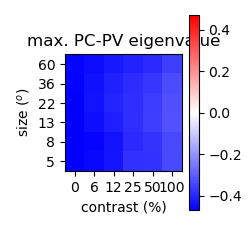

Text(0.5, 1, 'max. PC-PV eigenvalue')

In [404]:
plt.figure(figsize=(2.5,2.5))
data = np.mean(max_eig,axis=0)-1
rg = np.max(np.abs(data))
sca.show_size_contrast(data,cmap='bwr',vmin=-rg,vmax=rg,flipud=True)
plt.colorbar()
plt.tight_layout()
plt.title('max. PC-PV eigenvalue')
# plt.savefig('figures/pc_pv_stability.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


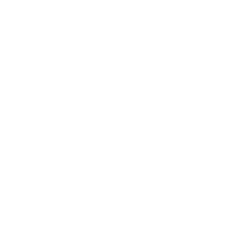

TypeError: list indices must be integers or slices, not tuple

In [388]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,max_eig[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_l23)
plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('max. PC-PV eigenvalue')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/pc_pv_stability_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


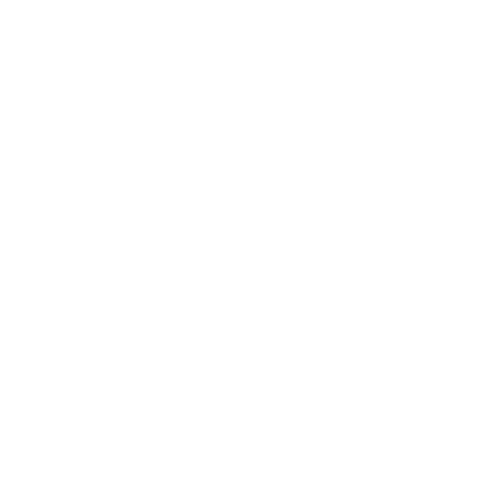

NameError: name 'phis' is not defined

In [52]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(phis[:,:,:,0]/phis[:,:,:,3])[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_l23)
plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('$\phi_{PC}/\phi_{PV}$')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/pc_pv_phi_ratio_size_by_3_contrasts.eps')

In [100]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_size_by_3_contrasts.eps')

TypeError: list indices must be integers or slices, not tuple

<Figure size 180x180 with 0 Axes>

<IPython.core.display.Javascript object>


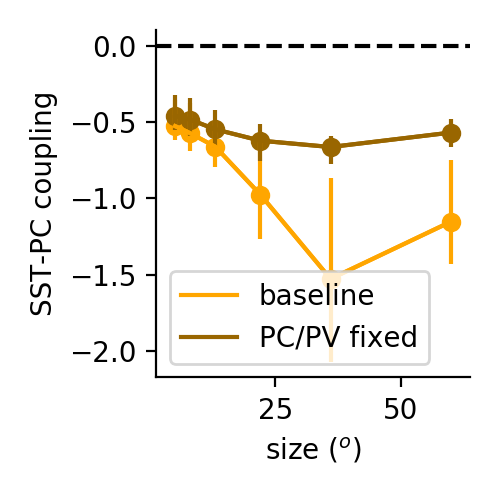

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.6975856340982863
-0.5944354315755127


In [195]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,5:6,1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst[-1:])
ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,5:6,1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst[-2:-1])
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('SST-PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.legend(['baseline','PC/PV fixed'])
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_size_pc_pv_equalized.eps')

<IPython.core.display.Javascript object>


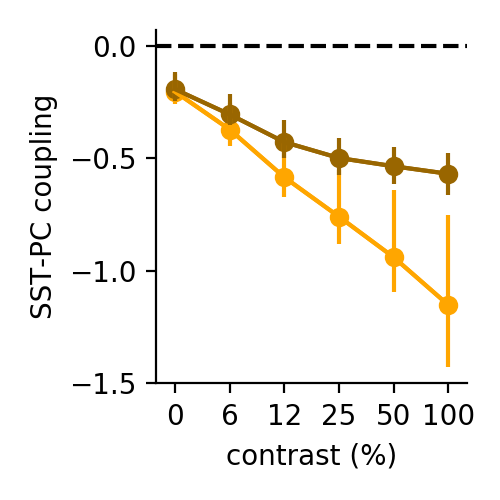

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.2801591855061695
-0.2699075940000322


In [196]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
isize = 5
x = np.arange(6)
c_sst = np.array(((0.3,0.2,0),(0.6,0.4,0),(1,0.65,0)))
# ut.plot_bootstrapped_errorbars_hillel(usize,couplings_pcpv[:,:,[1,3,5],1,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
ut.plot_bootstrapped_errorbars_hillel(x,couplings[:,isize:isize+1,:,1,0].transpose((0,1,2)),pct=(2.5,97.5),colors=c_sst[-1:])
ut.plot_bootstrapped_errorbars_hillel(x,couplings_pcpv[:,isize:isize+1,:,1,0].transpose((0,1,2)),pct=(2.5,97.5),colors=c_sst[-2:-1])
plt.xticks(x,ucontrast)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('contrast (%)')
plt.ylabel('SST-PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


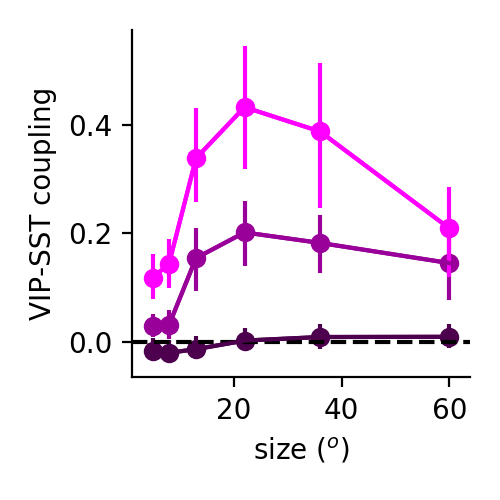

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.31955004781297913


In [437]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],2,1].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('VIP-SST coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/vip_sst_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


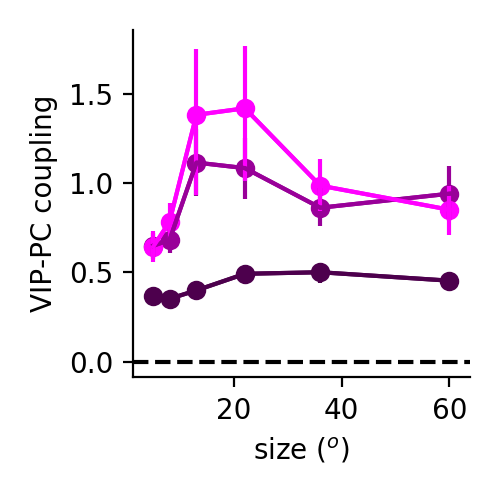

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0677499585906811


In [438]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],2,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('VIP-PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


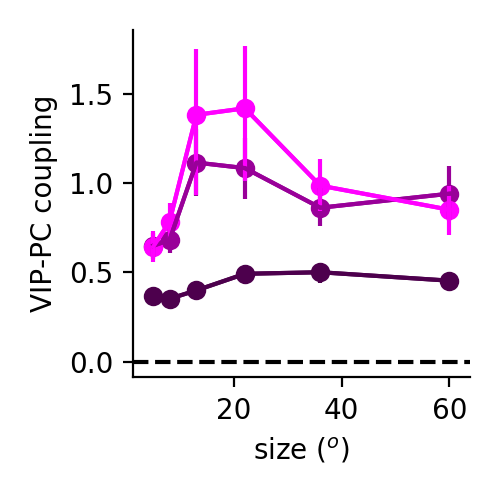

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0677499585906811


In [439]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],2,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('VIP-PC coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_size_by_3_contrasts.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


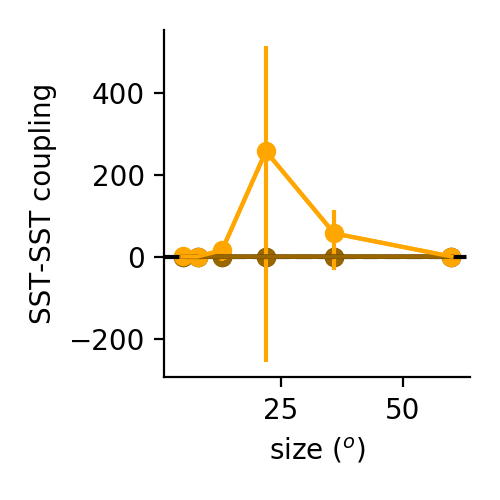

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.4200859406383173


In [756]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_vip = np.array(((0.3,0,0.3),(0.6,0,0.6),(1,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],1,1].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel('SST-SST coupling')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_sst_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


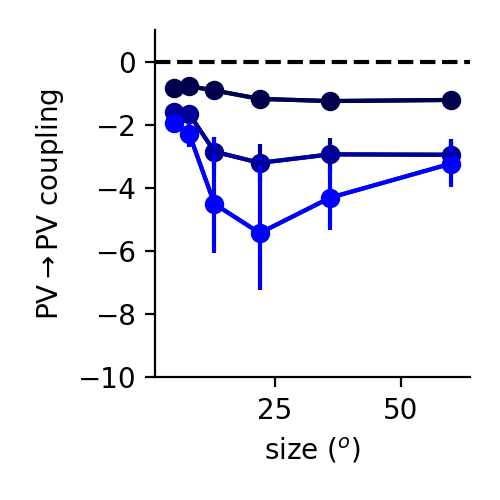

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.8866364175550354


In [441]:
reload(ut)
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],3,3].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PV coupling')
# plt.legend(['6%','25%','100%'])
ut.erase_top_right()
plt.ylim((-10,1))
plt.tight_layout()
# plt.savefig('figures/pv_pv_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


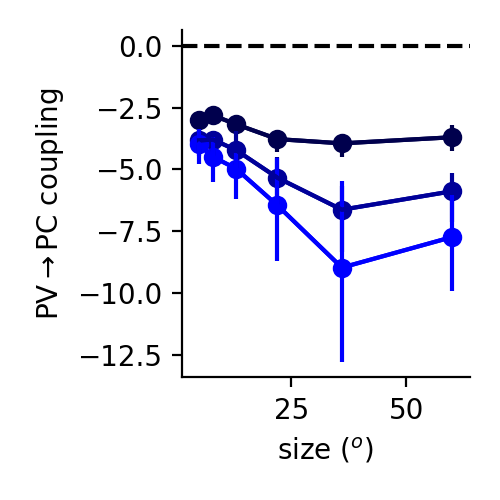

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-3.1064618889260043


In [205]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],3,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
# plt.legend(['6%','25%','100%'])
erase_top_right()
plt.tight_layout()
# plt.savefig('figures/pv_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


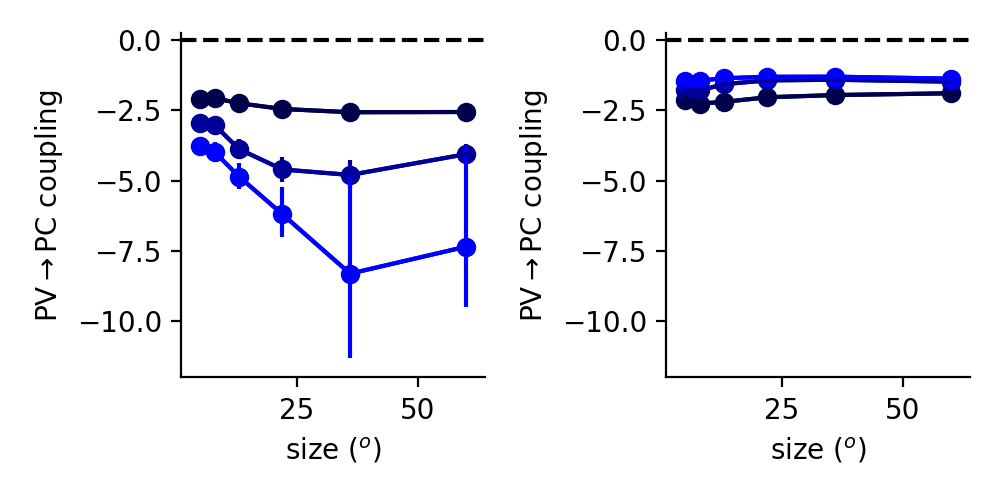

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-2.215402917344878
-1.331929316130771


In [625]:
ylim = (-12,0.25)
plt.figure(figsize=(5,2.5))
usize = [5,8,13,22,36,60]
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))
plt.subplot(1,2,1)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],3,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()

plt.subplot(1,2,2)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings_fixed[:,:,[1,3,5],3,0,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()
plt.tight_layout()
# plt.savefig('figures/pv_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


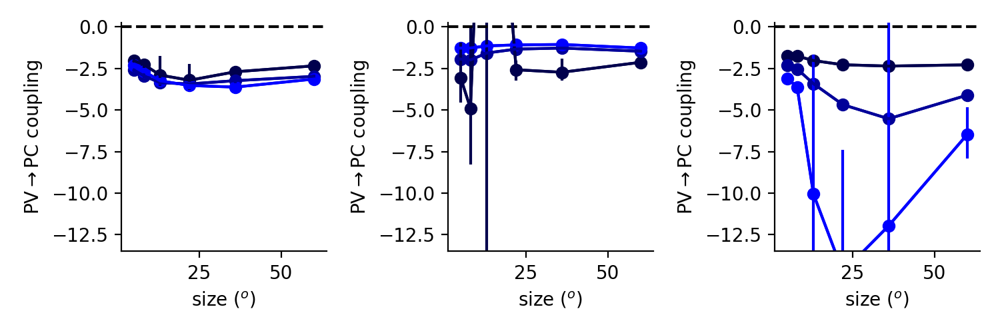

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-2.161082556359041
-1.088678285828254


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-1.8420984961156146


In [1181]:
ylim = (-13.5,0.25)
plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
c_pv = np.array(((0,0,0.3),(0,0,0.6),(0,0,1)))

plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings[:,:,[1,3,5],3,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings_fixed[:,:,[1,3,5],3,0,0].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,couplings_fixed[:,:,[1,3,5],3,0,1].transpose((0,2,1)),pct=(2.5,97.5),colors=c_pv)
plt.axhline(0,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PV$\rightarrow$PC coupling')
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
erase_top_right()

plt.tight_layout()
# plt.savefig('figures/pv_pc_coupling_size_by_3_contrasts.eps')

<IPython.core.display.Javascript object>


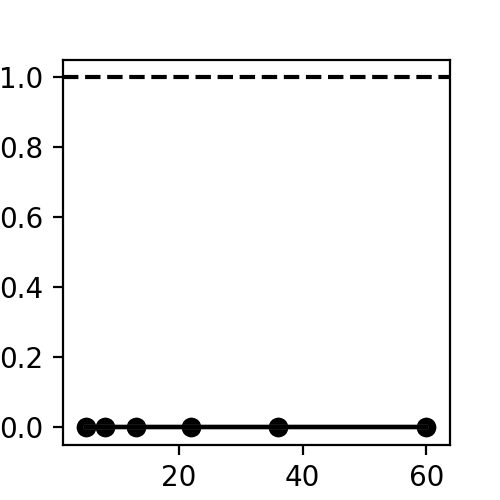

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.0


NameError: name 'erase_top_right' is not defined

In [53]:
plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,Wpcpc[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_l23)
plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'eff. PC$\rightarrow$PC weight')
# plt.legend(['6%','25%','100%'])
erase_top_right()
plt.ylim((0.5,3.5))
plt.tight_layout()
# plt.savefig('figures/pc_stability_size_by_3_contrasts.eps')

In [54]:
pc_sst_coupling = np.zeros((nN,))
pc_pv_coupling = np.zeros((nN,))
for istim in range(nN):
    Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
    pc_sst_coupling[istim] = (Wmy[1,0]*Phi[0,0]*Wmy[0,1]*Phi[1,1])
    pc_pv_coupling[istim] = (Wmy[3,0]*Phi[0,0]*Wmy[0,3]*Phi[3,3])

<IPython.core.display.Javascript object>


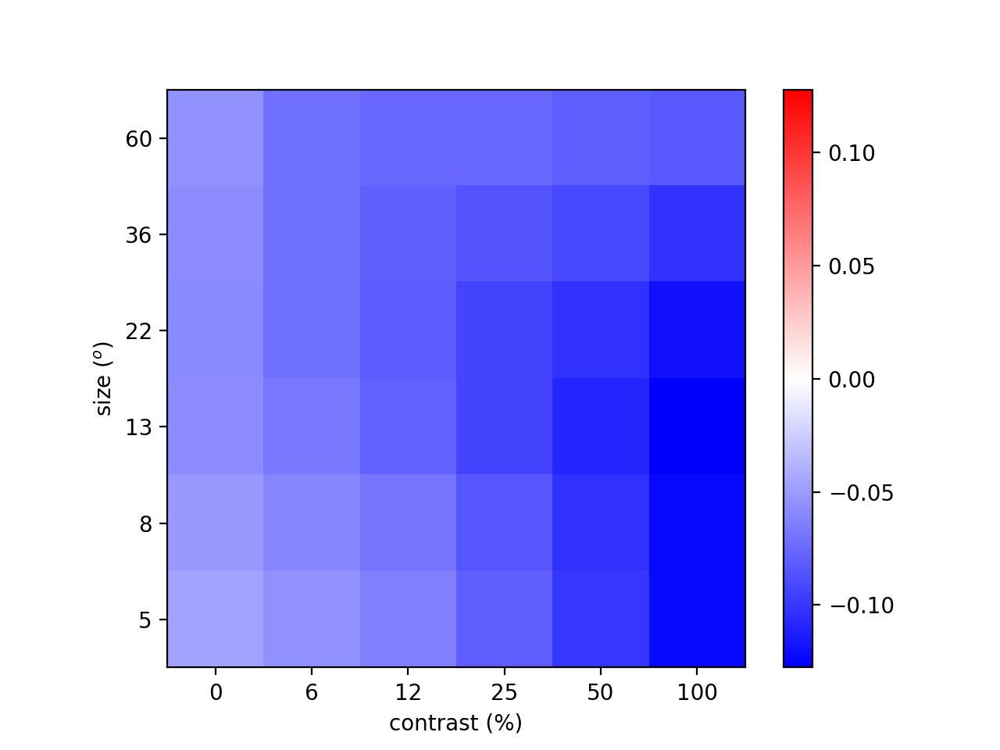

In [55]:
plt.figure()
mx = np.abs(pc_sst_coupling).max()
sca.show_size_contrast(pc_sst_coupling.reshape((6,6)),flipud=True,cmap='bwr',vmin=-mx,vmax=mx)
plt.colorbar()

In [1008]:
Wpcpc.shape

(6, 6, 6)

<IPython.core.display.Javascript object>


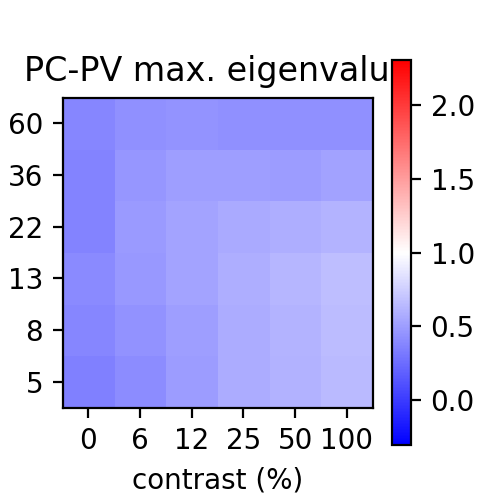

<IPython.core.display.Javascript object>


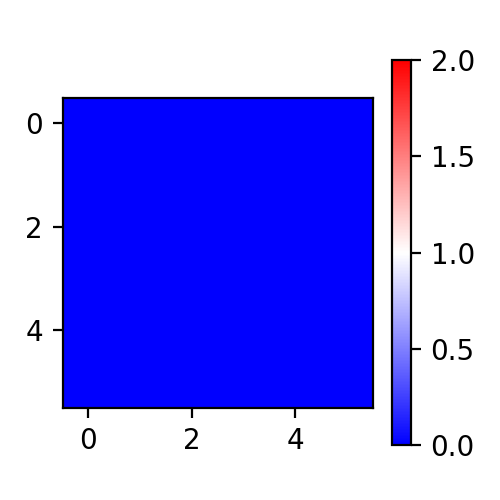

In [56]:
reload(sca)
plt.figure(figsize=(2.5,2.5))
rg = np.max(np.abs(max_eig-1))
sca.show_size_contrast(np.mean(max_eig,0),cmap='bwr',vmin=1-rg,vmax=1+rg,flipud=True)
plt.colorbar()
plt.title('PC-PV max. eigenvalue')
# plt.savefig('figures/pc_pv_stability.eps')

plt.figure(figsize=(2.5,2.5))
rg = np.max(np.abs(Wpcpc-1))
plt.imshow(np.mean(Wpcpc,0),cmap='bwr',vmin=1-rg,vmax=1+rg)
plt.colorbar()

In [300]:
# dh Phi + dY W Phi = dY
# dh + dY W = dY inv(Phi)
# dY W = dY inv(Phi) - dh
# W = pinv(dY) (dY inv(Phi) - dh)

In [830]:
# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_'
# good_fits = ['200714c/005','200714c/008','200714d/021','200715a/022','200715a/024',\
#             '200716a/034','200716a/035','200716a/048','200716b/006','200716b/042','200716b/061','200716b/087','200716b/091',\
#             '200717a/010','200717a/031','200717a/066','200717a/073','200717a/075','200717a/087','200717a/096',\
#             '200717b/028','200717b/052','200717b/059','200717b/060','200717b/068','200717b/079','200717b/084']
# weights_files = [weights_base+fit+'.npy' for fit in good_fits]

In [81]:
weights_files = []

# fits using only halo

# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200721e/'
# good_fits = ['006','010','012','014','018','019','020','021','023','025','030',\
#              '035','042','045','049','058','060','064','066','076','078','083']
# weights_files = [weights_base+fit+'.npy' for fit in good_fits]

# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200722a/'
# good_fits = ['003','012','014','025','028','029','031','048','059','060',\
#              '066','072','079','081','088','089','090','094']
# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]

# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200723a/'
# good_fits = ['000','001','002','004','011','025','026','027','029','032',\
#              '043','045','064','065','069','070','072','076','080','086',\
#             '087','089','093','096']
# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]


# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200724a/'
# good_fits = ['000','003','004','017','018','028','029','034','037','044',\
#              '046','050','054','058','060','062','066','069','072','079',\
#             '086','087','091','092','097']
# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]


# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200725a/'
# good_fits = ['002','003','005','010','015','034','042','070','072','073',\
#              '074','076','079','080','085','087','089','092','094','102',\
#             '103','105','118','120','123','132','134','137','138','141',\
#             '143','145','147','161','164','166','171','174','180','182',\
#             '185','192','193','199']
# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]

# fits using halo and chrimson

# weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200820b/'
# good_fits = ['021','045','059','063','073','087','088','090','092']

# weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]

# fits using halo and chrimson, initialized from halo good fits

weights_base = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200821a/'
good_fits = ['%03d'%i for i in range(133)]

weights_files = weights_files + [weights_base+fit+'.npy' for fit in good_fits]

In [692]:
weights_file = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_200820a/000.npy'
npyfile = np.load(weights_file,allow_pickle=True)[()]

In [693]:
npyfile['Wmy']

array([[ 4.30288556,  1.1677927 ,  0.61461367,  3.53217309],
       [-0.28278042,  0.        , -0.87968018, -0.25773783],
       [ 0.        , -0.91002233, -0.07578183,  0.        ],
       [-3.34941514, -0.12832602, -0.41438752, -2.45614189]])

In [694]:
# basefold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'
# subfold = 'weights_200720a/'
# plots_fold = basefold + 'fit_graphics/' + subfold
# ut.mkdir(plots_fold)
# weights_fold = basefold + 'weights/' + subfold
# weights_files = glob.glob(weights_fold+'*.npy')
# weights_files.sort()
# # weights_filenames = [s.split('/')[-1][:-4] for s in weights_files]


In [12]:
basefold = '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'
def get_weights_files(fit_lbl,basefold='/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/'):
    subfold = 'weights_%s/'%fit_lbl
#     plots_fold = basefold + 'fit_graphics/' + subfold
    weights_fold = basefold + 'weights/' + subfold
    weights_files = glob.glob(weights_fold+'*.npy')
    weights_files.sort()
    weights_filenames = [weights_file.split('/')[-1][:-4] for weights_file in weights_files]
    return weights_files,weights_filenames

In [30]:
fit_lbl = '201130b'
weights_files,weights_filenames = get_weights_files(fit_lbl)

print(len(weights_files))

# weights_filenames = [s.split('/')[-1][:-4] for s in weights_files]

1000


In [226]:
Wstar_dict['YY']

KeyError: 'YY'

In [31]:
class model_fits(object):
    def __init__(self,fit_lbl,use_f_mt=True,nP=2,nQ=4,nsize=6,ncontrast=6,pcutoff=10):
        self.fit_lbl = fit_lbl
        self.use_f_mt = use_f_mt
        self.weights_files,self.weights_filenames = calnet.utils.get_weights_files(self.fit_lbl)
        if not self.use_f_mt:
            self.rate_f = sim_utils.f_identity
            self.rate_fprime = sim_utils.fprime_m_identity
        else:
            self.rate_f = calnet.utils.f_miller_troyer
            self.rate_fprime = calnet.utils.fprime_m_miller_troyer
            
        print(self.rate_f)
            
        self.nfiles = len(self.weights_files)
        
        self.nP = nP
        self.nQ = nQ
        self.nsize = nsize
        self.ncontrast = ncontrast
        
        self.Ks = np.zeros((self.nfiles,nQ))
        self.Wmys = np.zeros((self.nfiles,nQ,nQ))
        self.Wmxs = np.zeros((self.nfiles,nP,nQ))
        self.s02s = np.zeros((self.nfiles,nQ))
        self.bls = np.zeros((self.nfiles,nQ))
        self.YYs = np.zeros((self.nfiles,6,6,nQ*nS*nT))
        self.YYs_no_res = np.nan*np.ones((self.nfiles,6,6,nQ*nS*nT))
        self.XXs = np.zeros((self.nfiles,6,6,nP*nS*nT))
        self.Etas = np.zeros((self.nfiles,6,6,nQ*nS*nT))
        self.h1s = np.zeros((self.nfiles,))
        self.h2s = np.zeros((self.nfiles,))
        self.losses = np.inf*np.ones((self.nfiles,))
        self.couplings = np.zeros((self.nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
        self.couplings_wderiv = np.zeros((self.nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ*nS*nT,nQ*nS*nT))
        self.mono_couplings = np.zeros((self.nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
        self.couplings_pcpv = np.zeros((self.nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
        self.Xcouplings = np.zeros((self.nfiles,6,6,nP*nS*nT,nQ*nS*nT))
        self.phis = np.zeros((self.nfiles,6,6,nQ*nS*nT))
        self.mdls = [None for iwt in range(self.nfiles)]
        for iwt,weights_file in enumerate(self.weights_files):
            try:
#             if True:
                Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
                wt_dicts = Wstar_dict['wt_dict']

                self.mdls[iwt] = cc.ModelOri(Wstar_dict,nT=1,rate_f=self.rate_f,rate_fprime=self.rate_fprime)
                try:
                    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
                    amp = np.ones((nQ*nS*nT,))
                except:
                    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
                self.losses[iwt] = Wstar_dict['loss']
                WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
                WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
                tiled_s02 = np.tile(s02,nS*nT)
                self.Ks[iwt] = K
                self.Wmys[iwt] = Wmy
                self.Wmxs[iwt] = Wmx
                self.s02s[iwt] = s02
                self.bls[iwt] = bl
                self.YYs[iwt] = self.rate_f(Eta,Xi**2+tiled_s02).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
                if simulate_no_res:
                    if self.losses[iwt]<lcutoff:
                        print((ifit,iwt))
                        yynr = dyn.compute_steady_state_Model(self.mdls[iwt],residuals_on=False,Niter=int(1e3))
                        self.YYs_no_res[iwt] = np.nanmean(yynr[:,-500:],1).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
                self.XXs[iwt] = XX.reshape((6,6,nP*nS*nT))
                self.Etas[iwt] = Eta.reshape((6,6,nQ*nS*nT))
                self.h1s[iwt] = h1
                self.h2s[iwt] = h2
                for istim in range(nN):
                    iistim,jjstim = np.unravel_index(istim,(6,6))
                    self.phis[iwt,iistim,jjstim] = self.rate_fprime(Eta[istim],Xi[istim]**2+tiled_s02)
                    phipcpv = self.phis[iwt,iistim,jjstim].copy()
                    phipcpv[3::4] = phipcpv[0::4]
                    Phi = np.diag(self.phis[iwt,iistim,jjstim])
                    Phipcpv = np.diag(phipcpv)
                    self.couplings[iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
                    self.mono_couplings[iwt,iistim,jjstim] = (WWmy @ Phi)
                    self.Xcouplings[iwt,iistim,jjstim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
                    self.couplings_pcpv[iwt,iistim,jjstim] = Phipcpv @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phipcpv)
                    eye_temp = np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
                    for ideriv in range(nQ*nS*nT):
                        for jderiv in range(nQ*nS*nT):
                            self.couplings_wderiv[iwt,iistim,jjstim,ideriv,jderiv] = Phi @ eye_temp[:,ideriv:ideriv+1] * Phi[jderiv,jderiv] @ eye_temp[jderiv:jderiv+1,:]
            except:
                print('did not work for %d'%iwt)


        self.max_eig = np.zeros((len(self.weights_files),nsize,ncontrast))
        self.min_eig = np.zeros((len(self.weights_files),nsize,ncontrast))
        self.vs = np.zeros((len(self.weights_files),nsize,ncontrast,2,2))
        for iwt in range(len(self.weights_files)):
            try:
                Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
                Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
                self.tiled_s02 = np.tile(s02,nS*nT)
                Weff = np.zeros((nsize,ncontrast,2,2))
                for istim in range(nN):
                    iistim,jjstim = np.unravel_index(istim,(6,6))
                    Phi = np.diag(self.rate_fprime(Eta[istim],Xi[istim]**2+self.tiled_s02))
                    Weff[iistim,jjstim] = Wmy[[0,3]][:,[0,3]] @ Phi[[0,3]][:,[0,3]]
                for istim in range(nN):
                    iistim,jjstim = np.unravel_index(istim,(nsize,ncontrast))
                    w,v = np.linalg.eig(Weff[iistim,jjstim].T)
                    self.vs[iwt,iistim,jjstim] = v[:,np.argsort(w)]
                    self.max_eig[iwt,iistim,jjstim] = np.max(w)
                    self.min_eig[iwt,iistim,jjstim] = np.min(w)
            except:
                print('did not work for %d'%iwt)
        self.low_loss = (self.losses < np.nanpercentile(self.losses,pcutoff))
        plt.hist(self.losses[self.losses<35],bins=20,alpha=0.5)
        ut.erase_top_right()
        plt.xlabel('loss')
        plt.ylabel('# of model fits')
        plt.tight_layout()

In [74]:
sst.wilcoxon(np.ones((6,)))

WilcoxonResult(statistic=0.0, pvalue=0.03125)

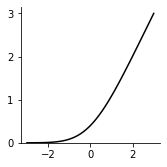

In [73]:
plt.figure(figsize=(2.5,2.5))
ifit = -1
plt.plot(np.linspace(-3,3,100),mf[ifit].rate_f(np.linspace(-3,3,100),1),c='k')
plt.gca().set_ylim(bottom=0)
ut.erase_top_right()

<function f_miller_troyer at 0x7fcd53fbc6a8>


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:107: ComplexWarning: Casting complex values to real discards the imaginary part
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:108: ComplexWarning: Casting complex values to real discards the imaginary part
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:109: ComplexWarning: Casting complex values to real discards the imaginary part


<function f_identity at 0x7fcd53f8ebf8>
did not work for 537
<function f_miller_troyer at 0x7fcd53fbc6a8>
<function f_miller_troyer at 0x7fcd53fbc6a8>


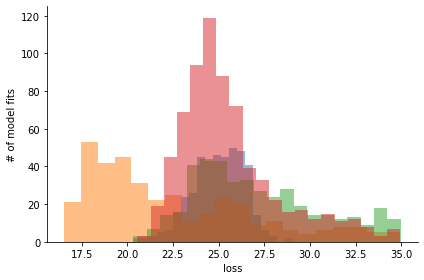

In [51]:
use_f_mts = [True,False,True,True]
pcutoffs = [20,10,10,10]
mf = [model_fits(fl,use_f_mt=ufm,pcutoff=pcutoff) for fl,ufm,pcutoff in zip(fit_lbls,use_f_mts,pcutoffs)]

*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.
*c* argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with *x* & *y*.  Please use the *color* keyword-argument or provide a 2-D array with a single row if you intend to specify the same RGB or RGBA value for all points.


2.045964583403092
linewidth: 1
plotting
1.4380796475956685
linewidth: 1
plotting


Text(0.5, 1.0, '22$^o$ size')

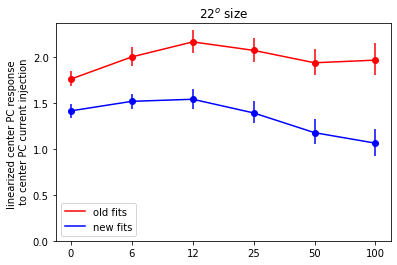

In [52]:
ifit = 0
plt.figure()
cs_temp = [np.array((1,0,0))[np.newaxis],np.array((0,0,1))[np.newaxis]]
for ifit in [0,-1]:
    well_behaved = (mf[ifit].low_loss)# & (np.abs(mf[ifit].couplings[:,:,:,0,0]).max(1).max(1) < 5)
    ut.plot_bootstrapped_errorbars_hillel(np.arange(6),mf[ifit].couplings[well_behaved,3:4,:,0,0],colors=cs_temp[ifit])
plt.gca().set_ylim(bottom=0)
plt.xticks(np.arange(6),ucontrast)
plt.ylabel('linearized center PC response \n to center PC current injection')
plt.legend(['old fits','new fits'])
plt.title(r'22$^o$ size')
# plt.savefig('figures/center_PC_responses_fit_comparison.eps')

Text(0.5, 1.0, '22$^o$ size')

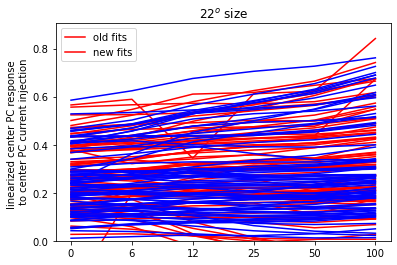

In [163]:
ifit = 0
plt.figure()
cs_temp = [np.array((1,0,0))[np.newaxis],np.array((0,0,1))[np.newaxis]]
for ifit in [0,-1]:
    well_behaved = (mf[ifit].low_loss)# & (np.abs(mf[ifit].couplings[:,:,:,0,0]).max(1).max(1) < 5)
    plt.plot(np.arange(6),mf[ifit].max_eig[well_behaved,3,:].T,c=cs_temp[ifit][0])
plt.gca().set_ylim(bottom=0)
plt.xticks(np.arange(6),ucontrast)
plt.ylabel('linearized center PC response \n to center PC current injection')
plt.legend(['old fits','new fits'])
plt.title(r'22$^o$ size')
# plt.savefig('figures/center_PC_responses_fit_comparison.eps')

In [38]:
XXhat = np.concatenate([np.concatenate(x,axis=1) for x in Xhat],axis=1)
YYhat = np.concatenate([np.concatenate(x,axis=1) for x in Yhat],axis=1)

In [39]:
def compute_frac_res(mf,inds):
    x,y = inds
    if not mf[x].mdls[y] is None:
#         return np.mean(np.mean(np.abs(mf[x].mdls[y].resEta),axis=0)/np.std(mf[x].mdls[y].Eta,axis=0))
        return np.mean(np.sqrt(np.mean(mf[x].mdls[y].resEta**2,axis=0))/np.std(mf[x].mdls[y].Eta,axis=0))
    else:
        return np.nan
    
def compute_frac_res_array(mf,inds,YYhat=YYhat):
    x,y = inds
    if not mf[x].mdls[y] is None:
        return mf[x].mdls[y].resEta/np.std(mf[x].mdls[y].Eta,axis=0)[np.newaxis]
    else:
        return np.nan*np.ones_like(YYhat)
    
def compute_frac_res_YY(mf,inds,YYhat=YYhat):
    x,y = inds
    if not mf[x].mdls[y] is None:
        return np.mean(np.sqrt(np.mean(np.abs(mf[x].mdls[y].YY - YYhat)**2,axis=0))/np.std(mf[x].mdls[y].YY,axis=0))
    else:
        return np.nan
    
def compute_frac_res_YY_no_res(mf,inds,YYhat=YYhat):
    x,y = inds
    if not mf[x].mdls[y] is None:
        Eta0 = (mf[x].mdls[y].Eta - mf[x].mdls[y].resEta)
        return np.mean(np.sqrt(np.mean((YYhat - mf[x].rate_f(Eta0,mf[x].tiled_s02))**2,axis=0)))
#         return np.mean(np.sqrt(np.mean((mf[x].rate_f(mf[x].mdls[y].Eta,mf[x].tiled_s02) - mf[x].rate_f(Eta0,mf[x].tiled_s02))**2,axis=0)))
    else:
        return np.nan
    
def compute_frac_res_YY_no_res_celltype(mf,inds,YYhat=YYhat):
    x,y = inds
    if not mf[x].mdls[y] is None:
        Eta0 = (mf[x].mdls[y].Eta - mf[x].mdls[y].resEta)
        return np.sqrt(np.mean((YYhat - mf[x].rate_f(Eta0,mf[x].tiled_s02))**2,axis=0))
#         return np.mean(np.sqrt(np.mean((mf[x].rate_f(mf[x].mdls[y].Eta,mf[x].tiled_s02) - mf[x].rate_f(Eta0,mf[x].tiled_s02))**2,axis=0)))
    else:
        return np.nan*np.ones_like(YYhat[0])

In [40]:
def compute_frac_res_XX(mf,inds,XXhat=XXhat):
    x,y = inds
    if not mf[x].mdls[y] is None:
        return np.mean(np.sqrt(np.mean(np.abs(mf[x].mdls[y].XX[:,0::2] - XXhat[:,0::2])**2,axis=0)))#/np.std(mf[x].mdls[y].XX[:,0::2],axis=0))
    else:
        return np.nan
    
def compute_frac_res_XX_array(mf,inds,XXhat=XXhat):
    x,y = inds
    if not mf[x].mdls[y] is None:
#         return (mf[x].mdls[y].XX[:,0::2] - XXhat[:,0::2])/np.std(mf[x].mdls[y].XX[:,0::2],axis=0)[np.newaxis]
        return np.sqrt(np.mean(np.abs(mf[x].mdls[y].XX[:,0::2] - XXhat[:,0::2])**2,axis=0))
    else:
        return np.nan*np.ones_like(XXhat[:,0::2])

In [41]:
ifit = 1
iwt = 0
fns = [compute_frac_res,compute_frac_res_XX,compute_frac_res_array,compute_frac_res_XX_array,compute_frac_res_YY,compute_frac_res_YY_no_res,compute_frac_res_YY_no_res_celltype]
frac_res,frac_res_XX,frac_res_array,frac_res_XX_array,frac_res_YY,frac_res_YY_no_res,frac_res_YY_no_res_celltype = [[np.array([fn(mf,(i,j)) for j in range(len(mf[i].mdls))]) for i in range(len(mf))] for fn in fns]
# frac_res = [None for _ in range(len(mf))]
# for ifit in range(len(frac_res)):
#     frac_res[ifit] = [np.mean(np.std(mf[ifit].mdls[iwt].resEta,axis=0)/np.std(mf[ifit].mdls[iwt].Eta,axis=0)) for iwt in range(mf[ifit].nfiles)]

NameError: name 'mf' is not defined

In [67]:
frac_res_YY_no_res_celltype[0][0].shape

(8,)

In [468]:
reload(nra)
reload(ut)
reload(opto_utils)
import size_contrast_figures as scf
rsfile = 'data/celltype_rate_summary_exptwise_200828.npy'

ca_obj = scf.ca_imaging(rsfile)

/Users/dan/Documents/code/adesnal/opto_utils.py:316: RuntimeWarning: Mean of empty slice
  nroi = rs_ori.shape[0]
/Users/dan/Documents/code/adesnal/opto_utils.py:325: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  for iother in range(len(others)):
/Users/dan/Documents/code/adesnal/opto_utils.py:328: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  return [rs_sort]+others_sort
/Users/dan/Documents/code/adesnal/size_contrast_figures.py:339: RuntimeWarning: Mean of empty slice
  if np.any(expt_ids==iexpt):


(10, 6, 6, 8)
(10, 6, 6, 8)
(13, 6, 6, 8)
(13, 6, 6, 8)
(10, 6, 6, 8)
(10, 6, 6, 8)
(13, 6, 6, 8)
(13, 6, 6, 8)
(7, 6, 6, 8)
(7, 6, 6, 8)
(10, 6, 6, 8)
(10, 6, 6, 8)
(13, 6, 6, 8)
(13, 6, 6, 8)
(10, 6, 6, 8)
(10, 6, 6, 8)
(13, 6, 6, 8)
(13, 6, 6, 8)
(7, 6, 6, 8)
(7, 6, 6, 8)


<IPython.core.display.Javascript object>


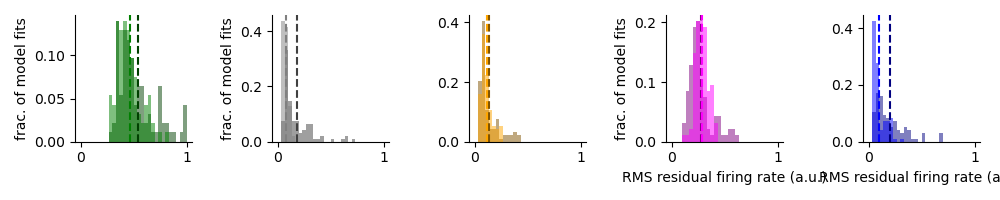

In [496]:
plt.figure(figsize=(10,2))
# cs = ['C0','C1']
plt.subplot(1,5,1)
itype = 0
cs = [0.5*ca_obj.celltype_colors[itype],ca_obj.celltype_colors[itype]]
for iifit,ifit in enumerate([1,3]):
    this_data = frac_res_XX[ifit][mf[ifit].low_loss]
    ut.bar_pdf(this_data,alpha=0.5,bins=np.linspace(0,1,31),facecolor=cs[iifit])#,edgecolor='k')
    plt.axvline(np.mean(this_data),linestyle='dashed',c=cs[iifit])
ut.erase_top_right()
if itype >= 2:
    plt.xlabel('RMS residual firing rate (a.u.)')
if itype % 2 == 0:
    plt.ylabel('frac. of model fits')
for itype in range(4):
    cs = [0.5*ca_obj.celltype_colors[itype+1],ca_obj.celltype_colors[itype+1]]
    plt.subplot(1,5,itype+2)
    for iifit,ifit in enumerate([1,3]):
        this_data = 0.5*(frac_res_YY_no_res_celltype[ifit][:,itype][mf[ifit].low_loss] \
                         + frac_res_YY_no_res_celltype[ifit][:,itype+4][mf[ifit].low_loss])
        ut.bar_pdf(this_data,alpha=0.5,bins=np.linspace(0,1,31),facecolor=cs[iifit])#,edgecolor='k')
        plt.axvline(np.mean(this_data),linestyle='dashed',c=cs[iifit])
    ut.erase_top_right()
    if itype >= 2:
        plt.xlabel('RMS residual firing rate (a.u.)')
    if itype % 2 == 0:
        plt.ylabel('frac. of model fits')

plt.tight_layout()

<IPython.core.display.Javascript object>


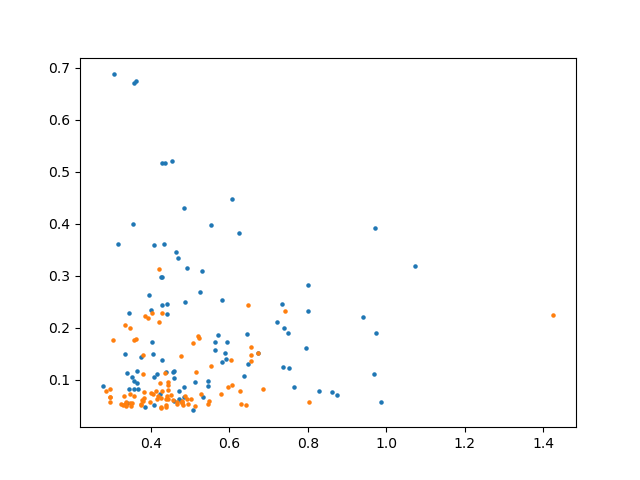

In [499]:
plt.figure()

for ifit in [1,3]:
    xdata = frac_res_XX[ifit][mf[ifit].low_loss]
    ydata = 0.5*(frac_res_YY_no_res_celltype[ifit][:,itype][mf[ifit].low_loss] \
                             + frac_res_YY_no_res_celltype[ifit][:,itype+4][mf[ifit].low_loss])
    plt.scatter(xdata,ydata,s=5)

<IPython.core.display.Javascript object>


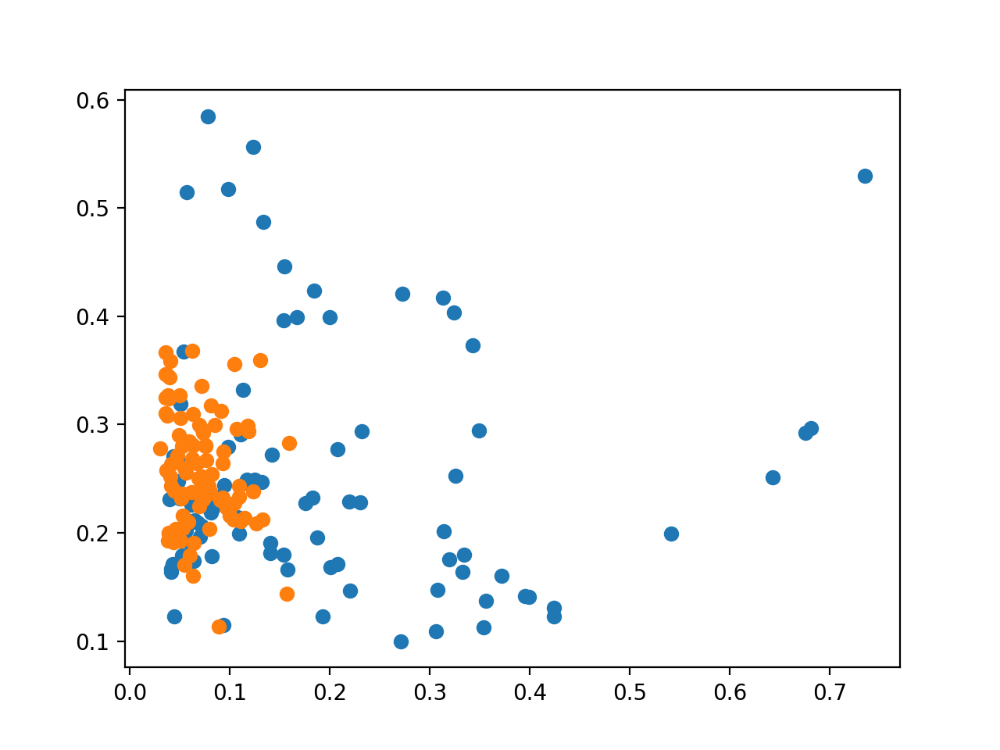

In [455]:
plt.figure()
itype1,itype2 = 0,2
for ifit in [1,3]:
    plt.scatter(frac_res_YY_no_res_celltype[ifit][:,itype1][mf[ifit].low_loss],frac_res_YY_no_res_celltype[ifit][:,itype2][mf[ifit].low_loss])

In [430]:
ifit = 0
[list(frac_res_YY_no_res_celltype[ifit][iwt]) for iwt in range(950) if not frac_res_YY_no_res_celltype[ifit][iwt] is None]

TypeError: iteration over a 0-d array

<IPython.core.display.Javascript object>


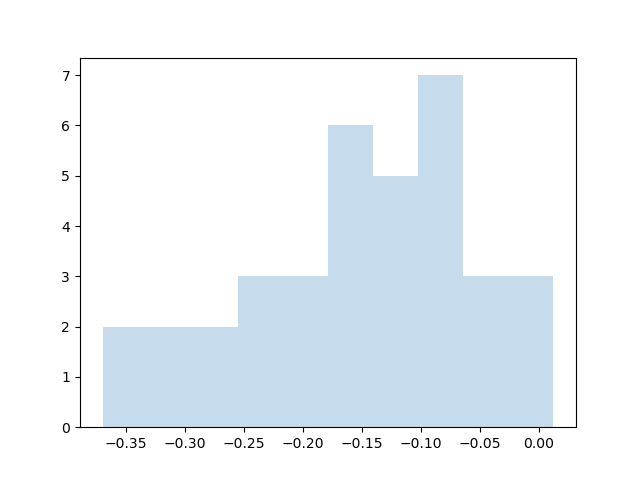

(array([2., 2., 2., 3., 3., 6., 5., 7., 3., 3.]),
 array([-0.36967956, -0.33147918, -0.2932788 , -0.25507842, -0.21687804,
        -0.17867766, -0.14047728, -0.1022769 , -0.06407652, -0.02587614,
         0.01232424]),
 <BarContainer object of 10 artists>)

In [392]:
plt.figure()
plt.hist(mf[ifit].mdls[iwt].resEta[:,itype]/np.std(mf[ifit].mdls[iwt].Eta[:,itype]),alpha=0.25)

<IPython.core.display.Javascript object>


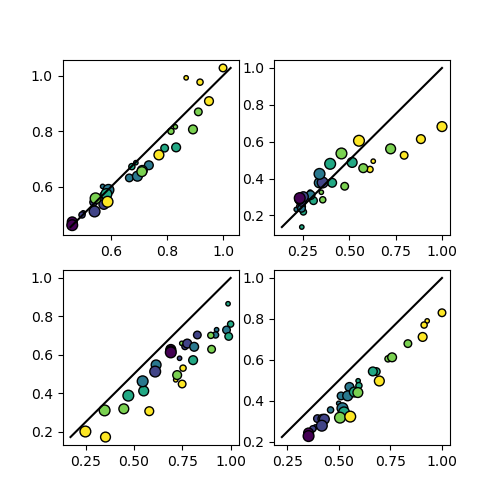

<IPython.core.display.Javascript object>


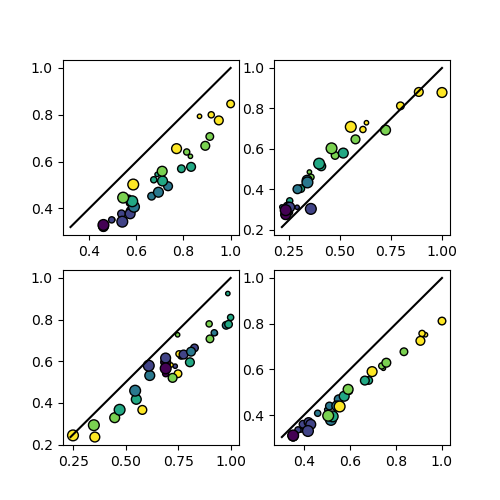

<IPython.core.display.Javascript object>


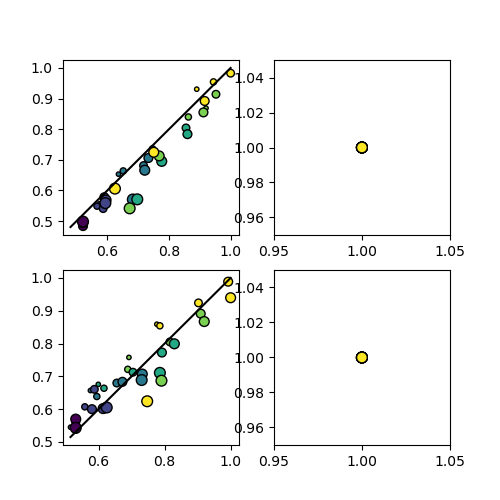

<IPython.core.display.Javascript object>


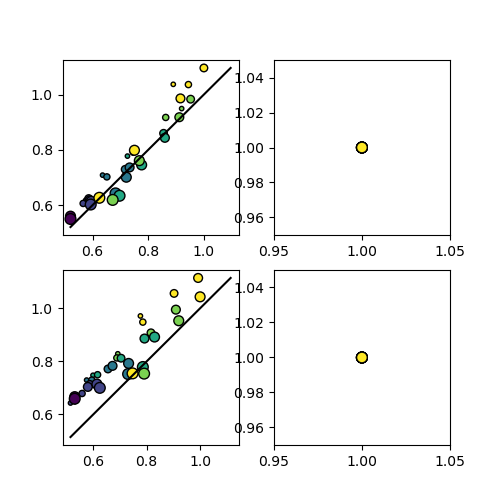

<IPython.core.display.Javascript object>


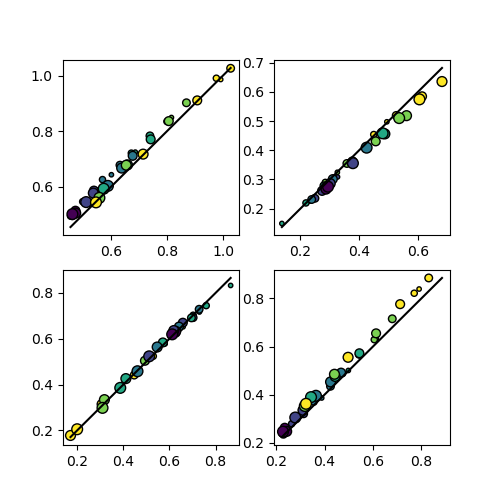

<IPython.core.display.Javascript object>


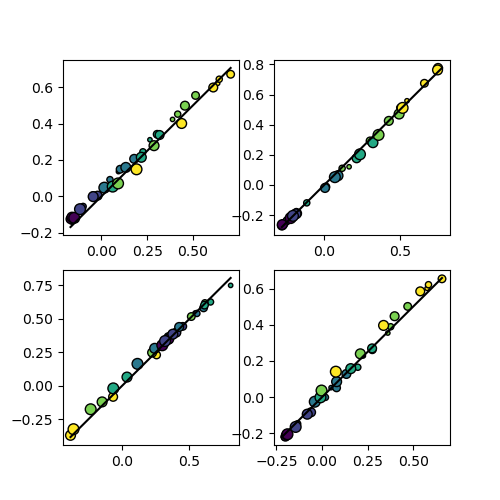

In [393]:
for ifit in [1,3]:
    iwt = np.where(mf[ifit].low_loss)[0][0]
    if mf[ifit].low_loss[iwt]:
        plt.figure(figsize=(5,5))
        for itype in range(4):
            plt.subplot(2,2,itype+1)
            sca.scatter_size_contrast(YYhat[:,itype],mf[ifit].mdls[iwt].YY[:,itype],nsize=6,ncontrast=6)

for ifit in [1,3]:
    iwt = np.where(mf[ifit].low_loss)[0][0]
    if mf[ifit].low_loss[iwt]:
        plt.figure(figsize=(5,5))
        for itype in range(4):
            plt.subplot(2,2,itype+1)
            sca.scatter_size_contrast(XXhat[:,itype],mf[ifit].mdls[iwt].XX[:,itype],nsize=6,ncontrast=6)
            
for ifit in [1,3]:
    iwt = np.where(mf[ifit].low_loss)[0][0]
    if mf[ifit].low_loss[iwt]:
        plt.figure(figsize=(5,5))
        for itype in range(4):
            plt.subplot(2,2,itype+1)
            sca.scatter_size_contrast(mf[ifit].mdls[iwt].Eta[:,itype],mf[ifit].mdls[iwt].Eta[:,itype] - mf[ifit].mdls[iwt].resEta[:,itype],nsize=6,ncontrast=6)

<IPython.core.display.Javascript object>


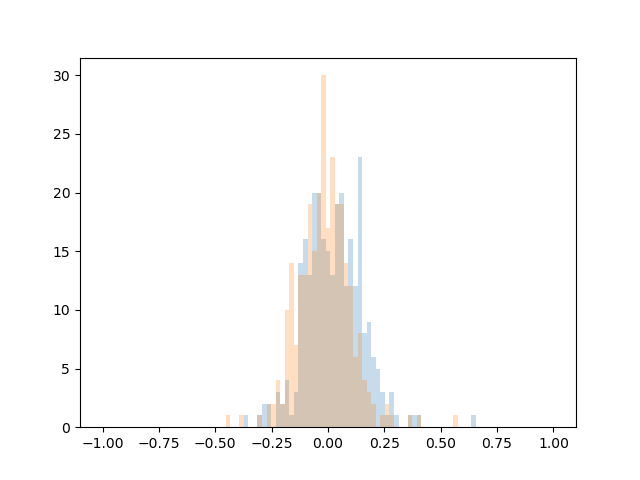

In [394]:
plt.figure()
for ifit in [1,3]:
    plt.hist(frac_res_array[ifit][iwt].flatten(),bins=np.linspace(-1,1,100),alpha=0.25)

<IPython.core.display.Javascript object>


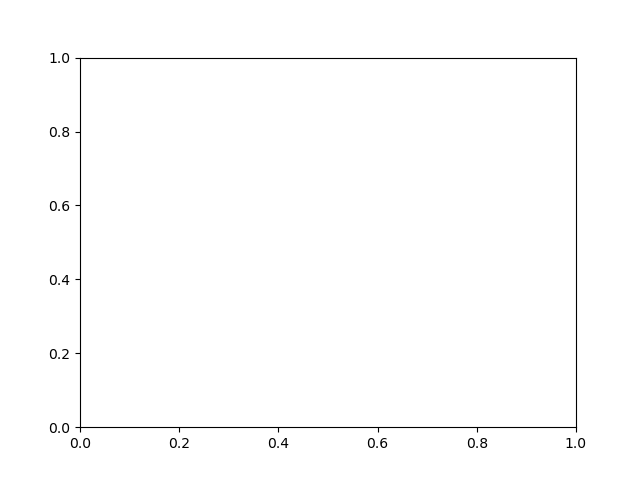

ValueError: x must have 2 or fewer dimensions

In [395]:
plt.figure()
for ifit in [1,3]:
    plt.hist(frac_res_array[ifit][mf[ifit].low_loss],bins=np.linspace(0,0.5,100),alpha=0.25)

<IPython.core.display.Javascript object>


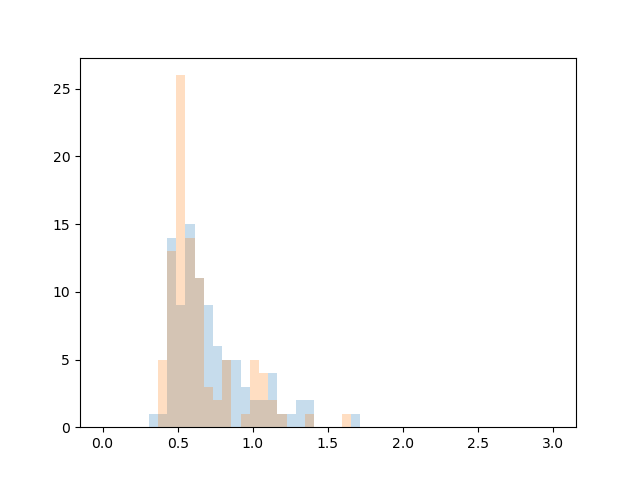

In [310]:
plt.figure()
for ifit in [1,3]:
    plt.hist((0.8*0.5*(frac_res[ifit]+frac_res_YY[ifit])+0.2*frac_res_XX[ifit])[mf[ifit].losses<np.nanpercentile(mf[ifit].losses,10)],bins=np.linspace(0,3,50),alpha=0.25)

<IPython.core.display.Javascript object>


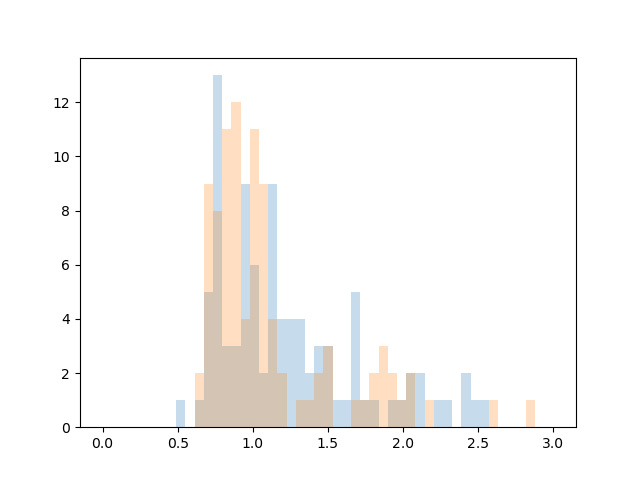

In [397]:
plt.figure()
for ifit in [1,3]:
    plt.hist((0.8*(frac_res_YY[ifit])+0.2*frac_res_XX[ifit])[mf[ifit].losses<np.nanpercentile(mf[ifit].losses,10)],bins=np.linspace(0,3,50),alpha=0.25)

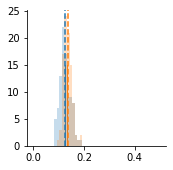

In [78]:
cs = ['C0','C1']
plt.figure(figsize=(2.5,2.5))
for iifit,ifit in enumerate([1,-1]):
    this_data = frac_res[ifit][mf[ifit].losses<np.nanpercentile(mf[ifit].losses,10)]
    lb,ub = ut.bootstrap(this_data,fn=np.nanmean,pct=(16,84))
    plt.hist(this_data,bins=np.linspace(0,0.5,50),alpha=0.25)
    plt.axvline(np.mean(this_data),linestyle='dashed',c=cs[iifit])
    plt.fill_between((lb,ub),(0,0),(15,15),facecolor=cs[iifit])
ut.erase_top_right()

In [79]:
'''Fractional residual current for the last fit model'''
(np.mean(this_data),np.std(this_data))

(0.13601309348665208, 0.016982595824165614)

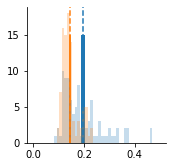

In [73]:
cs = ['C0','C1']
plt.figure(figsize=(2.5,2.5))
for iifit,ifit in enumerate([1,3]):
    this_data = frac_res_YY_no_res[ifit][mf[ifit].losses<np.nanpercentile(mf[ifit].losses,10)]
    lb,ub = ut.bootstrap(this_data,fn=np.nanmean,pct=(16,84))
    plt.hist(this_data,bins=np.linspace(0,0.5,50),alpha=0.25)
    plt.axvline(np.mean(this_data),linestyle='dashed',c=cs[iifit])
    plt.fill_between((lb,ub),(0,0),(15,15),facecolor=cs[iifit])
ut.erase_top_right()

<IPython.core.display.Javascript object>


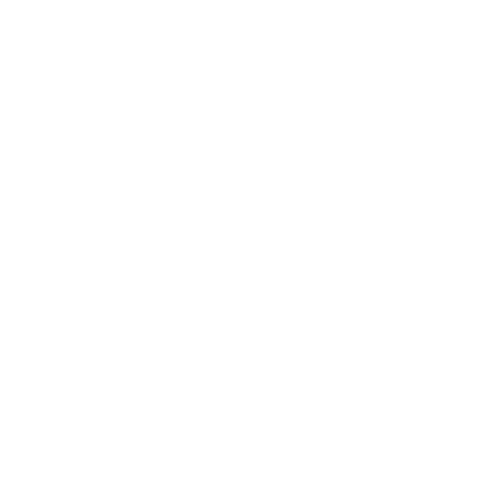

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [414]:
cs = ['C0','C1']
plt.figure(figsize=(2.5,2.5))
for iifit,ifit in enumerate([1,3]):
    this_data = frac_res_YY_no_res_celltype[ifit][mf[ifit].losses<np.nanpercentile(mf[ifit].losses,10),1]
    lb,ub = ut.bootstrap(this_data,fn=np.nanmean,pct=(16,84))
    plt.hist(this_data,bins=np.linspace(0,0.5,50),alpha=0.25)
    plt.axvline(np.mean(this_data),linestyle='dashed',c=cs[iifit])
    plt.fill_between((lb,ub),(0,0),(15,15),facecolor=cs[iifit])
ut.erase_top_right()

In [58]:
reload(calnet.utils)
fit_lbl = '201211a'
weights_files,weights_filenames = calnet.utils.get_weights_files(fit_lbl)
len(weights_files)

1000

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:130: ComplexWarning: Casting complex values to real discards the imaginary part
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:131: ComplexWarning: Casting complex values to real discards the imaginary part
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:132: ComplexWarning: Casting complex values to real discards the imaginary part
/Users/dan/Documents/code/adesnal/calnet/utils.py:685: RuntimeWarning: divide by zero encountered in true_divide
  u = mu/np.sqrt(2*s2)
/Users/dan/Documents/code/adesnal/sim_utils.py:673: RuntimeWarning: divide by zero encountered in true_divide
  u = mu/np.sqrt(2*s2)
/Users/dan/Documents/code/adesnal/calnet/utils.py:696: RuntimeWarning: divide by zero encountered in true_divide
  u = mu/np.sqrt(2*s2)


did not work for 537
did not work for 537
did not work for 494


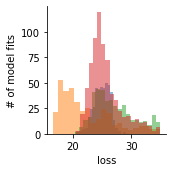

In [34]:
plt.figure(figsize=(2.5,2.5))

reload(sim_utils)

# no VIP->SST, no SST->VIP, baseline
# fit_lbls = ['201215b','210428c','210430a','210430e','210501a','210502c','210504a','210430d','210501b','210502d']#,'210429a'#['201215b','201227b']#['201215c','201215d','201215b']#,'201206a','201207a','201208a']
# fit_lbls = ['201215b','210502c','210506b','210507a','210508a']#['210502c','210504a','210504b','210504c','210502d','210505a','210505b']
# fit_lbls = ['201215b','210509b','210508a','210510b','210511b','210512b','210513b','210513c']#['210502c','210504a','210504b','210504c','210502d','210505a','210505b']
fit_lbls = ['201215b','210502d','210513b','210513c']#['210502c','210504a','210504b','210504c','210502d','210505a','210505b']
use_f_mt = [True,True,True,True,True,True,True,True]
wt_dicts = [{} for lbl in fit_lbls]

nsize,ncontrast = 6,6
nN,nP,nQ,nS,nT = nsize*ncontrast,2,4,2,1

nfits = len(fit_lbls)

Ks,Wmys,Wmxs,s02s,bls,YYs,XXs,Etas,h1s,h2s,losses,couplings,couplings_wderiv,couplings_pcpv,Xcouplings,phis,mono_couplings,\
mdls,YYs_no_res,max_eig,min_eig,vs = [[None for ifit in range(nfits)] for ivar in range(22)]

simulate_no_res = False
for ifit,fit_lbl in enumerate(fit_lbls):
    
    weights_files,weights_filenames = calnet.utils.get_weights_files(fit_lbl)
    
#     weights_files = weights_files[:400]
#     weights_filenames = weights_filenames[:400]
    if not use_f_mt[ifit]:
        rate_f = sim_utils.f_identity
        rate_fprime = sim_utils.fprime_m_identity
    else:
        rate_f = calnet.utils.f_miller_troyer
        rate_fprime = calnet.utils.fprime_m_miller_troyer
    nfiles = len(weights_files)
    # Ts = np.zeros((nfiles,nQ))
    Ks[ifit] = np.zeros((nfiles,nQ))
    Wmys[ifit] = np.zeros((nfiles,nQ,nQ))
    Wmxs[ifit] = np.zeros((nfiles,nP,nQ))
    s02s[ifit] = np.zeros((nfiles,nQ))
    bls[ifit] = np.zeros((nfiles,nQ))
    YYs[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    YYs_no_res[ifit] = np.nan*np.ones((nfiles,6,6,nQ*nS*nT))
    XXs[ifit] = np.zeros((nfiles,6,6,nP*nS*nT))
    Etas[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    # Eta1s = np.zeros((nfiles,6,6,nQ*nS*nT))
    # Eta2s = np.zeros((nfiles,6,6,nQ*nS*nT))
    h1s[ifit] = np.zeros((nfiles,))
    h2s[ifit] = np.zeros((nfiles,))
    losses[ifit] = np.inf*np.ones((nfiles,))
    couplings[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    couplings_wderiv[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ*nS*nT,nQ*nS*nT))
    mono_couplings[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    # couplings with phiPV = phiPC fixed
    couplings_pcpv[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    Xcouplings[ifit] = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
    phis[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    mdls[ifit] = [None for iwt in range(nfiles)]
    for iwt,weights_file in enumerate(weights_files):
        try:
            Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
        #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
            wt_dicts[ifit] = Wstar_dict['wt_dict']

            mdls[ifit][iwt] = cc.ModelOri(Wstar_dict,nT=1,rate_f=rate_f,rate_fprime=rate_fprime)
            try:
                Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
                amp = np.ones((nQ*nS*nT,))
            except:
                Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
            losses[ifit][iwt] = Wstar_dict['loss']
        #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,h3,Eta1,Eta2,Eta3 = Wstar_dict['as_list']
            WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
            WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
            tiled_s02 = np.tile(s02,nS*nT)
        #     Ts[iwt] = T
            Ks[ifit][iwt] = K
            Wmys[ifit][iwt] = Wmy
            Wmxs[ifit][iwt] = Wmx
            s02s[ifit][iwt] = s02
            bls[ifit][iwt] = bl
            YYs[ifit][iwt] = sim_utils.f_miller_troyer(Eta,Xi**2+tiled_s02).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
            if simulate_no_res:
                if losses[ifit][iwt]<lcutoff:
                    print((ifit,iwt))
                    yynr = dyn.compute_steady_state_Model(mdls[ifit][iwt],residuals_on=False,Niter=int(1e3))
                    YYs_no_res[ifit][iwt] = np.nanmean(yynr[:,-500:],1).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
            XXs[ifit][iwt] = XX.reshape((6,6,nP*nS*nT))
            Etas[ifit][iwt] = Eta.reshape((6,6,nQ*nS*nT))
            h1s[ifit][iwt] = h1
            h2s[ifit][iwt] = h2
        #     Eta1s[iwt] = Eta1.reshape((6,6,nQ*nS*nT))
        #     Eta2s[iwt] = Eta2.reshape((6,6,nQ*nS*nT))
            for istim in range(nN):
                iistim,jjstim = np.unravel_index(istim,(6,6))
                phis[ifit][iwt,iistim,jjstim] = rate_fprime(Eta[istim],Xi[istim]**2+tiled_s02)
                phipcpv = phis[ifit][iwt,iistim,jjstim].copy()
                phipcpv[3::4] = phipcpv[0::4]
                Phi = np.diag(phis[ifit][iwt,iistim,jjstim])
                Phipcpv = np.diag(phipcpv)
                couplings[ifit][iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
                mono_couplings[ifit][iwt,iistim,jjstim] = (WWmy @ Phi)
                Xcouplings[ifit][iwt,iistim,jjstim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
                couplings_pcpv[ifit][iwt,iistim,jjstim] = Phipcpv @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phipcpv)
                eye_temp = np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
                for ideriv in range(nQ*nS*nT):
                    for jderiv in range(nQ*nS*nT):
                        couplings_wderiv[ifit][iwt,iistim,jjstim,ideriv,jderiv] = Phi @ eye_temp[:,ideriv:ideriv+1] * Phi[jderiv,jderiv] @ eye_temp[jderiv:jderiv+1,:]
        except:
            print('did not work for %d'%iwt)
                    

    max_eig[ifit] = np.zeros((len(weights_files),nsize,ncontrast))
    min_eig[ifit] = np.zeros((len(weights_files),nsize,ncontrast))
    vs[ifit] = np.zeros((len(weights_files),nsize,ncontrast,2,2))
    for iwt in range(len(weights_files)):
        try:
            Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
            tiled_s02 = np.tile(s02,nS*nT)
        #     plt.figure()
            Weff = np.zeros((nsize,ncontrast,2,2))
            for istim in range(nN):
                iistim,jjstim = np.unravel_index(istim,(6,6))
                Phi = np.diag(rate_fprime(Eta[istim],Xi[istim]**2+tiled_s02))
                Weff[iistim,jjstim] = Wmy[[0,3]][:,[0,3]] @ Phi[[0,3]][:,[0,3]]
            for istim in range(nN):
                iistim,jjstim = np.unravel_index(istim,(nsize,ncontrast))
        #         plt.subplot(nsize,ncontrast,istim+1)
        #         plt.imshow(Weff[iistim,jjstim],vmin=Weff.min(),vmax=Weff.max())
                w,v = np.linalg.eig(Weff[iistim,jjstim].T)
                vs[ifit][iwt,iistim,jjstim] = v[:,np.argsort(w)]
                max_eig[ifit][iwt,iistim,jjstim] = np.max(w)
                min_eig[ifit][iwt,iistim,jjstim] = np.min(w)
        except:
            print('did not work for %d'%iwt)
    # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
    # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

    # plt.figure(figsize=(2.5,2.5))
    plt.hist(losses[ifit][losses[ifit]<35],bins=20,alpha=0.5)
    ut.erase_top_right()
    plt.xlabel('loss')
    plt.ylabel('# of model fits')
    plt.tight_layout()
# plt.savefig('figures/model_fits_random_inits_simulate2_true.eps')

    
#     weights_files,weights_filenames = get_weights_files(fit_lbl)

#     nfiles = len(weights_files)
#     # Ts = np.zeros((nfiles,nQ))
#     Ks = np.zeros((nfiles,nQ))
#     Wmys = np.zeros((nfiles,nQ,nQ))
#     Wmxs = np.zeros((nfiles,nP,nQ))
#     s02s = np.zeros((nfiles,nQ))
#     YYs = np.zeros((nfiles,6,6,nQ*nS*nT))
#     XXs = np.zeros((nfiles,6,6,nP*nS*nT))
#     Etas = np.zeros((nfiles,6,6,nQ*nS*nT))
#     # Eta1s = np.zeros((nfiles,6,6,nQ*nS*nT))
#     # Eta2s = np.zeros((nfiles,6,6,nQ*nS*nT))
#     h1s = np.zeros((nfiles,))
#     h2s = np.zeros((nfiles,))
#     losses = np.zeros((nfiles,))
#     couplings = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
#     # couplings with phiPV = phiPC fixed
#     couplings_pcpv = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
#     Xcouplings = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
#     phis = np.zeros((nfiles,6,6,nQ*nS*nT))
#     for iwt,weights_file in enumerate(weights_files):
#         Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
#     #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#         wt_dicts[ifit] = Wstar_dict['wt_dict']
#         try:
#             Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
#             amp = np.ones((nQ*nS*nT,))
#         except:
#             Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
#         losses[iwt] = Wstar_dict['loss']
#     #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,h3,Eta1,Eta2,Eta3 = Wstar_dict['as_list']
#         WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
#         WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
#         tiled_s02 = np.tile(s02,nS*nT)
#     #     Ts[iwt] = T
#         Ks[iwt] = K
#         Wmys[iwt] = Wmy
#         Wmxs[iwt] = Wmx
#         s02s[iwt] = s02
#         YYs[iwt] = sim_utils.f_miller_troyer(Eta,Xi**2+tiled_s02).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
#         XXs[iwt] = XX.reshape((6,6,nP*nS*nT))
#         Etas[iwt] = Eta.reshape((6,6,nQ*nS*nT))
#         h1s[iwt] = h1
#         h2s[iwt] = h2
#     #     Eta1s[iwt] = Eta1.reshape((6,6,nQ*nS*nT))
#     #     Eta2s[iwt] = Eta2.reshape((6,6,nQ*nS*nT))
#         for istim in range(nN):
#             iistim,jjstim = np.unravel_index(istim,(6,6))
#             phis[iwt,iistim,jjstim] = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
#             phipcpv = phis[iwt,iistim,jjstim].copy()
#             phipcpv[3::4] = phipcpv[0::4]
#             Phi = np.diag(phis[iwt,iistim,jjstim])
#             Phipcpv = np.diag(phipcpv)
#             couplings[iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#             Xcouplings[iwt,iistim,jjstim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#             couplings_pcpv[iwt,iistim,jjstim] = Phipcpv @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phipcpv)
#     # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
#     # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

#     # plt.figure(figsize=(2.5,2.5))
#     plt.hist(losses[losses<15],bins=20,alpha=0.5)
#     ut.erase_top_right()
#     plt.xlabel('loss')
#     plt.ylabel('# of model fits')
#     plt.tight_layout()
#     print((losses.min(),losses.max()))
# plt.savefig('figures/model_fits_random_inits_simulate2_true.eps')


In [35]:
model_params = np.genfromtxt('/Users/dan/Downloads/model_params_201215b.csv', delimiter=',')
model_residuals = np.genfromtxt('/Users/dan/Downloads/model_residuals_201215b.csv', delimiter=',')

In [36]:
nwt = model_params.shape[0]
nsize = 6
ncontrast = 6
nN = nsize*ncontrast
nQ = 4
nS = 2
nT = 1
ntypes = nQ*nS*nT
couplings = np.zeros((nwt,nsize,ncontrast,ntypes,ntypes))
for iwt in range(model_params.shape[0]):
    these_params = model_params[iwt].reshape((8,nQ))
    these_residuals = model_residuals[iwt].reshape((8,nQ))
    Wmx = these_params[:2,:]
    Wmy = these_params[2:6,:]
    K = these_params[6,:]
    s02 = these_params[7,:]
    T = np.array(())
    Eta =
    tiled_s02 = np.tile(s02,nS*nT)
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
    rate_fprime = calnet.utils.fprime_m_miller_troyer
    for istim in range(nN):
        phis[ifit][iwt,iistim,jjstim] = rate_fprime(Eta[istim],Xi[istim]**2+tiled_s02)
        iistim,jjstim = np.unravel_index(istim,(nsize,ncontrast))
        Phi = np.diag(phis[ifit][iwt,iistim,jjstim])
        couplings[ifit][iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)

SyntaxError: invalid syntax (<ipython-input-36-1ac7a2d16b65>, line 18)

In [ ]:
couplings[ifit][low_loss[ifit],3,:,4,0].shape

In [ ]:
plt.figure()
plt.plot(np.arange(6),np.arange(6))
# plt.plot(np.arange(6),np.nanmean(couplings[ifit][low_loss[ifit],3,:,4,0],0))

In [ ]:
plt.figure()
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings[ifit][low_loss[ifit],3:4,:,4,0])

In [ ]:
plt.close('all')

In [ ]:
plt.figure()
for ifit in range(0,len(losses)): #-2,len(losses)):
    plt.hist(losses[ifit][losses[ifit]<100],bins=np.arange(100),alpha=0.5)
    ut.erase_top_right()
    plt.xlabel('loss')
    plt.ylabel('# of model fits')
    plt.tight_layout()
    
# plt.figure()
# for ifit in [5,6]:#len(losses)):
#     plt.hist(losses[ifit][losses[ifit]<100],bins=np.arange(100),alpha=0.5)
#     ut.erase_top_right()
#     plt.xlabel('loss')
#     plt.ylabel('# of model fits')
#     plt.tight_layout()
    
# plt.figure()
# for ifit in range(-2,-1):#len(losses)):
#     plt.hist(losses[ifit][losses[ifit]<100],bins=np.arange(100),alpha=0.5)
#     ut.erase_top_right()
#     plt.xlabel('loss')
#     plt.ylabel('# of model fits')
#     plt.tight_layout()

In [ ]:
for var,mx in zip([Wmxs,Wmys,Ks,s02s],[3,5,1,2]):
    plt.figure()
    for iifit,ifit in enumerate(np.arange(len(losses))):
        plt.subplot(2,4,iifit+1)
        to_show = np.nanmean(var[ifit][losses[ifit]<=np.nanpercentile(losses[ifit],10)],axis=0)
        if len(to_show.shape)==1:
            ut.imshow_hot_cold(to_show[np.newaxis],mx=mx)
        else:
            ut.imshow_hot_cold(to_show,mx=mx)
        plt.colorbar()
        
# for var,mx in zip([Wmxs,Wmys,Ks,s02s],[3,5,1,2]):
#     plt.figure()
#     for iifit,ifit in enumerate(np.arange(len(losses))):
#         plt.subplot(2,3,iifit+1)
#         to_show = np.nanstd(var[ifit][losses[ifit]<=np.nanpercentile(losses[ifit],10)],axis=0)
#         if len(to_show.shape)==1:
#             ut.imshow_hot_cold(to_show[np.newaxis],mx=mx)
#         else:
#             ut.imshow_hot_cold(to_show,mx=mx)
#         plt.colorbar()

In [354]:
len(good_mdls)

94

In [ ]:
reload(calnet.utils)
couplings_wderiv_celltype = [None for ifit in range(nfits)]
for ifit in range(nfits):
    nfiles = couplings_wderiv[ifit].shape[0]
    couplings_wderiv_celltype[ifit] = np.zeros((nfiles,nsize,ncontrast,nQ,nQ,nQ*nS*nT,nQ*nS*nT))
    for iwt in range(nfiles):
        for istim in range(nsize):
            for jstim in range(ncontrast):
                for icoupling in range(nQ*nS*nT):
                    for jcoupling in range(nQ*nS*nT):
                        couplings_wderiv_celltype[ifit][iwt,istim,jstim,:,:,icoupling,jcoupling] = \
                        calnet.utils.deriv_WW_to_W(couplings_wderiv[ifit][iwt,istim,jstim,:,:,icoupling,jcoupling],\
                                                   Ks[ifit][iwt],1,np.array(()),nS=nS,nT=nT)

In [ ]:
ifit = -1
lcutoff = np.nanpercentile(losses[ifit],10)
good_mdls = [mdl for mdl,ll in zip(mdls[ifit],losses[ifit]<lcutoff) if ll]

nwt = len(good_mdls)
all_params = np.zeros((nwt,8,4))
all_residuals = np.zeros((nwt,36,8))
all_eta = np.zeros((nwt,36,8))
for iwt in range(nwt):
    these_keys = ['Wmx','Wmy','K','s02']
    these_vals = [getattr(good_mdls[iwt],s) for s in these_keys]
    for ival in range(len(these_vals)):
        if len(these_vals[ival].shape)==1:
            these_vals[ival] = these_vals[ival][np.newaxis]
    these_vals = np.concatenate(these_vals,axis=0)
    all_params[iwt] = these_vals
    
    these_keys = ['resEta']
    these_vals = [getattr(good_mdls[iwt],s) for s in these_keys]
    for ival in range(len(these_vals)):
        if len(these_vals[ival].shape)==1:
            these_vals[ival] = these_vals[ival][np.newaxis]
    these_vals = np.concatenate(these_vals,axis=0)
    all_residuals[iwt] = these_vals
    
    these_keys = ['Eta']
    these_vals = [getattr(good_mdls[iwt],s) for s in these_keys]
    for ival in range(len(these_vals)):
        if len(these_vals[ival].shape)==1:
            these_vals[ival] = these_vals[ival][np.newaxis]
    these_vals = np.concatenate(these_vals,axis=0)
    all_eta[iwt] = these_vals

In [ ]:
r.shape

In [ ]:
rEta = np.zeros(ydata.shape[0::2])
for iwt in range(rEta.shape[0]):
    for itype in range(rEta.shape[1]):
        rEta[iwt,itype] = np.corrcoef((ydata-xdata)[iwt,:,itype],ydata[iwt,:,itype])[0,1]
        
rYY = np.zeros(ydata.shape[0::2])
for iwt in range(rEta.shape[0]):
    for itype in range(rEta.shape[1]):
        rEta[iwt,itype] = np.corrcoef((ydata-xdata)[iwt,:,itype],ydata[iwt,:,itype])[0,1]

In [ ]:
plt.figure()
plt.plot(rEta.T)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


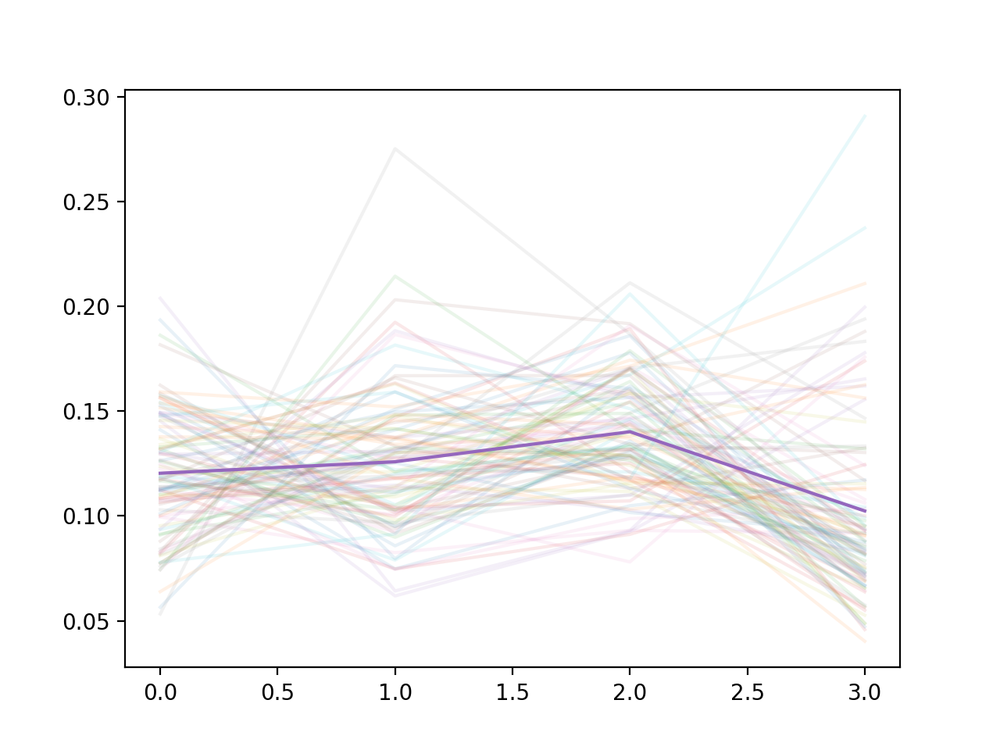

In [374]:
plt.figure()
def compress_pixels(all_residuals):
    xdata = all_residuals.reshape(all_residuals.shape[:2]+(2,4))
    xdata = xdata.reshape((xdata.shape[0],)+(72,)+(xdata.shape[3],))
    return xdata
xdata = compress_pixels(all_residuals)
ydata = compress_pixels(all_eta)
plt.plot(np.std(xdata,axis=1).T/np.std(ydata,axis=1).T,alpha=0.1)
plt.plot(np.mean(np.std(xdata,axis=1).T/np.std(ydata,axis=1).T,axis=1))


In [356]:
all_residuals[-1,:,-1].reshape((6,6))

array([[-0.02500109, -0.01495285,  0.0019867 , -0.03204738,  0.00901219,
         0.00641953],
       [-0.02066874, -0.01995462,  0.00269242, -0.01066732, -0.00755684,
        -0.00464367],
       [-0.0299888 , -0.01373488, -0.01462457,  0.01696639,  0.02720035,
        -0.0049039 ],
       [-0.02771586, -0.03388977, -0.01238077,  0.0283232 ,  0.01202168,
        -0.01729464],
       [-0.03385   , -0.03313936, -0.02201689, -0.02512297, -0.0470692 ,
        -0.07583561],
       [-0.03257181, -0.03492058, -0.0316028 , -0.05219047, -0.09142178,
        -0.14495409]])

In [400]:
aparr = all_params.reshape((nwt,-1))
aresr = all_residuals.reshape((nwt,-1))
import csv

with open('model_params_201215b.csv','w',newline='') as csvfile:
    spamwriter = csv.writer(csvfile, delimiter=',',
                            quotechar='|', quoting=csv.QUOTE_MINIMAL)
    for iwt in range(nwt):
        spamwriter.writerow(aparr[iwt])
        
with open('model_residuals_201215b.csv','w',newline='') as csvfile:
    spamwriter = csv.writer(csvfile, delimiter=',',
                            quotechar='|', quoting=csv.QUOTE_MINIMAL)
    for iwt in range(nwt):
        spamwriter.writerow(aresr[iwt])

In [325]:
with open('l4_mean_activities.csv','w',newline='') as csvfile:
    spamwriter = csv.writer(csvfile, delimiter=',',
                            quotechar='|', quoting=csv.QUOTE_MINIMAL)
    spamwriter.writerow(XXhat[:,0::2].flatten())

In [239]:
irow = 0
with open('model_params_201215b.csv','r') as csvfile:
    spamreader = csv.reader(csvfile, delimiter=',', quotechar='|')
    for row in spamreader:
        if irow == 0:
            print(', '.join(row))
            this_row = row
        irow = irow+1

0.4694994904073579, 0.0, 0.03534363522765815, 0.2367523491008627, -0.7562719901669068, -0.4406183527587695, 0.14852001630304526, -1.0604888213773578, 4.259566827402334, 1.9321961849900935, 2.362259395242312, 5.430016204814645, -0.30414961110203526, 0.0, -2.242884859548141, -0.19447111845408127, 0.0, -0.8960657756767298, -0.07952599950272002, -0.06936076734869298, -3.165192546159239, -0.8087832163716526, -1.15873606537452, -3.8151886811140563, 0.16348107044314877, 0.31148125991121856, 0.018060257430616348, 0.011604882335598145, 1.2139715605684938, 1.0060495881847398, 0.8396451341445073, 1.6436916122669996


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


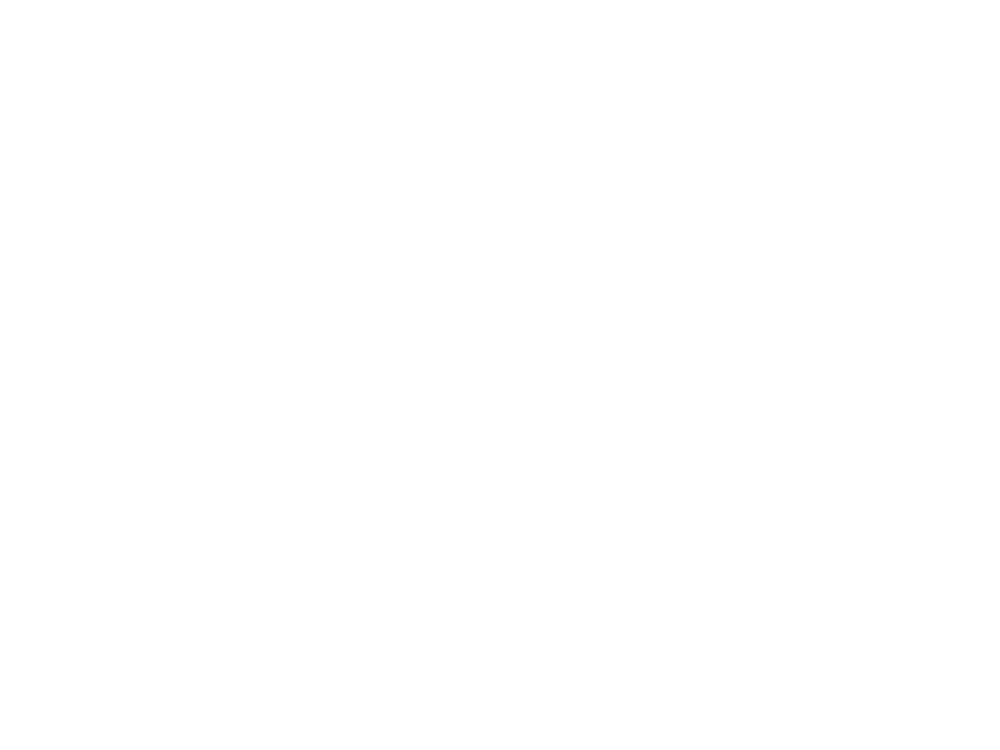

NameError: name 'this_row' is not defined

In [39]:
plt.figure()
ut.imshow_hot_cold(np.array(this_row).reshape((8,4)).astype('float'))
plt.yticks(np.arange(8),['L4','bias','PC','SST','VIP','PV','K',r'$\sigma_0^2$'])
plt.xticks(np.arange(4),['PC','SST','VIP','PV'])
plt.ylim(7.5,-0.5)
plt.colorbar()
# plt.savefig('figures/model_params_201215b_first_fit.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


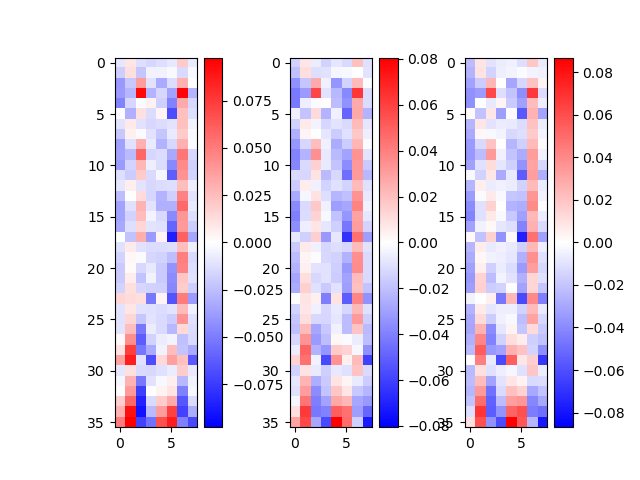

In [266]:
# lcutoff = np.nanpercentile(losses[-1],10)
plt.figure()
for ifit in range(nfits):
    lcutoff = np.nanpercentile(losses[ifit],10)
    good_mdls = [mdl for mdl,ll in zip(mdls[ifit],losses[ifit]<lcutoff) if ll]
    resEta = np.concatenate([good_mdls[iwt].resEta[np.newaxis] for iwt in range(len(good_mdls))],axis=0)
    plt.subplot(1,nfits,ifit+1)
    ut.imshow_hot_cold(np.nanmean(resEta,0))#,mx=0.25
    plt.colorbar()
#     plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


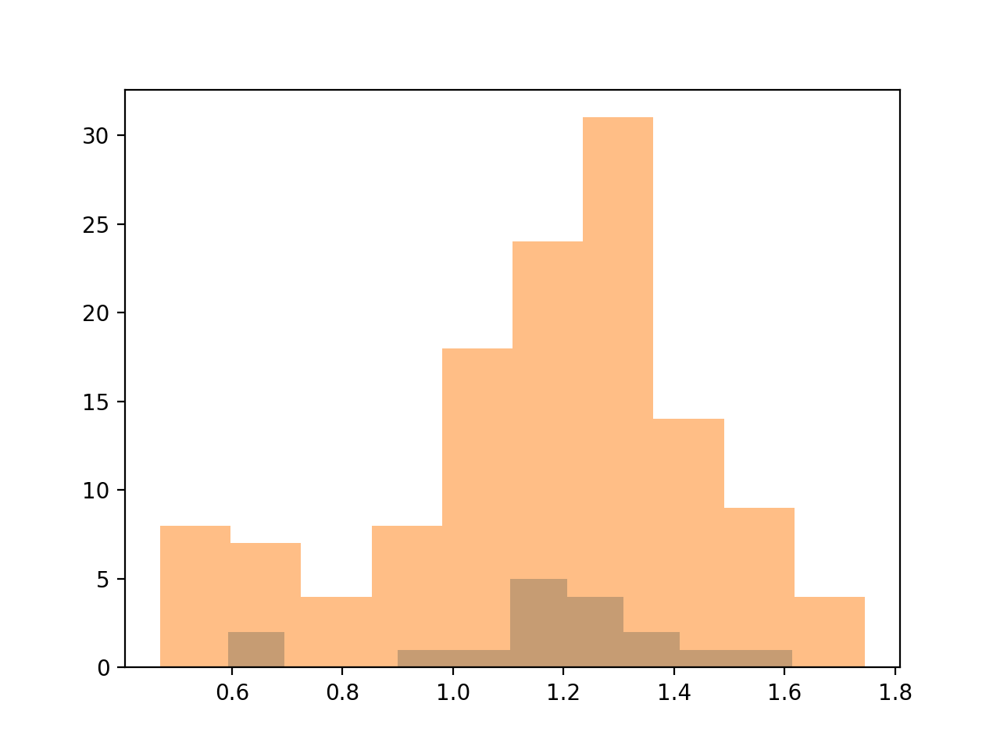

<IPython.core.display.Javascript object>


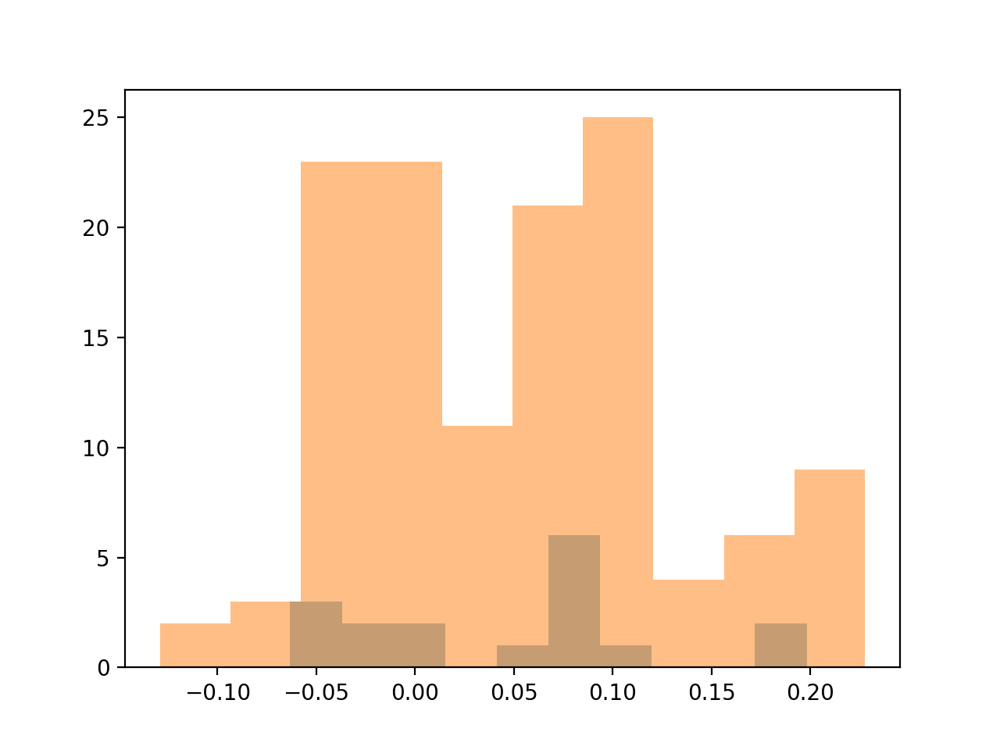

In [1571]:
# lcutoff = 12
itype = 1
for var in [s02s,bls]:
    plt.figure()
    for ifit in [0,1]:
        plt.hist(var[ifit][losses[ifit]<lcutoff,itype],alpha=0.5)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


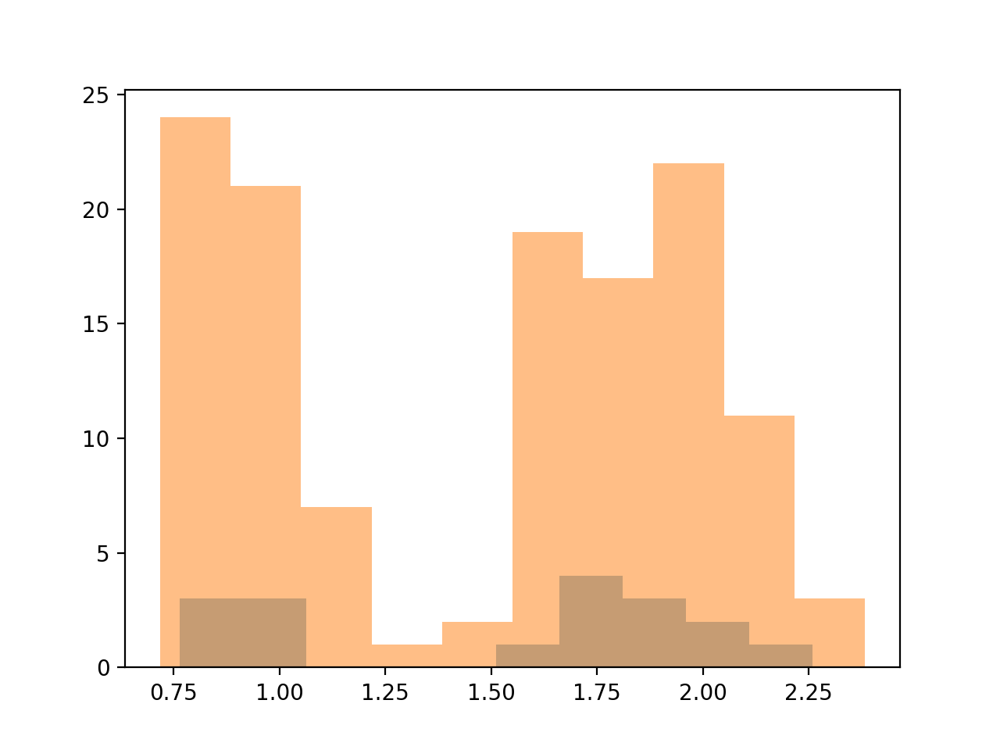

<IPython.core.display.Javascript object>


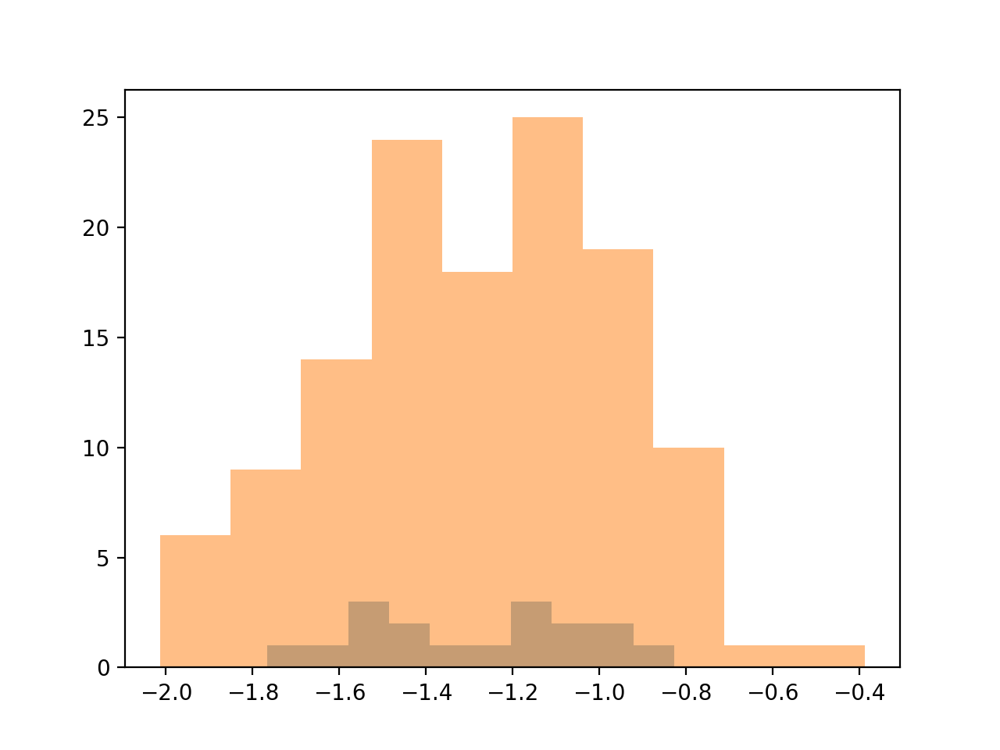

<IPython.core.display.Javascript object>


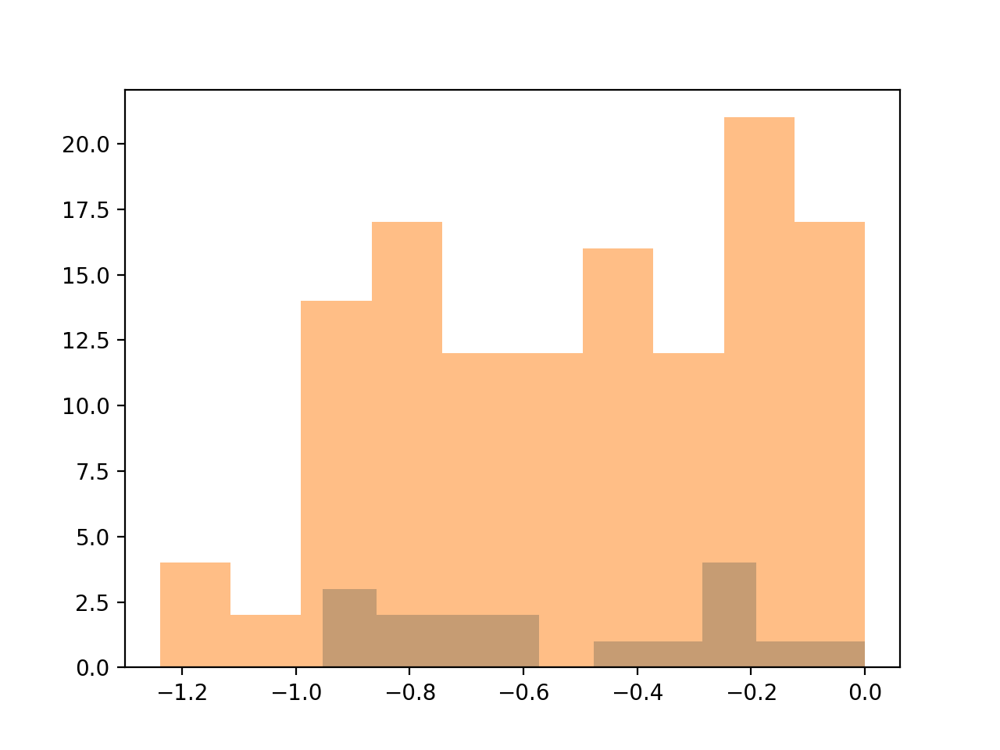

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


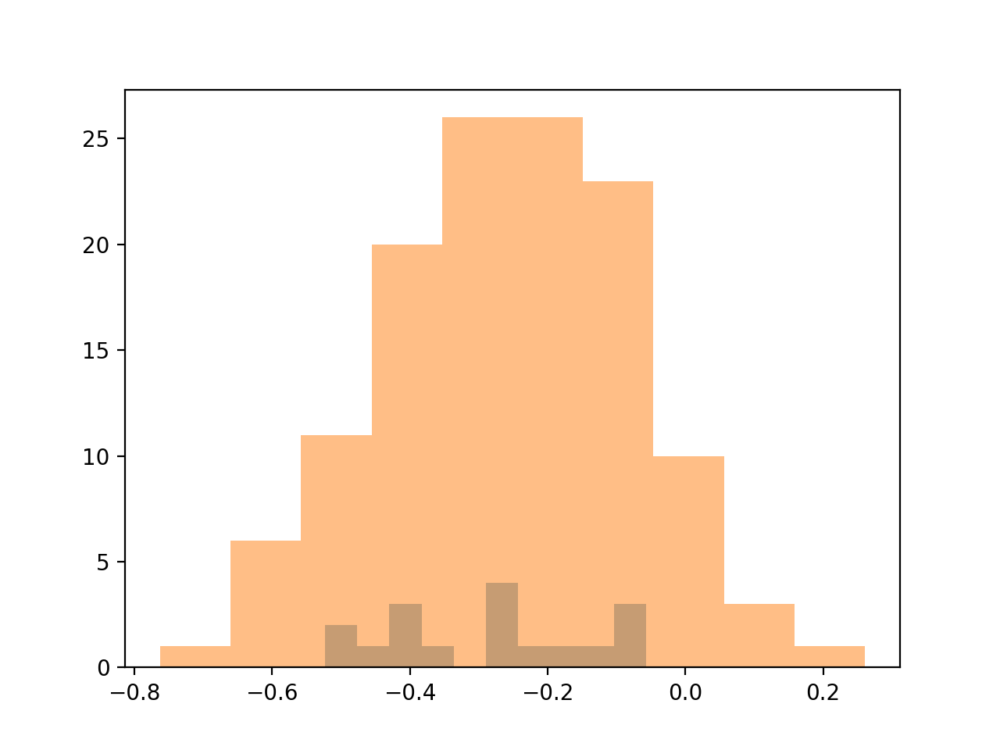

In [1572]:
itype2 = 1
for itype1 in [0,2,3]:
    plt.figure()
    for ifit in range(nfits):
        plt.hist(Wmys[ifit][losses[ifit]<lcutoff,itype1,itype2],alpha=0.5)

plt.figure()
for ifit in range(nfits):
    plt.hist(Wmxs[ifit][losses[ifit]<lcutoff,1,1],alpha=0.5)

In [186]:
YYs[ifit][low_loss[ifit]][:,:,:,itype1].shape

(43, 6, 6)

In [1315]:
# itype1,itype2 = 0,1
# plt.figure()
# xdata,ydata = [YYhat[:,itype].reshape((6,6)) for itype in [itype1,itype2]]
# sca.scatter_size_contrast(xdata,ydata)
# plt.title(np.corrcoef(xdata.flatten(),ydata.flatten())[0,1])

In [1314]:
# lcutoff = 12
# itype1,itype2 = 0,1
# titles = ['baseline','SST cross-space weight 0','VIP, SST cross-space weights 0',r'SST$\rightarrow$VIP weight 0']
# figure_names = ['figures/sst_vs_pc_no_res_%s.eps'%this_lbl for this_lbl in ['baseline','sst_space_0','vip_sst_space_0','w_sst_vip_0']]
# for ifit in range(nfits):
#     plt.figure(figsize=(2.5,2.5))
#     xdata,ydata = [YYs_no_res[ifit][losses[ifit]<lcutoff][:,:,:,itype] for itype in [itype1,itype2]]
#     sca.scatter_size_contrast_errorbar(xdata,ydata)
#     plt.title(titles[ifit])
#     plt.xlabel('PC activity')
#     plt.ylabel('SST activity')
#     plt.tight_layout()
#     plt.savefig(figure_names[ifit])
# #     plt.title(np.corrcoef(xdata.flatten(),ydata.flatten())[0,1])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


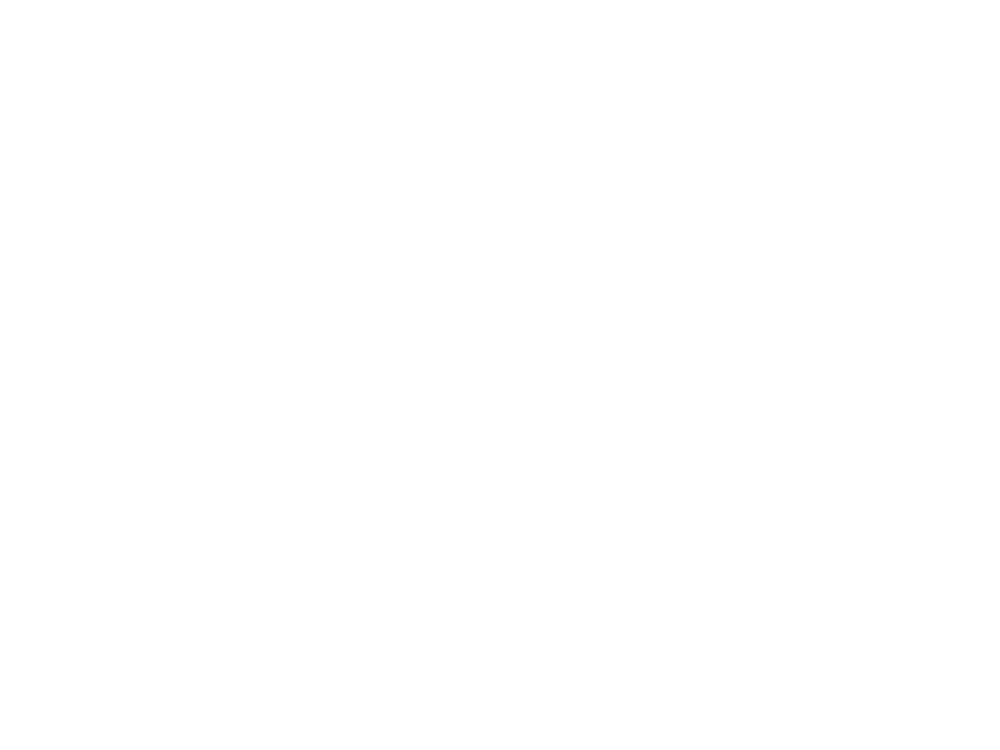

In [142]:
ifit = 5
plt.figure()
for ifit in range(nfits):
    plt.subplot(1,nfits,ifit+1)
    lcutoff = np.nanpercentile(losses[ifit],10)
    ut.imshow_hot_cold(np.concatenate((np.nanmean(Wmys[ifit][losses[ifit]<=lcutoff],0),np.nanmean(Wmxs[ifit][losses[ifit]<=lcutoff],0)),axis=0))
    

In [1575]:
lcutoff

22.37334278823675

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


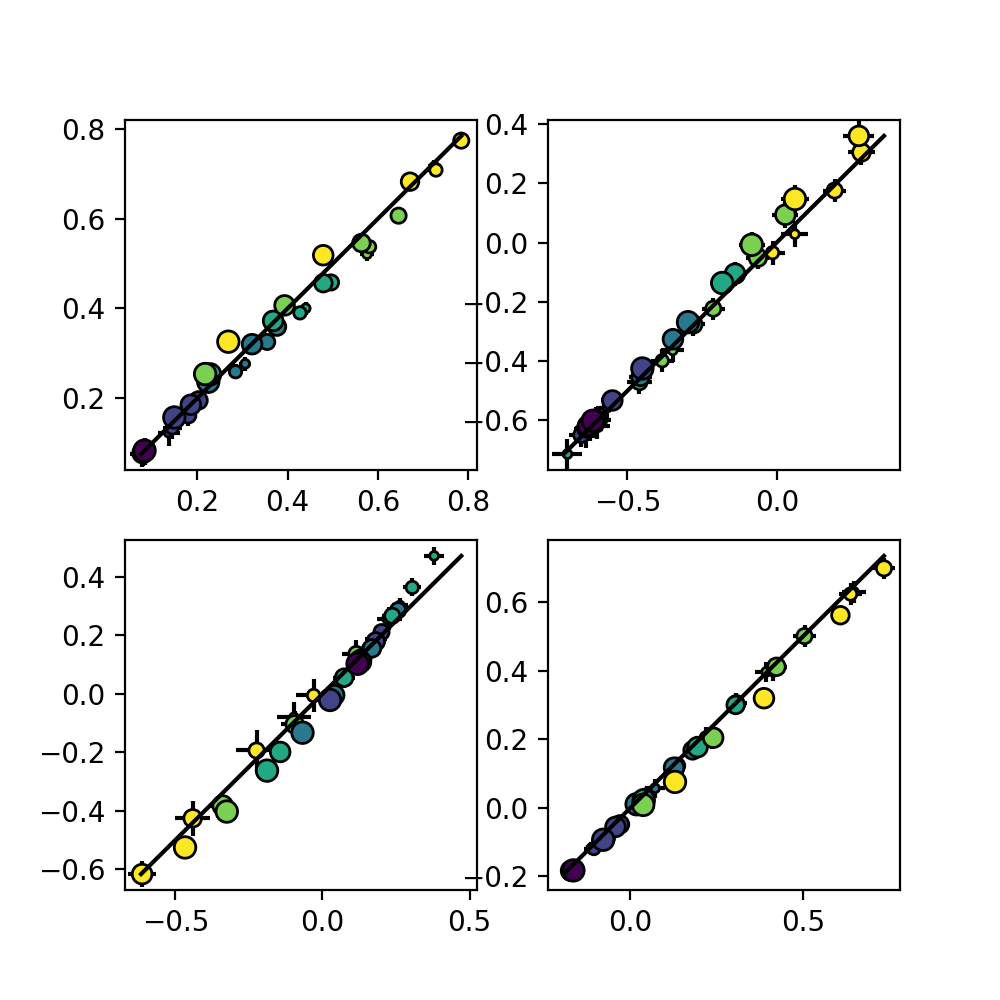

<IPython.core.display.Javascript object>


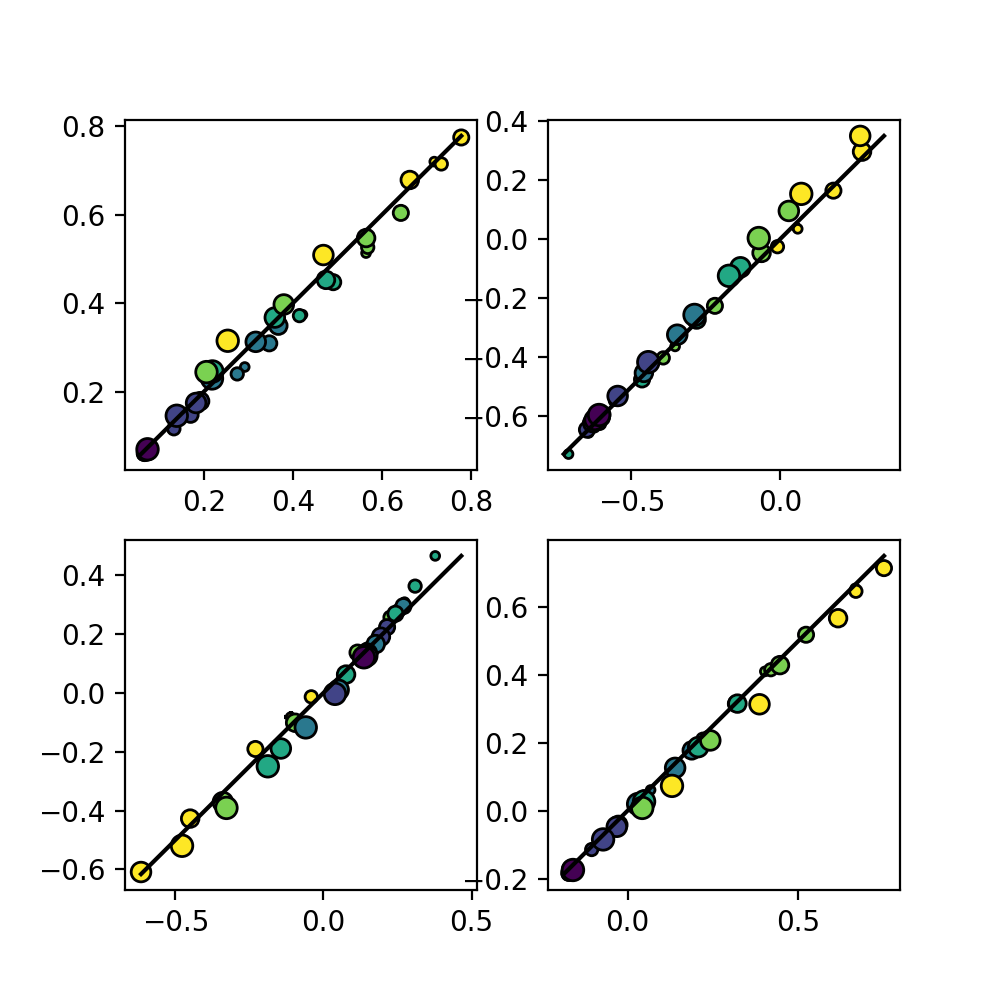

In [1577]:
for ifit in range(len(losses)):
    plt.figure(figsize=(5,5))
    for itype in range(4):
        lkat = losses[ifit]<lcutoff
        good_mdls = [mdl for mdl,ll in zip(mdls[ifit],lkat) if ll]
        resEta = np.concatenate([good_mdls[iwt].resEta[:,itype:itype+1].T for iwt in range(len(good_mdls))],axis=0).reshape((-1,6,6))
        ydata = Etas[ifit][lkat][:,:,:,itype]
        xdata = ydata - resEta
        plt.subplot(2,2,itype+1)
        sca.scatter_size_contrast_errorbar(xdata,ydata)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


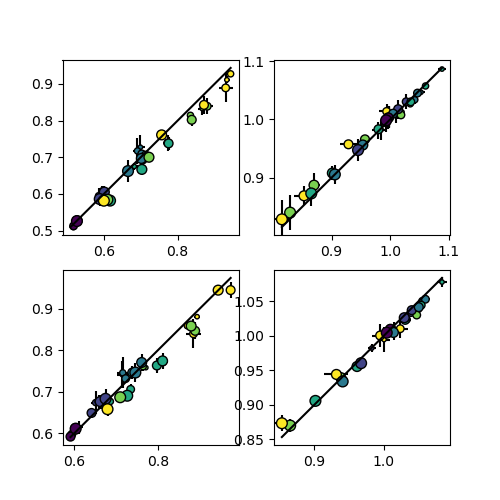

In [1185]:
plt.figure(figsize=(5,5))
for itype in range(4):
    ifit = 1
    xdata = XXs[ifit][losses[ifit]<12,:,:,itype]
    ifit = 2
    ydata = XXs[ifit][losses[ifit]<12,:,:,itype]
    plt.subplot(2,2,itype+1)
    sca.scatter_size_contrast_errorbar(xdata,ydata)

In [ ]:
plt.figure(figsize=(2.5,2.5))

# fit_lbls = ['201203g','201215b','201227b']#['201203g']#['201128a','201130a','201130b']#['201125d','201126a','201127a','201127c']#['201125b','201125c','201125d','201125e']
fit_lbls = ['201215b']#['201227b']#['201203g']#['201128a','201130a','201130b']#['201125d','201126a','201127a','201127c']#['201125b','201125c','201125d','201125e']
# fit_lbls = ['210430e']

weights_files,weights_filenames = [],[]

for ifit,fit_lbl in enumerate(fit_lbls):
    
    these_weights_files,these_weights_filenames = get_weights_files(fit_lbl)

    weights_files = weights_files + these_weights_files
    weights_filenames = weights_filenames + these_weights_filenames
    
nfits = 1

wt_dicts = [{} for ifit in range(nfits)]

Ks,Wmys,Wmxs,s02s,bls,YYs,XXs,Etas,h1s,h2s,losses,couplings,couplings_pcpv,Xcouplings,phis,mono_couplings = [[None for ifit in range(nfits)] for ivar in range(16)]
    
for ifit in range(nfits):#,fit_lbl in enumerate(fit_lbls):

    nfiles = len(weights_files)
    # Ts = np.zeros((nfiles,nQ))
    Ks[ifit] = np.zeros((nfiles,nQ))
    Wmys[ifit] = np.zeros((nfiles,nQ,nQ))
    Wmxs[ifit] = np.zeros((nfiles,nP,nQ))
    s02s[ifit] = np.zeros((nfiles,nQ))
    bls[ifit] = np.zeros((nfiles,nQ))
    YYs[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    XXs[ifit] = np.zeros((nfiles,6,6,nP*nS*nT))
    Etas[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    # Eta1s = np.zeros((nfiles,6,6,nQ*nS*nT))
    # Eta2s = np.zeros((nfiles,6,6,nQ*nS*nT))
    h1s[ifit] = np.zeros((nfiles,))
    h2s[ifit] = np.zeros((nfiles,))
    losses[ifit] = np.zeros((nfiles,))
    couplings[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    mono_couplings[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    # couplings with phiPV = phiPC fixed
    couplings_pcpv[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
    Xcouplings[ifit] = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
    phis[ifit] = np.zeros((nfiles,6,6,nQ*nS*nT))
    for iwt,weights_file in enumerate(weights_files):
        Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
        wt_dicts[ifit] = Wstar_dict['wt_dict']
        try:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
            amp = np.ones((nQ*nS*nT,))
        except:
            Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']
        losses[ifit][iwt] = Wstar_dict['loss']
    #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,h3,Eta1,Eta2,Eta3 = Wstar_dict['as_list']
        WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
        WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
        tiled_s02 = np.tile(s02,nS*nT)
    #     Ts[iwt] = T
        Ks[ifit][iwt] = K
        Wmys[ifit][iwt] = Wmy
        Wmxs[ifit][iwt] = Wmx
        s02s[ifit][iwt] = s02
        bls[ifit][iwt] = bl
        YYs[ifit][iwt] = sim_utils.f_miller_troyer(Eta,Xi**2+tiled_s02).reshape((6,6,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
        XXs[ifit][iwt] = XX.reshape((6,6,nP*nS*nT))
        Etas[ifit][iwt] = Eta.reshape((6,6,nQ*nS*nT))
        h1s[ifit][iwt] = h1
        h2s[ifit][iwt] = h2
    #     Eta1s[iwt] = Eta1.reshape((6,6,nQ*nS*nT))
    #     Eta2s[iwt] = Eta2.reshape((6,6,nQ*nS*nT))
        for istim in range(nN):
            iistim,jjstim = np.unravel_index(istim,(6,6))
            phis[ifit][iwt,iistim,jjstim] = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            phipcpv = phis[ifit][iwt,iistim,jjstim].copy()
            phipcpv[3::4] = phipcpv[0::4]
            Phi = np.diag(phis[ifit][iwt,iistim,jjstim])
            Phipcpv = np.diag(phipcpv)
            couplings[ifit][iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            mono_couplings[ifit][iwt,iistim,jjstim] = (WWmy @ Phi)
            Xcouplings[ifit][iwt,iistim,jjstim] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            couplings_pcpv[ifit][iwt,iistim,jjstim] = Phipcpv @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phipcpv)
    # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
    # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

    # plt.figure(figsize=(2.5,2.5))
    plt.hist(losses[ifit][losses[ifit]<1e2],bins=20,alpha=0.5)
    ut.erase_top_right()
    plt.xlabel('loss')
    plt.ylabel('# of model fits')
    plt.tight_layout()
# plt.savefig('figures/model_fits_random_inits_simulate2_true.eps')


In [ ]:
len(weights_files)

In [ ]:
    # for generating a figure that shows activities used to fit model
    nsize,ncontrast = 6,6
    
    npfile = np.load(ca_data_file,allow_pickle=True)[()]#,{'rs':rs,'rs_denoise':rs_denoise},allow_pickle=True)
    rs = npfile['rs']
    #rs_denoise = npfile['rs_denoise']
    
    nsize,ncontrast,ndir = 6,6,8
    #ori_dirs = [[0,4],[2,6]] #[[0,4],[1,3,5,7],[2,6]]
    ori_dirs = [[0,1,2,3,4,5,6,7]]
    nT = len(ori_dirs)
    nS = len(rs[0])
    
    def sum_to_1(r):
        R = r.reshape((r.shape[0],-1))
        #R = R/np.nansum(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
        R = R/np.nansum(R,axis=1)[:,np.newaxis] # changed 8/28
        return R
    
    def norm_to_mean(r):
        R = r.reshape((r.shape[0],-1))
        R = R/np.nanmean(R[:,~np.isnan(R.sum(0))],axis=1)[:,np.newaxis]
        return R
    
    Rs = [[None,None] for i in range(len(rs))]
    Rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]
    rso = [[[None for iT in range(nT)] for iS in range(nS)] for icelltype in range(len(rs))]
    
    for iR,r in enumerate(rs):#rs_denoise):
        #print(iR)
        for ialign in range(nS):
            #Rs[iR][ialign] = r[ialign][:,:nsize,:]
            #sm = np.nanmean(np.nansum(np.nansum(Rs[iR][ialign],1),1))
            #Rs[iR][ialign] = Rs[iR][ialign]/sm
            #print('frac isnan Rs %d,%d: %f'%(iR,ialign,np.isnan(r[ialign]).mean()))
            Rs[iR][ialign] = sum_to_1(r[ialign][:,:nsize,:])
    #         Rs[iR][ialign] = von_mises_denoise(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir)))
    
    kernel = np.ones((1,2,2))
    kernel = kernel/kernel.sum()
    
    for iR,r in enumerate(rs):
        for ialign in range(nS):
            for iori in range(nT):
                Rso[iR][ialign][iori] = np.nanmean(Rs[iR][ialign].reshape((-1,nsize,ncontrast,ndir))[:,:,:,ori_dirs[iori]],-1)
                Rso[iR][ialign][iori][:,:,0] = np.nanmean(Rso[iR][ialign][iori][:,:,0],1)[:,np.newaxis] # average 0 contrast values
                Rso[iR][ialign][iori][:,1:,1:] = ssi.convolve(Rso[iR][ialign][iori],kernel,'valid')
                Rso[iR][ialign][iori] = Rso[iR][ialign][iori].reshape(Rso[iR][ialign][iori].shape[0],-1)
                
    mx = [None for iS in range(nS)]
    for iS in range(nS):
        mx[iS] = np.zeros((ncelltypes,))
        yy = [None for icelltype in range(ncelltypes)]
        for icelltype in range(ncelltypes):
            yy[icelltype] = np.nanmean(Rso[icelltype][iS][0],0)
            mx[iS][icelltype] = np.nanmax(yy[icelltype])
            
    yy = [Rso[icelltype][iS][iT]/mx[iS][icelltype][np.newaxis] for icelltype in range(1,ncelltypes)]
    yy = [sim_utils.gen_size_tuning(y.reshape((-1,6,6))) for y in yy]
    
    xx = [Rso[icelltype][iS][iT]/mx[iS][icelltype][np.newaxis] for icelltype in range(1)]
    xx = [sim_utils.gen_size_tuning(y.reshape((-1,6,6))) for y in xx]

In [ ]:
this_ncontrast = 3
cfrac = np.linspace(1,0,this_ncontrast+1)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
# c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.5,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
lbls = ['PC','SST','VIP','PV']
usize = np.array([5,8,13,22,36,60])
ucontrast = np.array([0,6,12,25,50,100])

In [ ]:
lbls

In [ ]:
for itype in range(4):
    plt.figure(figsize=(2.5,2.5))
    ut.plot_pct_errorbars_hillel(usize0,yy[itype][:,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),delta=0.5,colors=colors[itype+1])
    ut.erase_top_right()
    plt.xlabel('size ($^o$)')
    plt.ylabel('event rate/max')
    plt.gca().set_ylim(bottom=0)
#     plt.savefig('figures/%s_data_used_to_fit.eps'%lbls[itype])
    
for itype in range(1):
    plt.figure(figsize=(2.5,2.5))
    ut.plot_pct_errorbars_hillel(usize0,xx[itype][:,:,[1,3,5]].transpose((0,2,1)),pct=(16,84),delta=0.5,colors=colors[itype])
    ut.erase_top_right()
    plt.xlabel('size ($^o$)')
    plt.ylabel('event rate/max')
    plt.gca().set_ylim(bottom=0)
#     plt.savefig('figures/L4_%s_data_used_to_fit.eps'%lbls[itype])

In [ ]:
nfiles = len(weights_files)
# couplings with one of the phi's fixed, phiI = mean(phiI)
couplings_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
couplings_del = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ,nQ))
Xcouplings_fixed = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT,nQ))
# couplings with phiPC = mean(phiPC) and phiPV = mean(phiPV) fixed
couplings_pc_rec_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
couplings_pcpv_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
couplings_pcpv_rec_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
couplings_pcpv_fixed_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
couplings_pcpv_rec_fixed_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
mult_mean = 1 # 0 or 1
for iwt,weights_file in enumerate(weights_files):
#     print(iwt)
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)#['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
    tiled_s02 = np.tile(s02,nS*nT)
    all_phis = calnet.utils.fprime_miller_troyer(Eta,Xi**2+tiled_s02)
    for icelltype in range(nQ):
        mean_phi = np.mean(all_phis[:,icelltype::nQ])*mult_mean
        for istim in range(nN):
            iistim,jjstim = np.unravel_index(istim,(6,6))        
            these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            couplings_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            Xcouplings_fixed[iwt,iistim,jjstim,:,:,icelltype] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
    for icelltype in range(nQ):
        for jcelltype in range(nQ):
            for istim in range(nN):
                iistim,jjstim = np.unravel_index(istim,(6,6))        
                these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
                Phi = np.diag(these_phis)
                this_Wmy = Wmy.copy()
                this_Wmy[icelltype,jcelltype] = 0
                this_WWmy = calnet.utils.gen_Weight_k_kappa_t(this_Wmy,K,kappa,T,nS=nS,nT=nT)
                couplings_del[iwt,iistim,jjstim,:,:,icelltype,jcelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - this_WWmy @ Phi)
    mean_phi_pc = np.mean(all_phis[:,0::nQ])*mult_mean
    mean_phi_pv = np.mean(all_phis[:,3::nQ])*mult_mean
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))        
        these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
        
        Phipcrec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
        Phipcrec[0::nQ][:,0::nQ] = mean_phi_pc
        Phi = np.diag(these_phis)
        couplings_pc_rec_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phipcrec)
        
        Phirec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
        Phirec[0::nQ][:,0::nQ] = mean_phi_pc
        Phirec[3::nQ][:,0::nQ] = mean_phi_pc
        Phirec[0::nQ][:,3::nQ] = mean_phi_pv
        Phirec[3::nQ][:,3::nQ] = mean_phi_pv
        Phi = np.diag(these_phis)
        couplings_pcpv_rec_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phirec)
        
        these_phis[0::nQ] = mean_phi_pc
        these_phis[3::nQ] = mean_phi_pv
        Phi = np.diag(these_phis)
        couplings_pcpv_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
        
    for icelltype in range(nQ):
        for istim in range(nN):
            mean_phi = np.mean(all_phis[:,icelltype::nQ])*mult_mean
            iistim,jjstim = np.unravel_index(istim,(6,6))        
            these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
            these_phis[0::nQ] = mean_phi_pc
            these_phis[3::nQ] = mean_phi_pv
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            couplings_pcpv_fixed_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            
            these_phis = all_phis[istim].copy()
            these_phis[icelltype::nQ] = mean_phi
            Phi = np.diag(these_phis)
            Phirec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
            Phirec[0::nQ][:,0::nQ] = mean_phi_pc
            Phirec[3::nQ][:,0::nQ] = mean_phi_pc
            Phirec[0::nQ][:,3::nQ] = mean_phi_pv
            Phirec[3::nQ][:,3::nQ] = mean_phi_pv
            couplings_pcpv_rec_fixed_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phirec)
            # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

<IPython.core.display.Javascript object>


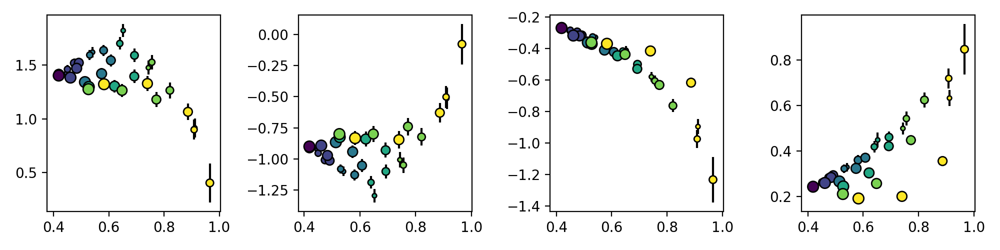

-0.2178556935131524
0.16554844380291459
-0.5190777916794137
0.43135052354179426


<IPython.core.display.Javascript object>


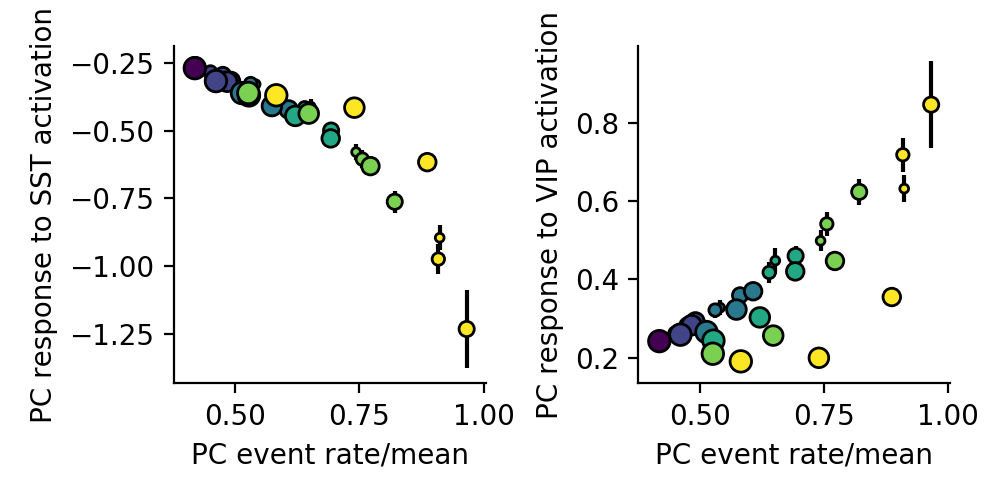

-0.5190777916794137
0.43135052354179426


<IPython.core.display.Javascript object>


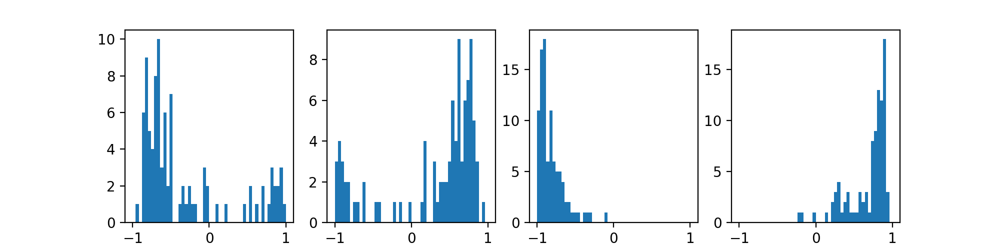

<IPython.core.display.Javascript object>


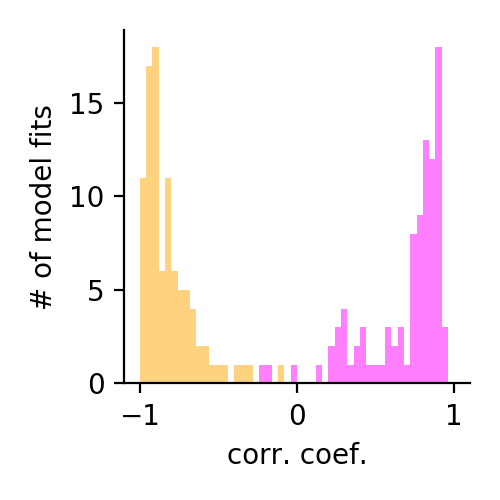

In [486]:
ifit = -1
i,j = 2,0
itype = 0
ccs = np.zeros((low_loss[ifit].sum(),))
plt.figure(figsize=(10,2.5))
for ii,this_i in enumerate([0,3,1,2]):
    plt.subplot(1,4,ii+1)
    sca.scatter_size_contrast_errorbar(YYs[ifit][low_loss[ifit]][:,:,:,itype],couplings_total[ifit][low_loss[ifit]][:,:,:,this_i,j],equality_line=False,square=False)
    plt.tight_layout()
    print(np.corrcoef(YYs[ifit][low_loss[ifit]][:,:,:,itype].flatten(),couplings_total[ifit][low_loss[ifit]][:,:,:,this_i,j].flatten())[0,1])

plt.figure(figsize=(5,2.5))
type_lbls = ['','SST','VIP','']
for ii,this_i in enumerate([1,2]):
    plt.subplot(1,2,ii+1)
    sca.scatter_size_contrast_errorbar(YYs[ifit][low_loss[ifit]][:,:,:,itype],couplings_total[ifit][low_loss[ifit]][:,:,:,this_i,j],equality_line=False,square=False)
    plt.xlabel('PC event rate/mean')
    plt.ylabel('PC response to %s activation'%type_lbls[this_i])
    ut.erase_top_right()
    print(np.corrcoef(YYs[ifit][low_loss[ifit]][:,:,:,itype].flatten(),couplings_total[ifit][low_loss[ifit]][:,:,:,this_i,j].flatten())[0,1])
plt.tight_layout()
plt.savefig('figures/pc_response_to_sst_vip_activation.eps')
    
plt.figure(figsize=(10,2.5))
for ii,this_i in enumerate([0,3,1,2]):
    plt.subplot(1,4,ii+1)
    for iwt in range(low_loss[ifit].sum()):
        ccs[iwt] = np.corrcoef(YYs[ifit][low_loss[ifit]][iwt,:,:,itype].flatten(),couplings_total[ifit][low_loss[ifit]][iwt,:,:,this_i,j].flatten())[0,1]
    plt.hist(ccs,bins=np.linspace(-1,1,51))
    
these_cs = [np.array((1,0.65,0)),np.array((1,0,1))]
plt.figure(figsize=(2.5,2.5))
for ii,this_i in enumerate([1,2]):
    for iwt in range(low_loss[ifit].sum()):
        ccs[iwt] = np.corrcoef(YYs[ifit][low_loss[ifit]][iwt,:,:,itype].flatten(),couplings_total[ifit][low_loss[ifit]][iwt,:,:,this_i,j].flatten())[0,1]
    plt.hist(ccs,bins=np.linspace(-1,1,51),color=these_cs[ii],alpha=0.5)
plt.ylabel('# of model fits')
plt.xlabel('corr. coef.')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/pc_rate_vs_sst_vip_coupling_hist.jpg',dpi=300)

In [ ]:
npix = 100
x = np.linspace(-1,1,npix)
plt.figure(figsize=(2.5,2.5))
ydata = np.zeros((Wmxs[ifit].shape[0],4)+x.shape)
nsd = 1
for iwt in range(1):#Wmxs[ifit].shape[0]):
    for itype in range(4):
        mn = Etas[ifit][iwt,:,:,itype].mean()
        sd = Etas[ifit][iwt,:,:,itype].std()
        ydata[iwt,itype] = calnet.utils.fprime_miller_troyer(np.linspace(mn-nsd*sd,mn+nsd*sd,npix),s02s[ifit][iwt,itype])
# for iwt in range(25):
#     plt.subplot(5,5,iwt+1)
for itype in range(4):
    plt.plot(x,np.nanmean(ydata[:,itype],0))
plt.tight_layout()

In [195]:
# np.save('low_loss_no_opto_weights_files_%s.npy'%'_'.join(fit_lbls),low_loss_weights_files)


In [239]:
Ks[ifit]

5

linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting


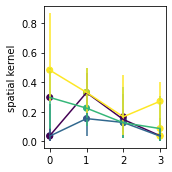

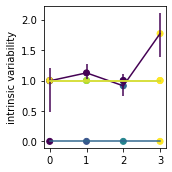

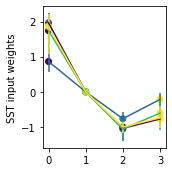

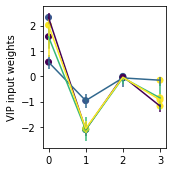

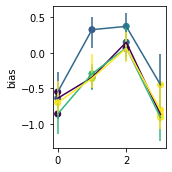

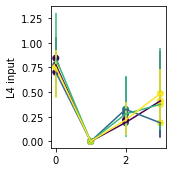

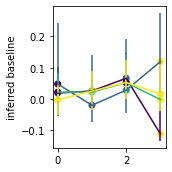

In [43]:
cs = [np.array((0,0,1))[np.newaxis],np.array((0,1,0))[np.newaxis],np.array((0,0,0.5))[np.newaxis],np.array((0,0.5,0))[np.newaxis],np.random.rand(3)[np.newaxis]]
cs = [c[np.newaxis] for c in plt.cm.viridis(np.linspace(0,1,nfits))]

reload(ut)

def plot_fn(x,y,colors=None):
    ut.plot_pct_errorbars_hillel(x,y,colors=colors,pct=(16,84))

# reference_ifit = -1
nfits = len(losses)
low_loss = [None for ifit in range(nfits)]
for ifit in range(nfits):
    reference_ifit = ifit
#     low_loss[ifit] = (losses[ifit] < np.nanpercentile(losses[reference_ifit],20)) #,1 #ifit],10)) 
    low_loss[ifit] = (losses[ifit] < np.nanpercentile(losses[ifit],10))

plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    plot_fn(np.arange(4),Ks[ifit][low_loss[ifit]][:,np.newaxis,:],colors=cs[ifit])
    plt.ylabel('spatial kernel')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    plot_fn(np.arange(4),s02s[ifit][low_loss[ifit]][:,np.newaxis,:],colors=cs[ifit])
    plt.ylabel('intrinsic variability')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    plot_fn(np.arange(4),Wmys[ifit][low_loss[ifit]][:,:,1:2].transpose((0,2,1)),colors=cs[ifit])
    plt.ylabel('SST input weights')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    plot_fn(np.arange(4),Wmys[ifit][low_loss[ifit]][:,:,2:3].transpose((0,2,1)),colors=cs[ifit])
    plt.ylabel('VIP input weights')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    plot_fn(np.arange(4),Wmxs[ifit][low_loss[ifit]][:,1:2,:],colors=cs[ifit])
    plt.ylabel('bias')
    plt.tight_layout()
        
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    plot_fn(np.arange(4),Wmxs[ifit][low_loss[ifit]][:,0:1,:],colors=cs[ifit])
    plt.ylabel('L4 input')
    plt.tight_layout()
    
plt.figure(figsize=(2.5,2.5))
for ifit in range(nfits):
    plot_fn(np.arange(4),bls[ifit][low_loss[ifit]][:,np.newaxis,:],colors=cs[ifit])
    plt.ylabel('inferred baseline')
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


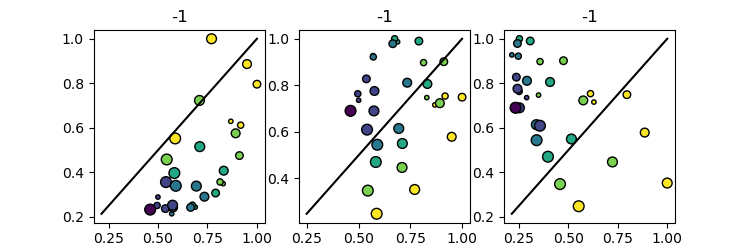

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:16: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  app.launch_new_instance()


<IPython.core.display.Javascript object>


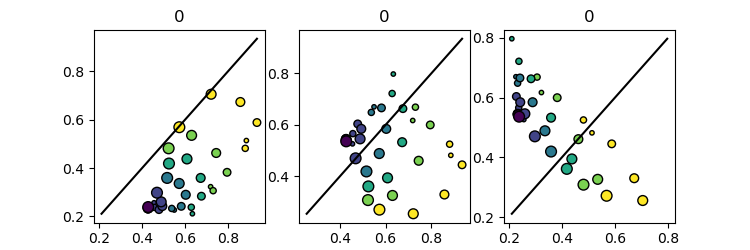

<IPython.core.display.Javascript object>


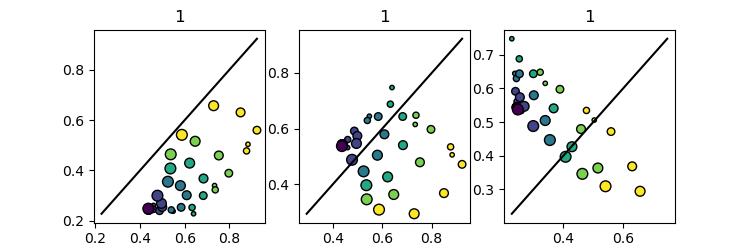

<IPython.core.display.Javascript object>


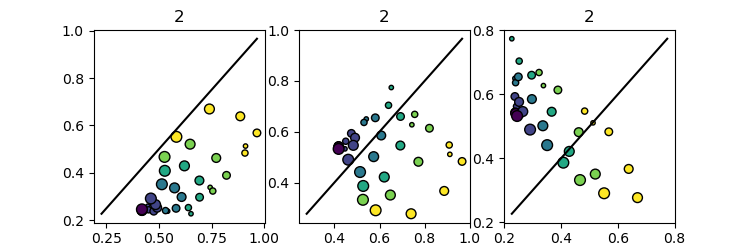

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


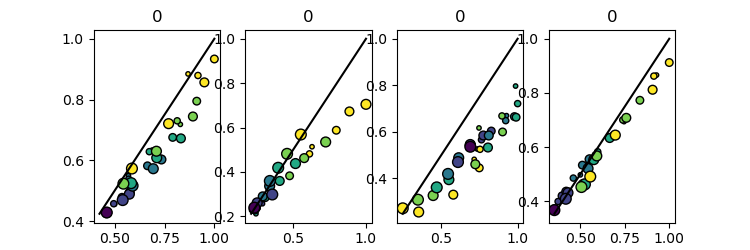

<IPython.core.display.Javascript object>


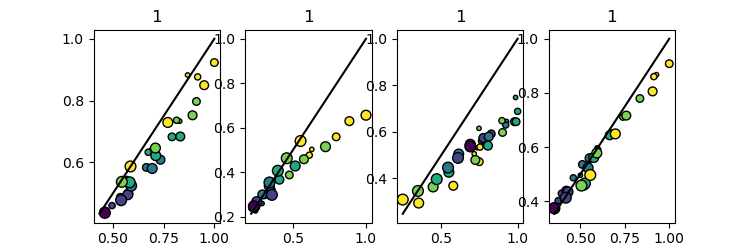

<IPython.core.display.Javascript object>


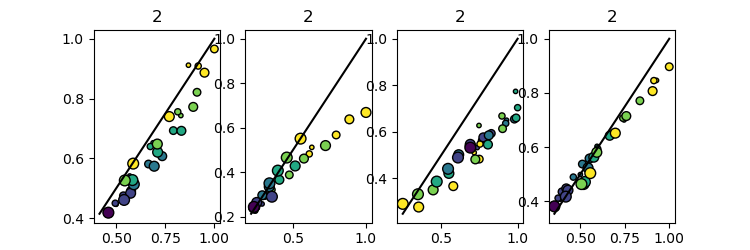

In [294]:
nfits = len(YYs)
ifit = -1

# lcutoff = 12
itype1,itype2 = 0,3
itypes = [[0,1],[0,2],[1,2]]

plt.figure(figsize=(7.5,2.5))
for iitype in range(3):
    itype1,itype2 = itypes[iitype]
    plt.subplot(1,3,iitype+1)
    sca.scatter_size_contrast(YYhat.reshape((6,6,8))[:,:,itype1],YYhat.reshape((6,6,8))[:,:,itype2])
    plt.title(ifit)

for ifit in range(nfits):
    plt.figure(figsize=(7.5,2.5))
    for iitype in range(3):
        itype1,itype2 = itypes[iitype]
        plt.subplot(1,3,iitype+1)
        sca.scatter_size_contrast_errorbar(YYs[ifit][low_loss[ifit]][:,:,:,itype1],YYs[ifit][low_loss[ifit]][:,:,:,itype2])
        plt.title(ifit)
        
for ifit in range(nfits):
    plt.figure(figsize=(7.5,2.5))
    for iitype in range(4):
        itype1,itype2 = iitype,iitype
        plt.subplot(1,4,iitype+1)
        sca.scatter_size_contrast_errorbar(YYhat.reshape((6,6,8))[np.newaxis,:,:,itype1],YYs[ifit][low_loss[ifit]][:,:,:,itype2])
        plt.title(ifit)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


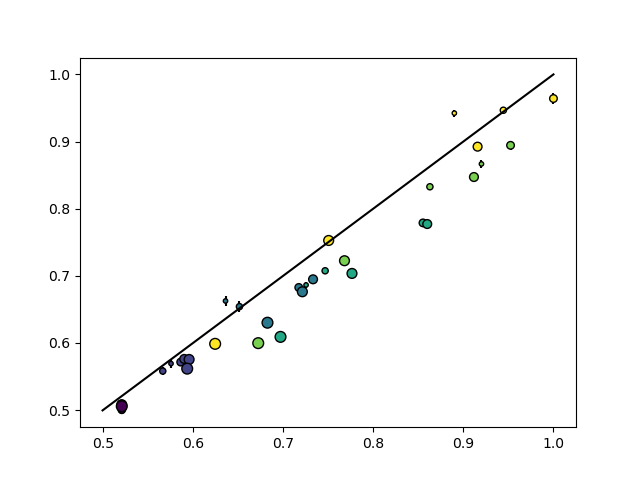

In [258]:
ifit = 0
itype1,itype2 = 0,0
plt.figure()
sca.scatter_size_contrast_errorbar(XXhat.reshape((6,6,4))[np.newaxis,:,:,itype1],XXs[ifit][low_loss[ifit]][:,:,:,itype2])


In [295]:
plt.close('all')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


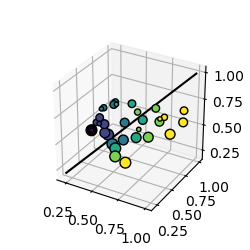

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


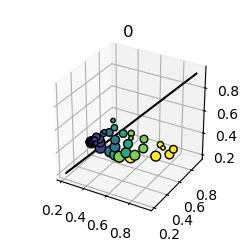

<IPython.core.display.Javascript object>


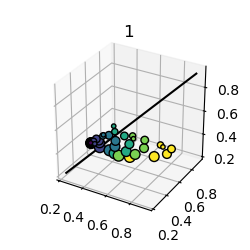

<IPython.core.display.Javascript object>


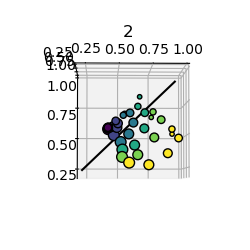

In [259]:

# lcutoff = 12
itype1,itype2 = 0,3
itypes = [0,1,2]

reload(sca)

plt.figure(figsize=(2.5,2.5))
sca.scatter3d_size_contrast(*[YYhat.reshape((6,6,8))[:,:,itype] for itype in itypes])
#     plt.title(ifit)

for ifit in range(nfits):
    plt.figure(figsize=(2.5,2.5))
#     for iitype in range(3):
#         itype1,itype2 = itypes[iitype]
#         plt.subplot(1,3,iitype+1)
    sca.scatter3d_size_contrast(*[np.nanmean(YYs[ifit][low_loss[ifit]],0)[:,:,itype] for itype in itypes])
    plt.title(ifit)

<IPython.core.display.Javascript object>


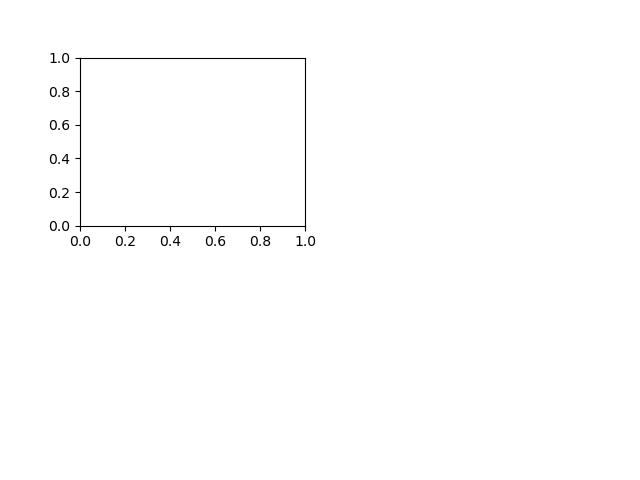

NameError: name 'couplings_wderiv_celltype' is not defined

In [41]:
for ifit in range(nfits):
    plt.figure()
    for itype in range(4):
        plt.subplot(2,2,itype+1)
        ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_wderiv_celltype[ifit][low_loss[ifit],:,:,0,itype,1,0])

In [42]:
pcts = [16,84]
lims = [(-1,1),(-0.1,3),(-3,0.1),(-6,0.1)]
ifit = -1
cs = ['C0','C0','C0','C0']
these_datas = [[Wmxs[ifit][low_loss[ifit]][:,1,1],Wmxs[ifit][low_loss[ifit]][:,1,2]],\
               [Wmys[ifit][low_loss[ifit]][:,0,1],Wmys[ifit][low_loss[ifit]][:,0,2]],\
               [Wmys[ifit][low_loss[ifit]][:,1,2],Wmys[ifit][low_loss[ifit]][:,2,1]],\
              [Wmys[ifit][low_loss[ifit]][:,0,1]*Wmys[ifit][low_loss[ifit]][:,1,2],Wmys[ifit][low_loss[ifit]][:,0,2]*Wmys[ifit][low_loss[ifit]][:,2,1]]]
these_lbls = [['SST bias current','VIP bias current'],\
             [r'PC$\rightarrow$SST weight',r'PC$\rightarrow$VIP weight'],\
             [r'SST$\rightarrow$VIP weight',r'VIP$\rightarrow$SST weight'],\
             [r'(PC$\rightarrow$SST)$\cdot$(SST$\rightarrow$VIP) weight',\
              r'(PC$\rightarrow$VIP)$\cdot$(VIP$\rightarrow$SST) weight']]
filenames = ['figures/vip_bias_current_vs_sst_bias_current.eps',\
            'figures/pc_vip_vs_pc_sst.eps',\
            'figures/vip_sst_vs_sst_vip.eps',\
            'figures/pc_vip_sst_vs_pc_sst_vip.eps']

for lim,this_data,this_lbl,filename,c in zip(lims,these_datas,these_lbls,filenames,cs):
    plt.figure(figsize=(2.5,2.5))
    xdata,ydata = this_data
    xlbl,ylbl = this_lbl
    plt.scatter(xdata,ydata,edgecolor='k',c=c)
    lbx,ubx = [np.nanpercentile(xdata,p) for p in pcts]#ut.bootstrap(xdata,axis=0,fn=np.nanmean,pct=(50,16,84))
    lby,uby = [np.nanpercentile(ydata,p) for p in pcts]#ut.bootstrap(xdata,axis=0,fn=np.nanmean,pct=(50,16,84))
    mnx = np.nanmean(xdata)
    mny = np.nanmean(ydata)
    xerr = np.concatenate(((mnx-lbx)[np.newaxis],(ubx-mnx)[np.newaxis]),axis=0)
    yerr = np.concatenate(((mny-lby)[np.newaxis],(uby-mny)[np.newaxis]),axis=0)
#     plt.errorbar(1,1,xerr=1,yerr=1)
    plt.errorbar(mnx[np.newaxis],mny[np.newaxis],xerr=xerr[:,np.newaxis],yerr=yerr[:,np.newaxis],c='k',fmt='none')
    plt.plot(lim,lim,c='k',linestyle='dashed')
    ut.erase_top_right()
    plt.xlim(lim)
    plt.ylim(lim)
    plt.axhline(0,c='k')
    plt.axvline(0,c='k')
    plt.xlabel(xlbl)
    plt.ylabel(ylbl)
    plt.tight_layout()
    print((mnx,mny))
    print(sst.wilcoxon(xdata,ydata))
    print('%d/%d greater'%(sum(xdata>ydata),xdata.size))
#     plt.savefig(filename)


NameError: name 'low_loss' is not defined

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


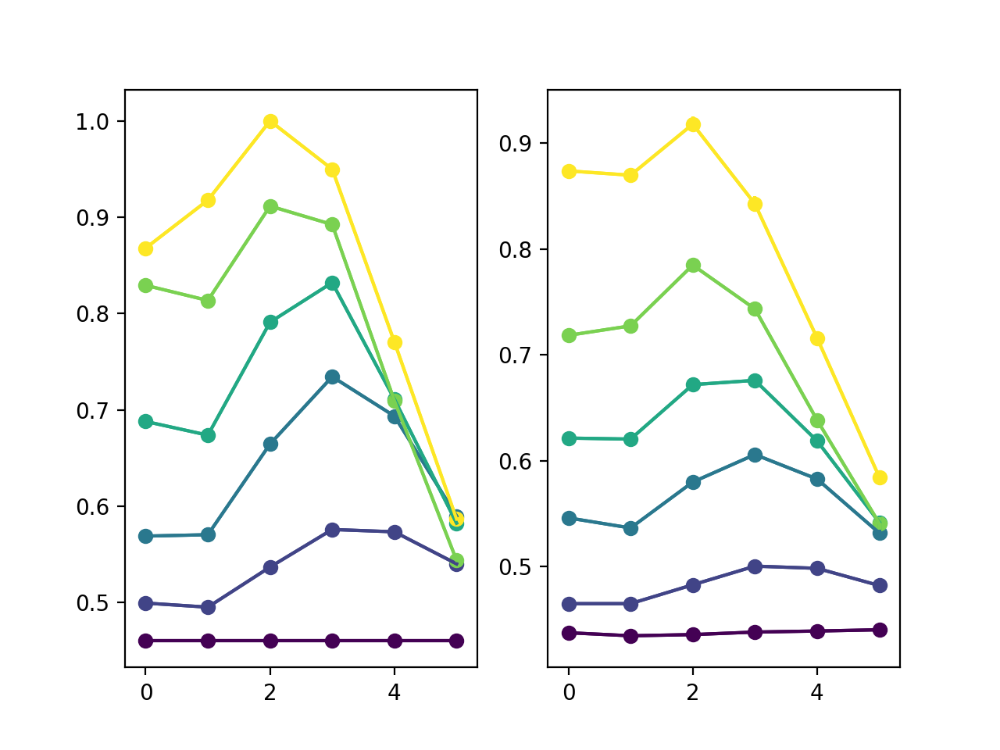

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

1.0000000000000042


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.9101348250256929


In [486]:
ifit = -1
itype = 0
plt.figure()
plt.subplot(1,2,1)
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYhat[:,itype].reshape((1,6,6)).transpose((0,2,1)))
plt.subplot(1,2,2)
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYs[ifit][low_loss[ifit]][:,:,:,itype].transpose((0,2,1)))
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYs[ifit][low_loss[ifit]][:,:,:,itype].transpose((0,2,1)))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


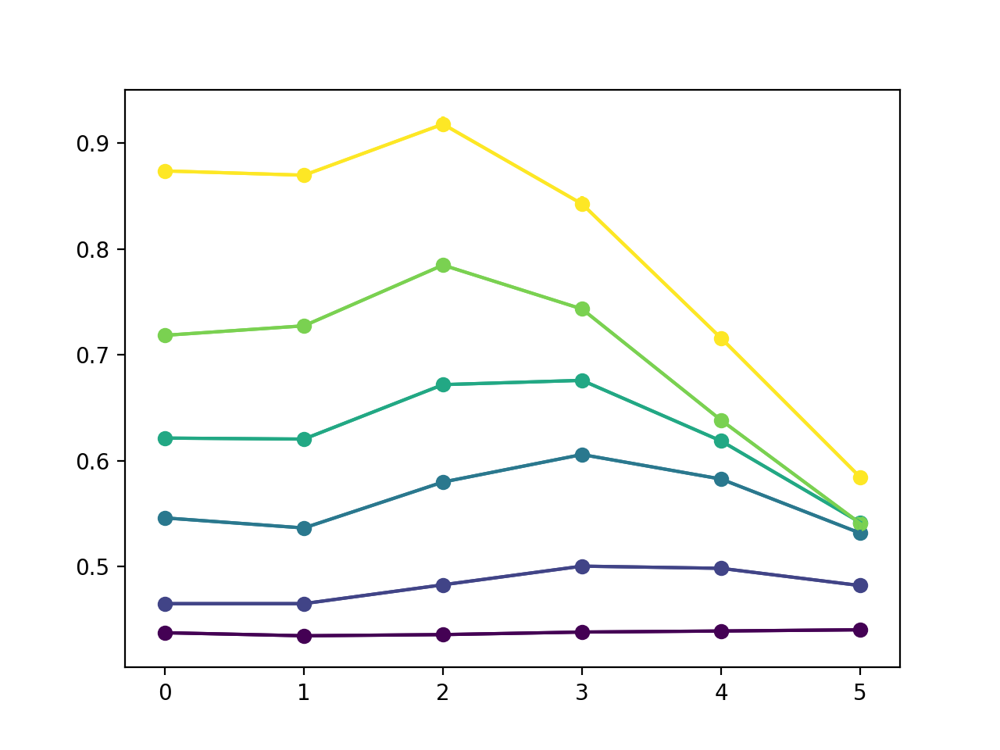

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.9101348250256929


In [487]:
ifit = 0
itype = 0
plt.figure()
ut.plot_bootstrapped_errorbars_hillel(np.arange(6),YYs[ifit][low_loss[ifit]][:,:,:,itype].transpose((0,2,1)))

In [488]:
np.nanmean(Wmys[ifit][low_loss[ifit]],0)

array([[ 3.6701271 ,  1.47487061,  1.51207059,  4.29192142],
       [-0.40363841,  0.        , -2.04540922, -0.37787342],
       [ 0.        , -1.28567379, -0.04781605, -0.14012154],
       [-2.56736486, -0.50562403, -1.01267111, -2.4321999 ]])

<IPython.core.display.Javascript object>


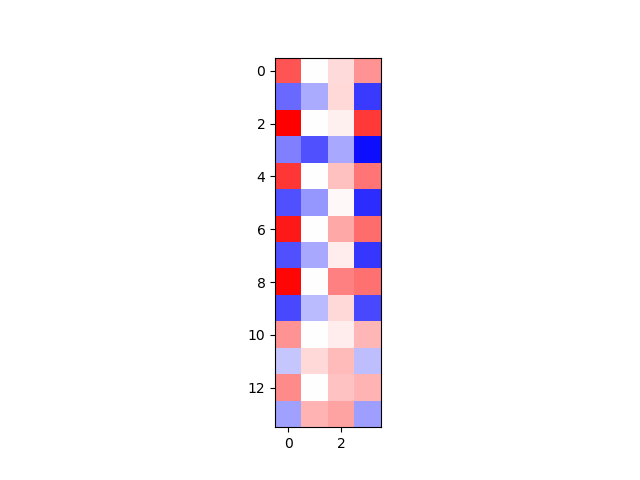

<IPython.core.display.Javascript object>


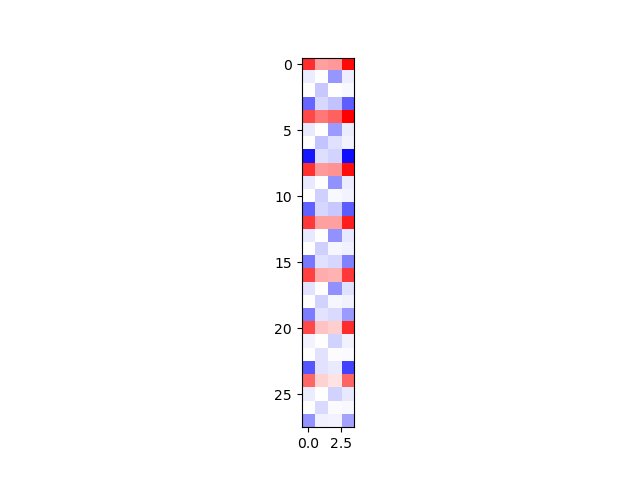

<IPython.core.display.Javascript object>


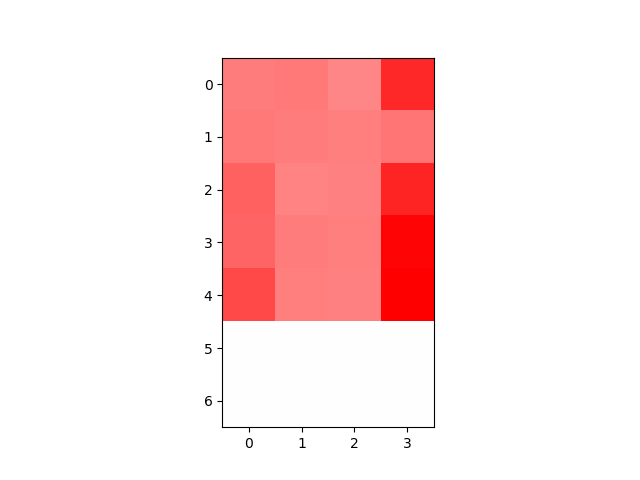

In [42]:
ifit = 4
plt.figure()
ut.imshow_hot_cold(np.concatenate([np.nanmean(Wmxs[ifit][low_loss[ifit]],0) for ifit in range(nfits)],axis=0))
plt.figure()
ut.imshow_hot_cold(np.concatenate([np.nanmean(Wmys[ifit][low_loss[ifit]],0) for ifit in range(nfits)],axis=0))
plt.figure()
ut.imshow_hot_cold(np.concatenate([np.nanmean(s02s[ifit][low_loss[ifit]][:,np.newaxis],0) for ifit in range(nfits)],axis=0))

<IPython.core.display.Javascript object>


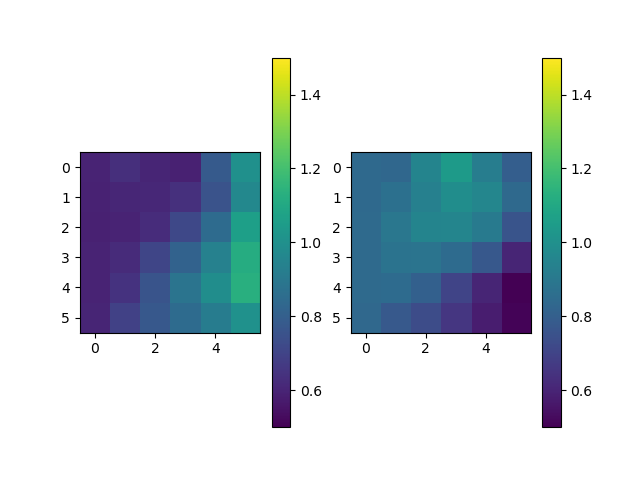

In [44]:
plt.figure()
for itype in range(1,3):
    plt.subplot(1,2,itype-1+1)
    plt.imshow(np.nanmean(mono_couplings[ifit][low_loss[ifit]][:,:,:,0,itype],0),vmin=0.5,vmax=1.5)
    plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


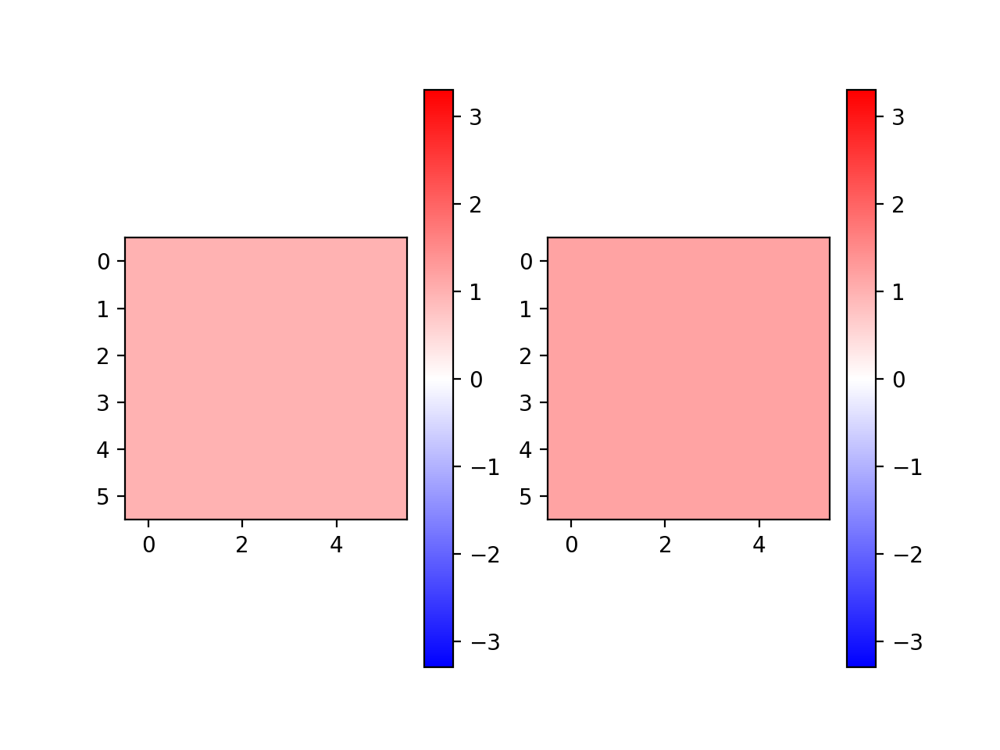

In [221]:
ifit = -1
reload(ut)
plt.figure()
for itype in range(1,3):
    plt.subplot(1,2,itype-1+1)
    ut.imshow_hot_cold(np.nanmean(couplings[ifit][low_loss[ifit]][:,:,:,0,itype],0),mx=3.3)#,vmin=0.5,vmax=2.5)
    plt.colorbar()
    
    

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:37: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


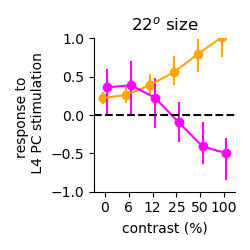

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


linewidth: 1
plotting
linewidth: 1
plotting


<IPython.core.display.Javascript object>


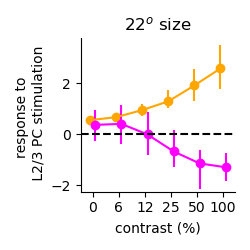

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


linewidth: 1
plotting
linewidth: 1
plotting


<IPython.core.display.Javascript object>


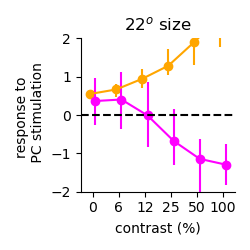

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


linewidth: 1
plotting
linewidth: 1
plotting


<IPython.core.display.Javascript object>


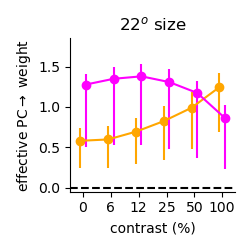

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


linewidth: 1
plotting
linewidth: 1
plotting


<IPython.core.display.Javascript object>


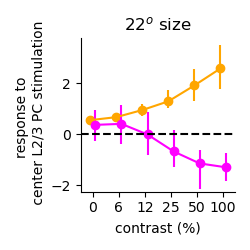

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


linewidth: 1
plotting
linewidth: 1
plotting


In [62]:
ifit = -1
nfits = 0

couplings_total = couplings.copy()
pc_couplings_total = couplings.copy()
Xcouplings_total = Xcouplings.copy()
mono_couplings_total = mono_couplings.copy()
for ifit in range(nfits):
    couplings_total[ifit] = 0.5*couplings[ifit][:,:,:,:4,:] + 0.5*couplings[ifit][:,:,:,4:,:]
for ifit in range(nfits):
    Xcouplings_total[ifit] = 0.5*Xcouplings[ifit][:,:,:,:2,:] + 0.5*Xcouplings[ifit][:,:,:,2:,:]
for ifit in range(nfits):
    pc_couplings_total[ifit] = 0.5*Xcouplings_total[ifit][:,:,:,0:1,:] + 0.5*couplings_total[ifit][:,:,:,0:1,:]
for ifit in range(nfits):
    mono_couplings_total[ifit] = 0.5*mono_couplings[ifit][:,:,:,:4,:] + 0.5*mono_couplings[ifit][:,:,:,4:,:]

reload(ut)
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36,60))

cfrac = np.linspace(1,0,3)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [[np.concatenate((c_sst[isize:isize+1],c_vip[isize:isize+1]),axis=0) for isize in range(2)] for iplot in range(5)]

datas = [Xcouplings_total,couplings_total,pc_couplings_total,mono_couplings_total,couplings]
lims = [(-1,1),(-2.25,3.75),(-2,2),(-0.05,1.85),(-2.25,3.75)]
ylbls = ['response to \n L4 PC stimulation','response to \n L2/3 PC stimulation','response to \n PC stimulation',r'effective PC$\rightarrow$ weight','response to \n center L2/3 PC stimulation']
fig_lbls = ['pc_sst_vip_xcoupling_no_opto_fit','pc_sst_vip_coupling_no_opto_fit','all_pc_sst_vip_coupling_no_opto_fit','pc_sst_vip_mono_coupling_no_opto_fit','']

ifit = 0

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(2.5,2.5))
    for iisize,isize in enumerate([3]):
#         plt.subplot(1,2,iisize+1)
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize,:,0,1:3].transpose((0,2,1)),pct=(16,84),colors=cs[iisize],delta=0.1)
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
        plt.ylim(lim)
        plt.xticks(np.arange(6),ucontrast)
        plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
#     plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s_22_deg.eps'%fig_lbl)
        

In [49]:
icoupling,jcoupling = 4,0
isize = 3

idel,jdel = 0,1
max_coupling = np.abs(couplings_del[low_loss[ifit]][:,:,:,icoupling,jcoupling,idel,jdel]).max(1).max(1)
well_behaved = max_coupling<5

plt.figure(figsize=(2.5,2.5))
ut.plot_pct_errorbars_hillel(np.arange(6),couplings[ifit][low_loss[ifit]][well_behaved][:,isize:isize+1,:,icoupling,jcoupling],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
ut.erase_top_right()

idel,jdel = 0,2

ut.plot_pct_errorbars_hillel(np.arange(6),couplings_del[low_loss[ifit]][well_behaved][:,isize:isize+1,:,icoupling,jcoupling,idel,jdel],pct=(16,84),colors=np.array((1,0,1))[np.newaxis])
ut.erase_top_right()

idel,jdel = 0,1

# ut.plot_pct_errorbars_hillel(np.arange(6),couplings_del[low_loss[ifit]][well_behaved][:,isize:isize+1,:,icoupling,jcoupling,idel,jdel],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
# ut.erase_top_right()


NameError: name 'couplings_del' is not defined

In [48]:
icoupling,jcoupling = 4,0
isize = 3

ifit = 4
idel,jdel = 0,1
max_coupling = np.abs(couplings_del[low_loss[ifit]][:,:,:,icoupling,jcoupling,idel,jdel]).max(1).max(1)
well_behaved = max_coupling<20

plt.figure(figsize=(2.5,2.5))
ut.plot_pct_errorbars_hillel(np.arange(6),couplings[ifit][low_loss[ifit]][well_behaved][:,isize:isize+1,:,icoupling,jcoupling],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])

ifix = 2

ut.plot_pct_errorbars_hillel(np.arange(6)-0.1,couplings_fixed[low_loss[ifit]][well_behaved][:,isize:isize+1,:,icoupling,jcoupling,ifix],pct=(16,84),colors=np.array((1,0,1))[np.newaxis])

ifix = 1

ut.plot_pct_errorbars_hillel(np.arange(6)+0.1,couplings_fixed[low_loss[ifit]][well_behaved][:,isize:isize+1,:,icoupling,jcoupling,ifix],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])

ut.erase_top_right()

NameError: name 'couplings_del' is not defined

<IPython.core.display.Javascript object>


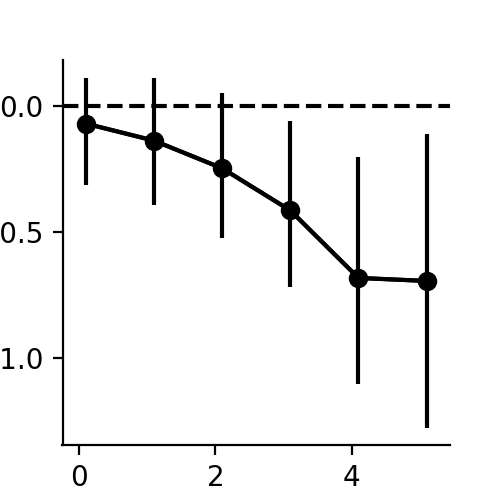

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


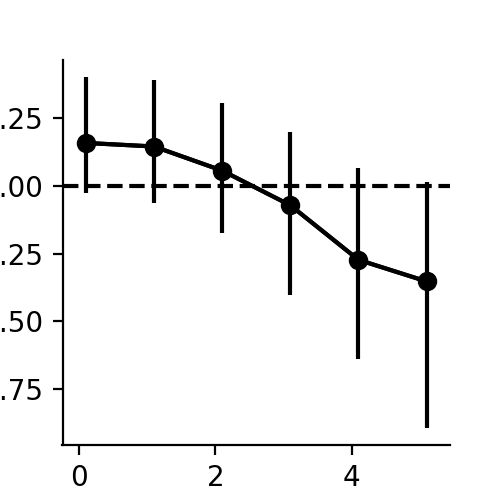

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


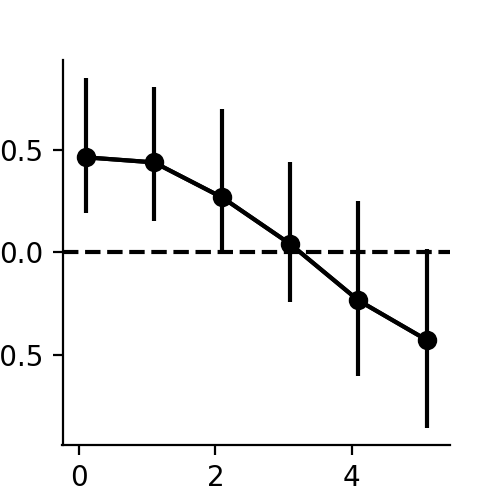

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [296]:
icoupling,jcoupling = 4,0
for ifit in range(len(couplings)):
    plt.figure(figsize=(2.5,2.5))
    ut.plot_pct_errorbars_hillel(np.arange(6)+0.1,couplings[ifit][low_loss[ifit]][:,isize,:,icoupling,jcoupling,np.newaxis].transpose((0,2,1)),pct=(16,84),colors=np.zeros((1,3)))
#     ut.plot_pct_errorbars_hillel(np.arange(6)+0.1,couplings_fixed[low_loss[ifit]][:,isize,:,icoupling,jcoupling,:].transpose((0,2,1)),pct=(16,84),delta=0.1)
    ut.erase_top_right()
    plt.axhline(0,c='k',linestyle='dashed')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


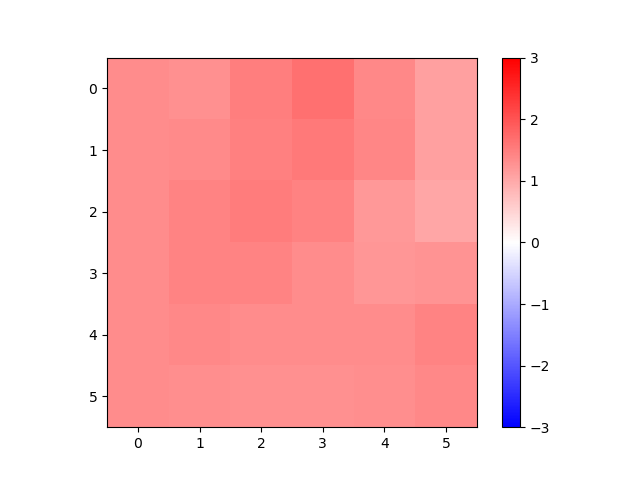

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:9: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if __name__ == '__main__':


<IPython.core.display.Javascript object>


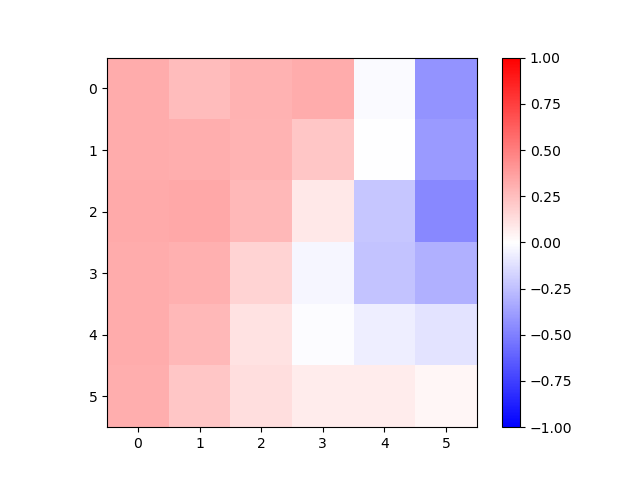

In [208]:
ifit = -1

icoupling,jcoupling = 0,0
plt.figure()
ut.imshow_hot_cold(np.nanmean(couplings[ifit][low_loss[ifit]][:,:,:,icoupling,jcoupling],0),mx=3)
plt.colorbar()

icoupling,jcoupling = 4,0
plt.figure()
ut.imshow_hot_cold(np.nanmean(couplings[ifit][low_loss[ifit]][:,:,:,icoupling,jcoupling],0),mx=1)
plt.colorbar()


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


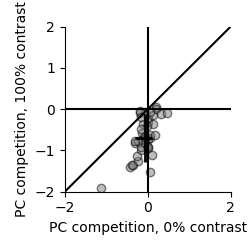

<IPython.core.display.Javascript object>


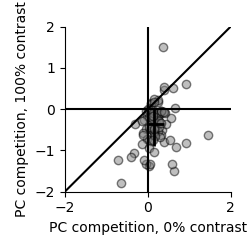

<IPython.core.display.Javascript object>


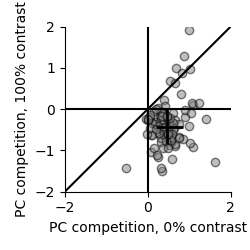

In [267]:
icoupling,jcoupling = 4,0
icontrast1,icontrast2 = 0,5
lim = (-2,2)
gray_val = 0.5
lw = 2
for ifit in range(len(couplings)):
    plt.figure(figsize=(2.5,2.5))
    xdata,ydata = [couplings[ifit][low_loss[ifit]][:,isize,icontrast,icoupling,jcoupling] for icontrast in [icontrast1,icontrast2]]
    plt.scatter(xdata,ydata,edgecolor='k',facecolor=gray_val*np.array((1,1,1)),alpha=0.5)
#     xlb,xub,xmn = ut.bootstrap(xdata,fn=np.nanmean,pct=(16,84,50))
#     ylb,yub,ymn = ut.bootstrap(ydata,fn=np.nanmean,pct=(16,84,50))
    xlb,xub,xmn = [np.nanpercentile(xdata,pct) for pct in (16,84,50)]
    ylb,yub,ymn = [np.nanpercentile(ydata,pct) for pct in (16,84,50)]
    plt.errorbar(xmn,ymn,xerr=np.array((xmn-xlb,xub-xmn))[:,np.newaxis],yerr=np.array((ymn-ylb,yub-ymn))[:,np.newaxis],c='k',linewidth=lw)
    #     ut.plot_pct_errorbars_hillel(np.arange(6)+0.1,couplings[ifit][low_loss[ifit]][:,isize,:,icoupling,jcoupling,np.newaxis].transpose((0,2,1)),pct=(16,84),colors=np.zeros((1,3)))
#     ut.plot_pct_errorbars_hillel(np.arange(6)+0.1,couplings_fixed[low_loss[ifit]][:,isize,:,icoupling,jcoupling,:].transpose((0,2,1)),pct=(16,84),delta=0.1)
    ut.erase_top_right()
    plt.axhline(0,c='k')#,linestyle='dashed')
    plt.axvline(0,c='k')
    plt.plot(lim,lim,c='k')
    plt.xlim(lim)
    plt.ylim(lim)
    plt.xlabel('PC competition, 0% contrast')
    plt.ylabel('PC competition, 100% contrast')
    plt.tight_layout()

In [339]:
    def set_bound(bd,code,val=0):
        # set bounds to 0 where 0s occur in 'code'
        for iitem in range(len(bd)):
            bd[iitem][code[iitem]] = val
            
    def tile_nS_nT_nN(kernel):
        row = np.concatenate([kernel for idim in range(nS*nT)],axis=0)[np.newaxis,:]
        tiled = np.concatenate([row for irow in range(nN)],axis=0)
        return tiled

    def set_bounds_by_code(lb,ub,bdlist):
        set_bound(lb,[bd==0 for bd in bdlist],val=0)
        set_bound(ub,[bd==0 for bd in bdlist],val=0)

        set_bound(lb,[bd==2 for bd in bdlist],val=0)

        set_bound(ub,[bd==-2 for bd in bdlist],val=0)

        set_bound(lb,[bd==1 for bd in bdlist],val=1)
        set_bound(ub,[bd==1 for bd in bdlist],val=1)

        set_bound(lb,[bd==1.5 for bd in bdlist],val=0)
        set_bound(ub,[bd==1.5 for bd in bdlist],val=1)

        set_bound(lb,[bd==-1 for bd in bdlist],val=-1)
        set_bound(ub,[bd==-1 for bd in bdlist],val=-1)
    
    X_bounds = tile_nS_nT_nN(np.array([2,1]))
    
    bd2list = [X_bounds,X_bounds]
    shapes2 = [(nN,nT*nS*nP),(nN,nT*nS*nP)]
    lb2,ub2 = [[sgn*np.inf*np.ones(shp) for shp in shapes2] for sgn in [-1,1]]
    set_bounds_by_code(lb2,ub2,bd2list)
    
    lb2 = np.concatenate([a.flatten() for a in lb2])
    ub2 = np.concatenate([b.flatten() for b in ub2])
    bounds2 = [(a,b) for a,b in zip(lb2,ub2)]

In [340]:
len(bounds2)

288

In [341]:
def tile_nS_nT_nN(kernel):
    row = np.concatenate([kernel for idim in range(nS*nT)],axis=0)[np.newaxis,:]
    tiled = np.concatenate([row for irow in range(nN)],axis=0)
    return tiled
tile_nS_nT_nN(np.array((2,1)))

array([[2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1],
       [2, 1, 2, 1]])

In [342]:
couplings_pcpv_rec_fixed.shape

(372, 6, 6, 8, 8)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


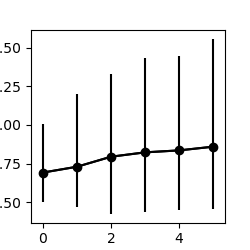

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


IndexError: boolean index did not match indexed array along dimension 0; dimension is 496 but corresponding boolean dimension is 65

In [459]:
mono_couplings_total = mono_couplings.copy()
for ifit in range(nfits):
#     mono_couplings_total[ifit] = 0.5*mono_couplings[ifit][:,:,:,:4,:] + 0.5*mono_couplings[ifit][:,:,:,4:,:]
#     mono_couplings_total[ifit] = 0.25*mono_couplings[ifit][:,:,:,:4,:4] + 0.25*mono_couplings[ifit][:,:,:,4:,:4] \
#     + 0.25*mono_couplings[ifit][:,:,:,:4,4:] + 0.25*mono_couplings[ifit][:,:,:,4:,4:]
    mono_couplings_total[ifit] = mono_couplings[ifit][:,:,:,:4,:4]

couplings_total = couplings.copy()
for ifit in range(nfits):
    couplings_total[ifit] = 0.5*couplings[ifit][:,:,:,:4,:] + 0.5*couplings[ifit][:,:,:,4:,:]
    
couplings_pcpv_rec_fixed_total = 0.5*couplings_pcpv_rec_fixed[:,:,:,:4,:] + 0.5*couplings_pcpv_rec_fixed[:,:,:,4:,:]

couplings_pc_rec_fixed_total = 0.5*couplings_pc_rec_fixed[:,:,:,:4,:] + 0.5*couplings_pc_rec_fixed[:,:,:,4:,:]


reload(ut)
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36,60))

cfrac = np.linspace(1,0,3)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
# colors = [[np.concatenate((c_l23[isize:isize+1],c_pv[isize:isize+1]),axis=0) for isize in range(2)] for iplot in range(4)]
colors = [[c_l23[isize:isize+1] for isize in range(2)] for iplot in range(4)]

datas = [couplings_total]
lims = [(-1,1),(-2.25,3.75),(-2,2),(-0.05,1.35)]
ylbls = ['PC response to PC activation']
fig_lbls = ['pc_pc_coupling_no_opto_fit_rec_fixed']

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(2.5,2.5))
    for iisize,isize in enumerate([3]):
#         plt.subplot(1,2,iisize+1)
#         iin = 0
#         iout = [0,3]
#         ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize][:,:,iin,:][:,:,iout].transpose((0,2,1)),pct=(16,84),colors=cs[iisize])
#         iin = [0,3]
#         iout = 0
#         ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize][:,:,iin,:][:,:,:,iout].transpose((0,2,1)),pct=(16,84),colors=cs[iisize])
        iin = 0
        iout = 0
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize][:,:,iin,:][:,:,iout][:,np.newaxis,:],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
        ut.plot_pct_errorbars_hillel(np.arange(6),couplings_pcpv_rec_fixed_total[low_loss[ifit]][:,isize][:,:,iin,:][:,:,iout][:,np.newaxis,:],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
        ut.plot_pct_errorbars_hillel(np.arange(6),couplings_pc_rec_fixed_total[low_loss[ifit]][:,isize][:,:,iin,:][:,:,iout][:,np.newaxis,:],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])
        #         ut.plot_pct_errorbars_hillel(np.arange(6),max_eig[ifit][low_loss[ifit]][:,isize][:,np.newaxis,:],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
#         plt.ylim((-5,5))
        plt.xticks(np.arange(6),ucontrast)
        plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
#     plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s_22_deg.eps'%fig_lbl)
    

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


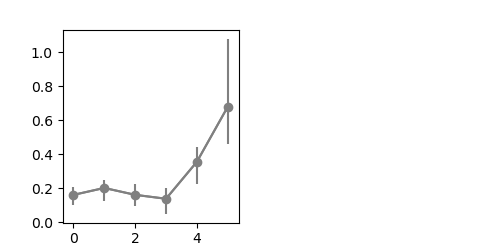

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


IndexError: index 1 is out of bounds for axis 0 with size 1

In [460]:
ifit = 0
datas = [Xcouplings_total,couplings_total,pc_couplings_total,mono_couplings_total]
lims = [(-1,1),(-2.25,3.75),(-2,2),(-0.05,1.35)]
ylbls = ['response to \n L4 PC stimulation','response to \n L2/3 PC stimulation','response to \n PC stimulation',r'effective PC$\rightarrow$ weight']
fig_lbls = ['pc_sst_vip_xcoupling_no_opto_fit','pc_sst_vip_coupling_no_opto_fit','all_pc_sst_vip_coupling_no_opto_fit','pc_sst_vip_mono_coupling_no_opto_fit']

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(5,2.5))
    for iisize,isize in enumerate([0,3]):
        plt.subplot(1,2,iisize+1)
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize,:,0,1:3].transpose((0,2,1)),pct=(16,84),colors=cs[iisize])
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
        plt.ylim(lim)
        plt.xticks(np.arange(6),ucontrast)
        plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
    plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s.eps'%fig_lbl)
    

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:36: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


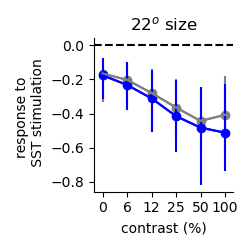

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


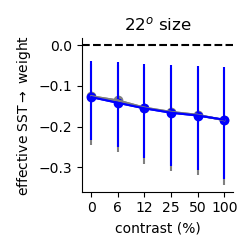

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [77]:
ifit = 0

couplings_total = couplings.copy()
pc_couplings_total = couplings.copy()
Xcouplings_total = Xcouplings.copy()
mono_couplings_total = mono_couplings.copy()
for ifit in range(nfits):
    couplings_total[ifit] = 0.5*couplings[ifit][:,:,:,:4,:] + 0.5*couplings[ifit][:,:,:,4:,:]
for ifit in range(nfits):
    Xcouplings_total[ifit] = 0.5*Xcouplings[ifit][:,:,:,:2,:] + 0.5*Xcouplings[ifit][:,:,:,2:,:]
for ifit in range(nfits):
    pc_couplings_total[ifit] = 0.5*Xcouplings_total[ifit][:,:,:,0:1,:] + 0.5*couplings_total[ifit][:,:,:,0:1,:]
for ifit in range(nfits):
    mono_couplings_total[ifit] = 0.5*mono_couplings[ifit][:,:,:,:4,:] + 0.5*mono_couplings[ifit][:,:,:,4:,:]

reload(ut)
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36,60))

cfrac = np.linspace(1,0,3)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [[np.concatenate((c_l23[isize:isize+1],c_pv[isize:isize+1]),axis=0) for isize in range(2)] for iplot in range(4)]

datas = [couplings_total,mono_couplings_total]
lims = [(-1,1),(-2.25,3.75),(-2,2),(-0.05,1.35)]
ylbls = ['response to \n SST stimulation',r'effective SST$\rightarrow$ weight']
fig_lbls = ['sst_pc_pv_coupling_no_opto_fit','sst_pc_pv_mono_coupling_no_opto_fit']

ifit = 4

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(2.5,2.5))
    for iisize,isize in enumerate([3]):
#         plt.subplot(1,2,iisize+1)
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize,:,1,0:4:3].transpose((0,2,1)),pct=(16,84),colors=cs[iisize])
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
#         plt.ylim(lim)
        plt.xticks(np.arange(6),ucontrast)
        plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
#     plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s_22_deg.eps'%fig_lbl)
        

In [1293]:
low_loss[ifit].sum()

0

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


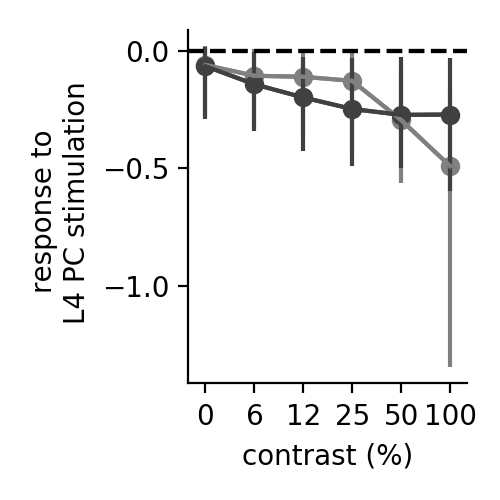

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


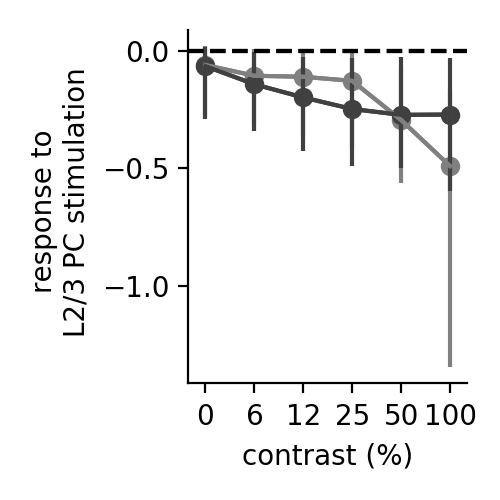

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [118]:
# couplings_sst_fixed = couplings.copy()
# for ifit in range(nfits):
#     couplings_sst_fixed[ifit] = couplings_fixed[ifit][:,:,:,:,:,1]

ifit = 4

reload(ut)
ucontrast = np.array((0,6,12,25,50,100))
usize = np.array((5,8,13,22,36,60))

cfrac = np.linspace(1,0,3)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [[c_l23[isize:isize+1] for isize in range(2)] for iplot in range(2)]

datas = [couplings,couplings]#,couplings_sst_fixed]#[couplings_fixed[:,:,:,:,1] for _ in couplings]
lims = [(-1,1),(-1,3.75),(-0.05,1.35)]
ylbls = ['response to \n L4 PC stimulation','response to \n L2/3 PC stimulation',r'effective PC$\rightarrow$ weight']
fig_lbls = ['pc_sst_vip_xcoupling_no_opto_fit','pc_sst_vip_coupling_no_opto_fit','pc_sst_vip_mono_coupling_no_opto_fit']

for cpl,lim,ylbl,cs,fig_lbl in zip(datas,lims,ylbls,colors,fig_lbls):
    plt.figure(figsize=(2.5,2.5))
    for iisize,isize in enumerate([0,5]):
#         plt.subplot(1,2,iisize+1)
        ut.plot_pct_errorbars_hillel(np.arange(6),cpl[ifit][low_loss[ifit]][:,isize,:,4,0][:,np.newaxis],pct=(16,84),colors=cs[iisize])
        plt.axhline(0,c='k',linestyle='dashed')
        ut.erase_top_right()
#         plt.ylim(lim)
        plt.xticks(np.arange(6),ucontrast)
#         plt.title('%d$^o$ size'%usize[isize])
        plt.xlabel('contrast (%)')
#     plt.subplot(1,2,1)
    plt.ylabel(ylbl)
    plt.tight_layout()
#     plt.savefig('figures/%s.eps'%fig_lbl)

In [723]:
couplings[0].shape

(956, 6, 6, 8, 8)

In [346]:
cpl[ifit][low_loss[ifit]][:,isize,:,4,0].shape


(38, 6)

In [347]:
phis[ifit].shape

(372, 6, 6, 8)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


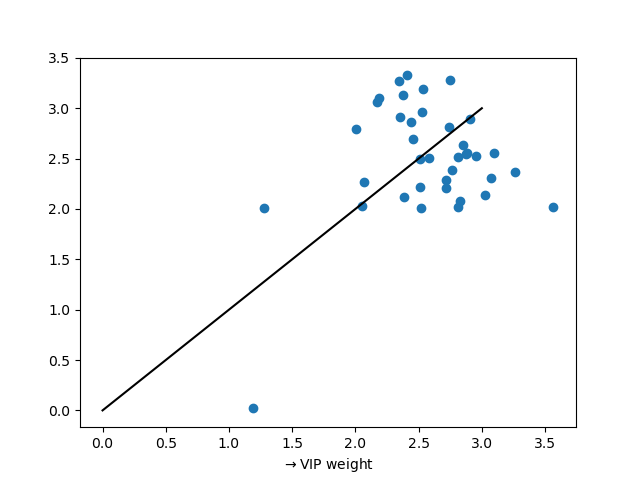

Text(0.5, 0, '$\\rightarrow$VIP weight')

In [348]:
plt.figure()
ifrom = 0
itype1,itype2 = 1,2
xdata = Wmys[ifit][low_loss[ifit]][:,ifrom,itype1]*(1+Ks[ifit][low_loss[ifit]][:,itype1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,ifrom,itype2]*(1+Ks[ifit][low_loss[ifit]][:,itype2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata)
plt.plot((0,3),(0,3),c='k')
plt.xlabel(r'$\rightarrow$SST weight')
plt.xlabel(r'$\rightarrow$VIP weight')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


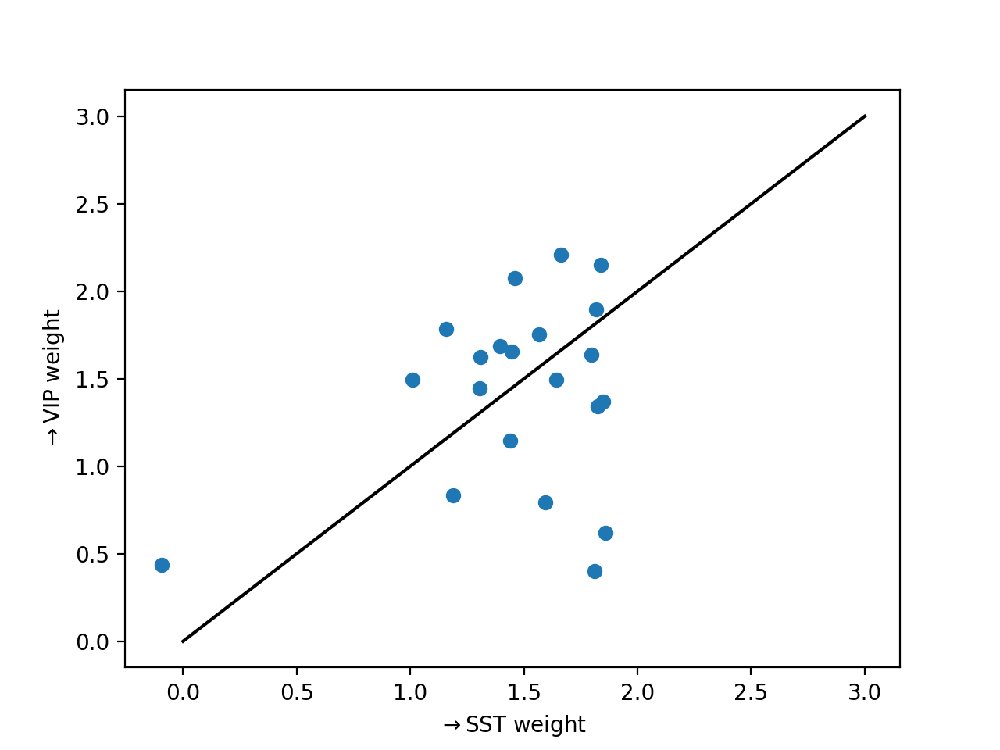

Text(0, 0.5, '$\\rightarrow$VIP weight')

In [661]:
plt.figure()
ifrom1,ifrom2 = 0,3
itype1,itype2 = 1,2
xdata = (Wmys[ifit][low_loss[ifit]][:,ifrom1,itype1]+Wmys[ifit][low_loss[ifit]][:,ifrom2,itype1])*(1+Ks[ifit][low_loss[ifit]][:,itype1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = (Wmys[ifit][low_loss[ifit]][:,ifrom1,itype2]+Wmys[ifit][low_loss[ifit]][:,ifrom2,itype2])*(1+Ks[ifit][low_loss[ifit]][:,itype2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata)
plt.plot((0,3),(0,3),c='k')
plt.xlabel(r'$\rightarrow$SST weight')
plt.ylabel(r'$\rightarrow$VIP weight')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


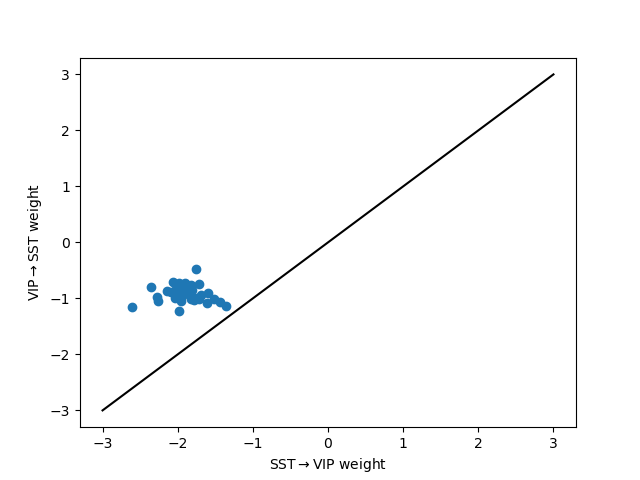

Text(0, 0.5, 'VIP$\\rightarrow$SST weight')

In [349]:
plt.figure()
xdata = Wmys[ifit][low_loss[ifit]][:,1,2]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,2,1]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata)
plt.plot((-3,3),(-3,3),c='k')
plt.xlabel(r'SST$\rightarrow$VIP weight')
plt.ylabel(r'VIP$\rightarrow$SST weight')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


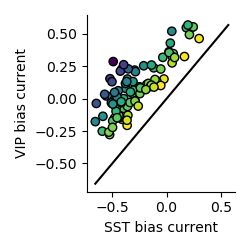

In [80]:
ifit = -1
plt.figure(figsize=(2.5,2.5))
xdata = Wmxs[ifit][low_loss[ifit]][:,1,1]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmxs[ifit][low_loss[ifit]][:,1,2]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
delta_Wy = xdata-ydata
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('SST bias current')
plt.ylabel('VIP bias current')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_vip_bias_scatter.eps')

0/94 greater
1/94 greater


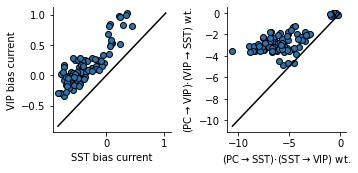

In [45]:
ifit = -1
plt.figure(figsize=(5,2.5))
plt.subplot(1,2,1)
# mdls_no_vipbias[iwt].Wmx[1,1]*(1+mdls_no_vipbias[iwt].K[1])/(1+mdls_no_vipbias[iwt].K[2])
xdata = Wmxs[ifit][low_loss[ifit]][:,1,1]*(1+Ks[ifit][low_loss[ifit]][:,1])#/(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmxs[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,2])#/(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
delta_Wy = xdata-ydata
# delta_Wy = xdata+ydata
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1)#,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('SST bias current')
plt.ylabel('VIP bias current')
print('%d/%d greater'%(sum(xdata>ydata),xdata.size))
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_bias_scatter.eps')

plt.subplot(1,2,2)
xdata = Wmys[ifit][low_loss[ifit]][:,0,1]*Wmys[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,1])*(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,0,2]*Wmys[ifit][low_loss[ifit]][:,2,1]*(1+Ks[ifit][low_loss[ifit]][:,2])*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
# colormap = plt.cm.viridis(np.linspace)
# delta_Wy = xdata-ydata
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1)#,cmap=plt.cm.viridis,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel(r'(PC$\rightarrow$SST)$\cdot$(SST$\rightarrow$VIP) wt.')
plt.ylabel(r'(PC$\rightarrow$VIP)$\cdot$(VIP$\rightarrow$SST) wt.')
print('%d/%d greater'%(sum(xdata>ydata),xdata.size))
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_bias_and_mutual_inhibitory_wts_C0.eps')

In [ ]:
ifit = -1
plt.figure(figsize=(5,2.5))
plt.subplot(1,2,1)
# mdls_no_vipbias[iwt].Wmx[1,1]*(1+mdls_no_vipbias[iwt].K[1])/(1+mdls_no_vipbias[iwt].K[2])
xdata = Wmxs[ifit][low_loss[ifit]][:,1,1]*(1+Ks[ifit][low_loss[ifit]][:,1])#/(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmxs[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,2])#/(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
delta_Wy = xdata-ydata
# delta_Wy = xdata+ydata
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('SST bias current')
plt.ylabel('VIP bias current')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_bias_scatter.eps')

plt.subplot(1,2,2)
xdata = Wmys[ifit][low_loss[ifit]][:,0,1]*Wmys[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,1])*(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,0,2]*Wmys[ifit][low_loss[ifit]][:,2,1]*(1+Ks[ifit][low_loss[ifit]][:,2])*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
# colormap = plt.cm.viridis(np.linspace)
# delta_Wy = xdata-ydata
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,cmap=plt.cm.viridis,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel(r'(PC$\rightarrow$SST)$\cdot$(SST$\rightarrow$VIP) wt.')
plt.ylabel(r'(PC$\rightarrow$VIP)$\cdot$(VIP$\rightarrow$SST) wt.')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_vip_bias_and_mutual_inhibitory_wts.eps')

<IPython.core.display.Javascript object>


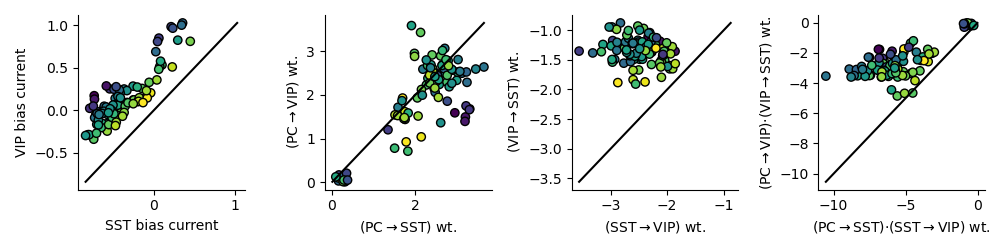

In [74]:
ifit = -1
plt.figure(figsize=(10,2.5))
plt.subplot(1,4,1)
# mdls_no_vipbias[iwt].Wmx[1,1]*(1+mdls_no_vipbias[iwt].K[1])/(1+mdls_no_vipbias[iwt].K[2])
xdata = Wmxs[ifit][low_loss[ifit]][:,1,1]*(1+Ks[ifit][low_loss[ifit]][:,1])#/(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmxs[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,2])#/(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
delta_Wy = xdata-ydata
# delta_Wy = xdata+ydata
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('SST bias current')
plt.ylabel('VIP bias current')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_bias_scatter.eps')

plt.subplot(1,4,2)
xdata = Wmys[ifit][low_loss[ifit]][:,0,1]*(1+Ks[ifit][low_loss[ifit]][:,1])#*Wmys[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,0,2]*(1+Ks[ifit][low_loss[ifit]][:,2])#*Wmys[ifit][low_loss[ifit]][:,2,1]*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
# colormap = plt.cm.viridis(np.linspace)
# delta_Wy = xdata-ydata
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,cmap=plt.cm.viridis,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel(r'(PC$\rightarrow$SST) wt.')
plt.ylabel(r'(PC$\rightarrow$VIP) wt.')
ut.erase_top_right()
plt.tight_layout()

plt.subplot(1,4,3)
xdata = Wmys[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,2,1]*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
# colormap = plt.cm.viridis(np.linspace)
# delta_Wy = xdata-ydata
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,cmap=plt.cm.viridis,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel(r'(SST$\rightarrow$VIP) wt.')
plt.ylabel(r'(VIP$\rightarrow$SST) wt.')
ut.erase_top_right()
plt.tight_layout()

plt.subplot(1,4,4)
xdata = Wmys[ifit][low_loss[ifit]][:,0,1]*Wmys[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,1])*(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,0,2]*Wmys[ifit][low_loss[ifit]][:,2,1]*(1+Ks[ifit][low_loss[ifit]][:,2])*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
# colormap = plt.cm.viridis(np.linspace)
# delta_Wy = xdata-ydata
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,cmap=plt.cm.viridis,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel(r'(PC$\rightarrow$SST)$\cdot$(SST$\rightarrow$VIP) wt.')
plt.ylabel(r'(PC$\rightarrow$VIP)$\cdot$(VIP$\rightarrow$SST) wt.')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_bias_and_mutual_inhibitory_wts.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


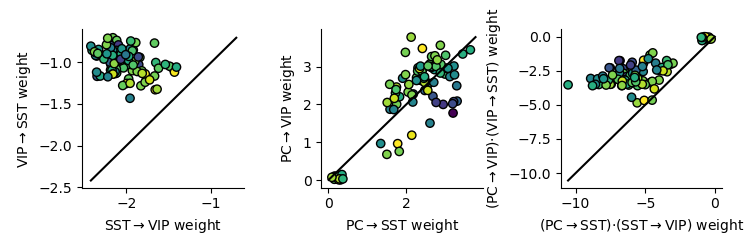

In [79]:
ifit = -1

plt.figure(figsize=(7.5,2.5))
plt.subplot(1,3,1)
xdata = Wmys[ifit][low_loss[ifit]][:,1,2]#*(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,2,1]#*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
# colormap = plt.cm.viridis(np.linspace)
# delta_Wy = xdata-ydata
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,cmap=plt.cm.viridis,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel(r'SST$\rightarrow$VIP weight')
plt.ylabel(r'VIP$\rightarrow$SST weight')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_bias_scatter.eps')

# plt.figure(figsize=(2.5,2.5))
plt.subplot(1,3,2)
xdata = Wmys[ifit][low_loss[ifit]][:,0,1]*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,0,2]*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
# colormap = plt.cm.viridis(np.linspace)
# delta_Wy = xdata-ydata
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,cmap=plt.cm.viridis,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel(r'PC$\rightarrow$SST weight')
plt.ylabel(r'PC$\rightarrow$VIP weight')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_bias_scatter.eps')

# plt.figure(figsize=(2.5,2.5))
plt.subplot(1,3,3)
xdata = Wmys[ifit][low_loss[ifit]][:,0,1]*Wmys[ifit][low_loss[ifit]][:,1,2]*(1+Ks[ifit][low_loss[ifit]][:,1])*(1+Ks[ifit][low_loss[ifit]][:,2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,0,2]*Wmys[ifit][low_loss[ifit]][:,2,1]*(1+Ks[ifit][low_loss[ifit]][:,2])*(1+Ks[ifit][low_loss[ifit]][:,1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
# colormap = plt.cm.viridis(np.linspace)
# delta_Wy = xdata-ydata
plt.scatter(xdata,ydata,edgecolors='k',linewidths=1,cmap=plt.cm.viridis,c=delta_Wy)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel(r'(PC$\rightarrow$SST)$\cdot$(SST$\rightarrow$VIP) weight')
plt.ylabel(r'(PC$\rightarrow$VIP)$\cdot$(VIP$\rightarrow$SST) weight')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_vip_competition_synaptic_weights_scatter.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


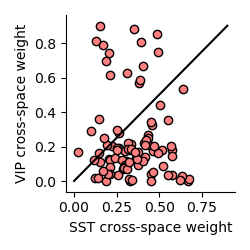

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [69]:
ifit = -1
plt.figure(figsize=(2.5,2.5))
xdata = Ks[ifit][low_loss[ifit]][:,1]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Ks[ifit][low_loss[ifit]][:,2]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,c=[1,0.5,0.5],edgecolors='k',linewidths=1)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('SST cross-space weight')
plt.ylabel('VIP cross-space weight')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_cross_space_scatter.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


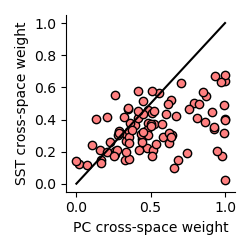

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [67]:
plt.figure(figsize=(2.5,2.5))
xdata = Ks[ifit][low_loss[ifit]][:,0]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Ks[ifit][low_loss[ifit]][:,1]#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata,c=[1,0.5,0.5],edgecolors='k',linewidths=1)
mn = np.minimum(xdata.min(),ydata.min())#-0.1
mx = np.maximum(xdata.max(),ydata.max())#+0.1
plt.plot((mn,mx),(mn,mx),c='k')
plt.xlabel('PC cross-space weight')
plt.ylabel('SST cross-space weight')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/pc_sst_cross_space_scatter.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


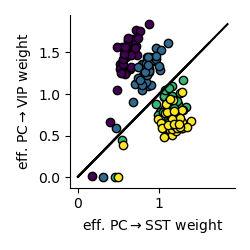

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

In [351]:
plt.figure(figsize=(2.5,2.5))
isizes = [2,3,4,5]
icontrasts = [2,3,4,5]
nconds = len(isizes)
for isize,icontrast,c in zip(isizes,icontrasts,plt.cm.viridis(np.linspace(0,1,nconds))):
    xdata = mono_couplings[ifit][low_loss[ifit]][:,isize,icontrast,0,1]
    ydata = mono_couplings[ifit][low_loss[ifit]][:,isize,icontrast,0,2]
    plt.scatter(xdata,ydata,c=c,edgecolors='k',linewidths=1)
    mn = np.minimum(xdata.min(),ydata.min())#-0.1
    mx = np.maximum(xdata.max(),ydata.max())#+0.1
    plt.plot((mn,mx),(mn,mx),c='k')
    plt.xlabel(r'eff. PC$\rightarrow$SST weight')
    plt.ylabel(r'eff. PC$\rightarrow$VIP weight')
    ut.erase_top_right()
    plt.tight_layout()
# plt.savefig('figures/pc_sst_vip_eff_wt_scatter.eps')


In [681]:
mono_couplings[ifit].shape

(956, 6, 6, 8, 8)

In [352]:
phis[ifit][low_loss[ifit]][:,:,:,0].mean(),phis[ifit][low_loss[ifit]][:,:,:,3].mean()

(0.605200699953432, 0.556507241981568)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


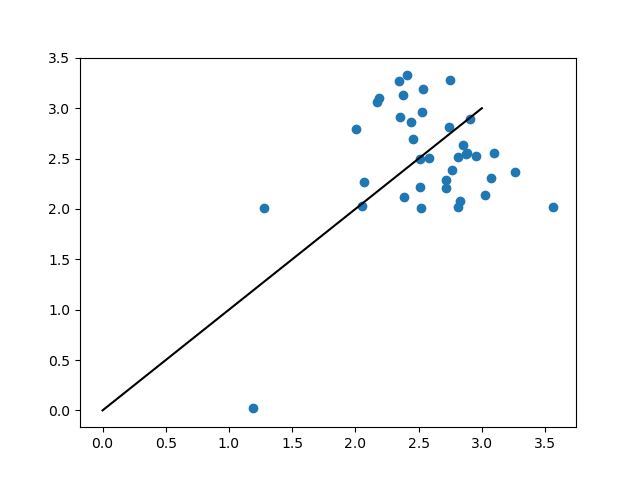

In [353]:
plt.figure()
itype1,itype2 = 1,2
xdata = Wmys[ifit][low_loss[ifit]][:,0,itype1]*(1+Ks[ifit][low_loss[ifit]][:,itype1])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype1],1),1)
ydata = Wmys[ifit][low_loss[ifit]][:,0,itype2]*(1+Ks[ifit][low_loss[ifit]][:,itype2])#*np.nanmean(np.nanmean(phis[ifit][low_loss[ifit]][:,:,:,itype2],1),1)
# plt.scatter(Wmys[ifit][low_loss[ifit]][:,0,itype1],Wmys[ifit][low_loss[ifit]][:,0,itype2])
plt.scatter(xdata,ydata)
plt.plot((0,3),(0,3),c='k')

In [564]:
low_loss[ifit].sum()

5

In [354]:
phis[ifit].shape

(372, 6, 6, 8)

In [355]:
[np.all(a==b) for a,b in zip(wt_dicts[0].values(),wt_dicts[1].values())]

IndexError: list index out of range

In [356]:
Wpcpc = np.zeros((len(weights_files),nsize,ncontrast))
YYs = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
YY1s = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
YY2s = np.zeros((len(weights_files),nsize,ncontrast,nQ*nS*nT))
h1s = np.zeros((len(weights_files),))
h2s = np.zeros((len(weights_files),))
bls = np.zeros((len(weights_files),nQ))
amps = np.zeros((len(weights_files),nQ*nS*nT))
for iwt in range(len(weights_files)):
    Wstar_dict = np.load(weights_files[iwt],allow_pickle=True)[()]
    try:
        Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl = Wstar_dict['as_list']
        amp = np.ones((nQ*nS*nT,))
    except:
        Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = Wstar_dict['as_list']    
    YYs[iwt] = amp*compute_f_(Eta,Xi,s02).reshape((nsize,ncontrast,-1)) + np.tile(bl,nS*nT)[np.newaxis]
    
    YY12,_ = calnet.utils.compute_f_fprime_t_avg(Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1=h1,h2=h2,perturbation=0,opto=True)
    YY1s[iwt] = amp*YY12[:nN].reshape((nsize,ncontrast,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
    YY2s[iwt] = amp*YY12[nN:].reshape((nsize,ncontrast,nQ*nS*nT)) + np.tile(bl,nS*nT)[np.newaxis]
    
    h1s[iwt] = h1
    h2s[iwt] = h2
    bls[iwt] = bl
    amps[iwt] = amp

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


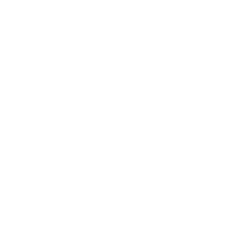

TypeError: '<' not supported between instances of 'list' and 'float'

In [357]:
plt.figure(figsize=(2.5,2.5))
plt.hist(losses[losses<1e2],bins=20)
ut.erase_top_right()
plt.xlabel('loss')
plt.ylabel('# of model fits')
plt.tight_layout()
# plt.savefig('figures/model_fits_random_inits_simulate2_true.eps')

In [358]:
lkat = losses < np.nanpercentile(losses,10)
#(losses < np.percentile(losses,20))#(losses < 100) #& (np.max(np.abs(couplings.reshape((couplings.shape[0],-1))),axis=1) < 10)


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


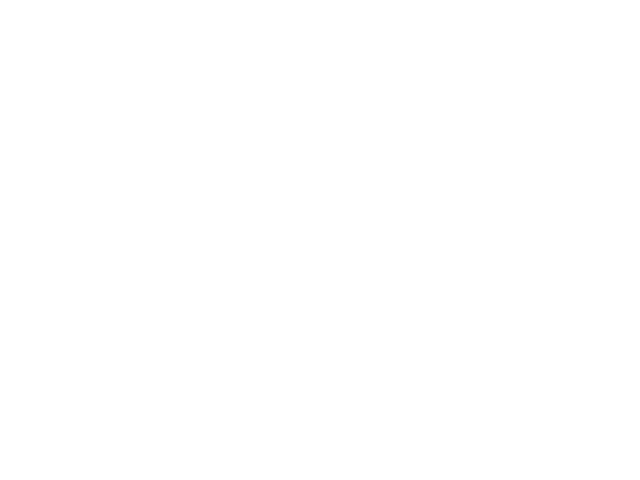

TypeError: only integer scalar arrays can be converted to a scalar index

In [359]:
plt.figure()
plt.hist(losses[lkat],bins=20)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


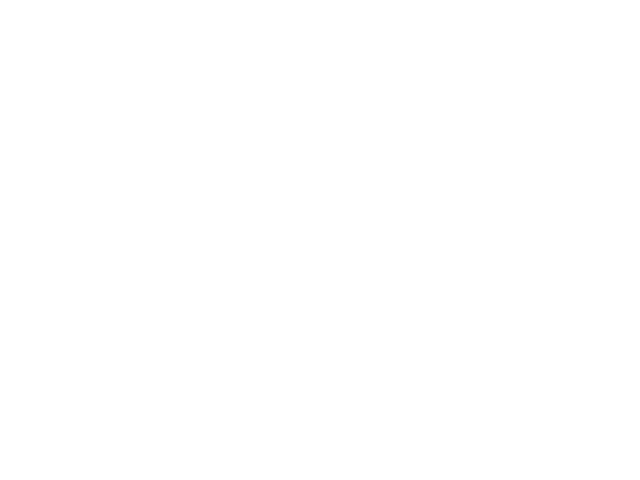

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

In [361]:
plt.figure()
plt.hist(h1s[lkat],alpha=0.5)
plt.hist(h2s[lkat],alpha=0.5)

<IPython.core.display.Javascript object>


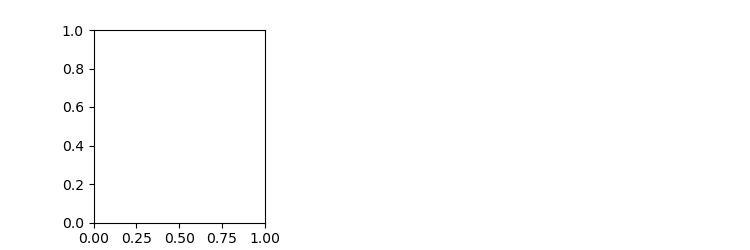

NameError: name 'YYhat' is not defined

In [53]:
# lbls = ['PC','SST','VIP','PV']
# for itype in np.arange(4):
#     plt.figure(figsize=(5,2.5))
#     titles = ['VIP silencing','VIP activation']
#     for iyy,yy in enumerate([YY1s,YY2s]):
#         plt.subplot(1,2,iyy+1)
#         sca.scatter_size_contrast_errorbar(YYs[lkat,:,:,itype],yy[lkat,:,:,itype])#,mn=0)
#         plt.title(titles[iyy])
#         plt.xlabel('%s event rate, \n light off'%lbls[itype])
#         plt.ylabel('%s event rate, \n light on'%lbls[itype])
#         ut.erase_top_right()
#     plt.tight_layout()
#     plt.savefig('figures/bidi_nonlinear_%s_scatter_size_contrast.eps'%lbls[itype])
mxs = [1,1.5,2,1]
lbls = ['PC','SST','VIP','PV']
for itype in np.arange(4):
    plt.figure(figsize=(7.5,2.5))
    titles = ['VIP silencing','VIP activation']
    plt.subplot(1,3,1)
    sca.scatter_size_contrast_errorbar(YYhat.reshape((nsize,ncontrast,-1))[np.newaxis,:,:,itype],YYs[lkat,:,:,itype],mn=0)
#     plt.title(titles[iyy])
    plt.xlabel('exptl. %s event rate'%lbls[itype])
    plt.ylabel('modeled %s firing rate'%lbls[itype])
    ut.erase_top_right()
    for iyy,yy in enumerate([YY1s,YY2s]):
        plt.subplot(1,3,iyy+2)
        sca.scatter_size_contrast_errorbar(YYs[lkat,:,:,itype],yy[lkat,:,:,itype])#,mn=0,mx=mxs[itype])
        plt.title(titles[iyy])
        plt.xlabel('%s firing rate, \n light off'%lbls[itype])
        plt.ylabel('%s firing rate, \n light on'%lbls[itype])
        ut.erase_top_right()
    plt.tight_layout()
#     plt.savefig('figures/bidi_nonlinear_%s_scatter_size_contrast.eps'%lbls[itype])


In [ ]:
plt.figure()
sca.scatter_size_contrast_errorbar(YYs[lkat,:,:,itype],YY2s[lkat,:,:,itype],equate_0=True)

In [ ]:
mxs = [1,1.5,2,1]
lbls = ['PC','SST','VIP','PV']
ut.mkdir('figures/%s/'%fit_lbl)
for itype in np.arange(4):
    for iiwt in range(lkat.sum()):
        iwt = np.argsort(losses[lkat])[iiwt]
        plt.figure(figsize=(7.5,2.5))
        titles = ['VIP silencing','VIP activation']
        plt.subplot(1,3,1)
        sca.scatter_size_contrast_errorbar(YYhat.reshape((nsize,ncontrast,-1))[np.newaxis,:,:,itype],YYs[lkat][iwt:iwt+1,:,:,itype],mn=0)
    #     plt.title(titles[iyy])
        plt.xlabel('exptl. %s event rate'%lbls[itype])
        plt.ylabel('modeled %s firing rate'%lbls[itype])
        plt.title('%s, loss = %.2f'%(np.array(weights_filenames)[lkat][iwt],losses[lkat][iwt]))
        ut.erase_top_right()
        for iyy,yy in enumerate([YY1s,YY2s]):
            plt.subplot(1,3,iyy+2)
            sca.scatter_size_contrast_errorbar(YYs[lkat][iwt:iwt+1,:,:,itype],yy[lkat][iwt:iwt+1,:,:,itype],equate_0=True)#,mn=0,mx=2)#,mn=0,mx=mxs[itype])
            plt.title(titles[iyy])
            plt.xlabel('%s firing rate, \n light off'%lbls[itype])
            plt.ylabel('%s firing rate, \n light on'%lbls[itype])
            ut.erase_top_right()
        plt.tight_layout()
        plt.savefig('figures/%s/%s_scatter_size_contrast_%d.eps'%(fit_lbl,lbls[itype],iiwt))
        plt.close('all')

In [240]:
dYY = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/dYY.npy')

<IPython.core.display.Javascript object>


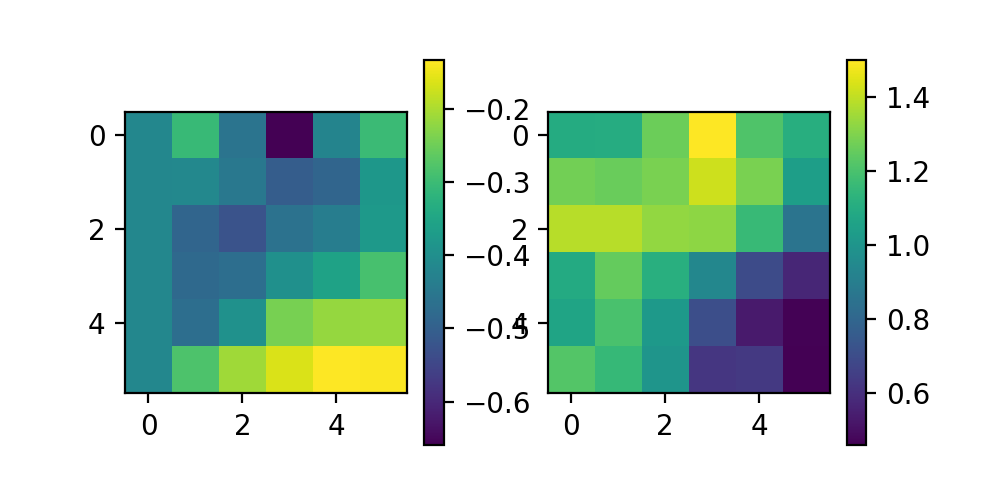

In [256]:
itype = 2
plt.figure(figsize=(5,2.5))
plt.subplot(1,2,1)
plt.imshow(dYY[:36,itype].reshape((6,6)))
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(dYY[36:72,itype].reshape((6,6)))
plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


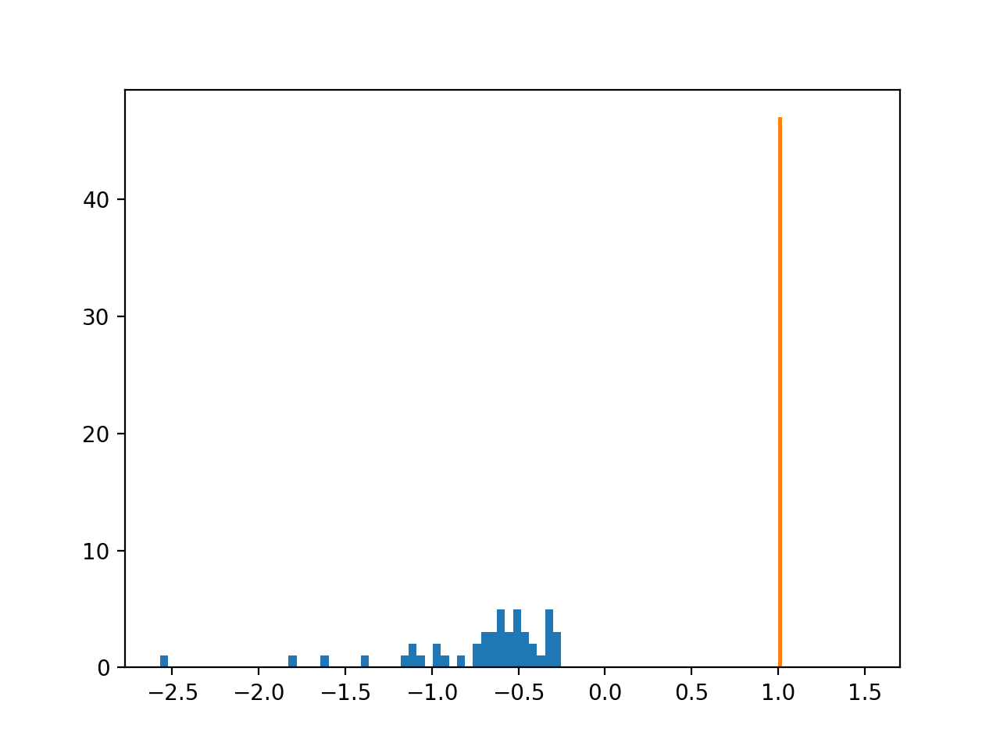

(array([ 0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0., 47.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,
         0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.,  0.]),
 array([0.5 , 0.52, 0.54, 0.56, 0.58, 0.6 , 0.62, 0.64, 0.66, 0.68, 0.7 ,
        0.72, 0.74, 0.76, 0.78, 0.8 , 0.82, 0.84, 0.86, 0.88, 0.9 , 0.92,
        0.94, 0.96, 0.98, 1.  , 1.02, 1.04, 1.06, 1.08, 1.1 , 1.12, 1.14,
        1.16, 1.18, 1.2 , 1.22, 1.24, 1.26, 1.28, 1.3 , 1.32, 1.34, 1.36,
        1.38, 1.4 , 1.42, 1.44, 1.46, 1.48, 1.5 ]),
 <a list of 50 Patch objects>)

In [265]:
plt.figure()
plt.hist(h1s,bins=50)
plt.hist(h2s,bins=50)

In [1308]:
# nfiles = len(weights_files)
# # couplings with one of the phi's fixed, phiI = mean(phiI)
# couplings_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
# Xcouplings_fixed = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT,nQ))
# # couplings with phiPC = mean(phiPC) and phiPV = mean(phiPV) fixed
# couplings_pc_rec_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
# couplings_pcpv_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
# couplings_pcpv_rec_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
# couplings_pcpv_fixed_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
# couplings_pcpv_rec_fixed_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
# mult_mean = 0 # 0 or 1
# for iwt,weights_file in enumerate(weights_files):
#     Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)#['as_list']
# #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2 = Wstar_dict['as_list']
#     WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
#     WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
#     tiled_s02 = np.tile(s02,nS*nT)
#     all_phis = calnet.utils.fprime_miller_troyer(Eta,Xi**2+tiled_s02)
#     for icelltype in range(nQ):
#         mean_phi = np.mean(all_phis[:,icelltype::nQ])*mult_mean
#         for istim in range(nN):
#             iistim,jjstim = np.unravel_index(istim,(6,6))        
#             these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
#             these_phis[icelltype::nQ] = mean_phi
#             Phi = np.diag(these_phis)
#             couplings_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#             Xcouplings_fixed[iwt,iistim,jjstim,:,:,icelltype] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#     mean_phi_pc = np.mean(all_phis[:,0::nQ])*mult_mean
#     mean_phi_pv = np.mean(all_phis[:,3::nQ])*mult_mean
#     for istim in range(nN):
#         iistim,jjstim = np.unravel_index(istim,(6,6))        
#         these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
        
#         Phipcrec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
#         Phipcrec[0::nQ][:,0::nQ] = mean_phi_pc
#         Phi = np.diag(these_phis)
#         couplings_pc_rec_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phipcrec)
        
#         Phirec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
#         Phirec[0::nQ][:,0::nQ] = mean_phi_pc
#         Phirec[3::nQ][:,0::nQ] = mean_phi_pc
#         Phirec[0::nQ][:,3::nQ] = mean_phi_pv
#         Phirec[3::nQ][:,3::nQ] = mean_phi_pv
#         Phi = np.diag(these_phis)
#         couplings_pcpv_rec_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phirec)
        
#         these_phis[0::nQ] = mean_phi_pc
#         these_phis[3::nQ] = mean_phi_pv
#         Phi = np.diag(these_phis)
#         couplings_pcpv_fixed[iwt,iistim,jjstim,:,:] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
        
#     for icelltype in range(nQ):
#         for istim in range(nN):
#             mean_phi = np.mean(all_phis[:,icelltype::nQ])
#             iistim,jjstim = np.unravel_index(istim,(6,6))        
#             these_phis = all_phis[istim].copy()#calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
#             these_phis[0::nQ] = mean_phi_pc
#             these_phis[3::nQ] = mean_phi_pv
#             these_phis[icelltype::nQ] = mean_phi
#             Phi = np.diag(these_phis)
#             couplings_pcpv_fixed_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
            
#             these_phis = all_phis[istim].copy()
#             these_phis[icelltype::nQ] = mean_phi
#             Phi = np.diag(these_phis)
#             Phirec = np.tile(these_phis[np.newaxis],(nQ*nS*nT,1))
#             Phirec[0::nQ][:,0::nQ] = mean_phi_pc
#             Phirec[3::nQ][:,0::nQ] = mean_phi_pc
#             Phirec[0::nQ][:,3::nQ] = mean_phi_pv
#             Phirec[3::nQ][:,3::nQ] = mean_phi_pv
#             couplings_pcpv_rec_fixed_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy*Phirec)
#             # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

In [1307]:
# nfiles = len(weights_files)
# # couplings with phiPC = phiPV fixed, and phiI = mean(phiI) fixed
# couplings_pcpv_plus_fixed = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT,nQ))
# Xcouplings_pcpv_plus_fixed = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT,nQ))
# for iwt,weights_file in enumerate(weights_files):
#     Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
# #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)#['as_list']
#     WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
#     WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
#     tiled_s02 = np.tile(s02,nS*nT)
#     for icelltype in range(nQ):
#         all_phis = calnet.utils.fprime_miller_troyer(Eta,Xi**2+tiled_s02)
#         mean_phi = np.mean(all_phis[:,icelltype::nQ])
#         for istim in range(nN):
#             iistim,jjstim = np.unravel_index(istim,(6,6))        
#             these_phis = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
#             these_phis[3::nQ] = these_phis[0::nQ]
#             these_phis[icelltype::nQ] = mean_phi
#             Phi = np.diag(these_phis)
#             couplings_pcpv_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#             Xcouplings_pcpv_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = WWmx @ Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#             couplings_pcpv_plus_fixed[iwt,iistim,jjstim,:,:,icelltype] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
#             # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))

In [1064]:
# nfiles = len(weights_files)
# couplings_no_wpcsst = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
# for iwt,weights_file in enumerate(weights_files):
#     Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
# #     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h = Wstar_dict['as_list']
#     Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)#['as_list']
#     Wmy[0,1] = 0.*Wmy[0,1]
#     WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=nS,nT=nT)
#     WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=nS,nT=nT)
#     tiled_s02 = np.tile(s02,nS*nT)
#     for istim in range(nN):
#         iistim,jjstim = np.unravel_index(istim,(6,6))
#         these_phis = calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02)
#         Phi = np.diag(these_phis)
#         couplings_no_wpcsst[iwt,iistim,jjstim] = Phi @ np.linalg.inv(np.eye(nQ*nS*nT) - WWmy @ Phi)
# # couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# # Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))


<IPython.core.display.Javascript object>


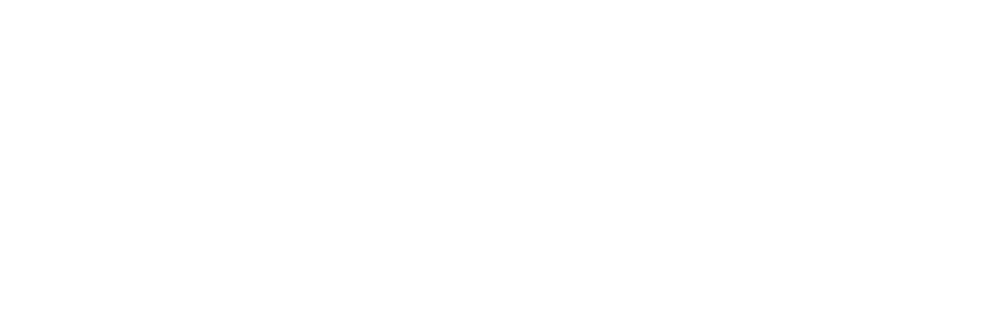

In [260]:
h = -1
sizes = [0,2,3,5]
xlim = None#(-0.2,0.2)
ylim = None#(-1.2,0.05)

plt.figure(figsize=(7.5,2.5))
plt.subplot(1,3,1)
plt.title('baseline')
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings[lkat,:,:,2,1]
ydata = h*couplings[lkat,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.xlim(xlim)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

plt.subplot(1,3,2)
plt.title(r'$\varphi_{PC}$,$\varphi_{PV}$ fixed')
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings_pcpv_fixed[lkat,:,:,2,1]
ydata = h*couplings_pcpv_fixed[lkat,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
# plt.ylim(-3,1)
# plt.xlim(-1,3)
plt.xlim(xlim)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

plt.subplot(1,3,3)
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings_fixed[lkat,:,:,2,1,1]
ydata = h*couplings_fixed[lkat,:,:,2,0,1]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
# plt.ylim(-3,1)
# plt.xlim(-1,3)
plt.title(r'$\varphi_{SST}$ fixed')
plt.xlim(xlim)
plt.ylim(ylim)
plt.tight_layout()


In [261]:
# h = -1
# sizes = [0,2,3,5]
# xlim = None#(-0.2,0.2)
# ylim = None#(-1.2,0.05)

# for ifit in range(lkat.sum()):
#     plt.figure(figsize=(7.5,2.5))
#     plt.subplot(1,3,1)
#     plt.title('losses = %.1f \n baseline'%losses[lkat][ifit])
#     # sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
#     xdata = h*couplings[lkat,:,:,2,1][ifit:ifit+1]
#     ydata = h*couplings[lkat,:,:,2,0][ifit:ifit+1]
#     sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
#     plt.axhline(0,c=(0.5,0.5,0.5))
#     plt.axvline(0,c=(0.5,0.5,0.5))
#     plt.xlabel(r'$\Delta$ SST firing rate')
#     plt.ylabel(r'$\Delta$ PC firing rate')
#     plt.xlim(xlim)
#     plt.ylim(ylim)
#     plt.tight_layout()
#     # plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

#     plt.subplot(1,3,2)
#     plt.title(r'$\varphi_{PC}$,$\varphi_{PV}$ fixed')
#     # sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
#     xdata = h*couplings_pcpv_fixed[lkat,:,:,2,1][ifit:ifit+1]
#     ydata = h*couplings_pcpv_fixed[lkat,:,:,2,0][ifit:ifit+1]
#     sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
#     plt.axhline(0,c=(0.5,0.5,0.5))
#     plt.axvline(0,c=(0.5,0.5,0.5))
#     plt.xlabel(r'$\Delta$ SST firing rate')
#     plt.ylabel(r'$\Delta$ PC firing rate')
#     # plt.ylim(-3,1)
#     # plt.xlim(-1,3)
#     plt.xlim(xlim)
#     plt.ylim(ylim)
#     plt.tight_layout()
#     # plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

#     plt.subplot(1,3,3)
#     # sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
#     xdata = h*couplings_fixed[lkat,:,:,2,1,1][ifit:ifit+1]
#     ydata = h*couplings_fixed[lkat,:,:,2,0,1][ifit:ifit+1]
#     sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
#     plt.axhline(0,c=(0.5,0.5,0.5))
#     plt.axvline(0,c=(0.5,0.5,0.5))
#     plt.xlabel(r'$\Delta$ SST firing rate')
#     plt.ylabel(r'$\Delta$ PC firing rate')
#     # plt.ylim(-3,1)
#     # plt.xlim(-1,3)
#     plt.title(r'$\varphi_{SST}$ fixed')
#     plt.xlim(xlim)
#     plt.ylim(ylim)
#     plt.tight_layout()


In [262]:
plt.close('all')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:10: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # Remove the CWD from sys.path while we load stuff.


<IPython.core.display.Javascript object>


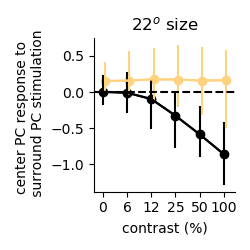

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [363]:
isize = 3

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

plot_fn = ut.plot_pct_errorbars_hillel

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
plot_fn(np.arange(6)+0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1],pct=(16,84),colors=np.array((1,0.825,0.5))[np.newaxis]) #np.array((0.7,0.7,0.7))
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

plt.axhline(0,c='k',linestyle='dashed')
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.title('%d$^o$ size'%usize[isize])
plt.xlabel('contrast (%)')
plt.ylabel('center PC response to \n surround PC stimulation')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed_no_opto.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


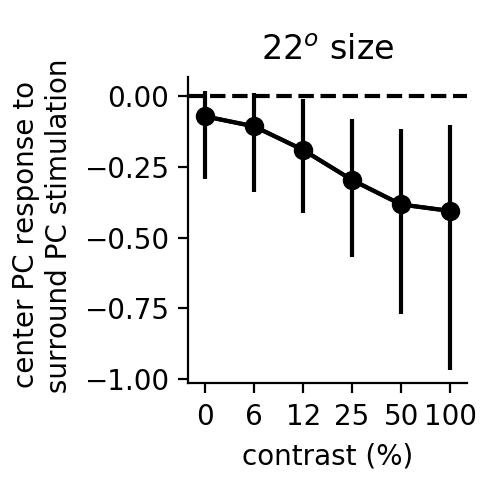

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [123]:
isize = 3

ifit = 4

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

plot_fn = ut.plot_pct_errorbars_hillel

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
# plot_fn(np.arange(6)+0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1],pct=(16,84),colors=np.array((1,0.825,0.5))[np.newaxis]) #np.array((0.7,0.7,0.7))
# plot_fn(np.arange(6)-0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,2],pct=(16,84),colors=np.array((1,0.5,1))[np.newaxis]) #np.array((0.7,0.7,0.7))
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

plt.axhline(0,c='k',linestyle='dashed')
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.title('%d$^o$ size'%usize[isize])
plt.xlabel('contrast (%)')
plt.ylabel('center PC response to \n surround PC stimulation')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_vip_fixed_no_opto.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:20: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


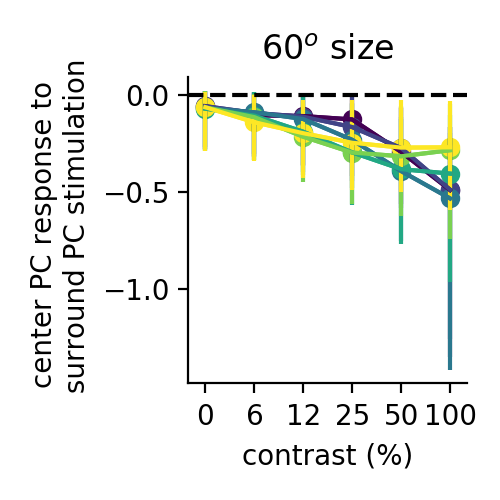

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


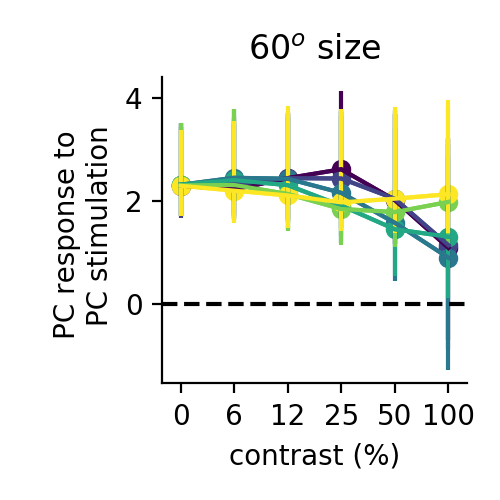

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


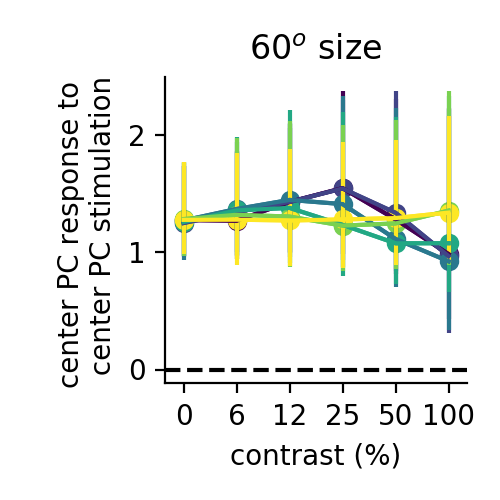

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

<IPython.core.display.Javascript object>


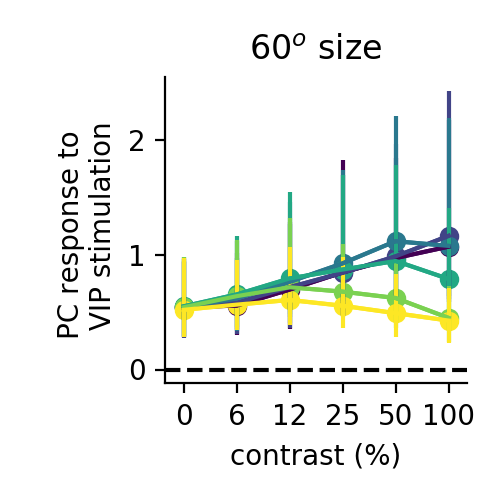

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

In [124]:
isize = 4

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

plot_fn = ut.plot_pct_errorbars_hillel
colors = plt.cm.viridis(np.linspace(0,1,6))
ctr_hot,surr_hot,vip_hot,sst_hot,pv_hot = [np.zeros((8,)) for _ in range(5)]
ctr_hot[[0]] = 1
surr_hot[[4]] = 1
ctr_surr_hot = ctr_hot + surr_hot
vip_hot[[2,6]] = 1
sst_hot[[1,5]] = 1
pv_hot[[3,7]] = 1
ylbls = ['center PC response to \n surround PC stimulation','PC response to \n PC stimulation','center PC response to \n center PC stimulation','PC response to \n VIP stimulation']

for vec_hot1,vec_hot2,ylbl in zip([surr_hot,ctr_surr_hot,ctr_hot,vip_hot],[ctr_hot,ctr_surr_hot,ctr_hot,ctr_surr_hot],ylbls):
    plt.figure(figsize=(2.5,2.5))
    for isize in range(6):
        to_plot = vec_hot1 @ couplings[ifit][low_loss[ifit],isize,np.newaxis,:,:,:] @ vec_hot2
    # plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
        plot_fn(np.arange(6),to_plot,pct=(16,84),colors=colors[isize][np.newaxis])
    # plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
    # plot_fn(np.arange(6)+0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1],pct=(16,84),colors=np.array((1,0.825,0.5))[np.newaxis]) #np.array((0.7,0.7,0.7))
    # plot_fn(np.arange(6)-0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,2],pct=(16,84),colors=np.array((1,0.5,1))[np.newaxis]) #np.array((0.7,0.7,0.7))
    # ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
    # ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

    plt.axhline(0,c='k',linestyle='dashed')
    plt.xticks(np.arange(6),[0,6,12,25,50,100])
    plt.title('%d$^o$ size'%usize[isize])
    plt.xlabel('contrast (%)')
    plt.ylabel(ylbl)
    ut.erase_top_right()
    # plt.legend(['baseline','SST fixed'])
    plt.tight_layout()
    # plt.savefig('figures/far_pc_coupling_sst_vip_fixed_no_opto.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


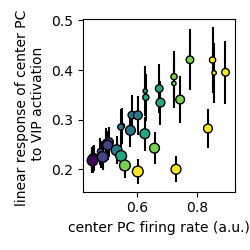

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


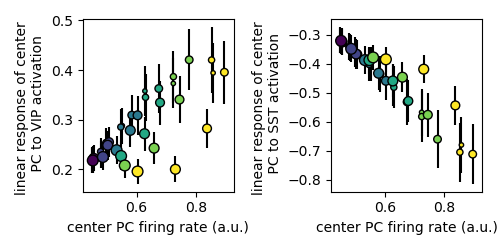

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


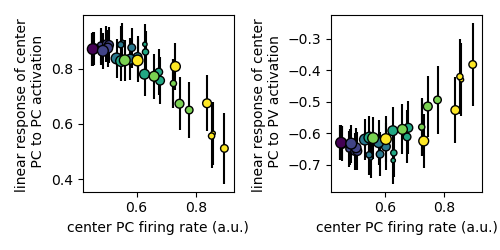

In [333]:
vec_hot1 = vip_hot
vec_hot2 = ctr_hot
plt.figure(figsize=(2.5,2.5))

ifit = 0

linear_resp = vec_hot1 @ couplings[ifit][low_loss[ifit],:,:,:,:] @ vec_hot2
sca.scatter_size_contrast_errorbar(YYs[ifit][low_loss[ifit],:,:,0],linear_resp,equality_line=False,square=False)

# linear_resp = vec_hot1 @ couplings_pcpv_rec_fixed[low_loss[ifit],:,:,:,:] @ vec_hot2
# sca.scatter_size_contrast_errorbar(YYs[ifit][low_loss[ifit],:,:,0],linear_resp,equality_line=False,square=False)

plt.xlabel('center PC firing rate (a.u.)')
plt.ylabel('linear response of center PC \n to VIP activation')
plt.tight_layout()

plt.figure(figsize=(5,2.5))
for itype,(vec_hot1,celltype_lbl) in enumerate(zip([vip_hot,sst_hot],['VIP','SST'])):
    plt.subplot(1,2,itype+1)
    linear_resp = vec_hot1 @ couplings[ifit][low_loss[ifit],:,:,:,:] @ vec_hot2
    sca.scatter_size_contrast_errorbar(YYs[ifit][low_loss[ifit],:,:,0],linear_resp,equality_line=False,square=False)
    plt.xlabel('center PC firing rate (a.u.)')
    plt.ylabel('linear response of center \n PC to %s activation'%celltype_lbl)
plt.tight_layout()
# plt.savefig('figures/pc_linear_response_to_vip_sst.eps')

plt.figure(figsize=(5,2.5))
for itype,(vec_hot1,celltype_lbl) in enumerate(zip([ctr_surr_hot,pv_hot],['PC','PV'])):
    plt.subplot(1,2,itype+1)
    linear_resp = vec_hot1 @ couplings[ifit][low_loss[ifit],:,:,:,:] @ vec_hot2
    sca.scatter_size_contrast_errorbar(YYs[ifit][low_loss[ifit],:,:,0],linear_resp,equality_line=False,square=False)
    plt.xlabel('center PC firing rate (a.u.)')
    plt.ylabel('linear response of center \n PC to %s activation'%celltype_lbl)
plt.tight_layout()
# plt.savefig('figures/pc_linear_response_to_vip_sst.eps')

In [122]:
plt.figure()


(429, 6, 6, 8)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


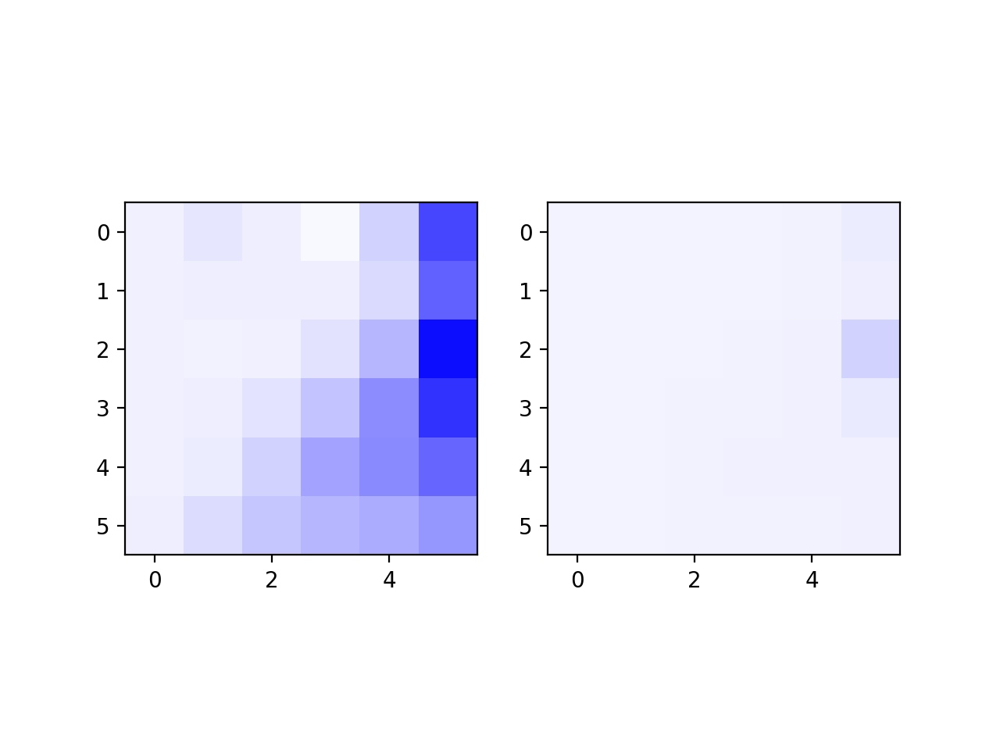

In [1115]:
plt.figure()
plt.subplot(1,2,1)
ut.imshow_hot_cold(np.nanmean(couplings_pcpv_rec_fixed[low_loss[ifit],:,:,4,0],0),mx=0.25)
plt.subplot(1,2,2)
ut.imshow_hot_cold(np.nanmean(couplings_pc_rec_fixed[low_loss[ifit],:,:,4,0],0),mx=0.25)
# plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


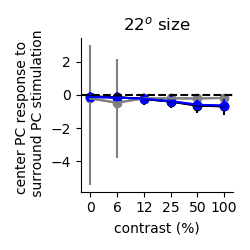

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [751]:
isize = 3
ifit = 0
reload(ut)

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

plot_fn = ut.plot_pct_errorbars_hillel

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
# plot_fn(np.arange(6)+0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1],pct=(16,84),colors=np.array((1,0.825,0.5))[np.newaxis]) #np.array((0.7,0.7,0.7))
plot_fn(np.arange(6),couplings_pc_rec_fixed[low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])
plot_fn(np.arange(6),couplings_pcpv_rec_fixed[low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

plt.axhline(0,c='k',linestyle='dashed')
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.title('%d$^o$ size'%usize[isize])
plt.xlabel('contrast (%)')
plt.ylabel('center PC response to \n surround PC stimulation')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed_no_opto_no_wpcpv.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


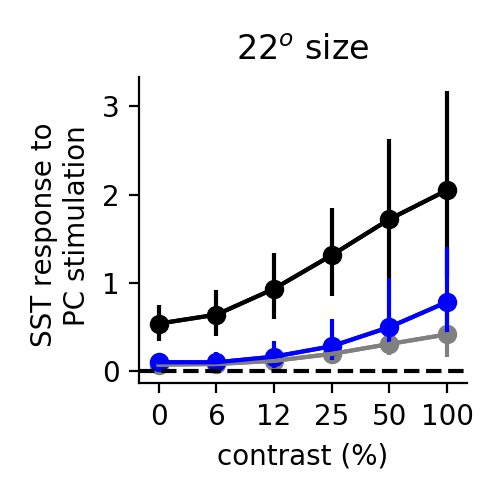

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [203]:
isize = 3
ifit = -1
reload(ut)

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

i,j = 0,1

plot_fn = ut.plot_pct_errorbars_hillel

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
# plot_fn(np.arange(6)+0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1],pct=(16,84),colors=np.array((1,0.825,0.5))[np.newaxis]) #np.array((0.7,0.7,0.7))
plot_fn(np.arange(6),couplings_pc_rec_fixed[low_loss[ifit],isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])
plot_fn(np.arange(6),couplings_pcpv_rec_fixed[low_loss[ifit],isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

plt.axhline(0,c='k',linestyle='dashed')
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.title('%d$^o$ size'%usize[isize])
plt.xlabel('contrast (%)')
plt.ylabel('SST response to \n PC stimulation')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
plt.savefig('figures/pc_sst_coupling_no_opto_no_wpcpv.eps')
plt.savefig('figures/far_pc_coupling_sst_fixed_no_opto_no_wpcpv.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


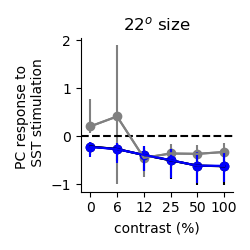

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [203]:
isize = 3
ifit = -1
reload(ut)

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)

i,j = 1,0

plot_fn = ut.plot_pct_errorbars_hillel

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
# plot_fn(np.arange(6)+0.1,couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1],pct=(16,84),colors=np.array((1,0.825,0.5))[np.newaxis]) #np.array((0.7,0.7,0.7))
plot_fn(np.arange(6),couplings_pc_rec_fixed[low_loss[ifit],isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])
plot_fn(np.arange(6),couplings_pcpv_rec_fixed[low_loss[ifit],isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv_fixed[lkat,isize,np.newaxis,:,8,0,1],pct=(16,84),colors=np.array((0.5,0.5,0.5))[np.newaxis])

plt.axhline(0,c='k',linestyle='dashed')
plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.title('%d$^o$ size'%usize[isize])
plt.xlabel('contrast (%)')
plt.ylabel('PC response to \n SST stimulation')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed'])
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_no_opto_no_wpcpv.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


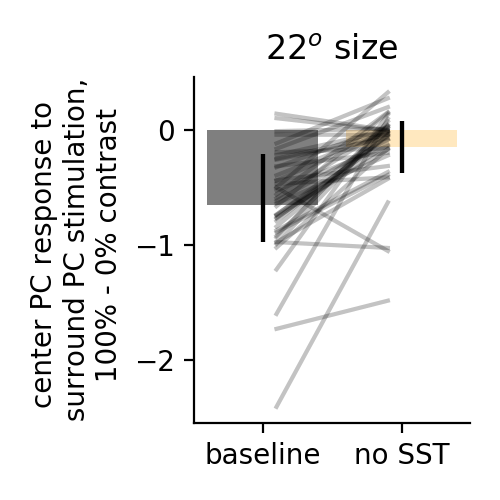

In [309]:
plt.figure(figsize=(2.5,2.5))
icontrast1,icontrast2 = 0,5
arr1 = couplings[ifit][low_loss[ifit],isize,np.newaxis,:,4,0]
arr2 = couplings_fixed[low_loss[ifit],isize,np.newaxis,:,4,0,1]
data1,data2 = [arr[:,0,icontrast2] - arr[:,0,icontrast1] for arr in [arr1,arr2]]
ut.plot_bars_with_lines(np.concatenate((data1[:,np.newaxis],data2[:,np.newaxis]),axis=1),colors=['k',np.array((1,0.825,0.5))],xticklabels=['baseline','no SST'],errorstyle='pct',alpha=0.125)
plt.ylabel('center PC response to \n surround PC stimulation, \n 100% - 0% contrast')
plt.title('%d$^o$ size'%usize[isize])
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/far_pc_coupling_sst_fixed_no_opto_dynamic_range_bars.jpg',dpi=300)


In [201]:
_,p = sst.wilcoxon(data1,data2)
print(p)

8.910656963083505e-13


<IPython.core.display.Javascript object>


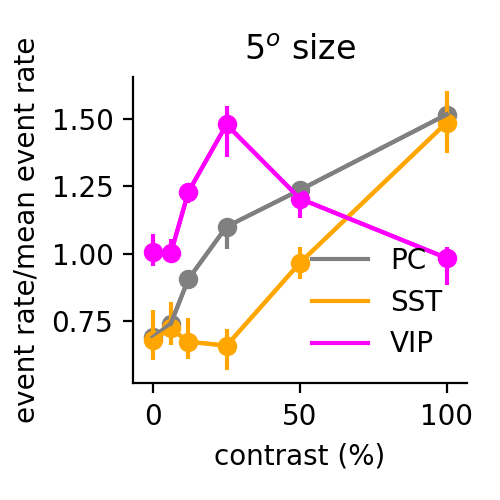

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


<IPython.core.display.Javascript object>


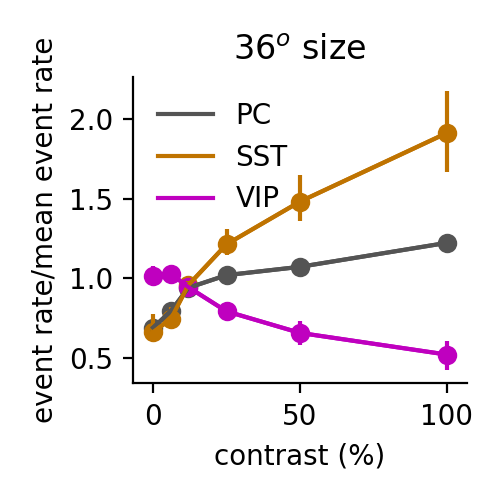

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [303]:
reload(ut)
ialign = 0
irun = 0

nr = YYs[ifit][low_loss[ifit]]

lbls = ['pc_l4','pc_l23','sst','vip','pv']
c_l4 = np.array((0,0.5,0))
c_l23 = [np.array((0.33,0.33,0.33)),np.array((0.5,0.5,0.5))][::-1]
c_sst = [np.array((0.75,0.45,0)),np.array((1,0.65,0))][::-1]
c_vip = [np.array((0.75,0,0.75)),np.array((1,0,1))][::-1]
c_pv = np.array((0,0,1))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
usize = [5,8,13,22,36,60]

for iisize,isize in enumerate([0,4]):
    plt.figure(figsize=(2.5,2.5))
    these_types = [1,2,3]
    for itype in these_types:#range(len(rsexpt)):
        data = nr[:,:,:,itype-1]
        data = data/np.nanmean(np.nanmean(data,1),1)[:,np.newaxis,np.newaxis]
    #     for icontrast in range(6):
        #     plt.errorbar([5,8,13,22,36,60],np.nanmean(data,0)[:,icontrast],compute_sem(data,0)[:,icontrast])
        ut.plot_pct_errorbars_hillel([0,6,12,25,50,100],data[:,isize:isize+1,:],pct=(16,84),colors=colors[itype][iisize][np.newaxis])
#         plt.legend(['6%','25%','100%'])
        plt.xlabel('contrast (%)')
        plt.ylabel('event rate/mean event rate')
    plt.legend(['PC','SST','VIP'],frameon=False)
    plt.title('%d$^o$ size'%usize[isize])
    ut.erase_top_right()
    plt.tight_layout()
    plt.savefig('figures/sim_pc_sst_vip_contrast_by_size_%d.eps'%isize)

In [299]:
data.shape

(94, 6, 6, 8)

In [296]:

couplings_fixed.shape#[ifit][low_loss[ifit],isize,np.newaxis,:,i,j,1]

(429, 6, 6, 8, 8, 4)

In [319]:
ifit = 0

isize = 3

# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
# lkat = np.ones_like(lkat)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings[:,isize,:,8,0].max()
# lkat = slice(None)
plot_fn = ut.plot_pct_errorbars_hillel
i,j = 4,0

plt.figure(figsize=(2.5,2.5))
# plt.plot(ucontrast,couplings[lkat,3,:,8,0].T,c='k',alpha=0.1)
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])
plot_fn(np.arange(6),couplings[ifit][low_loss[ifit],isize,np.newaxis,:,4,0],pct=(16,84),colors=np.array((0,0,0))[np.newaxis])

# plt.plot(ucontrast,couplings_fixed[lkat,isize,:,8,0,1].T,c=np.array((1,0.65,0)),alpha=0.1)
plot_fn(np.arange(6),couplings_fixed[low_loss[ifit],isize,np.newaxis,:,i,j,1],pct=(16,84),colors=np.array((1,0.65,0))[np.newaxis])
# ut.plot_bootstrapped_errorbars_hillel(np.arange(6),couplings_pcpv[lkat,isize,np.newaxis,:,8,0],pct=(16,84),colors=np.array((0,0,1))[np.newaxis])
plot_fn(np.arange(6),couplings_pcpv_rec_fixed[low_loss[ifit],isize,np.newaxis,:,i,j],pct=(16,84),colors=np.array((0.7,0.7,0.7))[np.newaxis])
plot_fn(np.arange(6),couplings_pcpv_rec_fixed_plus_fixed[low_loss[ifit],isize,np.newaxis,:,i,j,1],pct=(16,84),colors=np.array((0,1,0))[np.newaxis])

plt.xticks(np.arange(6),[0,6,12,25,50,100])
plt.xlabel('contrast (%)')
plt.ylabel(r'far PC$\rightarrow$PC coupling')
ut.erase_top_right()
# plt.legend(['baseline','SST fixed','PC/PV fixed','both fixed','PC & PV fixed'])
plt.tight_layout()
# plt.savefig('figures/far_pc_coupling_sst_fixed.eps')

<IPython.core.display.Javascript object>

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


NameError: name 'couplings_fixed' is not defined

In [634]:
iwt = 1
data = np.mean(couplings[:,:,:,8,0],0)
plt.figure()
plt.imshow(data,vmin=data.min(),vmax=data.max())
plt.colorbar()
plt.figure()
plt.imshow(np.median(couplings_fixed[:,:,:,8,0,1],0),vmin=data.min(),vmax=data.max())
plt.colorbar()

TypeError: list indices must be integers or slices, not tuple

In [265]:
plt.close('all')

<IPython.core.display.Javascript object>


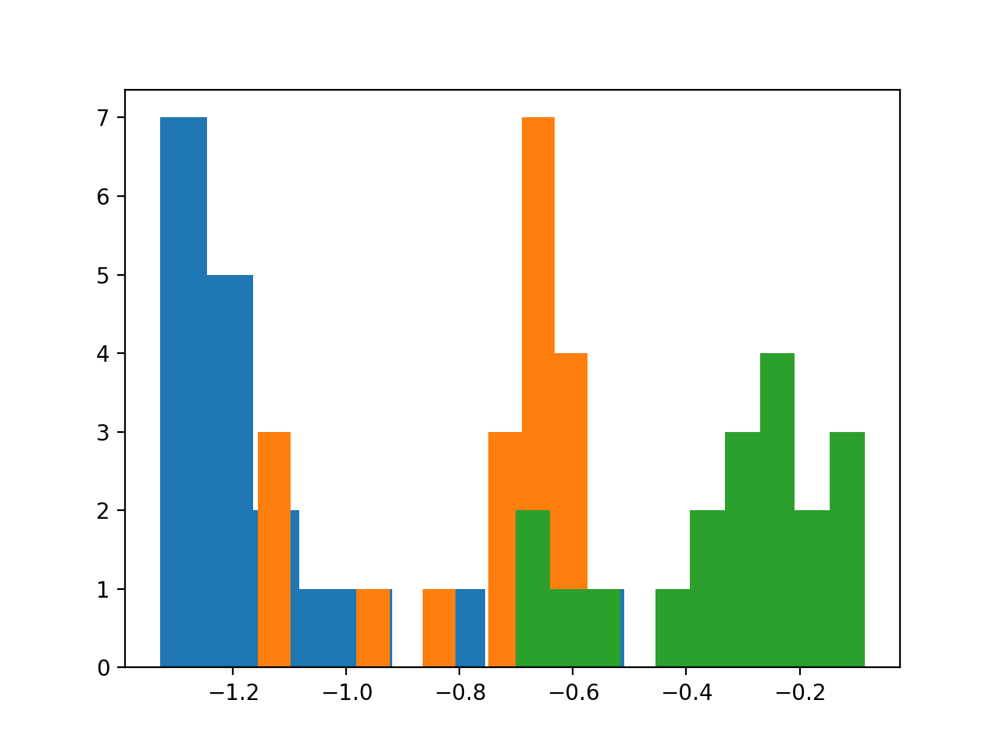

(array([2., 1., 1., 0., 1., 2., 3., 4., 2., 3.]),
 array([-0.70187236, -0.64018542, -0.57849849, -0.51681156, -0.45512463,
        -0.3934377 , -0.33175077, -0.27006384, -0.20837691, -0.14668998,
        -0.08500304]),
 <a list of 10 Patch objects>)

In [266]:
plt.figure()
plt.hist(Wmys[:,2,1])
plt.hist(Wmys[:,1,2])
plt.hist(Wmys[:,1,0])

<IPython.core.display.Javascript object>


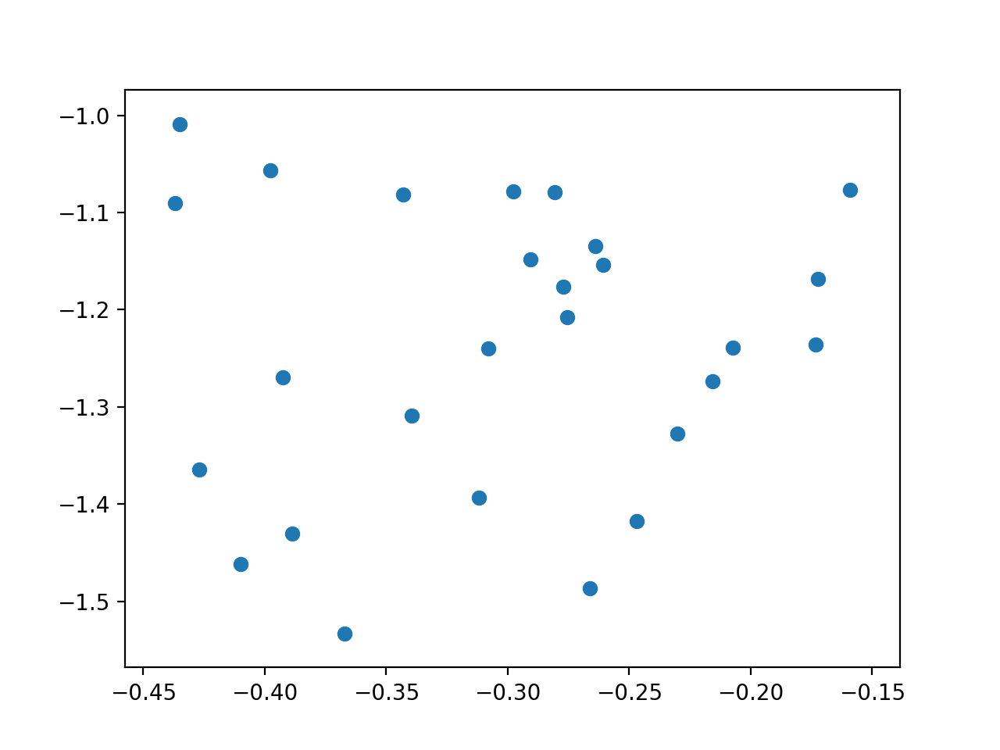

In [27]:
plt.figure()
plt.scatter(Wmys[:,2,1],Wmys[:,1,2])

In [1108]:
def var_explained(x,y):
    return 1-np.mean((x-y)**2)/np.var(x)

In [43]:
this_ncontrast = 3
cfrac = np.linspace(1,0,this_ncontrast+1)[:-1]
c_l4 = cfrac[:,np.newaxis]*np.array(((0,1,0)))
# c_sst = cfrac[:,np.newaxis]*np.array(((1,0.65,0)))
c_sst = cfrac[:,np.newaxis]*np.array(((1,0.5,0)))
c_vip = cfrac[:,np.newaxis]*np.array(((1,0,1)))
c_pv = cfrac[:,np.newaxis]*np.array(((0,0,1)))
c_l23 = cfrac[:,np.newaxis]*np.array(((0.5,0.5,0.5)))
colors = [c_l4,c_l23,c_sst,c_vip,c_pv]
lbls = ['PC','SST','VIP','PV']
usize = np.array([5,8,13,22,36,60])
ucontrast = np.array([0,6,12,25,50,100])

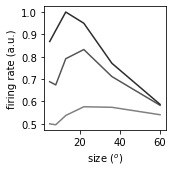

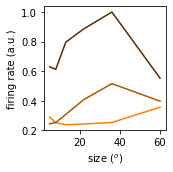

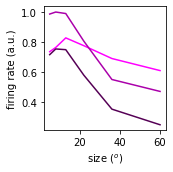

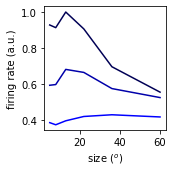

In [44]:
data = YYhat.reshape(nsize,ncontrast,nQ*nS*nT)
for itype in range(4):
    plt.figure(figsize=(2.5,2.5))
    for iicontrast,icontrast in enumerate([1,3,5]):
        plt.plot(usize,data[:,icontrast,itype],c=colors[itype+1][iicontrast])#,c=colors[itype+1])
    plt.xlabel('size ($^o$)')
    plt.ylabel('firing rate (a.u.)')
    plt.tight_layout()
#     plt.savefig('figures/modeled_%s_size_tuning.eps'%lbls[itype])

In [45]:
from importlib import reload
import naka_rushton_analysis as nra
reload(nra)
ams = [None for _ in range(5)]
for itype in range(5):
    if itype == 0:
        data = XXs[ifit][low_loss[ifit]][:,:,:,0]
    else:
        data = YYs[ifit][low_loss[ifit]][:,:,:,itype-1]
    norm_top=False
    norm_bottom=False
    if itype != 3:
        if itype == 4:
            ams[itype] = nra.ayaz_model(data,norm_top=norm_top,norm_bottom=norm_bottom,theta0=ams[1].theta)
        else:
            ams[itype] = nra.ayaz_model(data,norm_top=norm_top,norm_bottom=norm_bottom)
    if itype == 2:
        norm_bottom = True
        ams[itype] = nra.ayaz_model(data,norm_top=norm_top,norm_bottom=norm_bottom,theta0=ams[itype].theta)
    if itype == 3:
        norm_top = True
        ams[itype] = nra.ayaz_model(data,norm_top=norm_top,norm_bottom=norm_bottom)

NameError: name 'low_loss' is not defined

In [20]:
import naka_rushton_analysis as nra

In [48]:
plot_interp = False

In [49]:
model_fits#[ifit]

__main__.model_fits

/Users/dan/Documents/code/adesnal/pyute.py:929: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  arr_norm = arr/mn[slicer]
/Users/dan/Documents/code/adesnal/pyute.py:1665: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  gray = sc[slc].mean(contrast_axis-1) #(nroi,1,nother...)
/Users/dan/Documents/code/adesnal/pyute.py:1669: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will 

linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting


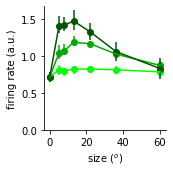

In [53]:
reload(nra)
ifit = -1
these_contrasts = [1,3,5]
usize0 = np.concatenate(((0,),usize))
for itype in range(1):
    plt.figure(figsize=(2.5,2.5))
    if plot_interp:
        nra.plot_interp_size_tuning(ams=ams[itype],ucontrast=ucontrast/100,these_contrasts=these_contrasts,colors=colors[itype],error_type='pct')
    else:
        this_data = ut.norm_to_mean(mf[ifit].XXs[mf[ifit].low_loss][:,:,:,itype])
        size_tuning = ut.compute_size_tuning(this_data)
        ut.plot_pct_errorbars_hillel(usize0,size_tuning[:,:,[0,2,4]].transpose((0,2,1)),colors=colors[itype])
        plt.xlabel('size ($^o$)')
    plt.ylabel('firing rate (a.u.)')
    plt.tight_layout()
    ut.erase_top_right()
    ut.zero_origin()
#     plt.savefig('figures/pre_opto_modeled_L4_size_tuning.eps')


In [84]:
reload(ut)
ut.norm_to_mean(mf[ifit].XXs[mf[ifit].low_loss][:,:,:,itype]).shape

/Users/dan/Documents/code/adesnal/pyute.py:921: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  errors = np.concatenate((errorplus[np.newaxis],errorminus[np.newaxis]),axis=0)


(94, 6, 6)

/Users/dan/Documents/code/adesnal/pyute.py:929: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  arr_norm = arr/mn[slicer]
/Users/dan/Documents/code/adesnal/pyute.py:1665: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  gray = sc[slc].mean(contrast_axis-1) #(nroi,1,nother...)
/Users/dan/Documents/code/adesnal/pyute.py:1669: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will 

linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting


/Users/dan/Documents/code/adesnal/pyute.py:929: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  arr_norm = arr/mn[slicer]
/Users/dan/Documents/code/adesnal/pyute.py:1665: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  gray = sc[slc].mean(contrast_axis-1) #(nroi,1,nother...)
/Users/dan/Documents/code/adesnal/pyute.py:1669: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will 

linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting


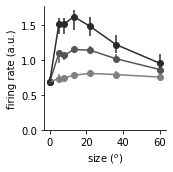

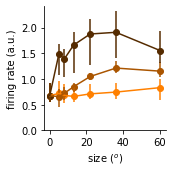

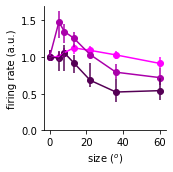

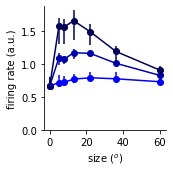

In [54]:
ifit = -1
usize0 = np.concatenate(((0,),usize))
for itype in range(4):
    plt.figure(figsize=(2.5,2.5))
    if plot_interp:
        nra.plot_interp_size_tuning(ams=ams[itype+1],ucontrast=ucontrast/100,these_contrasts=these_contrasts,colors=colors[itype+1],error_type='pct')
    else:
        this_data = ut.norm_to_mean(mf[ifit].YYs[mf[ifit].low_loss][:,:,:,itype])
        size_tuning = ut.compute_size_tuning(this_data)
        ut.plot_pct_errorbars_hillel(usize0,size_tuning[:,:,[0,2,4]].transpose((0,2,1)),colors=colors[itype+1])
    #     ut.plot_pct_errorbars_hillel(usize,YYs[ifit][low_loss[ifit]][:,:,[1,3,5],itype].transpose((0,2,1)),colors=colors[itype+1])
        plt.xlabel('size ($^o$)')
        plt.ylabel('firing rate (a.u.)')
        ut.erase_top_right()
        ut.zero_origin()
        plt.tight_layout()
#         plt.savefig('figures/pre_opto_modeled_%s_size_tuning.eps'%lbls[itype])
    

/Users/dan/Documents/code/adesnal/pyute.py:929: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  arr_norm = arr/mn[slicer]
/Users/dan/Documents/code/adesnal/pyute.py:1665: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  gray = sc[slc].mean(contrast_axis-1) #(nroi,1,nother...)
/Users/dan/Documents/code/adesnal/pyute.py:1669: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will 

linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting


/Users/dan/Documents/code/adesnal/pyute.py:929: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  arr_norm = arr/mn[slicer]
/Users/dan/Documents/code/adesnal/pyute.py:1665: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  gray = sc[slc].mean(contrast_axis-1) #(nroi,1,nother...)
/Users/dan/Documents/code/adesnal/pyute.py:1669: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will 

linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting
linewidth: 1
plotting


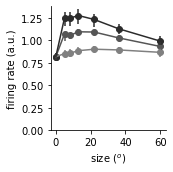

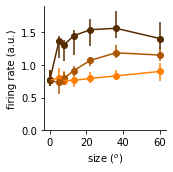

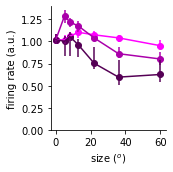

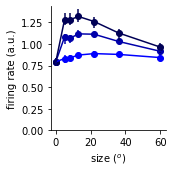

In [63]:
ifit = -1
usize0 = np.concatenate(((0,),usize))
for itype in range(4):
    plt.figure(figsize=(2.5,2.5))
    if plot_interp:
        nra.plot_interp_size_tuning(ams=ams[itype+1],ucontrast=ucontrast/100,these_contrasts=these_contrasts,colors=colors[itype+1],error_type='pct')
    else:
        this_data = ut.norm_to_mean(mf[ifit].phis[mf[ifit].low_loss][:,:,:,itype])
        size_tuning = ut.compute_size_tuning(this_data)
        ut.plot_pct_errorbars_hillel(usize0,size_tuning[:,:,[0,2,4]].transpose((0,2,1)),colors=colors[itype+1])
    #     ut.plot_pct_errorbars_hillel(usize,YYs[ifit][low_loss[ifit]][:,:,[1,3,5],itype].transpose((0,2,1)),colors=colors[itype+1])
        plt.xticks((0,20,40,60))
        plt.xlabel('size ($^o$)')
        plt.ylabel('firing rate (a.u.)')
        ut.erase_top_right()
        ut.zero_origin()
        plt.tight_layout()
        plt.savefig('figures/pre_opto_modeled_%s_phis_size_tuning.eps'%lbls[itype])
    

In [61]:
mf[ifit].YYs.shape

(950, 6, 6, 8)

In [60]:
mf[ifit].phis.shape

(950, 6, 6, 8)

In [273]:
ifit = -1
lkat = np.nanmax(np.abs(couplings[ifit][low_loss[ifit],:,:,i,j]))<10

/Users/dan/Documents/code/adesnal/size_contrast_analysis.py:1071: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  zdata_slope = np.diff(zdata,axis=axis)/np.diff(tdata)[slicer]
/Users/dan/Documents/code/adesnal/size_contrast_analysis.py:1076: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
  zdata_slope_avg[slicer] = zdata_slope[slicer]
/Users/dan/Documents/code/adesnal/size_contrast_analysis.py:1083: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future 

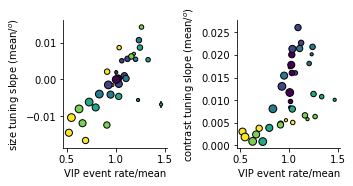

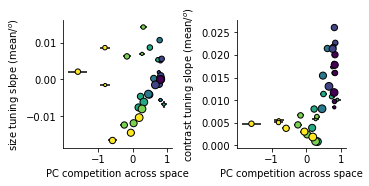

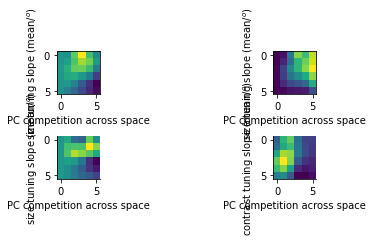

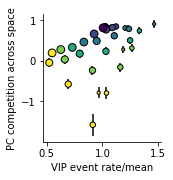

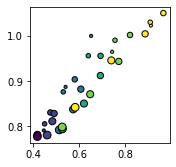

In [88]:
reload(ut)
ifit = -1

usize = np.array((5,8,13,22,35,60))
ucontrast = np.array((0,6,12,25,50,100))

itype = 0
size_slp = sca.compute_slope_avg(usize,YYs[ifit][low_loss[ifit]][:,:,:,itype],axis=1)
contrast_slp = sca.compute_slope_avg(ucontrast,YYs[ifit][low_loss[ifit]][:,:,:,itype],axis=2)

# size_slp = sca.compute_diff_avg(YYs[ifit][low_loss[ifit]][:,:,:,itype],axis=1)
# contrast_slp = sca.compute_diff_avg(YYs[ifit][low_loss[ifit]][:,:,:,itype],axis=2)

use_diff = False

if use_diff:
    sst_vip_diff = YYs[ifit][low_loss[ifit]][:,:,:,1] - YYs[ifit][low_loss[ifit]][:,:,:,2]
# sst_vip_sum = YYs[ifit][low_loss[ifit]][:,:,:,1] + YYs[ifit][low_loss[ifit]][:,:,:,2]
else:
    sst_vip_diff = YYs[ifit][low_loss[ifit]][:,:,:,2]
pc_rate = YYs[ifit][low_loss[ifit]][:,:,:,0] #+ YYs[ifit][low_loss[ifit]][:,:,:,2]
i,j = 4,0
cpl = couplings[ifit][low_loss[ifit],:,:,i,j] #+ couplings[ifit][low_loss[ifit],:,:,0,0]

if norm_to_mean:
    cpl = ut.norm_to_mean(cpl,pc_rate)
    size_slp = ut.norm_to_mean(size_slp,pc_rate)
    contrast_slp = ut.norm_to_mean(contrast_slp,pc_rate)
    sst_vip_diff = ut.norm_to_mean(sst_vip_diff)

plt.figure(figsize=(5,2.5))
plt.subplot(1,2,1)
sca.scatter_size_contrast_errorbar(sst_vip_diff,size_slp,equality_line=False,square=False)
if use_diff:
    plt.xlabel('SST $-$ VIP event rate/mean')
else:
    plt.xlabel('VIP event rate/mean')
plt.ylabel('size tuning slope (mean/$^o$)')
ut.erase_top_right()
plt.subplot(1,2,2)
sca.scatter_size_contrast_errorbar(sst_vip_diff,contrast_slp,equality_line=False,square=False)
if use_diff:
    plt.xlabel('SST $-$ VIP event rate/mean')
else:
    plt.xlabel('VIP event rate/mean')
plt.ylabel('contrast tuning slope (mean/$^o$)')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/slopes_vs_sst_vip.eps')

plt.figure(figsize=(5,2.5))
plt.subplot(1,2,1)
sca.scatter_size_contrast_errorbar(cpl,size_slp,equality_line=False,square=False)
plt.xlabel('PC competition across space')
plt.ylabel('size tuning slope (mean/$^o$)')
ut.erase_top_right()
plt.subplot(1,2,2)
sca.scatter_size_contrast_errorbar(cpl,contrast_slp,equality_line=False,square=False)
plt.xlabel('PC competition across space')
plt.ylabel('contrast tuning slope (mean/$^o$)')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/slopes_vs_pc_competition.eps')

plt.figure(figsize=(7.5,2.5))
plt.subplot(2,2,1)
plt.imshow(np.nanmean(sst_vip_diff,0))
plt.xlabel('PC competition across space')
plt.ylabel('size tuning slope (mean/$^o$)')
plt.subplot(2,2,2)
plt.imshow(np.nanmean(sst_vip_sum,0))
plt.xlabel('PC competition across space')
plt.ylabel('size tuning slope (mean/$^o$)')
plt.subplot(2,2,3)
plt.imshow(np.nanmean(size_slp,0))
plt.xlabel('PC competition across space')
plt.ylabel('size tuning slope (mean/$^o$)')
ut.erase_top_right()
plt.subplot(2,2,4)
plt.imshow(np.nanmean(contrast_slp,0))
plt.xlabel('PC competition across space')
plt.ylabel('contrast tuning slope (mean/$^o$)')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/slopes_vs_pc_competition.eps')

plt.figure(figsize=(2.5,2.5))
# plt.subplot(1,2,1)
sca.scatter_size_contrast_errorbar(sst_vip_diff,cpl,equality_line=False,square=False)
if use_diff:
    plt.xlabel('SST $-$ VIP event rate/mean')
else:
    plt.xlabel('VIP event rate/mean')
plt.ylabel('PC competition across space')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/pc_competition_vs_sst_vip.eps')

plt.figure(figsize=(2.5,2.5))
sca.scatter_size_contrast(np.nanmean(pc_rate,0),np.nanmean(sst_vip_sum,0),equality_line=False,square=False)

(0.1998721819868576, 0.2425047133125469)


In [99]:
def compare_xy_mean(xdata,ydata):
    slope, intercept, r_value, p_value, std_err = sst.linregress(np.nanmean(xdata,0).flatten(), np.nanmean(ydata,0).flatten())
    print((r_value,p_value))
def compare_xy_flat(xdata,ydata):
    slope, intercept, r_value, p_value, std_err = sst.linregress(xdata.flatten(), ydata.flatten())
    print((r_value,p_value))
for x,y in [(cpl,size_slp),(cpl,contrast_slp),(sst_vip_diff,cpl)]:
    compare_xy_mean(x,y)
print()
for x,y in [(cpl,size_slp),(cpl,contrast_slp),(sst_vip_diff,cpl)]:
    compare_xy_flat(x,y)

(0.1998721819868576, 0.2425047133125469)
(0.638192111492704, 2.8200211873869297e-05)
(0.3914062769351386, 0.018245042517649326)

(0.11481458225929599, 2.1027203753182555e-11)
(0.3497475870263833, 5.906692906524e-98)
(0.1727753901879455, 4.35825592420351e-24)


(0.3914062769351386, 0.018245042517649326)


In [286]:
# plt.figure(figsize=(5,2.5))
types = [0,1]
ccs = np.zeros((nfiles,nQ*nS*nT))
for iwt in range(nfiles):
    for itype,thistype in enumerate(np.arange(nQ*nS*nT)):
#         plt.subplot(1,2,itype+1)
        xdata = YYhat[:,thistype].reshape((6,6))
        ydata = YYs[iwt,:,:,thistype]
    #     sca.scatter_size_contrast(xdata,ydata)
        ccs[iwt,itype] = var_explained(xdata,ydata)

In [455]:
import os
os.listdir('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/')

['vip_chrimson_data_for_sim.npy',
 'fit_graphics',
 'dynamics',
 '.DS_Store',
 'rs_vm_denoise_200605.npy',
 'weights',
 'vip_halo_data_for_sim.npy']

In [475]:
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_halo_data_for_sim.npy',allow_pickle=True)[()]
Yhat_opto = npyfile['Yhat_opto']


In [1074]:
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_halo_data_for_sim_vip_full_info.npy',allow_pickle=True)[()]
Yhat_halo = npyfile['Yhat_opto']
npyfile = np.load('/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/vip_chrimson_data_for_sim.npy',allow_pickle=True)[()]
Yhat_chrimson = npyfile['Yhat_opto']


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:17: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


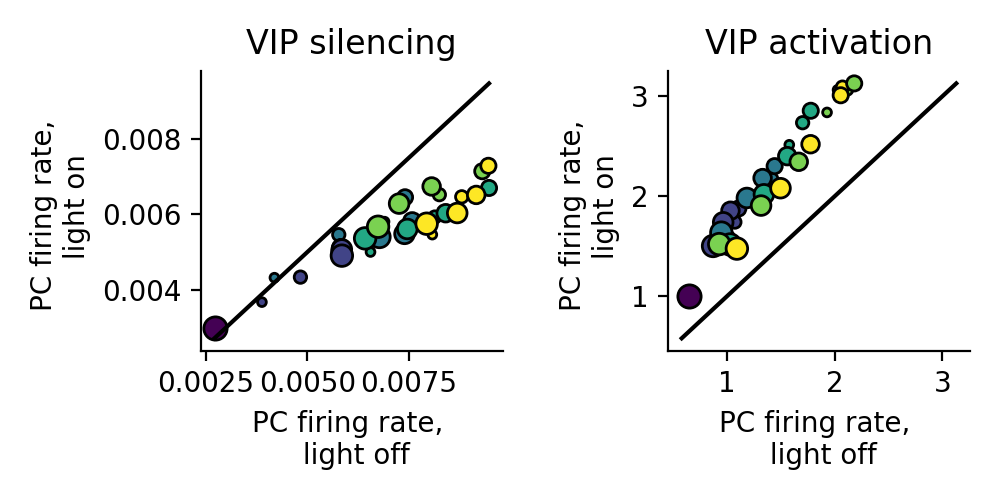

<IPython.core.display.Javascript object>


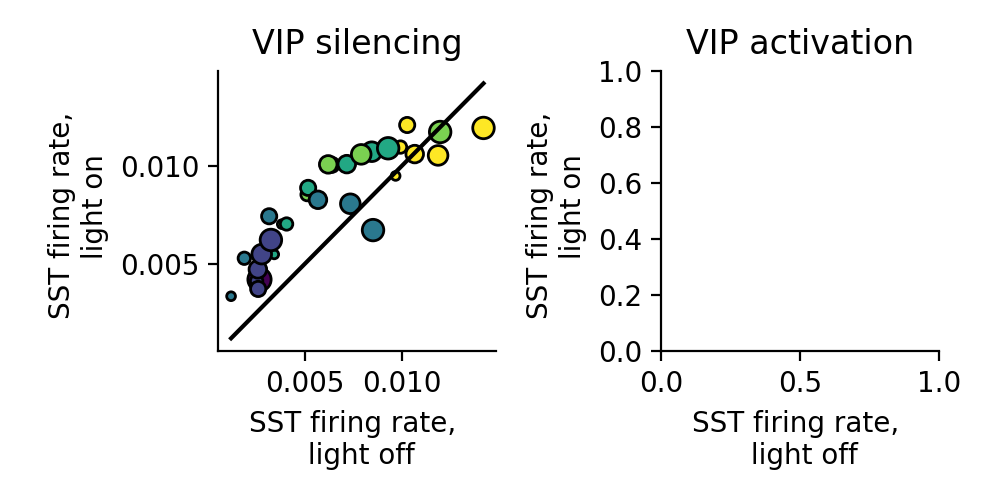

<IPython.core.display.Javascript object>


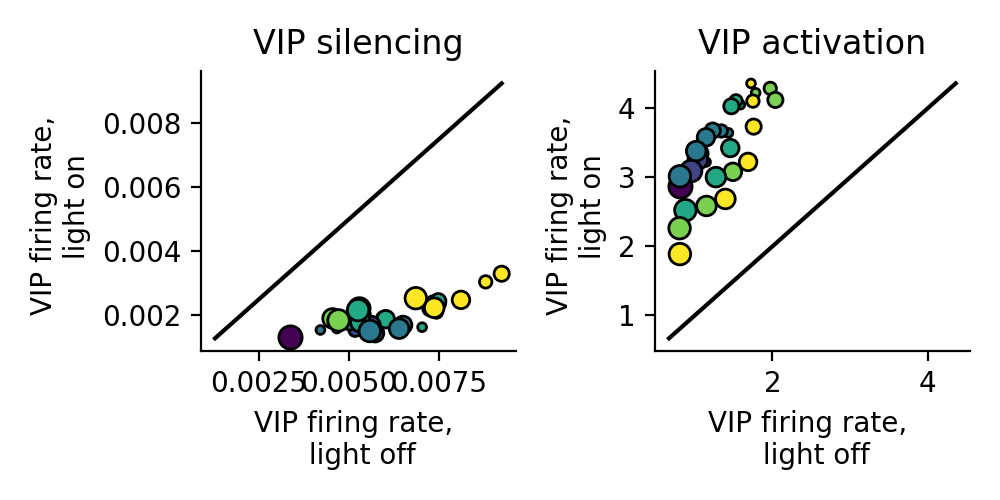

<IPython.core.display.Javascript object>


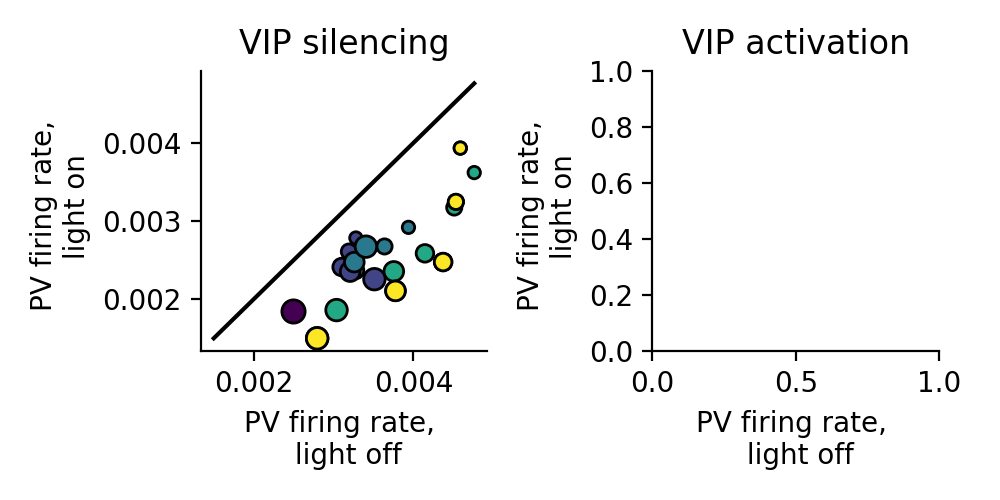

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


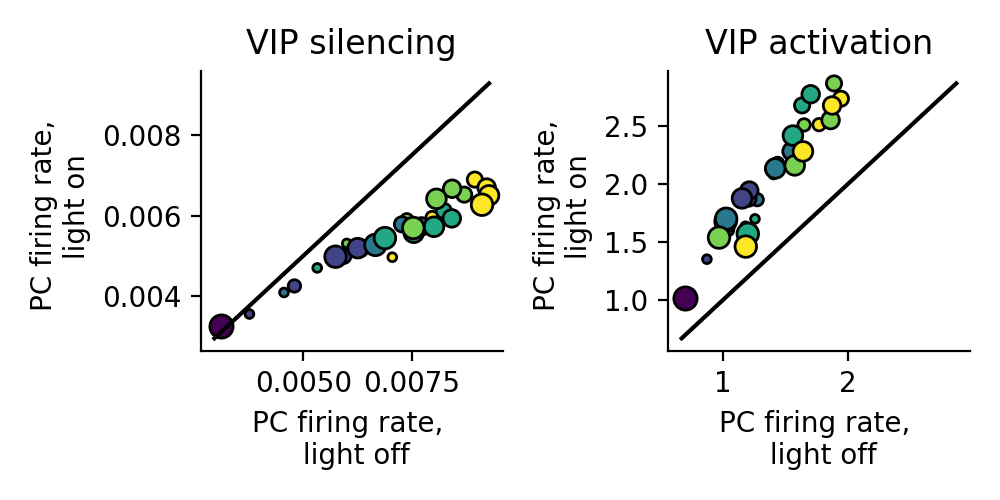

<IPython.core.display.Javascript object>


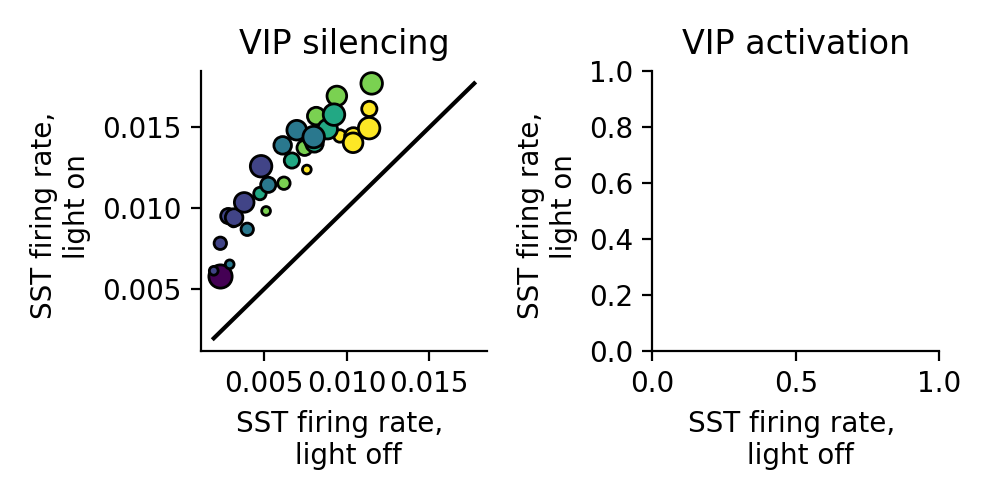

<IPython.core.display.Javascript object>


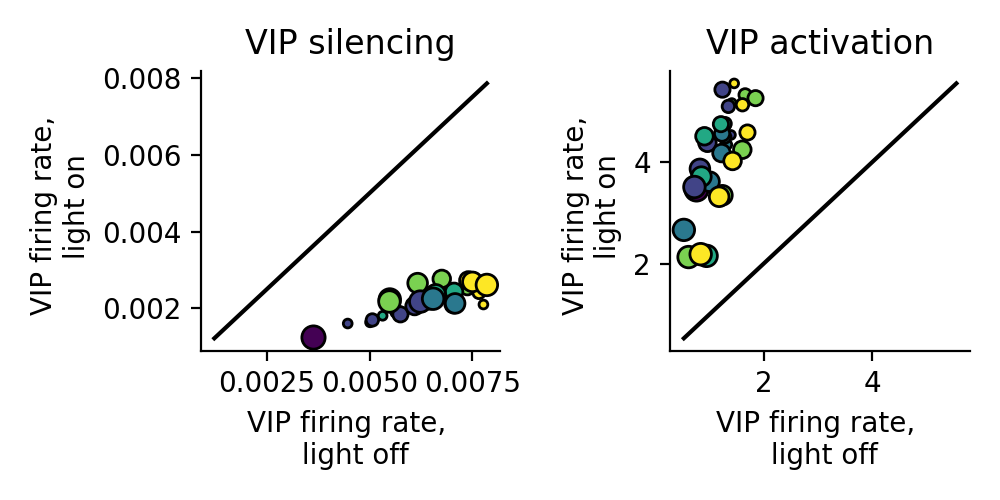

<IPython.core.display.Javascript object>


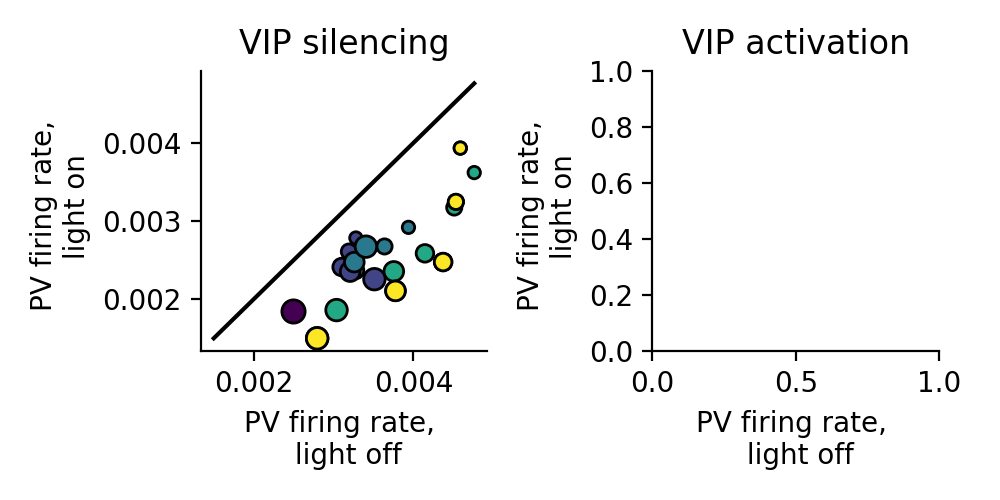

In [1077]:
# lbls = ['PC','SST','VIP','PV']
# for itype in np.arange(4):
#     plt.figure(figsize=(5,2.5))
#     titles = ['VIP silencing','VIP activation']
#     for iyy,yy in enumerate([YY1s,YY2s]):
#         plt.subplot(1,2,iyy+1)
#         sca.scatter_size_contrast_errorbar(YYs[lkat,:,:,itype],yy[lkat,:,:,itype])#,mn=0)
#         plt.title(titles[iyy])
#         plt.xlabel('%s event rate, \n light off'%lbls[itype])
#         plt.ylabel('%s event rate, \n light on'%lbls[itype])
#         ut.erase_top_right()
#     plt.tight_layout()
#     plt.savefig('figures/bidi_nonlinear_%s_scatter_size_contrast.eps'%lbls[itype])
mxs = [1,1.5,2,1]
lbls = ['PC','SST','VIP','PV']
for itype in range(4):#8,12):
    plt.figure(figsize=(5,2.5))
    titles = ['VIP silencing','VIP activation']
    for iyy,yy in enumerate([Yhat_halo,Yhat_chrimson]):
        plt.subplot(1,2,iyy+1)
        if np.sum(~np.isnan(yy[:,itype]))>0:
            sca.scatter_size_contrast(yy[0::2,itype],yy[1::2,itype],nsize=6,ncontrast=6,equate_0=True)#,mn=0,mx=mxs[itype])
        plt.title(titles[iyy])
        plt.xlabel('%s firing rate, \n light off'%lbls[np.remainder(itype,4)])
        plt.ylabel('%s firing rate, \n light on'%lbls[np.remainder(itype,4)])
        ut.erase_top_right()
    plt.tight_layout()
    
for itype in range(4):#8,12):
    plt.figure(figsize=(5,2.5))
    titles = ['VIP silencing','VIP activation']
    for iyy,yy in enumerate([Yhat_halo,Yhat_chrimson]):
        plt.subplot(1,2,iyy+1)
        if np.sum(~np.isnan(yy[:,itype]))>0:
            sca.scatter_size_contrast(yy[0::2,itype+8],yy[1::2,itype+8],nsize=6,ncontrast=6,equate_0=True)#,mn=0,mx=mxs[itype])
        plt.title(titles[iyy])
        plt.xlabel('%s firing rate, \n light off'%lbls[np.remainder(itype,4)])
        plt.ylabel('%s firing rate, \n light on'%lbls[np.remainder(itype,4)])
        ut.erase_top_right()
    plt.tight_layout()
#     plt.savefig('figures/bidi_nonlinear_%s_scatter_size_contrast.eps'%lbls[itype])

<IPython.core.display.Javascript object>


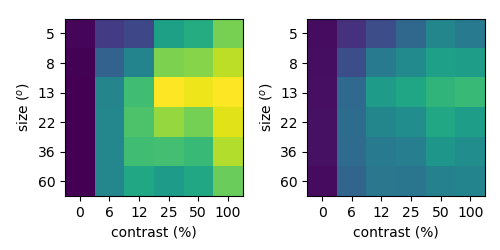

<IPython.core.display.Javascript object>


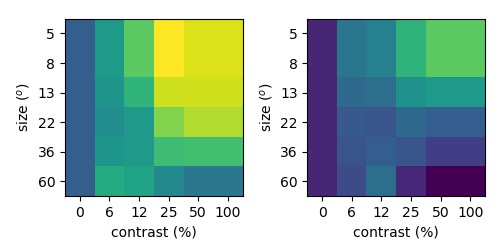

In [373]:
for itype in [0,3]:
    mn = np.nanmin(Yhat_halo[:,itype])
    mx = np.nanmax(Yhat_halo[:,itype])
    plt.figure(figsize=(5,2.5))
    for ilight in range(2):
        plt.subplot(1,2,ilight+1)
        sca.show_size_contrast(Yhat_halo[:,itype].reshape((6,6,2))[:,:,ilight],vmin=mn,vmax=mx)
    plt.tight_layout()


In [460]:
dYY = Yhat_opto[1::2]-Yhat_opto[0::2]

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


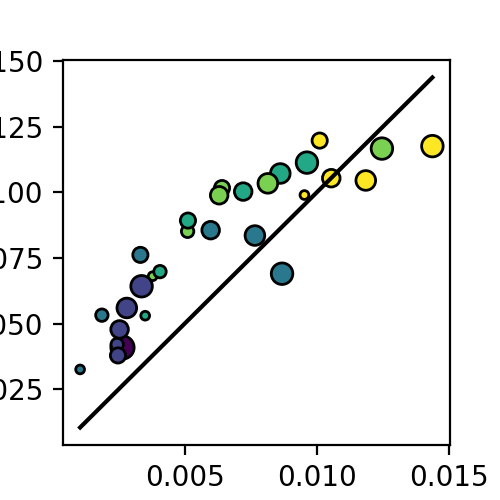

In [1349]:
itype = 1
plt.figure(figsize=(2.5,2.5))
sca.scatter_size_contrast(Yhat_opto[0::2,itype],Yhat_opto[1::2,itype],nsize=6,ncontrast=6,equate_0=True)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


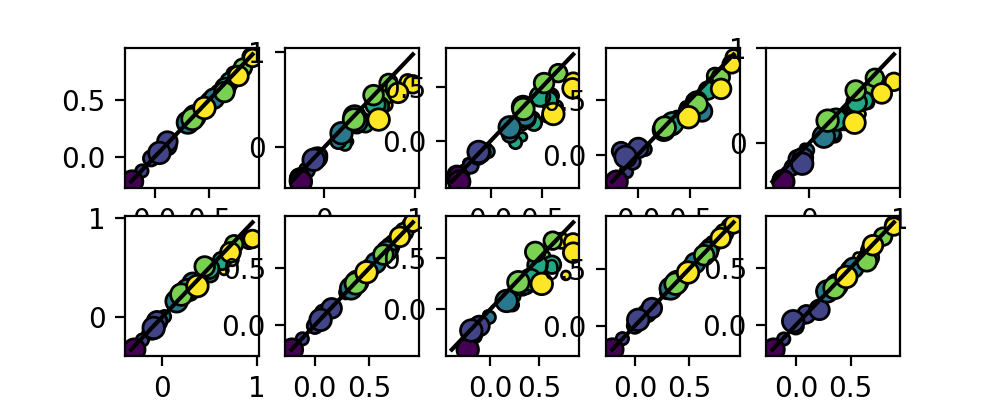

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


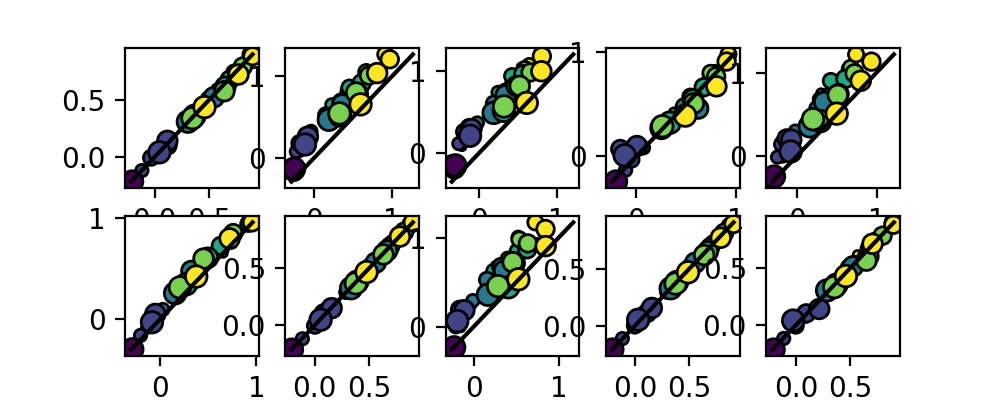

<IPython.core.display.Javascript object>


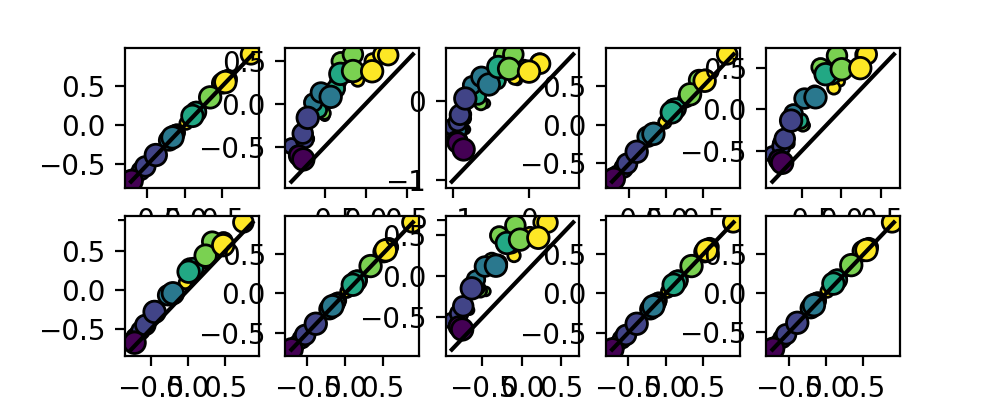

<IPython.core.display.Javascript object>


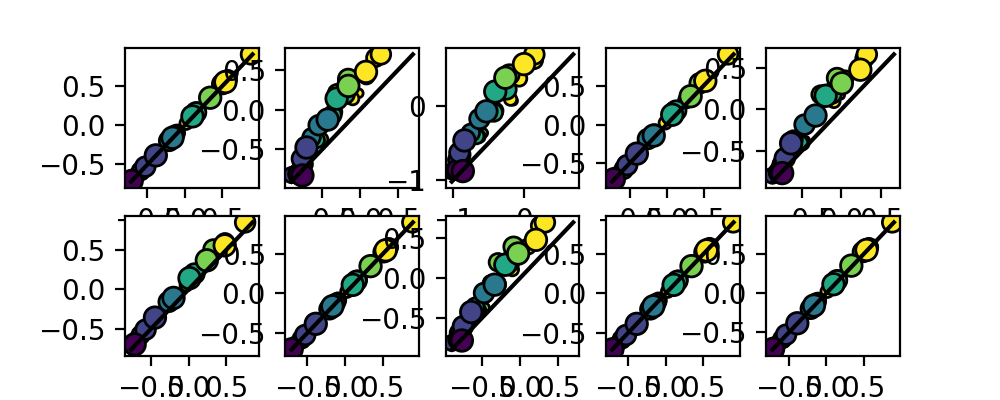

<IPython.core.display.Javascript object>


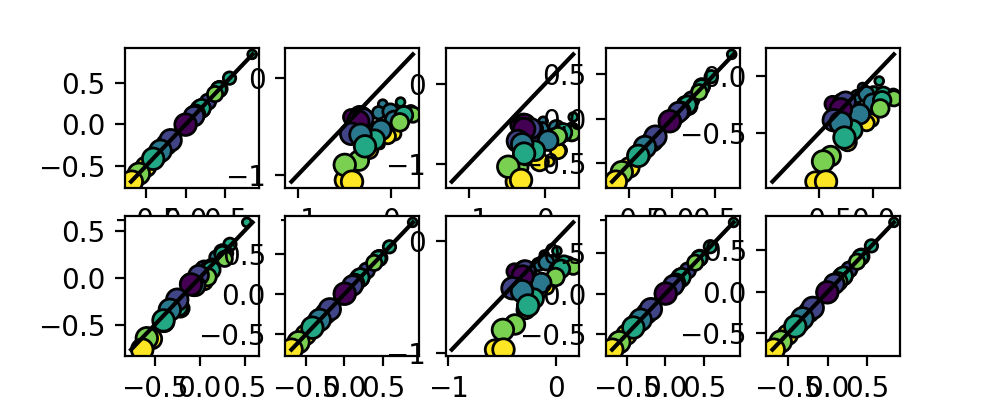

<IPython.core.display.Javascript object>


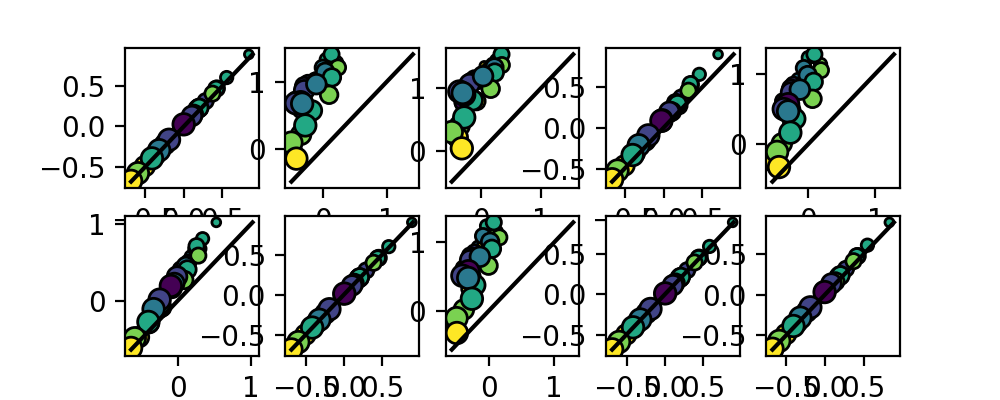

In [1532]:
iwt = 0
for itype in range(3):
    plt.figure(figsize=(5,2))
    for iwt in range(10):
        plt.subplot(2,5,iwt+1)
        sca.scatter_size_contrast(Etas[iwt,:,:,itype],Eta1s[iwt,:,:,itype],nsize=6,ncontrast=6)
    plt.figure(figsize=(5,2))
    for iwt in range(10):
        plt.subplot(2,5,iwt+1)
        sca.scatter_size_contrast(Etas[iwt,:,:,itype],Eta2s[iwt,:,:,itype],nsize=6,ncontrast=6)

<IPython.core.display.Javascript object>


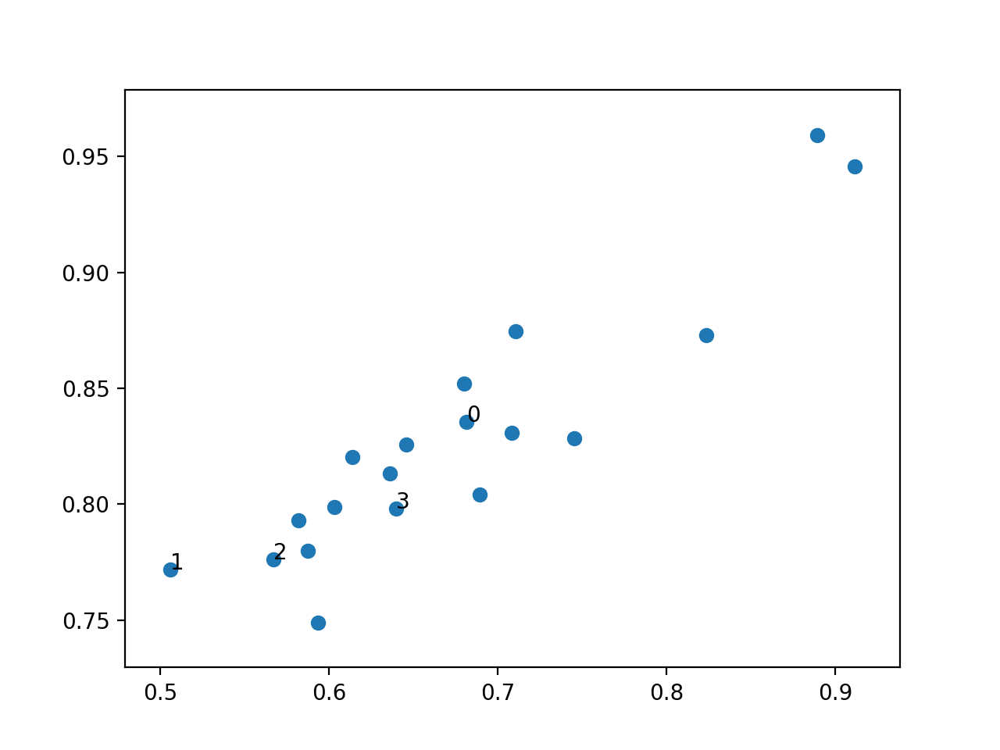

In [410]:
plt.figure()
plt.scatter(ccs[:,0],ccs[:,1])
for iwt in range(nfiles):
    plt.text(ccs[iwt,0],ccs[iwt,1],iwt)
lkat = (ccs[:,0]>0.8) & (ccs[:,1]>0.9)
nlkat = lkat.sum()

In [1121]:
len(weights_files)


372

In [1122]:
weights_files

['/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/000.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/001.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/002.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/003.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/004.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/005.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/006.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/007.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weights_201203g/008.npy',
 '/Users/dan/Documents/notebooks/mossing-PC/shared_data/calnet_data/weights/weight

In [170]:
# these_weights_files = [weights_files[i] for i in np.where(lkat)[0]] # weights_files.copy()# weights_files.copy() #[3,4,5,10,12,23]
these_weights_files = [weights_files[i] for i in np.where(lkat)[0]]#[[3,4,5,10,12,23]]] # weights_files.copy()# weights_files.copy() #
np.save('weights_files_list.npy',these_weights_files,allow_pickle=True)

In [171]:
np.where(lkat)[0].dtype

dtype('int64')

<IPython.core.display.Javascript object>


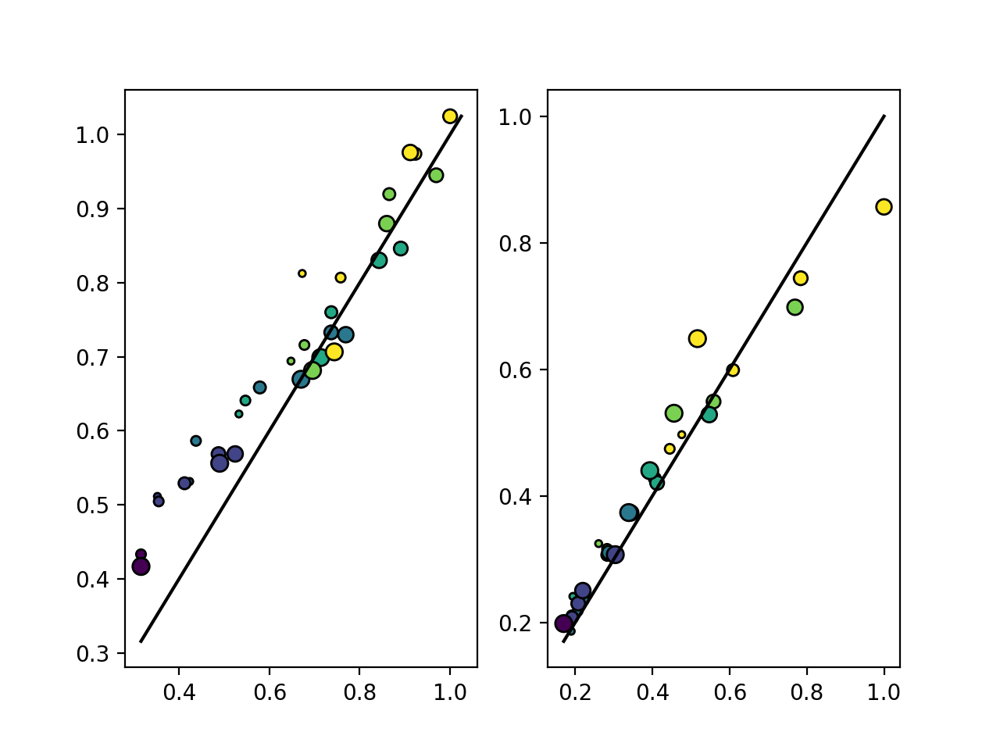

<IPython.core.display.Javascript object>


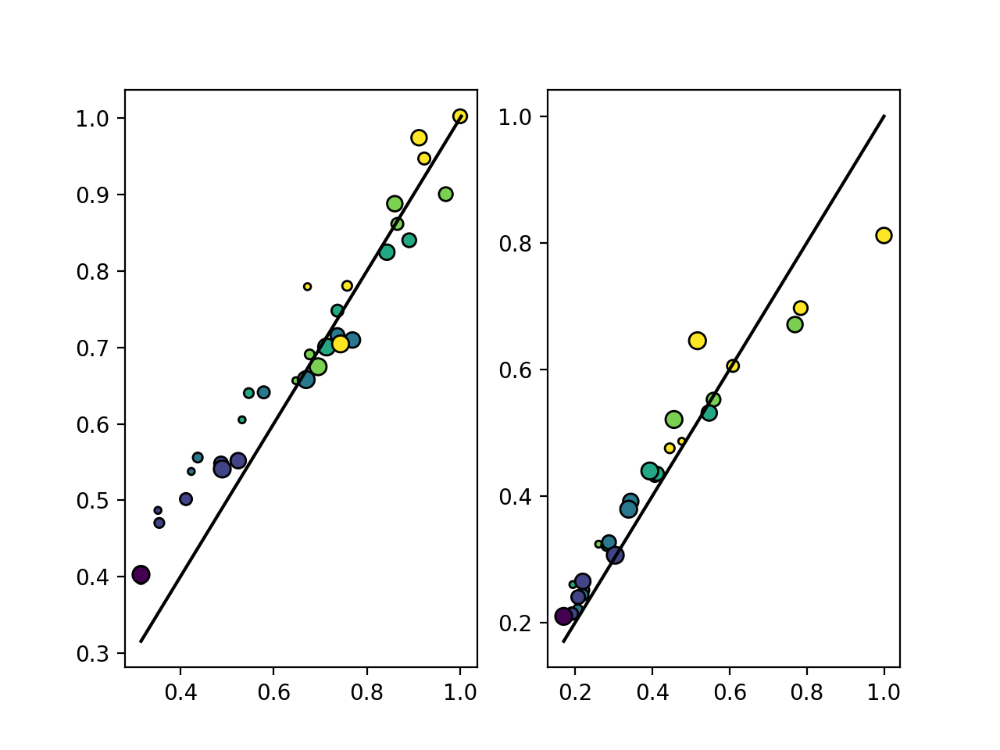

<IPython.core.display.Javascript object>


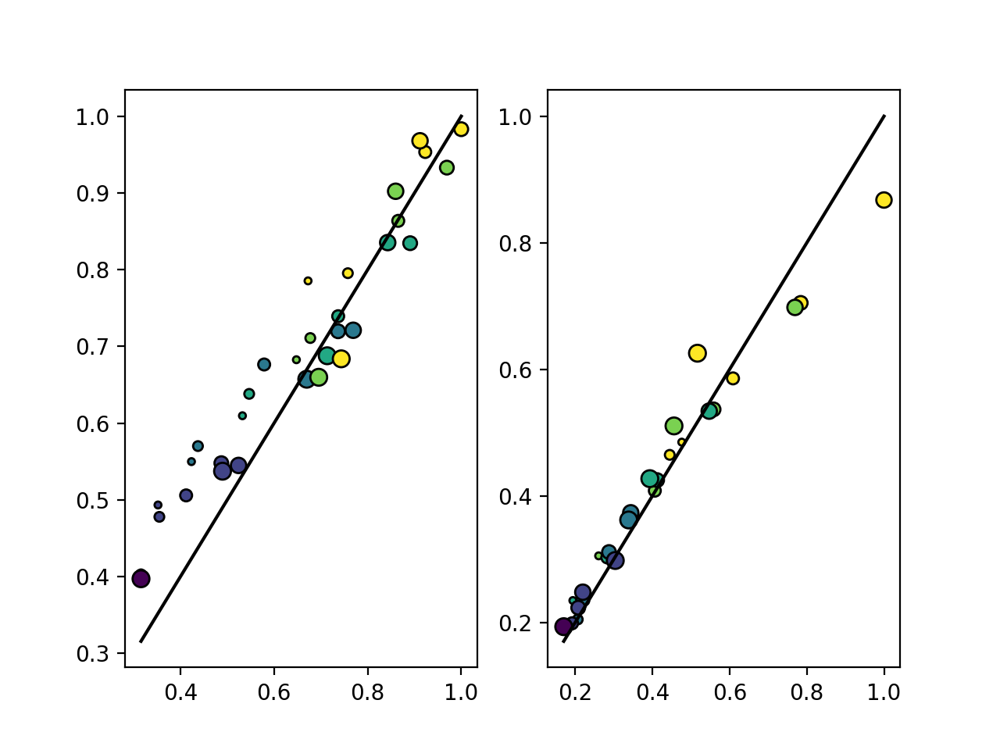

<IPython.core.display.Javascript object>


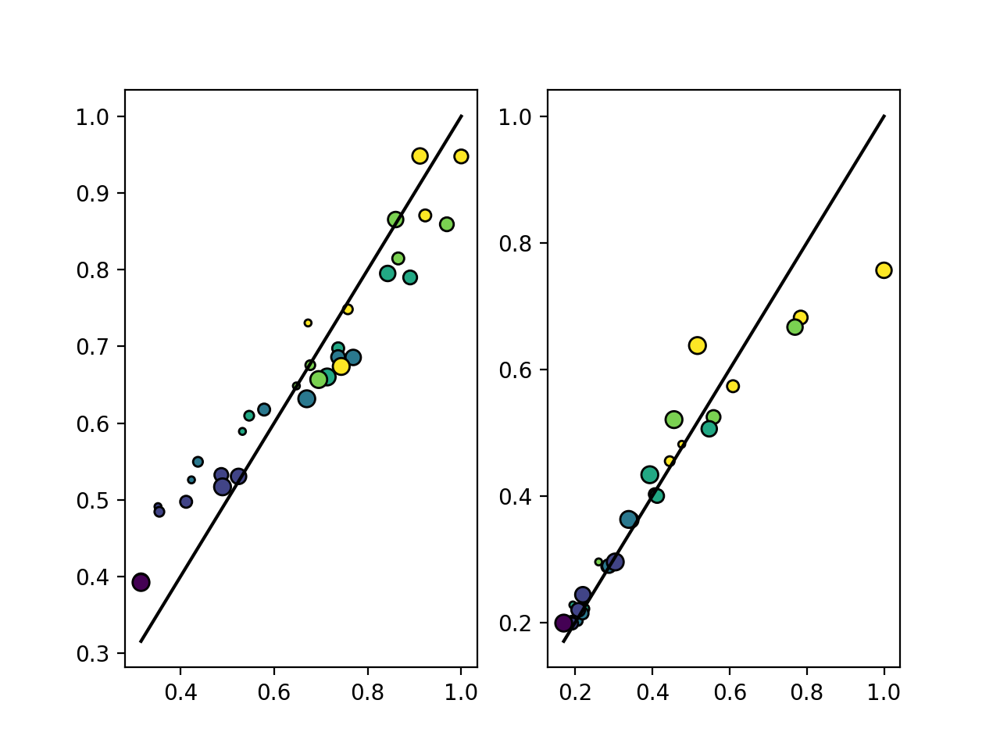

<IPython.core.display.Javascript object>


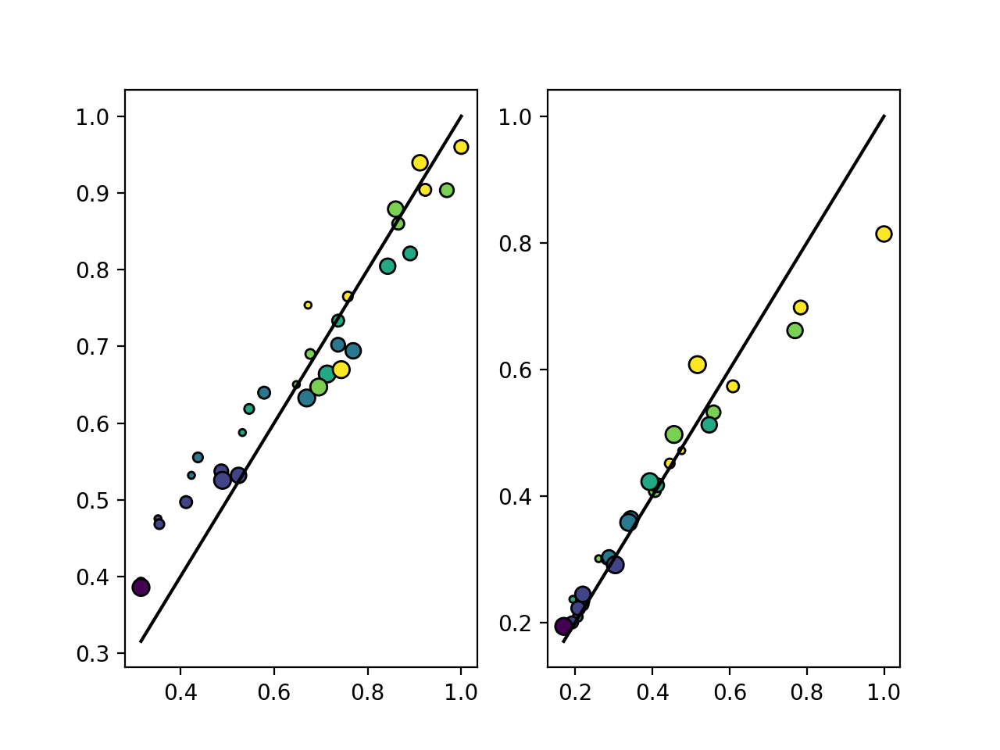

<IPython.core.display.Javascript object>


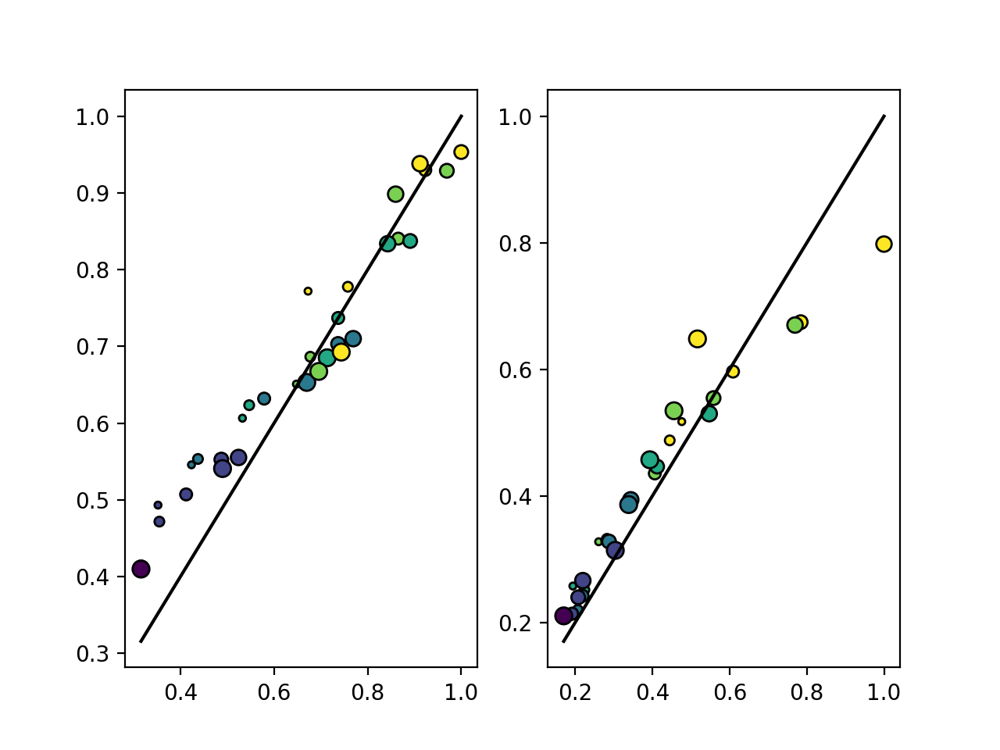

<IPython.core.display.Javascript object>


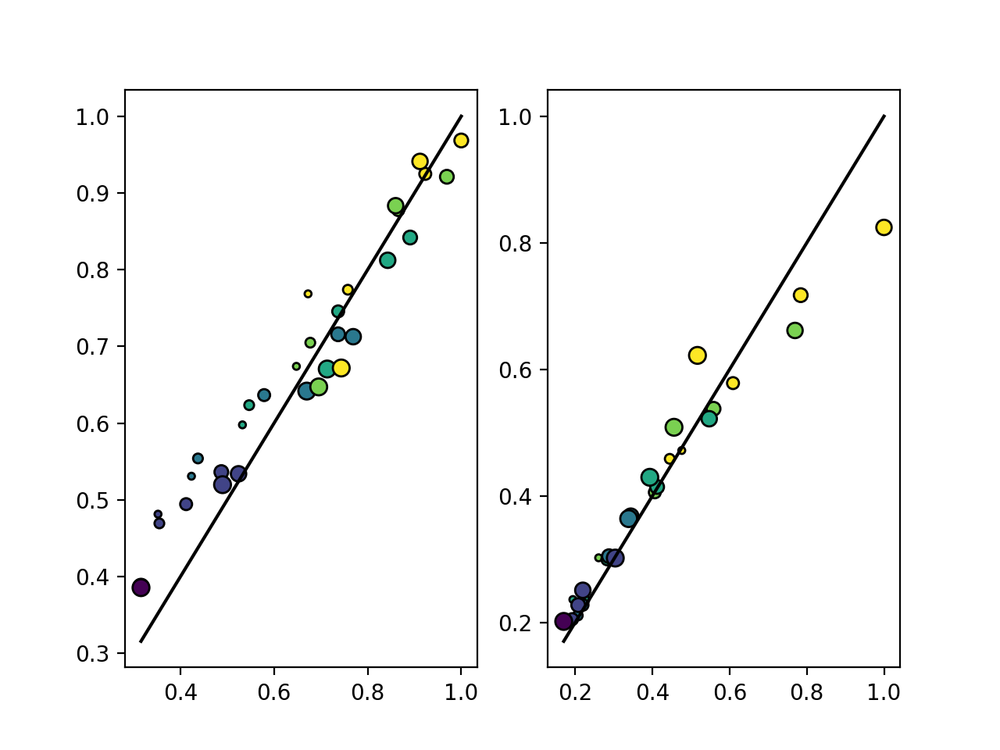

<IPython.core.display.Javascript object>


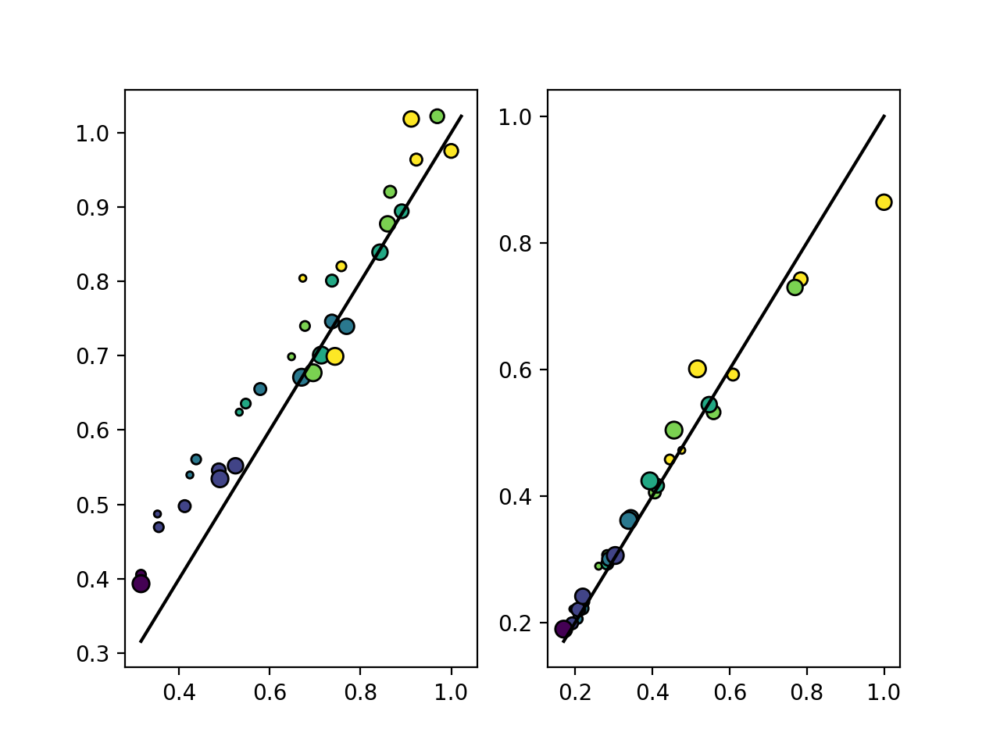

<IPython.core.display.Javascript object>


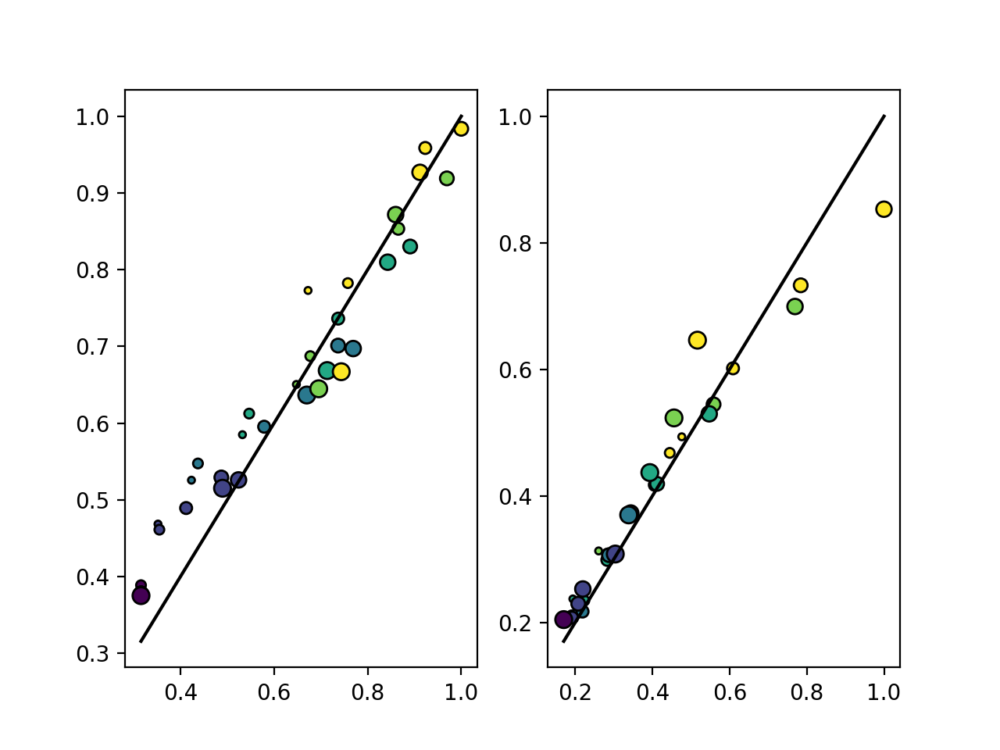

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


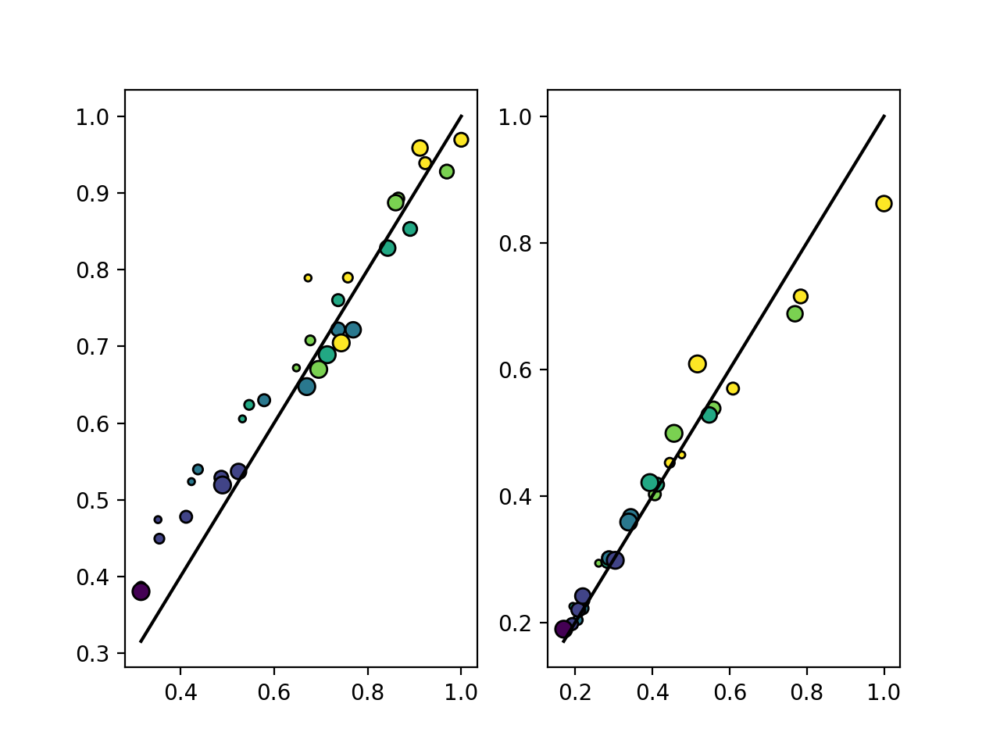

<IPython.core.display.Javascript object>


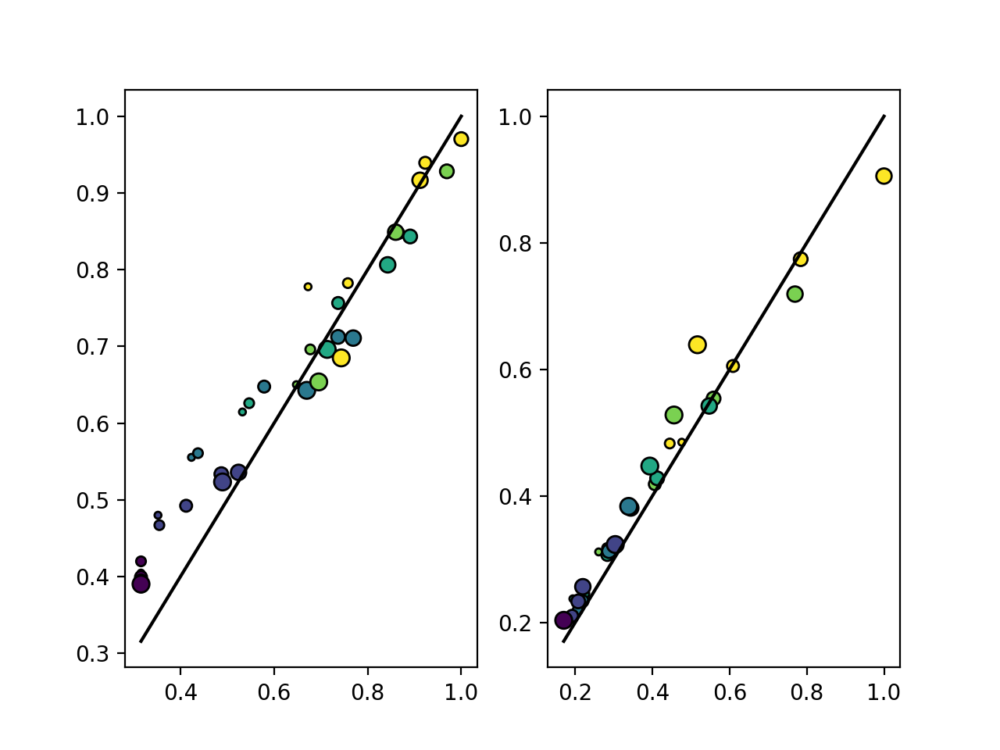

<IPython.core.display.Javascript object>


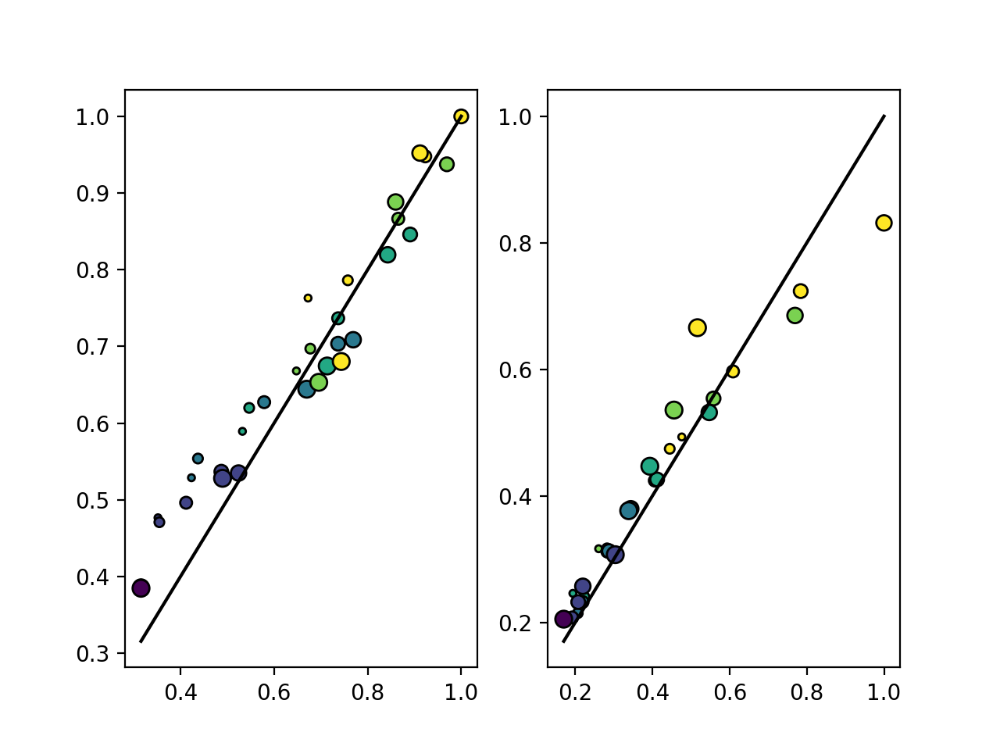

In [48]:
types = [0,1]
ccs = np.zeros((nfiles,nQ*nS*nT))
for iwt in range(nfiles):
    if lkat[iwt]:
        plt.figure()
        for itype,thistype in enumerate(np.arange(2)):#nQ*nS*nT)):
            plt.subplot(1,2,itype+1)
            xdata = YYhat[:,thistype].reshape((6,6))
            ydata = YYs[iwt,:,:,thistype]

            sca.scatter_size_contrast(xdata,ydata)
            ccs[iwt,itype] = var_explained(xdata,ydata)

<IPython.core.display.Javascript object>


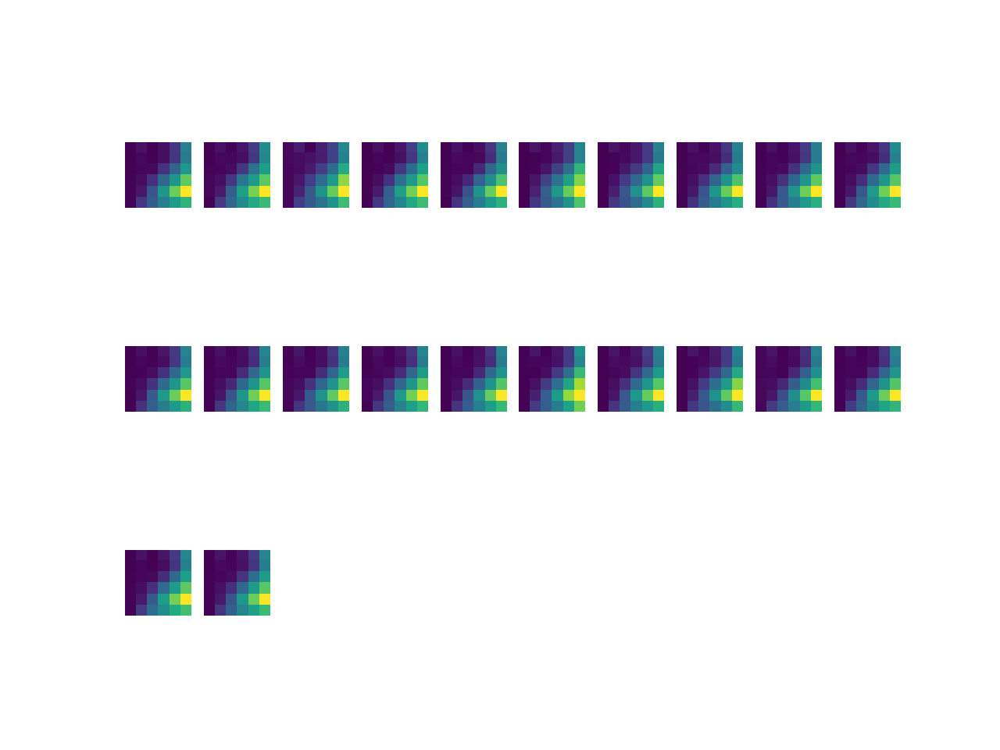

In [60]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,1])
    plt.axis('off')

<IPython.core.display.Javascript object>


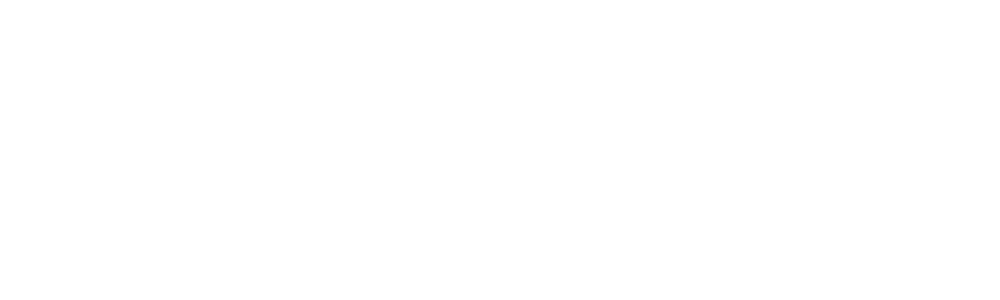

ValueError: num must be 1 <= num <= 30, not 31

In [176]:
plt.figure(figsize=(10,3))
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    sca.scatter_size_contrast(YYs[iwt,:,:,0],YYs[iwt,:,:,1])
    plt.axis('off')

<IPython.core.display.Javascript object>


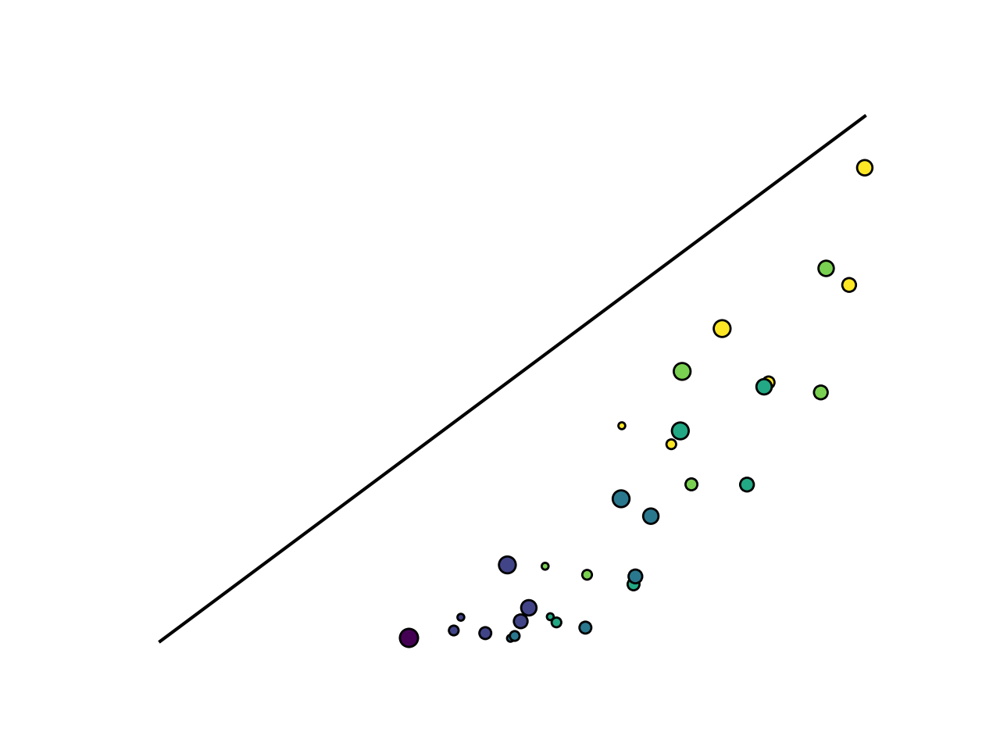

(0.14007571213636724,
 0.7795237759030426,
 0.14007571213636724,
 0.7795237759030426)

In [62]:
iwt = 13
plt.figure()#figsize=(10,3))
sca.scatter_size_contrast(YYs[iwt,:,:,0],YYs[iwt,:,:,1],equate_0=True)
plt.axis('off')

<IPython.core.display.Javascript object>


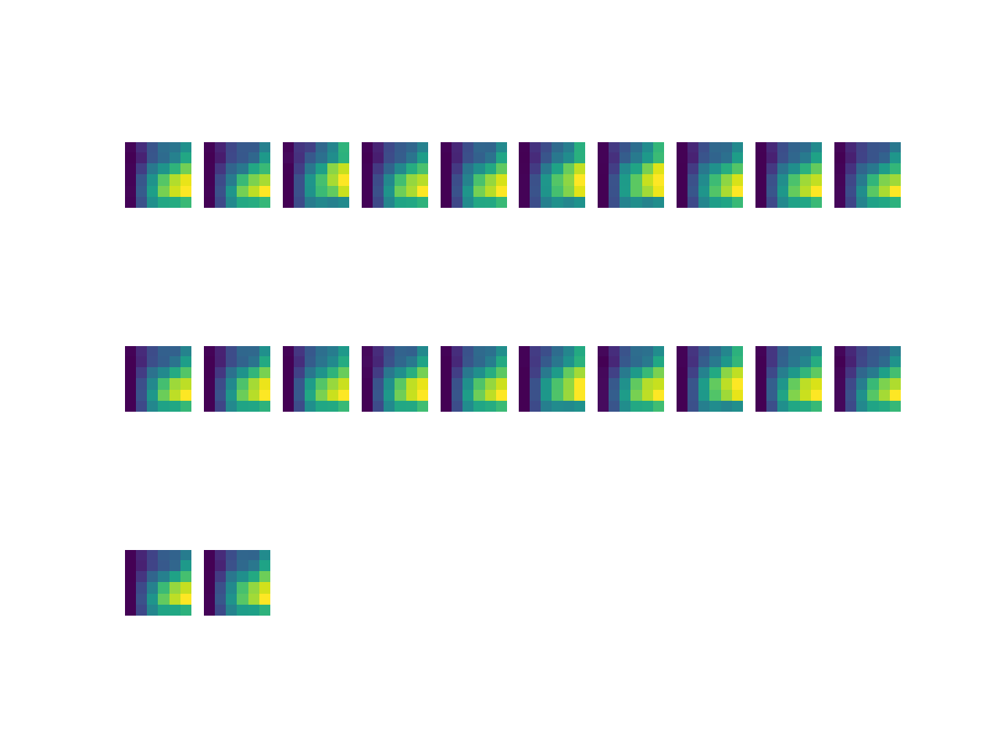

In [63]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,0])
    plt.axis('off')

<IPython.core.display.Javascript object>


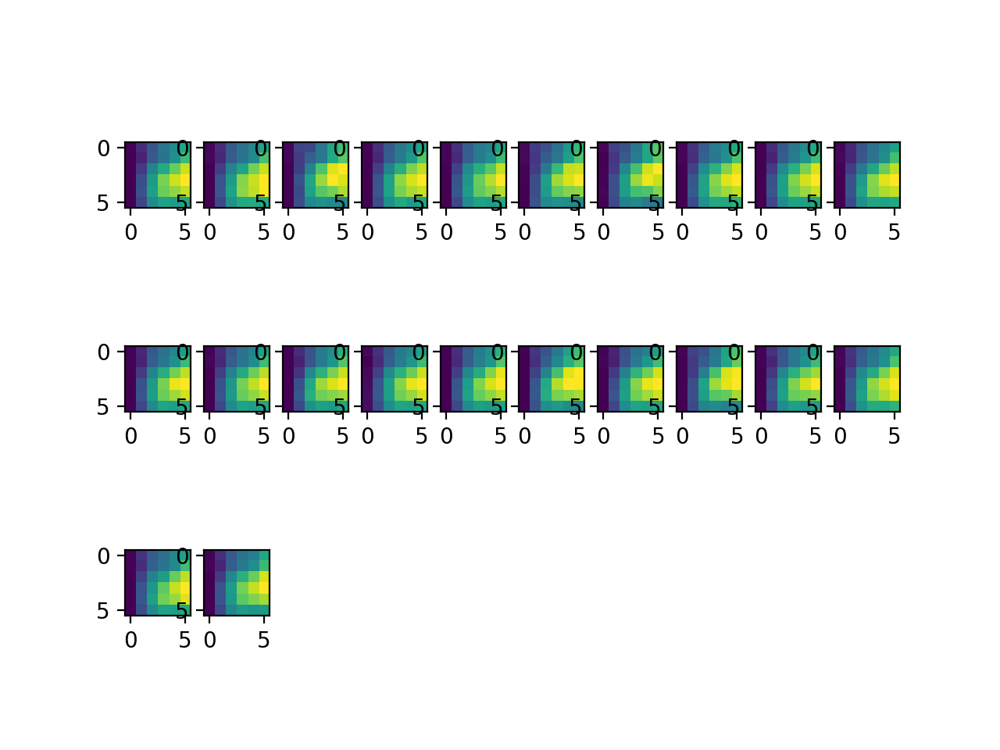

In [64]:
plt.figure()
for iwt in range(nfiles):
    plt.subplot(3,10,iwt+1)
    plt.imshow(YYs[iwt,:,:,3])

In [33]:
nfiles = len(weights_files)
Ts = np.zeros((nfiles,nQ))
Ks = np.zeros((nfiles,nQ))
Wmys = np.zeros((nfiles,nQ,nQ))
Wmxs = np.zeros((nfiles,nP,nQ))
couplings_appr = np.zeros((nfiles,6,6,nQ*nS*nT,nQ*nS*nT))
Xcouplings_appr = np.zeros((nfiles,6,6,nP*nS*nT,nQ*nS*nT))
for iwt,weights_file in enumerate(weights_files):
    Wstar_dict = np.load(weights_file,allow_pickle=True)[()]
    Wmx,Wmy,Wsx,Wsy,s02,K,kappa,T,XX,XXp,Eta,Xi,h1,h2,bl,amp = read_list(Wstar_dict)
    Wmys[iwt] = Wmy
    Wmxs[iwt] = Wmx
    WWmy = calnet.utils.gen_Weight_k_kappa_t(Wmy,K,kappa,T,nS=2,nT=1)
    WWmx = calnet.utils.gen_Weight_k_kappa_t(Wmx,K,kappa,T,nS=2,nT=1)
    tiled_s02 = np.tile(s02,nS*nT)
    for istim in range(nN):
        iistim,jjstim = np.unravel_index(istim,(6,6))
        Phi = np.diag(calnet.utils.fprime_miller_troyer(Eta[istim],Xi[istim]**2+tiled_s02))
        Weff = WWmy @ Phi
        powers = [np.linalg.matrix_power(Weff,n) for n in range(3)]
        appr = sum(powers)
        couplings_appr[iwt,iistim,jjstim] = Phi @ appr
        Xcouplings_appr[iwt,iistim,jjstim] = WWmx @ Phi @ appr
# couplings = np.reshape(couplings,(couplings.shape[0],6,6,couplings.shape[2],couplings.shape[3]))
# Xcouplings = np.reshape(Xcouplings,(Xcouplings.shape[0],6,6,Xcouplings.shape[2],Xcouplings.shape[3]))


<IPython.core.display.Javascript object>


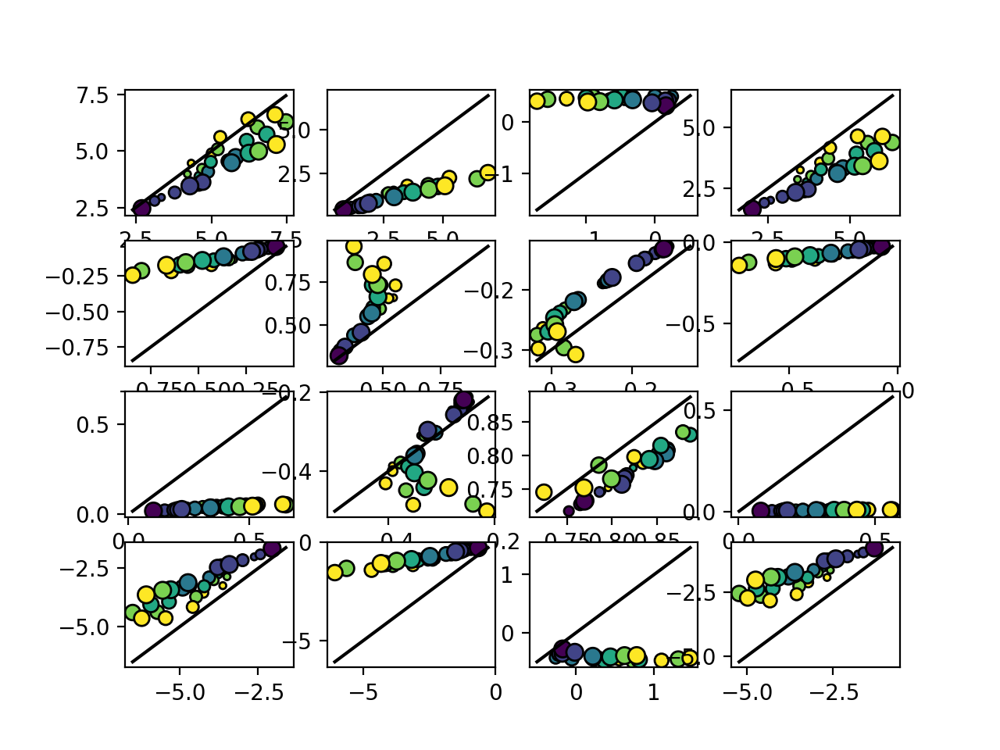

In [66]:
plt.figure()
for i1 in range(nQ):
    for i2 in range(nQ):
        plt.subplot(nQ,nQ,i1*nQ+i2+1)
        sca.scatter_size_contrast(couplings[0,:,:,i1,i2],couplings_appr[0,:,:,i1,i2])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


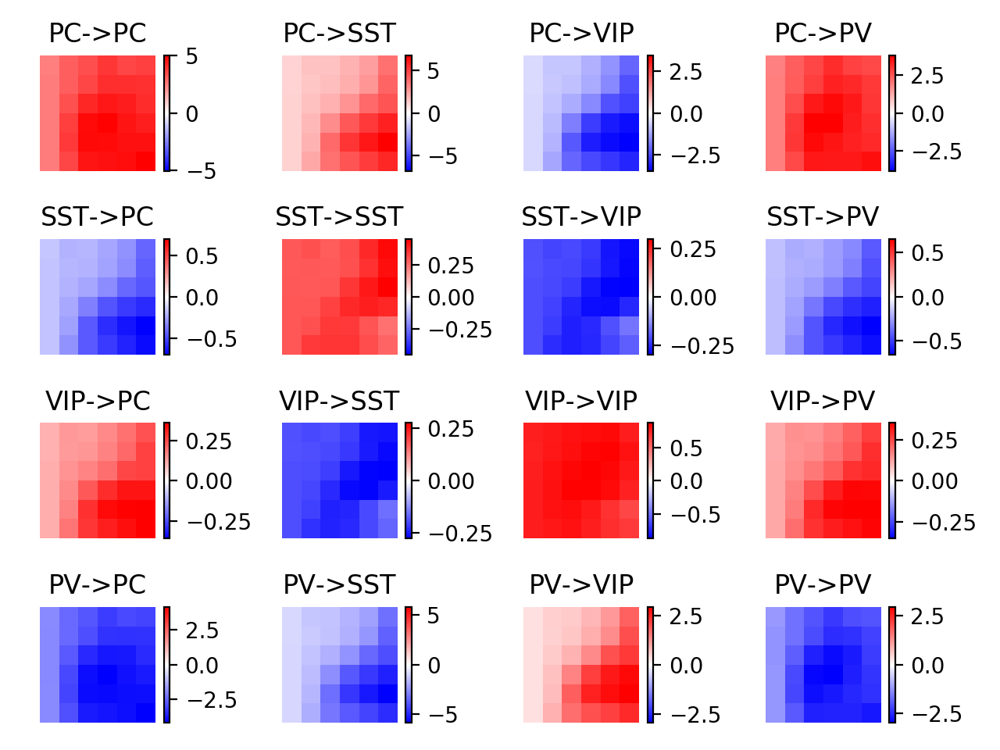

<IPython.core.display.Javascript object>


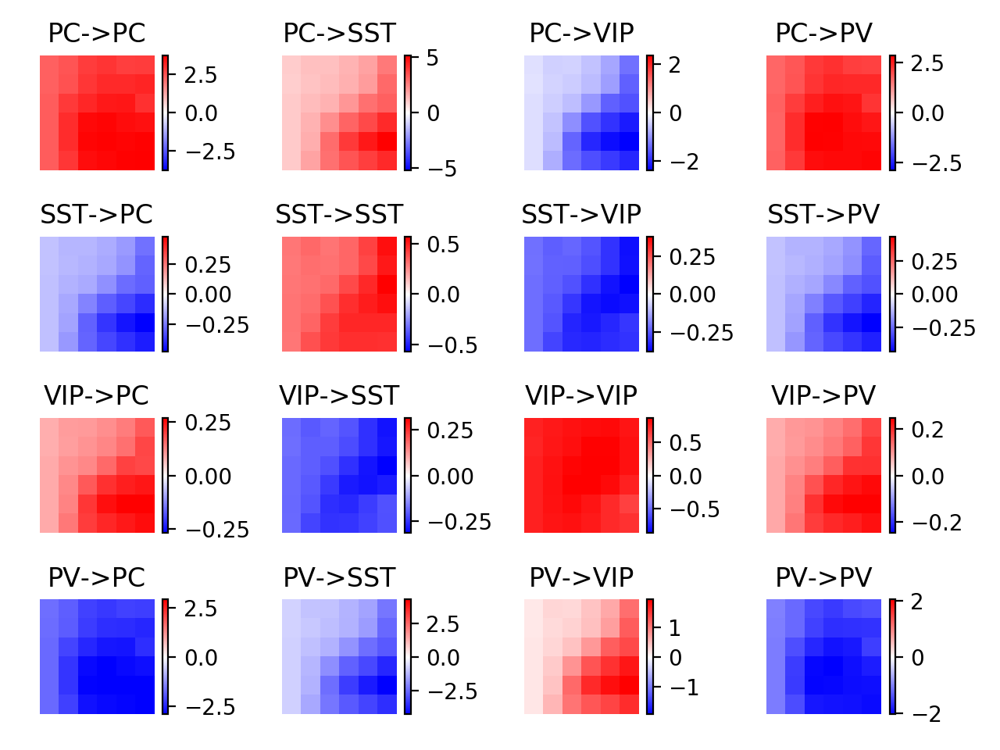

<IPython.core.display.Javascript object>


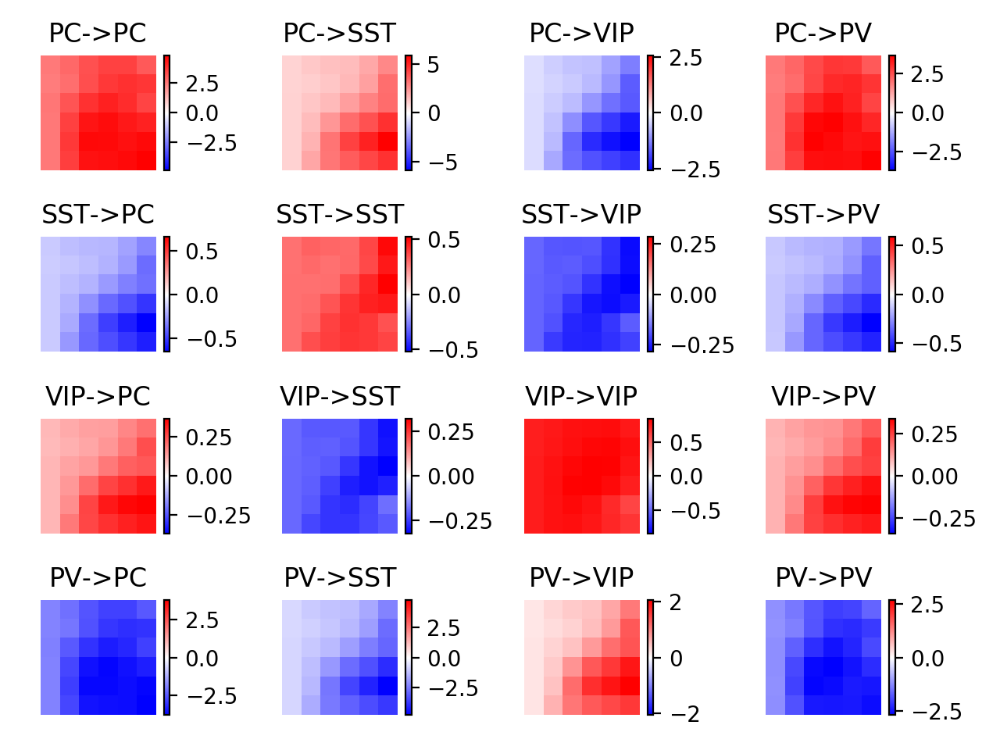

<IPython.core.display.Javascript object>


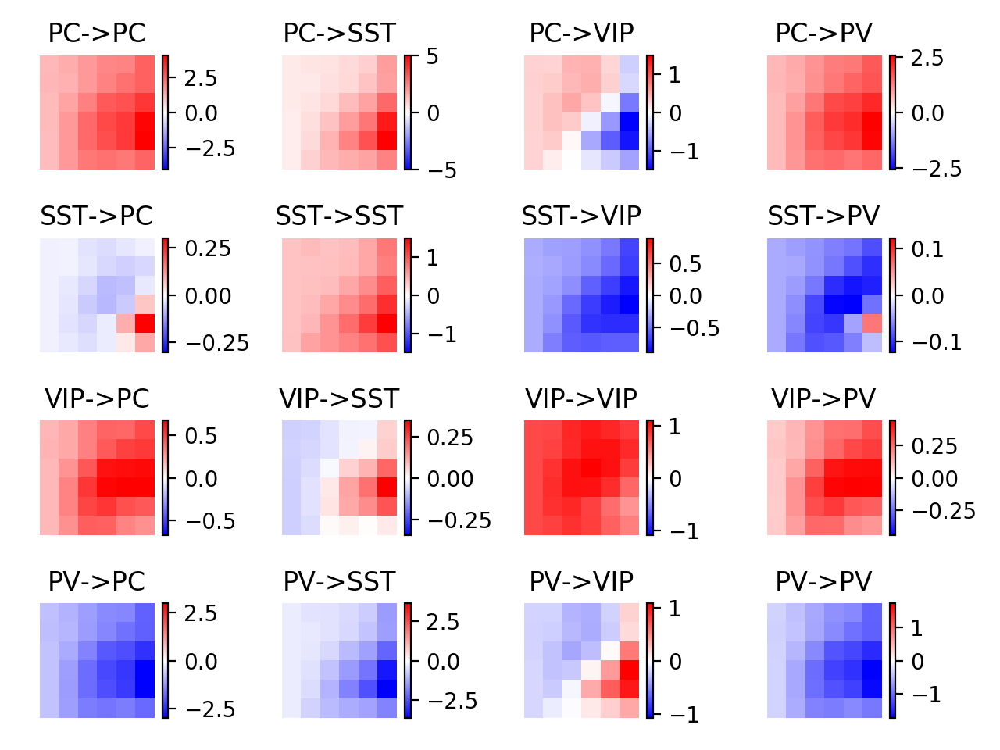

<IPython.core.display.Javascript object>


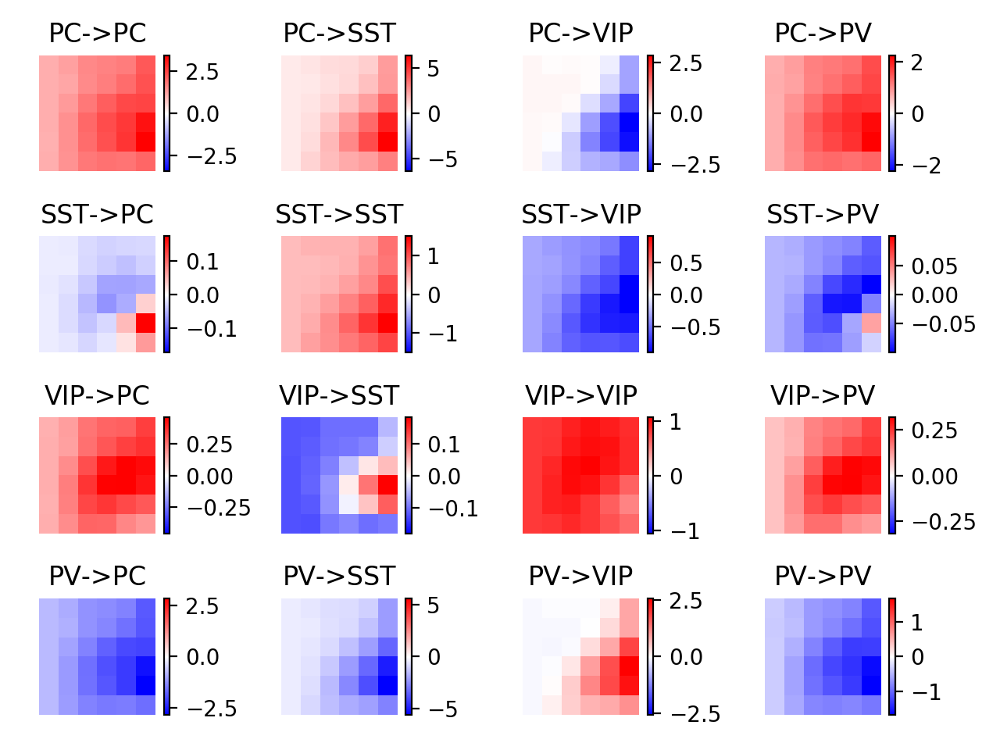

<IPython.core.display.Javascript object>


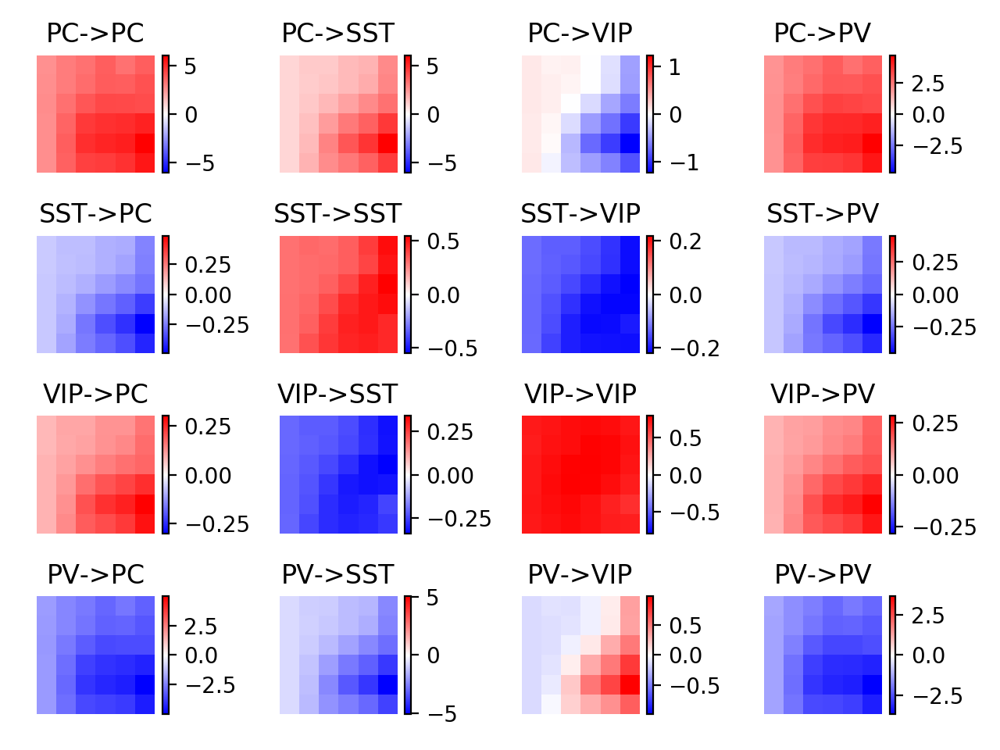

<IPython.core.display.Javascript object>


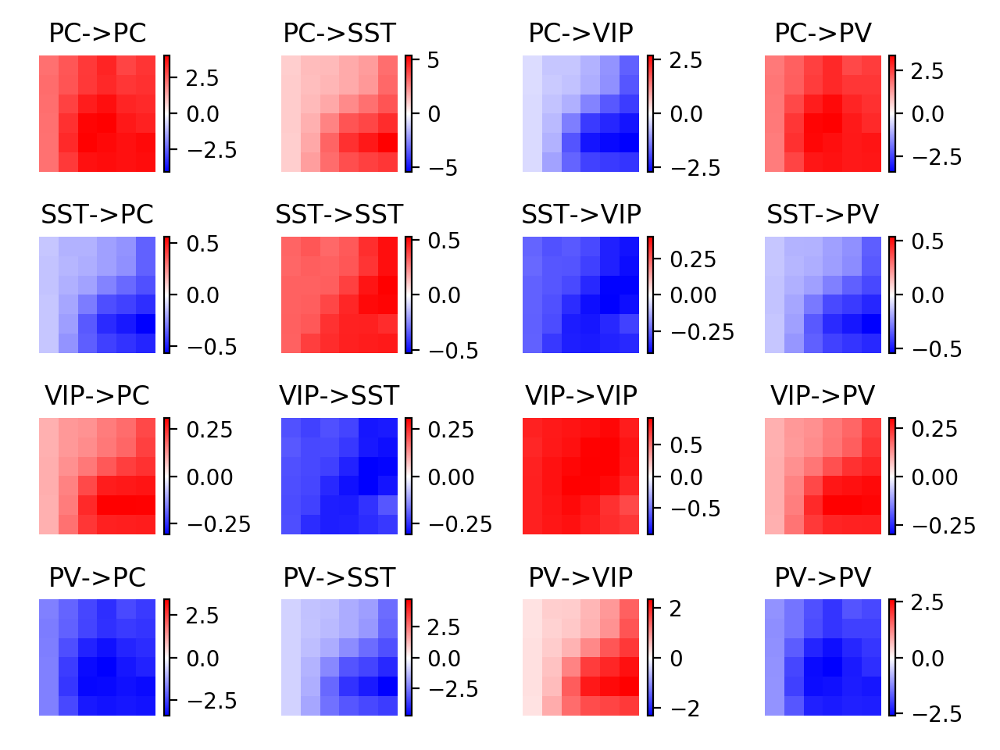

<IPython.core.display.Javascript object>


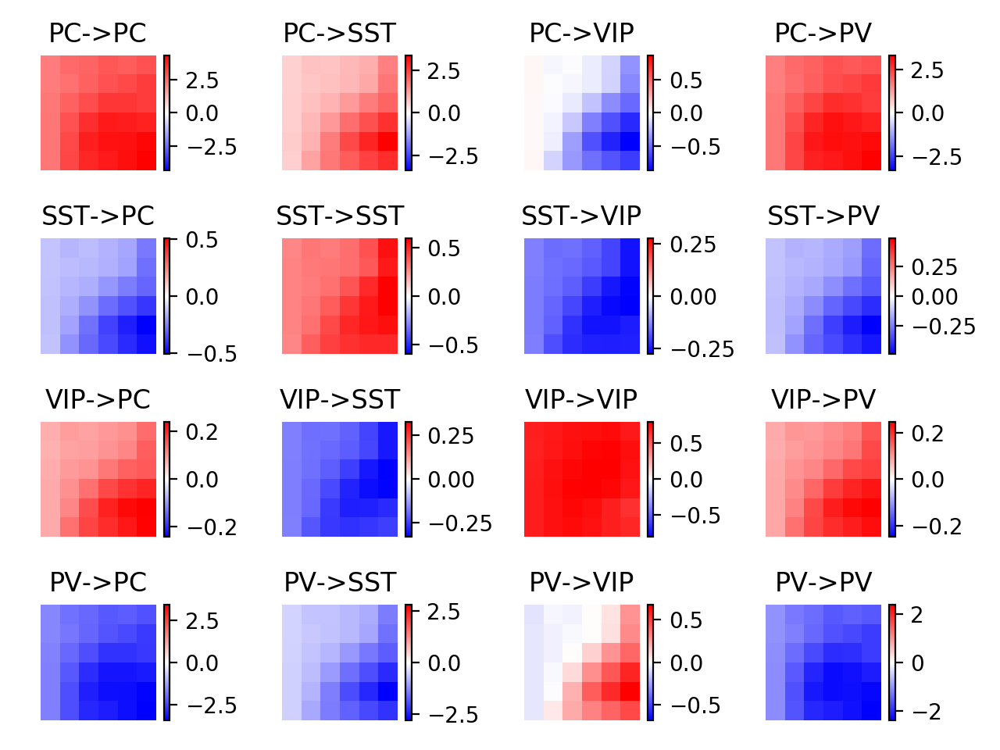

<IPython.core.display.Javascript object>


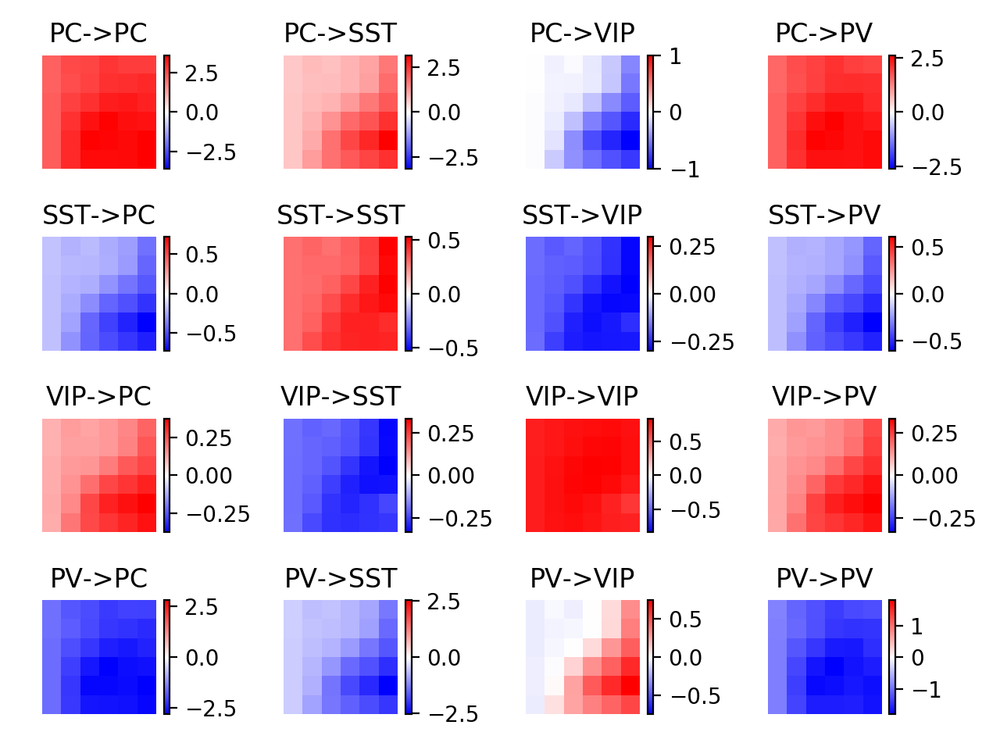

In [46]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

In [47]:
lkat

array([False, False, False, False, False, False, False, False, False])

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


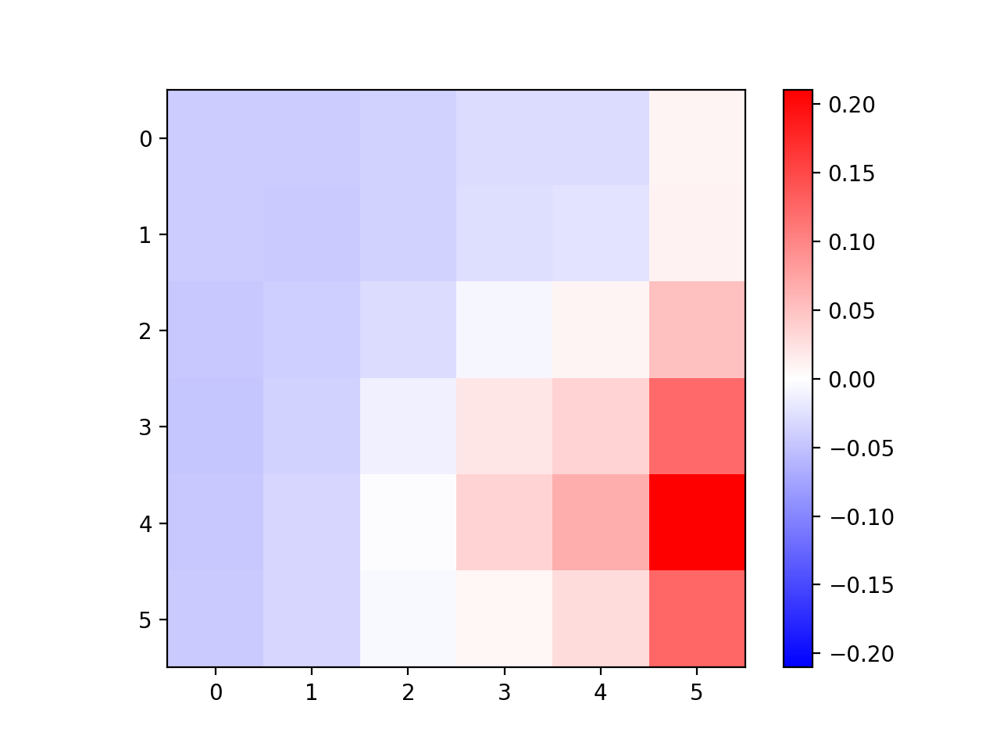

In [640]:
plt.figure()
data = np.nanmean(couplings[:,:,:,2,1],0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.colorbar()

In [1449]:
# lkat = np.all(np.all(couplings[:,:,:,1,0]<0,axis=1),axis=1) #& np.all(np.all(couplings[:,:,:,2,1]<0,axis=1),axis=1)
# lkat = lkat & (np.max(np.abs(couplings.reshape((couplings.shape[0],-1))),axis=1) < 10) & np.all(np.all(couplings[:,:,:,1,0]<0,axis=1),axis=1)
# lkat = losses < 1000

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: invalid value encountered in less
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


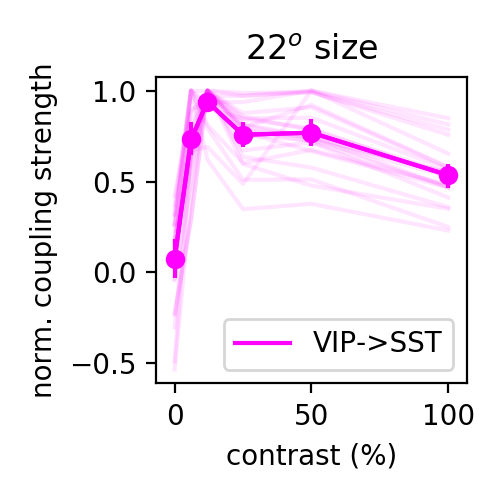

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.8932140705325619


In [1592]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[lkat,isize,:,2,1]]
colors = [np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['VIP->SST'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.1,c=color) #
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/vip_sst_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


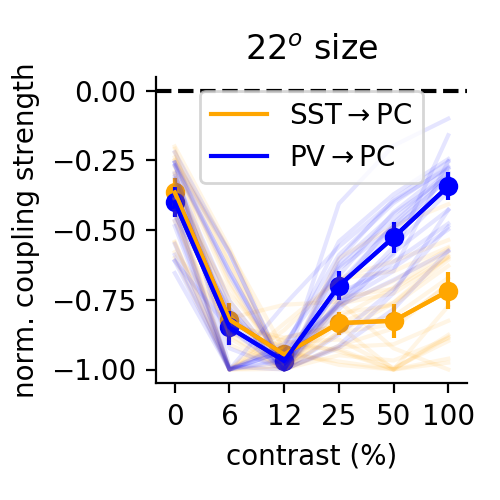

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.4155940982732391
-0.3939546681830697


In [1593]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,3,0]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'PV$\rightarrow$PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


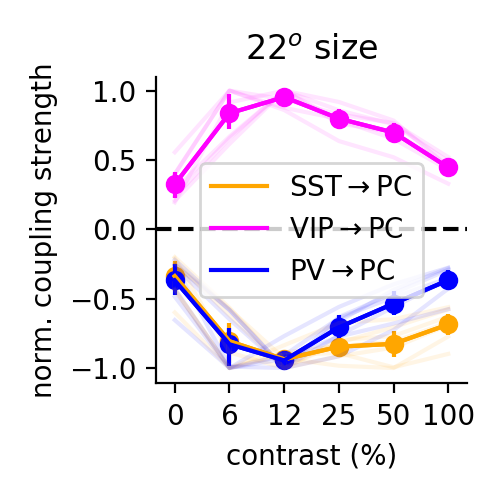

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.45074017952261153
0.907018406339655
-0.43914087960323683


In [1570]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,2,0],couplings[lkat,isize,:,3,0]]#,phis[:,isize,:,0]]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1))]#,np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'VIP$\rightarrow$PC',r'PV$\rightarrow$PC'])#,'$\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
ut.erase_top_right()
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


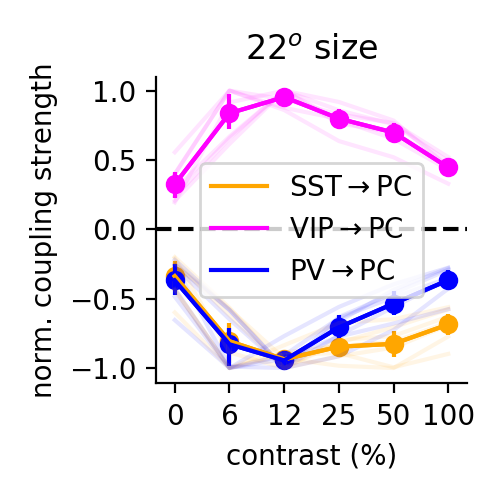

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.45074017952261153
0.907018406339655
-0.43914087960323683


In [1571]:
plt.figure(figsize=(2.5,2.5))
isize = 3
# i,j = 1,0
# polysyn = phis[:,isize,:,i]*Wmys[:,np.newaxis,i,j]*phis[:,isize,:,j]
i,j,k = 2,1,0
x = np.arange(6)
polysyn = phis[:,isize,:,i]*Wmys[:,np.newaxis,i,j]*phis[:,isize,:,j]*Wmys[:,np.newaxis,j,k]*phis[:,isize,:,k]
datas = [couplings[lkat,isize,:,1,0],couplings[lkat,isize,:,2,0],couplings[lkat,isize,:,3,0]]#,phis[:,isize,:,0],polysyn]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1)),np.array((0,0,0)),np.array((0,1,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'SST$\rightarrow$PC',r'VIP$\rightarrow$PC',r'PV$\rightarrow$PC'])#,'$\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
ut.erase_top_right()
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


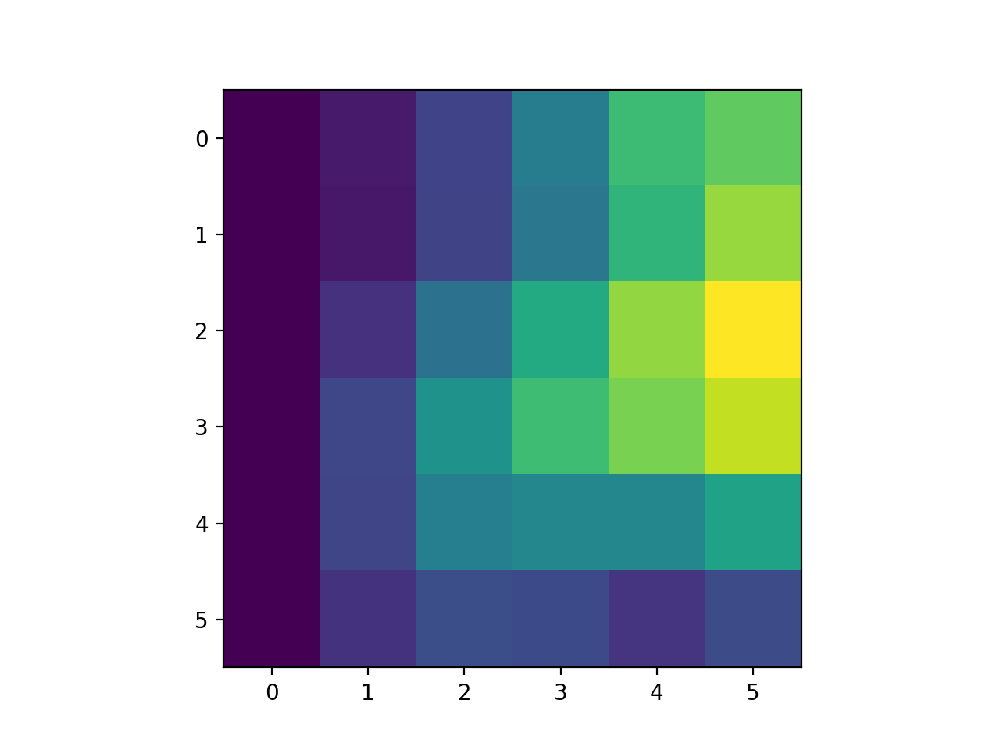

In [150]:
plt.figure()
plt.imshow(YYhat[:,0].reshape((6,6)))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


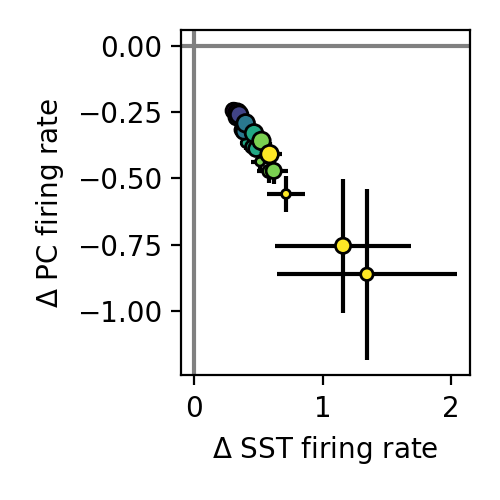

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:18: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


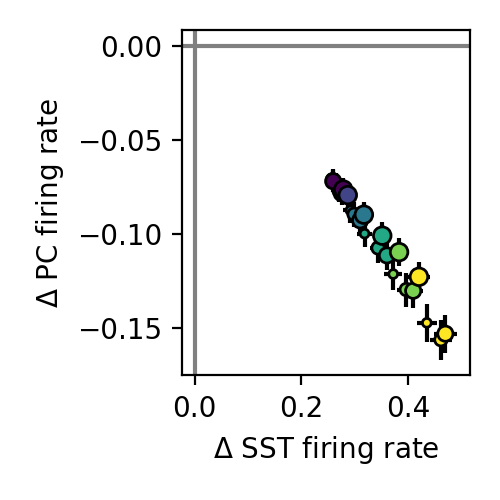

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:28: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


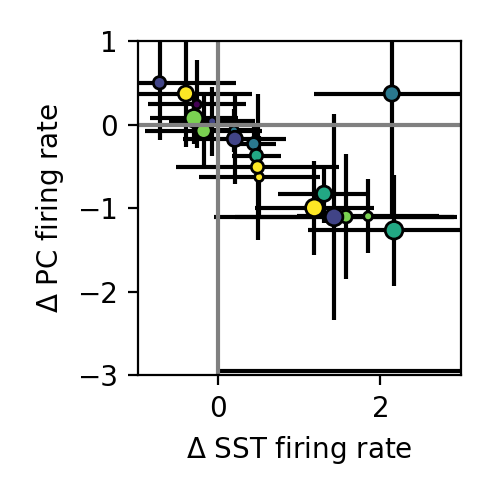

In [755]:
h = -1
sizes = [0,2,3,5]

plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings[lkat,:,:,2,1]
ydata = h*couplings[lkat,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

polysyn_vip_sst = h*phis[lkat,:,:,2]*phis[lkat,:,:,1]*Wmys[lkat,np.newaxis,np.newaxis,2,1]
polysyn_vip_pc = h*phis[lkat,:,:,2]*phis[lkat,:,:,1]*phis[lkat,:,:,0]*Wmys[lkat,np.newaxis,np.newaxis,2,1]*Wmys[lkat,np.newaxis,np.newaxis,1,0]
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
sca.scatter_size_contrast_errorbar(polysyn_vip_sst[:,sizes],polysyn_vip_pc[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_feedforward.eps')

plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
xdata = h*couplings_no_wpcsst[lkat,:,:,2,1]
ydata = h*couplings_no_wpcsst[lkat,:,:,2,0]
sca.scatter_size_contrast_errorbar(xdata[:,sizes],ydata[:,sizes],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ SST firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.ylim(-3,1)
plt.xlim(-1,3)
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


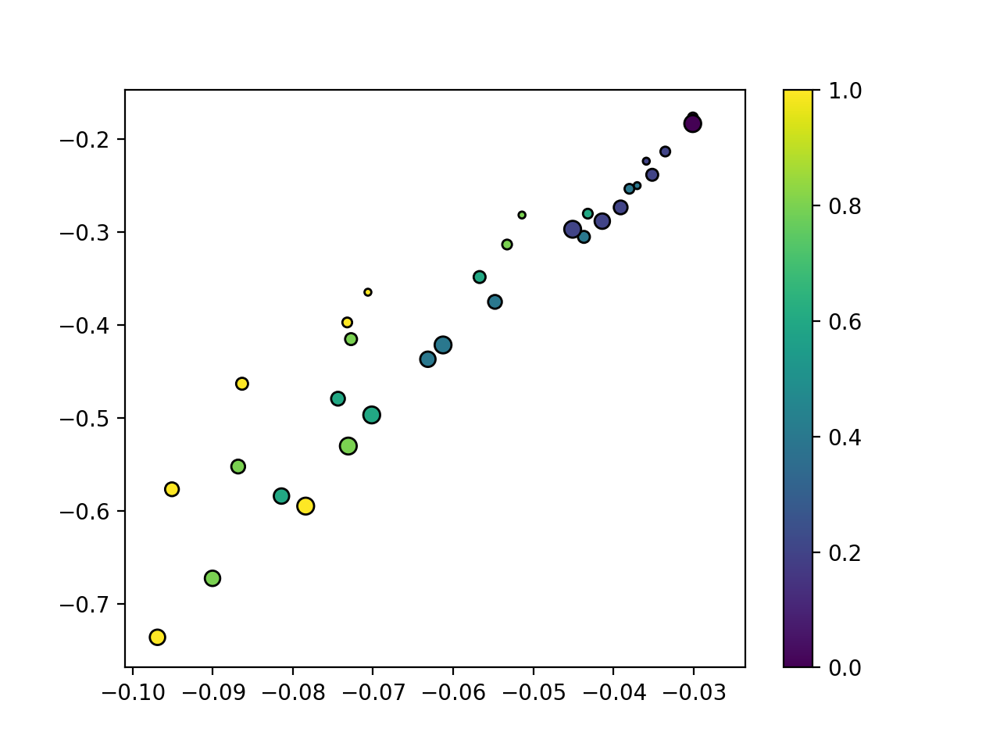

In [294]:
plt.figure()
sca.scatter_size_contrast(np.nanmean(polysyn_vip_pc,0),np.nanmean(h*couplings[:,:,:,2,0],0),square=False,equality_line=False)
plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


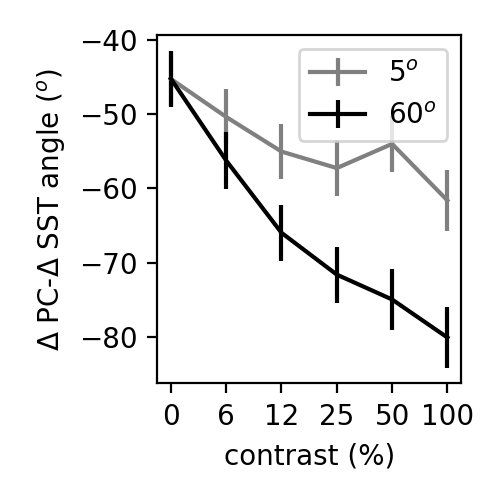

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:30: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


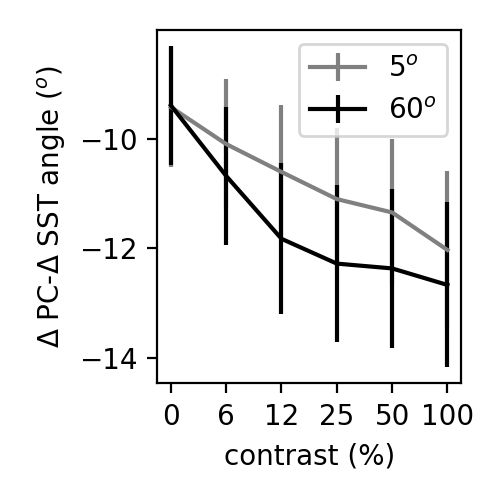

In [295]:
h = -1
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
data = np.arctan2(h*couplings[:,:,:,2,0],h*couplings[:,:,:,2,1])#,equality_line=False,square=False)

plt.figure(figsize=(2.5,2.5))
thisx = np.arange(6)
# colors_blk = [0.5**(i+1)*np.array((1,1,1)) for i in range(4)]
colors_blk = [np.array((0.5,0.5,0.5)),np.array((0.,0.,0.))]
for iisize,isize in enumerate([0,5]):
    this_data = data[:,isize]
    plt.errorbar(thisx,-360+180/np.pi*sst.circmean(this_data,axis=0),180/np.pi*sst.circstd(this_data,axis=0)/np.sqrt(data.shape[0]),c=colors_blk[iisize])
    plt.xlabel('contrast (%)')
plt.xticks(thisx,ucontrast)
# plt.ylim(-80,0)
#     plt.ylim(-90,45)
# plt.subplot(1,4,1)
plt.legend(['5$^o$','60$^o$'])
plt.ylabel('$\Delta$ PC-$\Delta$ SST angle ($^o$)')
plt.tight_layout()
# plt.savefig('figures/sim_drpc_drsst_angle_recurrent.eps')


h = -1

polysyn_vip_sst = h*phis[:,:,:,2]*phis[:,:,:,1]*Wmys[:,np.newaxis,np.newaxis,2,1]
polysyn_vip_pc = h*phis[:,:,:,2]*phis[:,:,:,1]*phis[:,:,:,0]*Wmys[:,np.newaxis,np.newaxis,2,1]*Wmys[:,np.newaxis,np.newaxis,1,0]
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
data = np.arctan2(polysyn_vip_pc,polysyn_vip_sst)

plt.figure(figsize=(2.5,2.5))
thisx = np.arange(6)
# colors_blk = [0.5**(i+1)*np.array((1,1,1)) for i in range(4)]
colors_blk = [np.array((0.5,0.5,0.5)),np.array((0.,0.,0.))]
for iisize,isize in enumerate([0,5]):
    this_data = data[:,isize]
    plt.errorbar(thisx,-360+180/np.pi*sst.circmean(this_data,axis=0),180/np.pi*sst.circstd(this_data,axis=0)/np.sqrt(data.shape[0]),c=colors_blk[iisize])
    plt.xlabel('contrast (%)')
plt.xticks(thisx,ucontrast)
# plt.ylim(-80,0)
# plt.subplot(1,4,1)
plt.legend(['5$^o$','60$^o$'])
plt.ylabel('$\Delta$ PC-$\Delta$ SST angle ($^o$)')
plt.tight_layout()
# plt.savefig('figures/sim_drpc_drsst_angle_feedforward.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


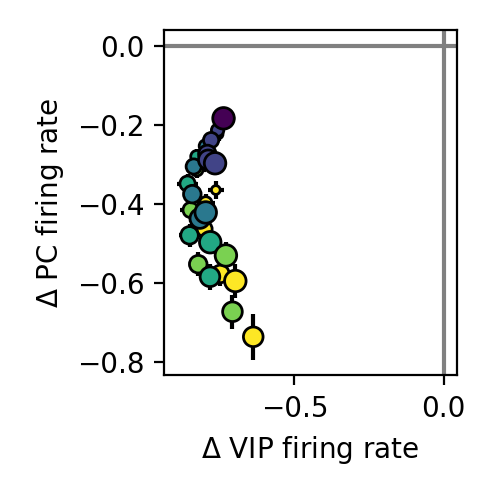

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:15: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  from ipykernel import kernelapp as app


<IPython.core.display.Javascript object>


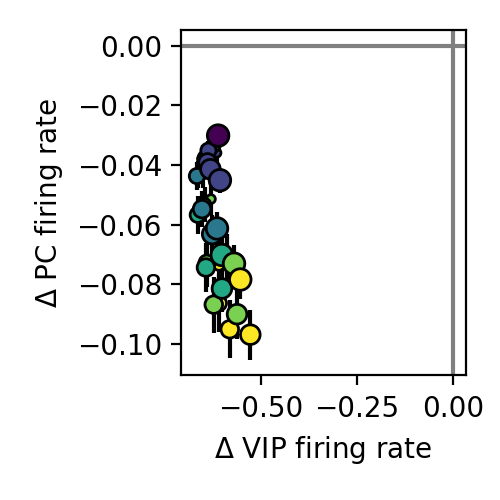

In [296]:
iwt = 0
h = -1
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(h*np.nanmean(couplings[:,:,:,2,1],0),h*np.nanmean(couplings[:,:,:,2,0],0))
sca.scatter_size_contrast_errorbar(h*couplings[:,:,:,2,2],h*couplings[:,:,:,2,0],equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ VIP firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_recurrent.eps')

polysyn_vip = h*phis[:,:,:,2]
polysyn_vip_pc = h*phis[:,:,:,2]*phis[:,:,:,1]*phis[:,:,:,0]*Wmys[:,np.newaxis,np.newaxis,2,1]*Wmys[:,np.newaxis,np.newaxis,1,0]
plt.figure(figsize=(2.5,2.5))
# sca.scatter_size_contrast(np.nanmean(polysyn_vip_sst,0),np.nanmean(polysyn_vip_pc,0))
sca.scatter_size_contrast_errorbar(polysyn_vip,polysyn_vip_pc,equality_line=False,square=False)
plt.axhline(0,c=(0.5,0.5,0.5))
plt.axvline(0,c=(0.5,0.5,0.5))
plt.xlabel(r'$\Delta$ VIP firing rate')
plt.ylabel(r'$\Delta$ PC firing rate')
plt.tight_layout()
# plt.savefig('figures/sim_drsst_drpc_feedforward.eps')


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


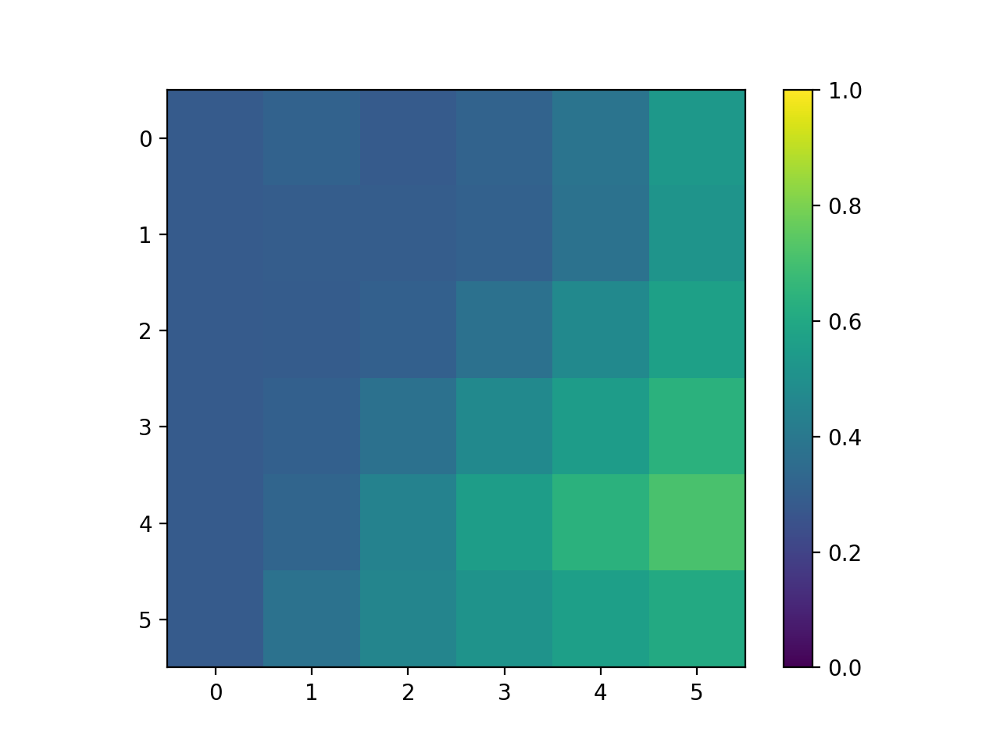

In [297]:
plt.figure()
plt.imshow(np.nanmean(phis[:,:,:,1],0),vmin=0,vmax=1)
plt.colorbar()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


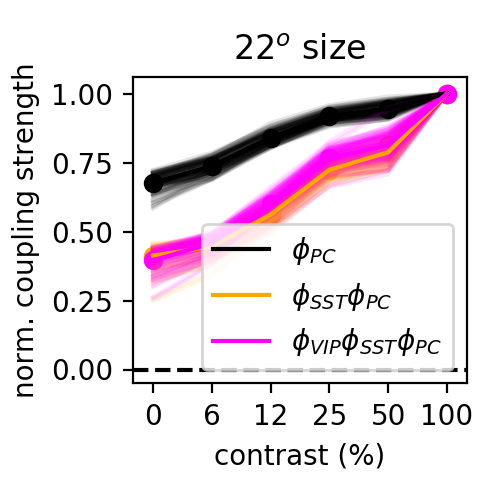

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


1.0
1.0
1.0


In [721]:
plt.figure(figsize=(2.5,2.5))
x = np.arange(6)
isize = 3
i,j = 1,0
polysyn_sst = phis[:,isize,:,i]*phis[:,isize,:,j]
i,j,k = 2,1,0
polysyn_vip = phis[:,isize,:,i]*phis[:,isize,:,j]*phis[:,isize,:,k]
datas = [phis[:,isize,:,0],polysyn_sst,polysyn_vip] #couplings[:,isize,:,1,0]/ #couplings[:,isize,:,2,0]/
colors = [np.array((0,0,0)),np.array((1,0.65,0)),np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['$\phi_{PC}$','$\phi_{SST}\phi_{PC}$','$\phi_{VIP}\phi_{SST}\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

In [739]:
lkat = np.all(np.all(couplings[:,:,:,1,0]<0,axis=1),axis=1) #& np.all(np.all(couplings[:,:,:,2,1]<0,axis=1),axis=1)


In [765]:
np.save('data/lkat.npy',lkat)

<IPython.core.display.Javascript object>


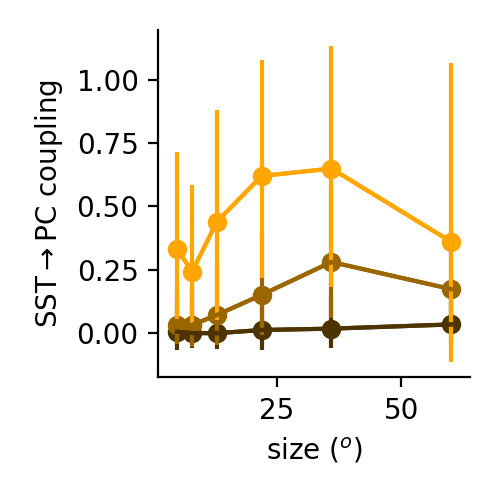

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.16404117143898744


<IPython.core.display.Javascript object>


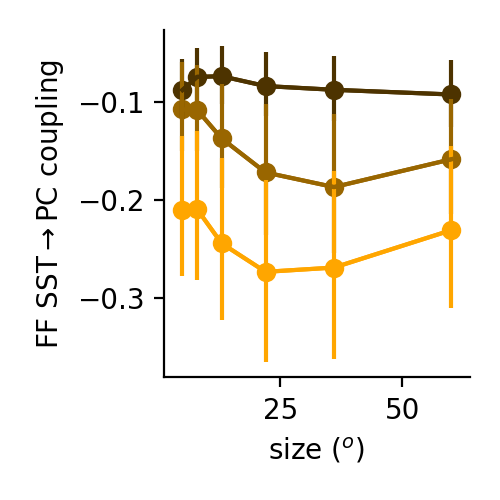

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.10371571375404377


<IPython.core.display.Javascript object>


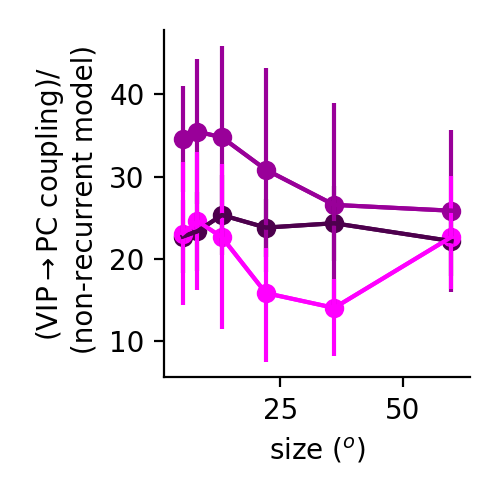

28.166368125145052


'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


In [1509]:
rg = lkat#slice(None)#
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling.eps')

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,polysyn_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'FF SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_phi_W_phi.eps')
i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
# plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

<IPython.core.display.Javascript object>


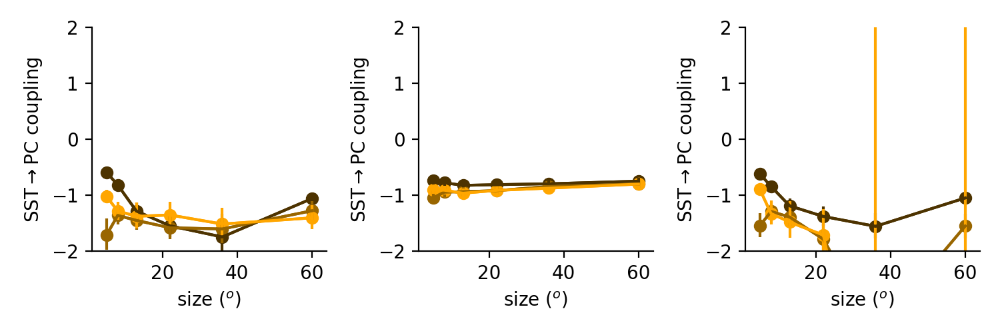

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-0.6355155574805489
-0.8000454994619041
-0.6614711927601414


In [1594]:
rg = slice(None)
i,j = 1,0
ylim = (-2,2)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat #slice(None)
# rg = slice(None)
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_pcpv_sst_phi_constant.eps')

<IPython.core.display.Javascript object>


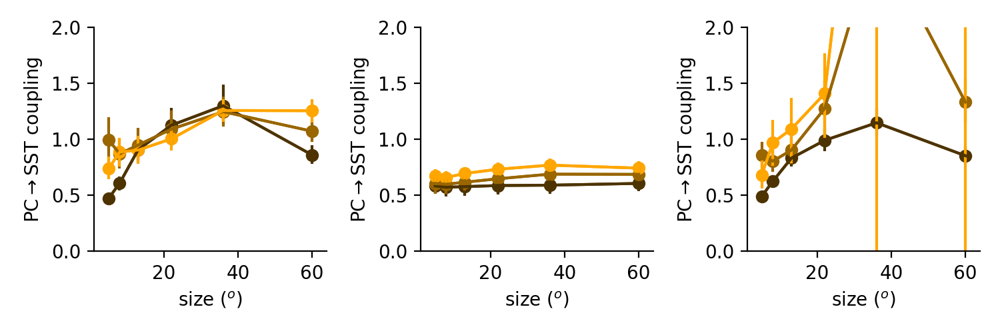

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

1.1555293256745458
0.7094537881081602
2.5579807463717885


In [1595]:
rg = slice(None)
i,j = 0,1
ylim = (0,2)
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat#slice(None)
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.ylim(ylim)

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'PC$\rightarrow$SST coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/pc_sst_coupling_pcpv_sst_phi_constant.eps')


<IPython.core.display.Javascript object>


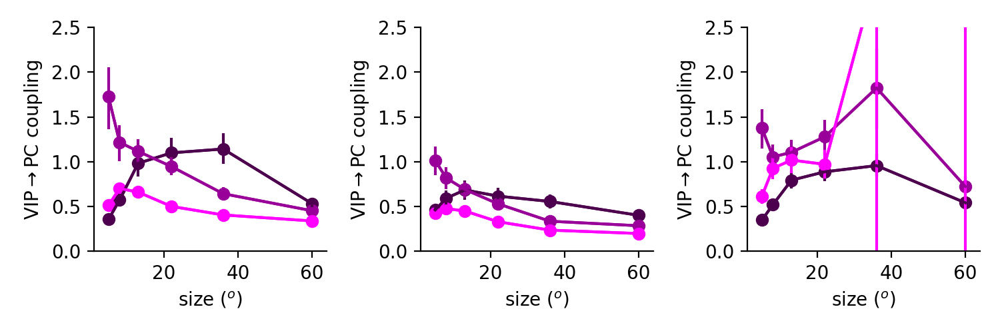

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

1.3966043370099084
0.8572196890852459
1.3822635034393953


In [1604]:
rg = slice(None)
i,j = 2,0
ylim = (0,2.5)
xlabel = 'size ($^o$)'
ylabel = r'VIP$\rightarrow$PC coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat#slice(None)
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_pcpv_sst_phi_constant.eps')

<IPython.core.display.Javascript object>


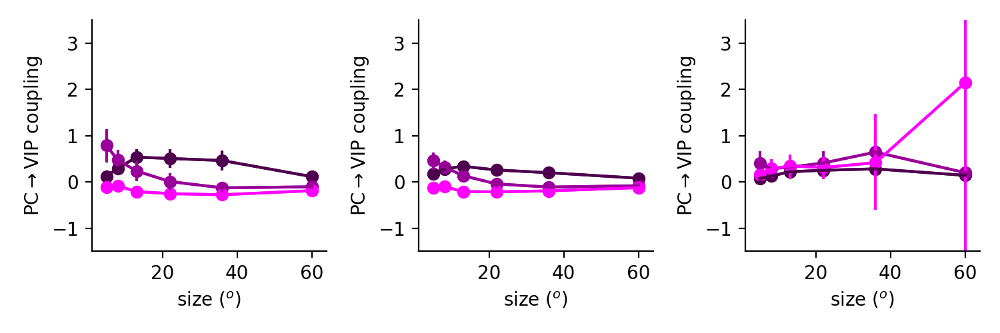

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.43853455217045434
0.28242277229980295
0.22961829470530273


In [1605]:
rg = slice(None)
# lkat = np.all(np.all(couplings[:,:,:,1,0]<0,axis=1),axis=1) #& np.all(np.all(couplings[:,:,:,2,1]<0,axis=1),axis=1)
i,j = 0,2
ylim = (-1.5,3.5)
xlabel = 'size ($^o$)'
ylabel = r'PC$\rightarrow$VIP coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/pc_vip_coupling_pcpv_sst_phi_constant.eps')

<IPython.core.display.Javascript object>


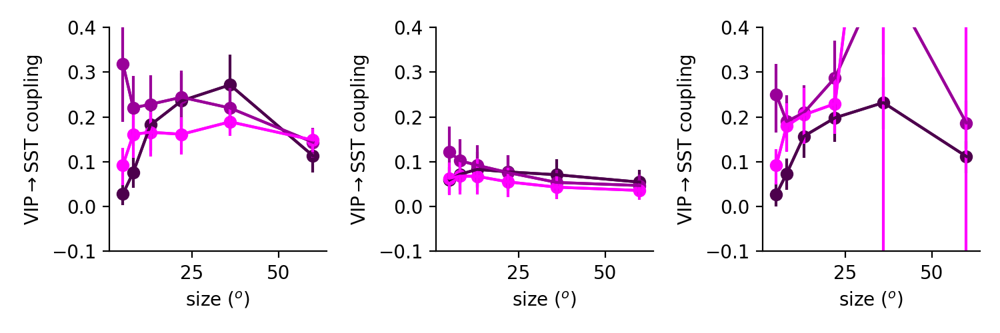

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

0.2145707925379238
0.06403561665871395
0.35730344483297366


In [1607]:
rg = slice(None)
i,j = 2,1
ylim = (-0.1,0.4)
xlabel = 'size ($^o$)'
ylabel = r'VIP$\rightarrow$SST coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat#slice(None)
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/vip_sst_coupling_pcpv_sst_phi_constant.eps')

<IPython.core.display.Javascript object>


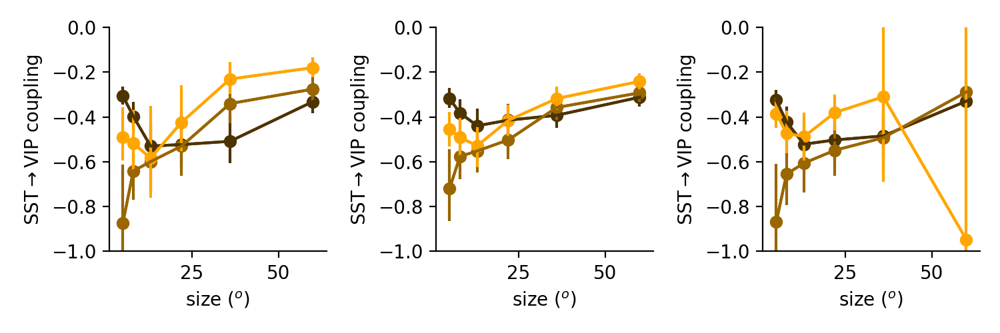

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-0.22546700257794347
-0.277965705786956
-0.34223030799527765


In [1609]:
rg = slice(None)
i,j = 1,2
ylim = (-1,0)
xlabel = 'size ($^o$)'
ylabel = r'SST$\rightarrow$VIP coupling'
# lkat = couplings_fixed[:,isize,:,8,0,1].max(1) < couplings_fixed[:,isize,:,8,0,1].max()
rg = lkat#slice(None)
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/sst_vip_coupling_pcpv_sst_phi_constant.eps')

In [748]:
lkat.mean()

0.990909090909091

<IPython.core.display.Javascript object>


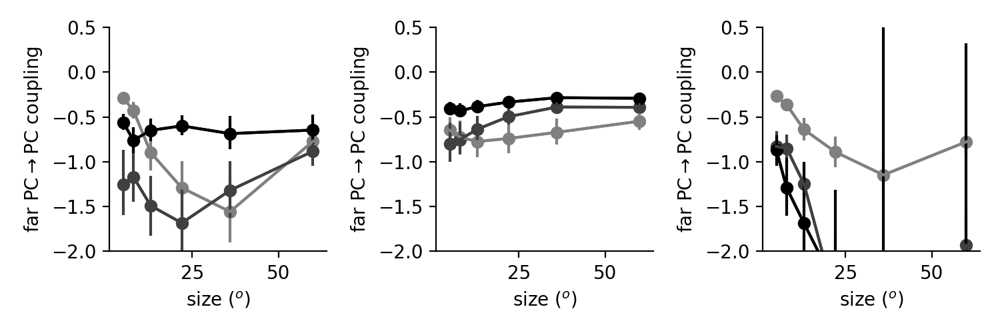

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-0.3412519021709493
-0.34929918159189355
-0.31578117598311045


In [1610]:
# rg = slice(None)
i,j = 8,0
ylim = (-2,0.5)
xlabel = 'size ($^o$)'
ylabel = r'far PC$\rightarrow$PC coupling'
# lkat = couplings_fixed[:,:,:,8,0,1].max(1).max(1) < np.percentile(couplings_fixed[:,:,:,8,0,1],99.95)
rg = lkat
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,1]
colors = c_l23

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
# plt.tight_layout()

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel(xlabel)
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)
plt.tight_layout()
# plt.savefig('figures/far_pc_pc_coupling_pcpv_sst_phi_constant.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


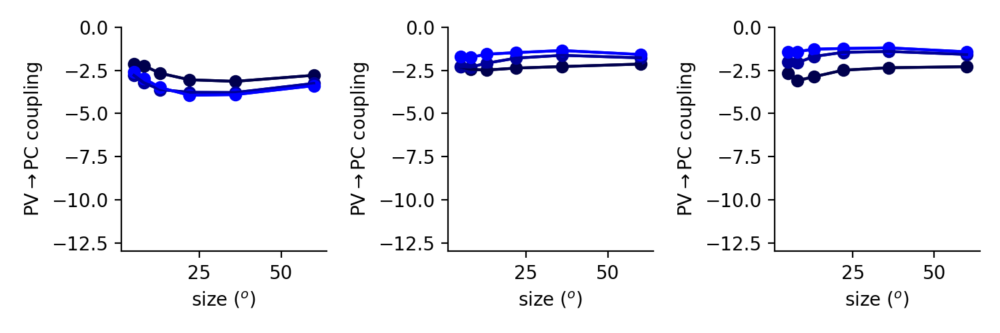

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches

-2.12299880569836
-1.3476389331060317
-1.1904005043423975


In [849]:
# rg = slice(None)
rg = lkat
i,j = 3,0
ylim = (-13,0)
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv_fixed = couplings_pcpv_fixed[rg,:,:,i,j]
coupling_sst_sst_fixed = couplings_fixed[rg,:,:,i,j,0]
colors = c_pv.copy()
ylabel = r'PV$\rightarrow$PC coupling'

plt.figure(figsize=(7.5,2.5))
usize = [5,8,13,22,36,60]
plt.subplot(1,3,1)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim)

plt.subplot(1,3,2)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_pcpv_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.ylim(ylim)

plt.subplot(1,3,3)
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst_sst_fixed[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=colors)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(ylabel)
plt.ylim(ylim)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


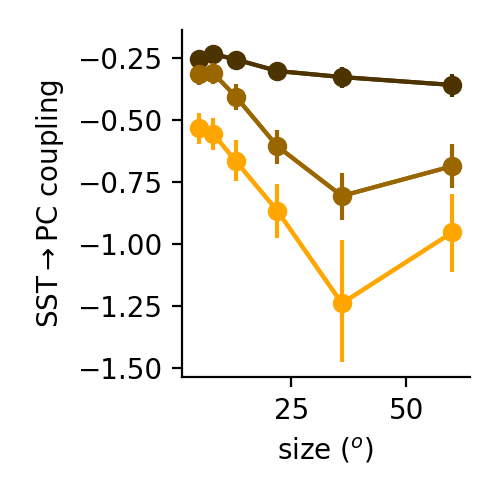

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.26851917984057116


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:22: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


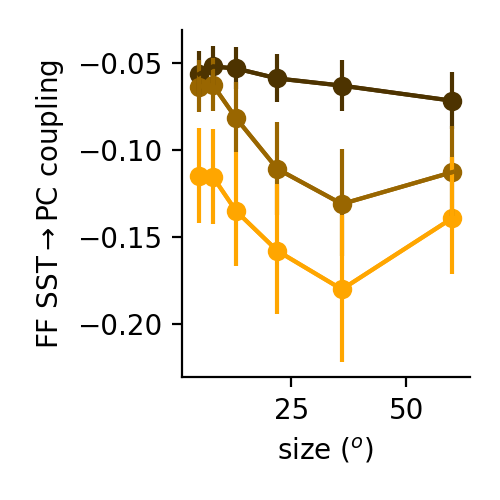

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.06413157277966482


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:41: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


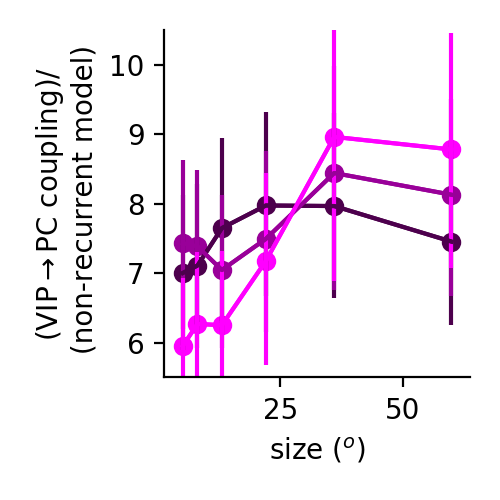

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


7.10741443815119


In [306]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,coupling_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_pc_coupling.eps')

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,polysyn_sst[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'FF SST$\rightarrow$PC coupling')
# ylim_sst = (4.5,9)
# plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
plt.savefig('figures/sst_phi_W_phi.eps')
i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


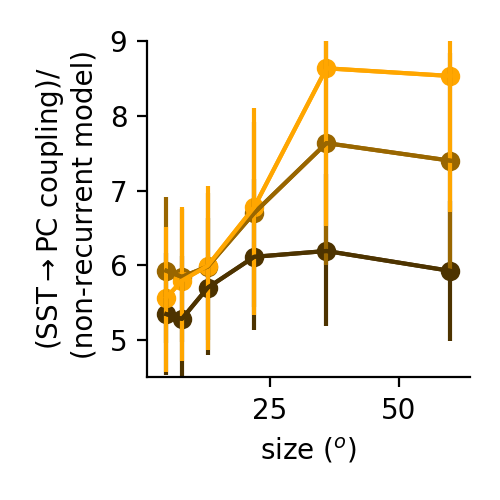

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


6.649769893675679


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


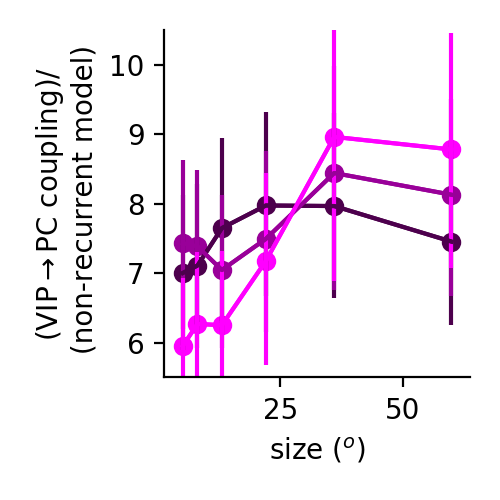

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


7.10741443815119


In [307]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_sst/polysyn_sst)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(SST$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
ylim_sst = (4.5,9)
plt.ylim(ylim_sst)
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_over_phi_W_phi.eps')

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
ylim_vip = (5.5,10.5)
plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:7: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  import sys


<IPython.core.display.Javascript object>


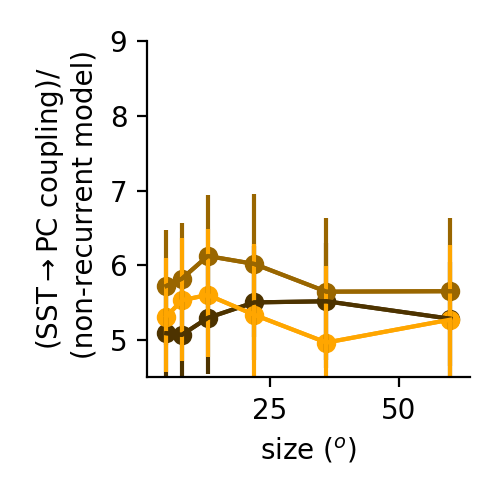

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


5.3022733890123295


/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:26: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


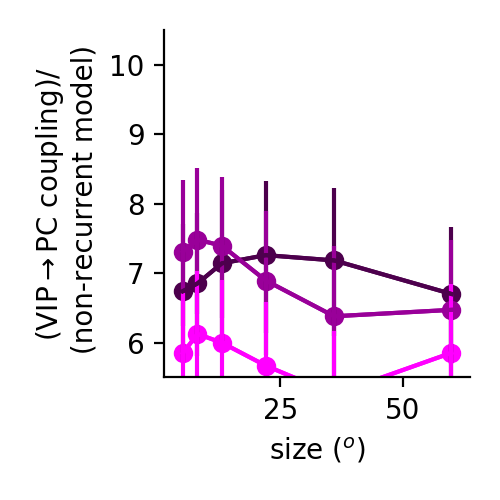

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


6.450332774934487


In [308]:
rg = slice(None)
i,j = 1,0
polysyn_sst = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]
coupling_sst = couplings[rg,:,:,i,j]
coupling_sst_pcpv = couplings_pcpv[rg,:,:,i,j]

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_sst_pcpv/polysyn_sst)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_sst)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(SST$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim_sst)
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_over_phi_W_phi_pcpv.eps')

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*Wmys[rg,i,j,np.newaxis,np.newaxis]*phis[rg,:,:,j]*Wmys[rg,j,k,np.newaxis,np.newaxis]*phis[rg,:,:,k]
coupling_vip = couplings[rg,:,:,i,k]
coupling_vip_pcpv = couplings_pcpv[rg,:,:,i,k]

plt.figure(figsize=(2.5,2.5))
usize = [5,8,13,22,36,60]
c_l23 = np.array(((0.5,0.5,0.5),(0.25,0.25,0.25),(0.,0.,0.)))
ut.plot_bootstrapped_errorbars_hillel(usize,(coupling_vip_pcpv/polysyn_vip)[:,:,[1,3,5]].transpose((0,2,1)),pct=(2.5,97.5),colors=c_vip)
# plt.axhline(1,linestyle='dashed',c='k')
plt.xlabel('size ($^o$)')
plt.ylabel(r'(VIP$\rightarrow$PC coupling)/'+' \n (non-recurrent model)')
# plt.legend(['6%','25%','100%'])
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['top'].set_visible(False)
plt.ylim(ylim_vip)
plt.tight_layout()
# plt.savefig('figures/vip_pc_coupling_over_phi_W_phi_pcpv.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:8: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


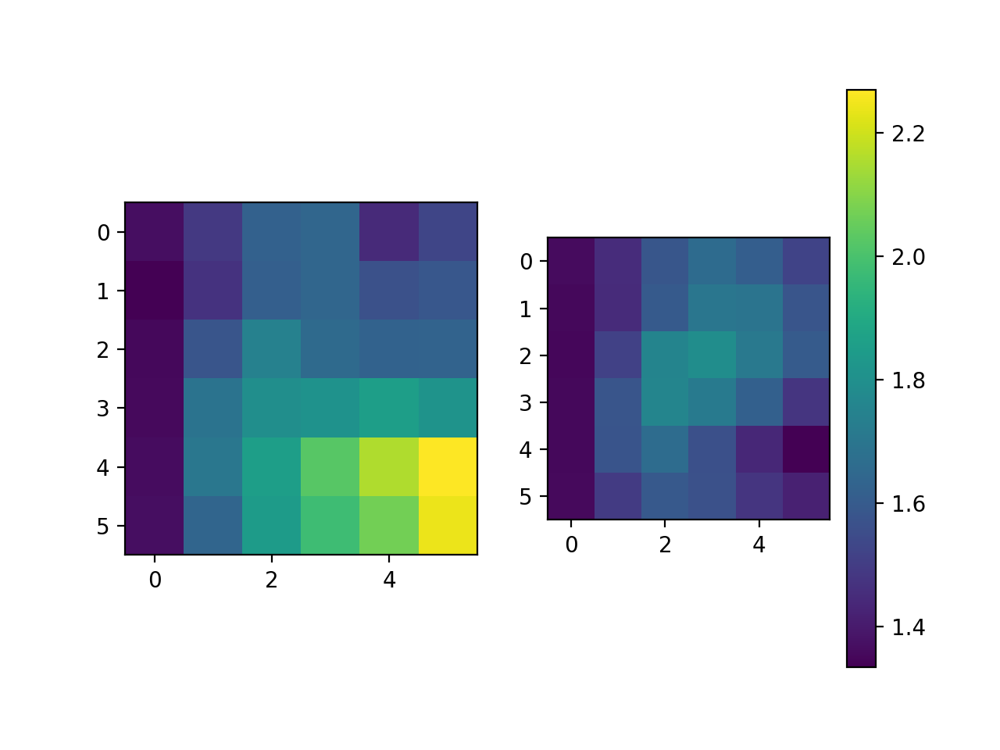

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:27: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).


<IPython.core.display.Javascript object>


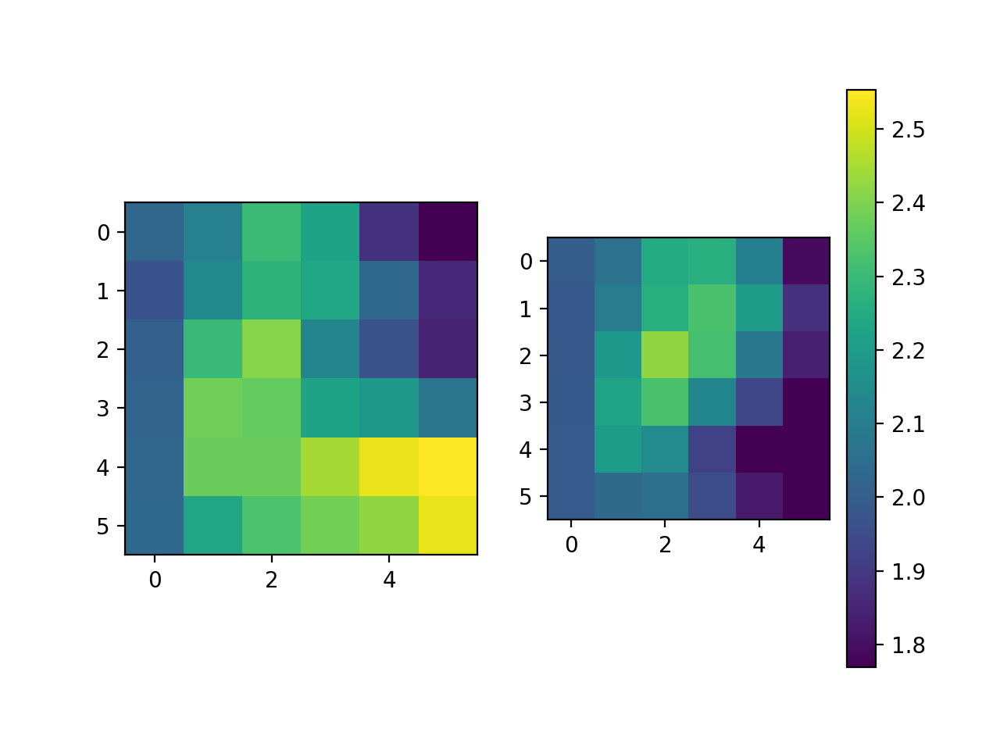

In [309]:
i,j = 1,0
iwt = 3
rg = slice(None)
polysyn_sst = phis[rg,:,:,i]*phis[rg,:,:,j]
coupling_sst = np.abs(couplings[rg,:,:,i,j])
coupling_sst_pcpv = np.abs(couplings_pcpv[rg,:,:,i,j])

plt.figure()
plt.subplot(1,2,1)
data = np.nanmean(coupling_sst/polysyn_sst,axis=0)
mn = np.nanmin(data)
mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.subplot(1,2,2)
data = np.nanmean(coupling_sst_pcpv/polysyn_sst,axis=0)
# mn = np.nanmin(data)
# mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.colorbar()

i,j,k = 2,1,0
polysyn_vip = phis[rg,:,:,i]*phis[rg,:,:,j]*phis[rg,:,:,k]
coupling_vip = np.abs(couplings[rg,:,:,i,k])
coupling_vip_pcpv = np.abs(couplings_pcpv[rg,:,:,i,k])
ei = phis[rg,:,:,0]/phis[rg,:,:,3]

plt.figure()
plt.subplot(1,2,1)
data = np.nanmean(coupling_vip/polysyn_vip,axis=0)
mn = np.nanmin(data)
mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.subplot(1,2,2)
data = np.nanmean(coupling_vip_pcpv/polysyn_vip,axis=0)
# mn = np.nanmin(data)
# mx = np.nanmax(data)
plt.imshow(data,vmin=mn,vmax=mx)
plt.colorbar()



/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


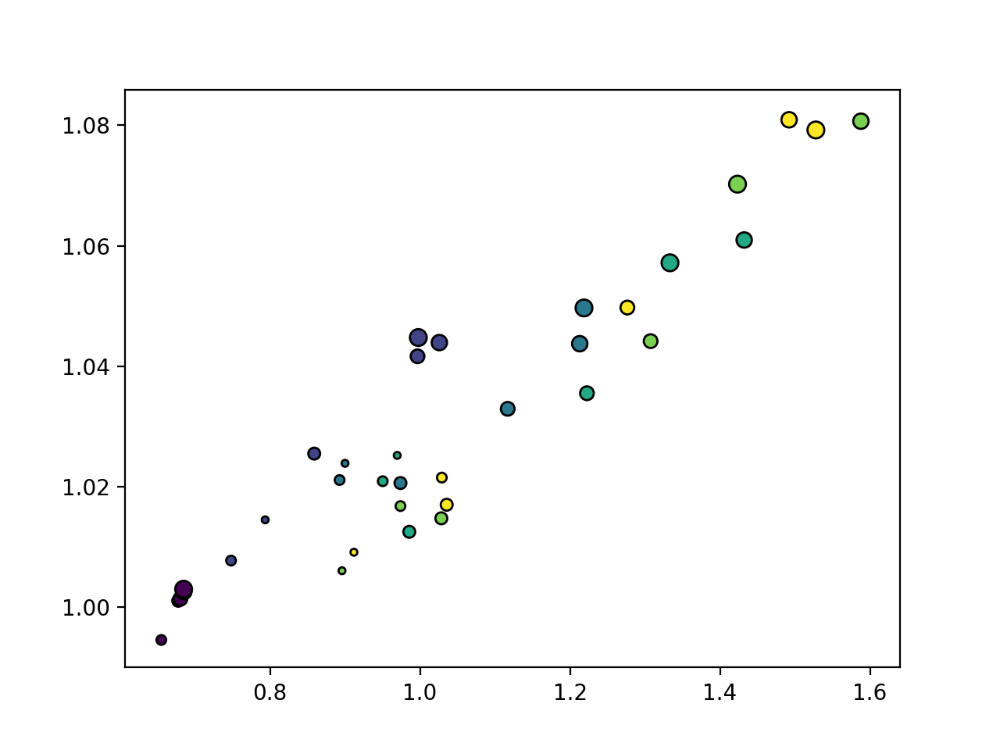

<IPython.core.display.Javascript object>


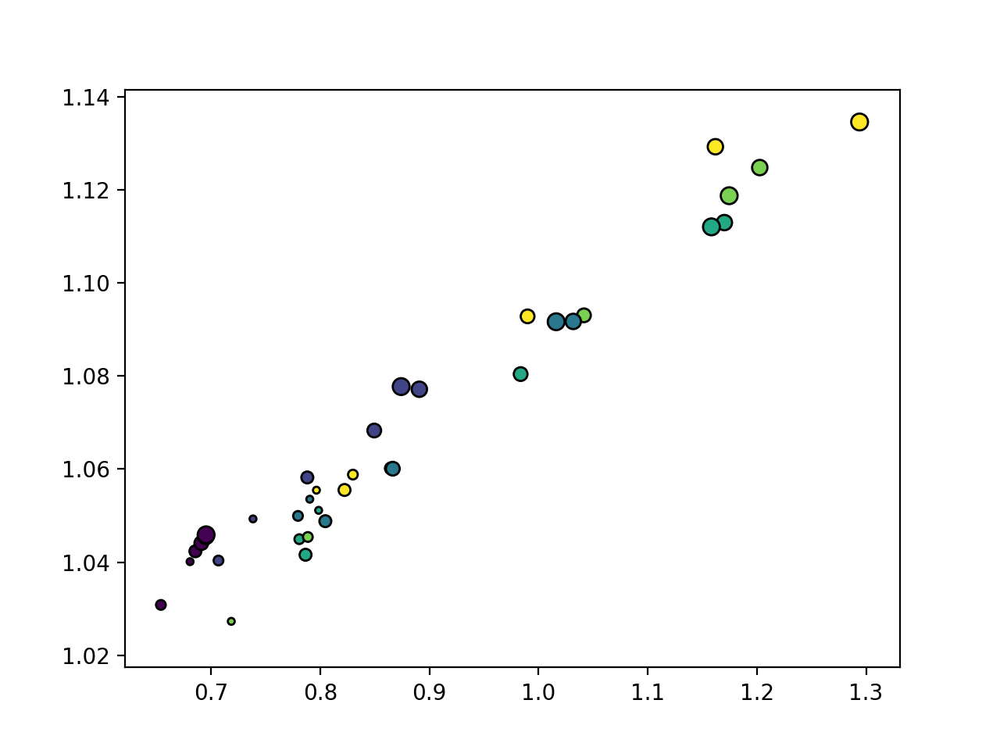

<IPython.core.display.Javascript object>


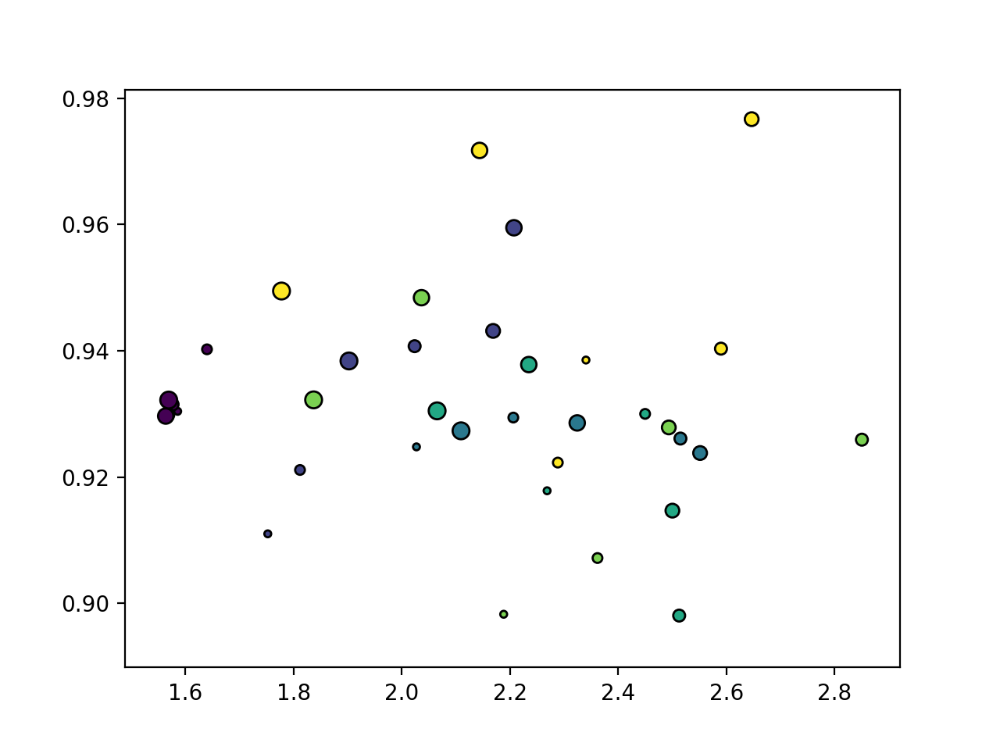

<IPython.core.display.Javascript object>


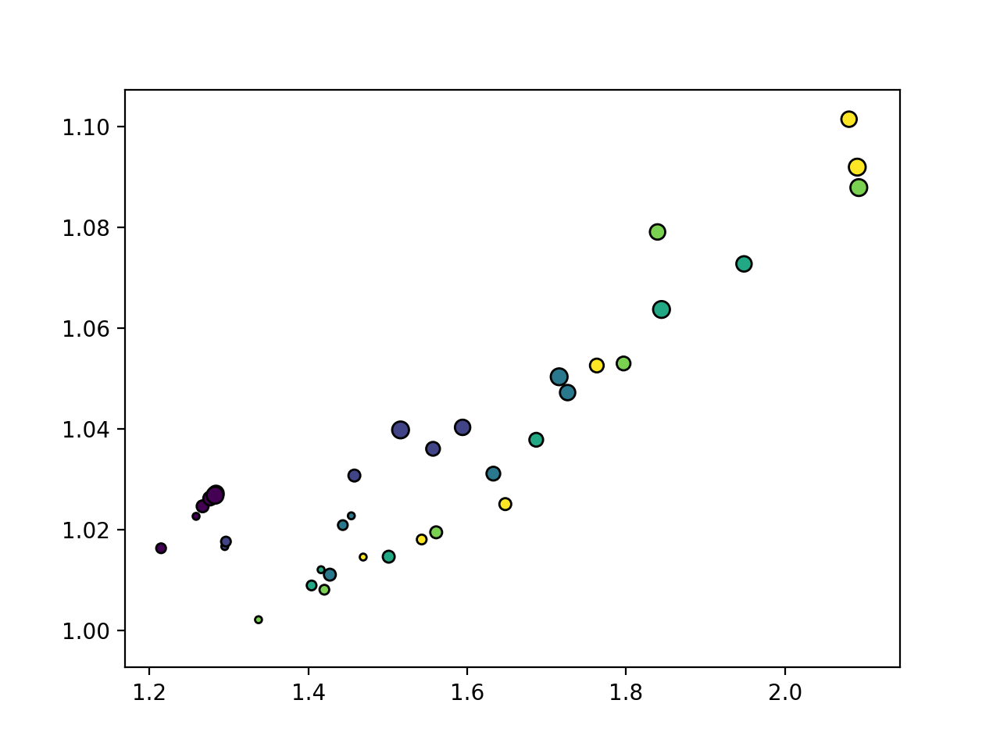

<IPython.core.display.Javascript object>


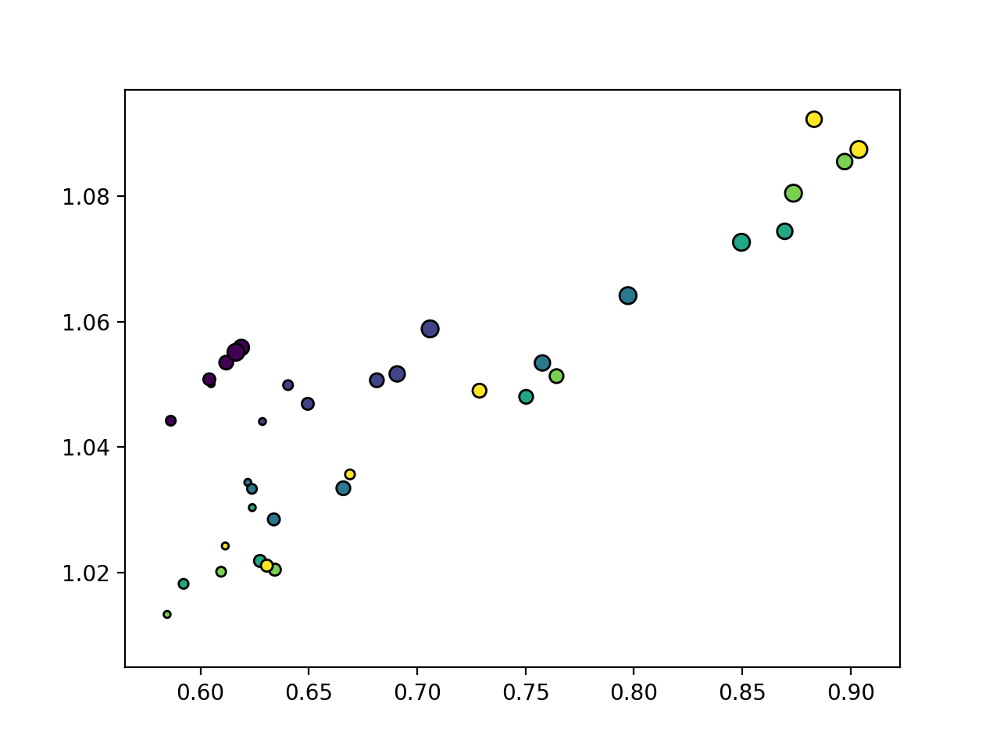

In [71]:
for iwt in range(5):
    plt.figure()
    sca.scatter_size_contrast(coupling_sst[iwt]/polysyn_sst[iwt],ei[iwt],equality_line=False,square=False)

<IPython.core.display.Javascript object>


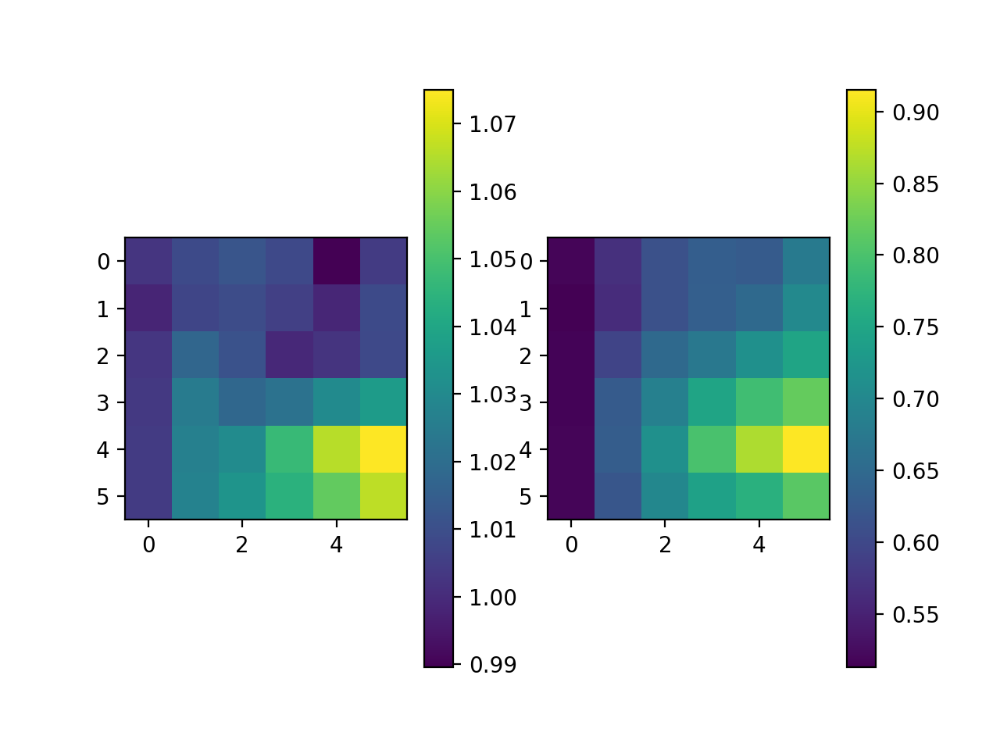

In [194]:
plt.figure()
plt.subplot(1,2,1)
plt.imshow(np.mean(phis[:,:,:,0]/phis[:,:,:,3],0))
plt.colorbar()
plt.subplot(1,2,2)
plt.imshow(np.mean(max_eig,0))
plt.colorbar()

In [417]:
max_eig.shape

(64, 6, 6)

In [402]:
couplings.shape

(84, 6, 6, 16, 16)

In [390]:
iwt,isize,icontrast = 0,0,0
w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


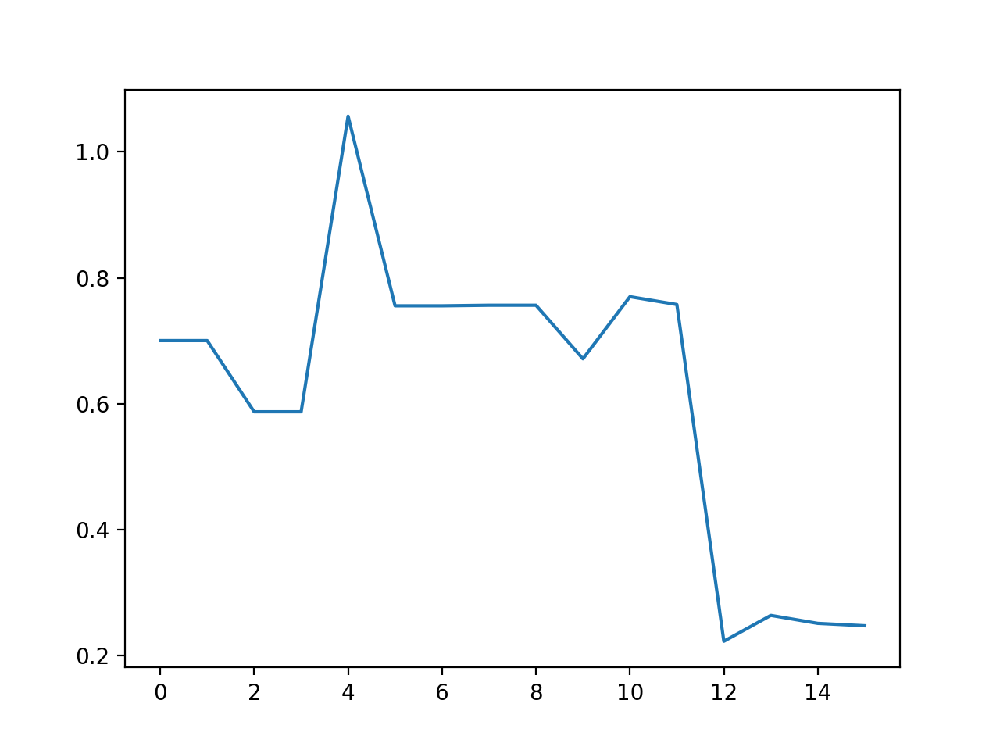

In [391]:
plt.figure()
plt.plot(np.abs(w))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


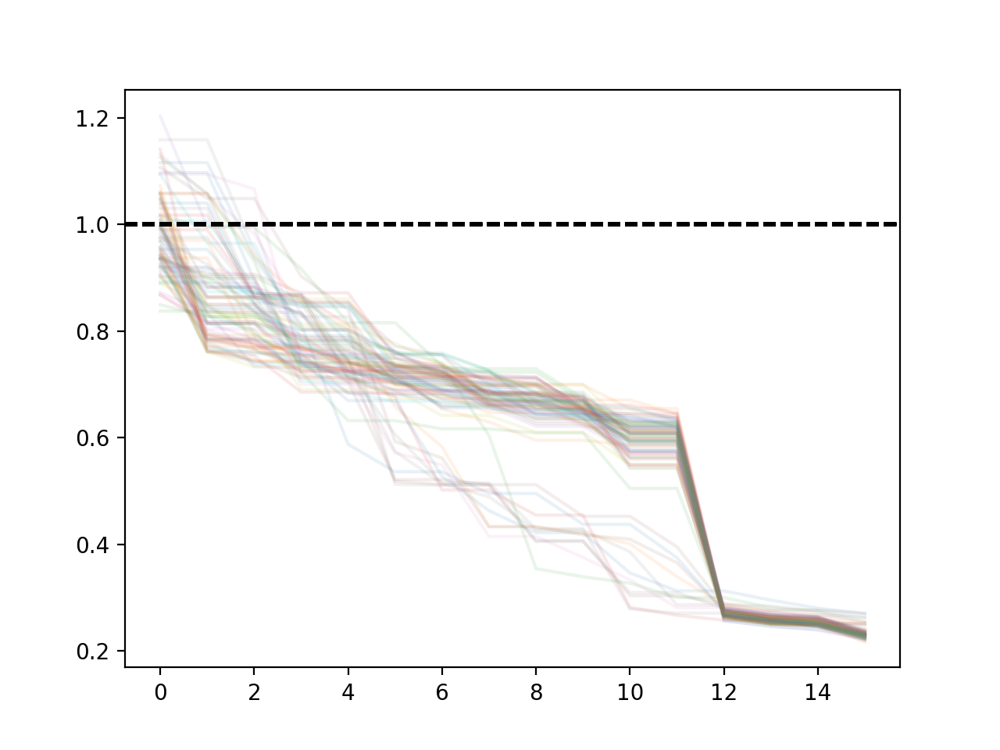

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:11: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  # This is added back by InteractiveShellApp.init_path()


<IPython.core.display.Javascript object>


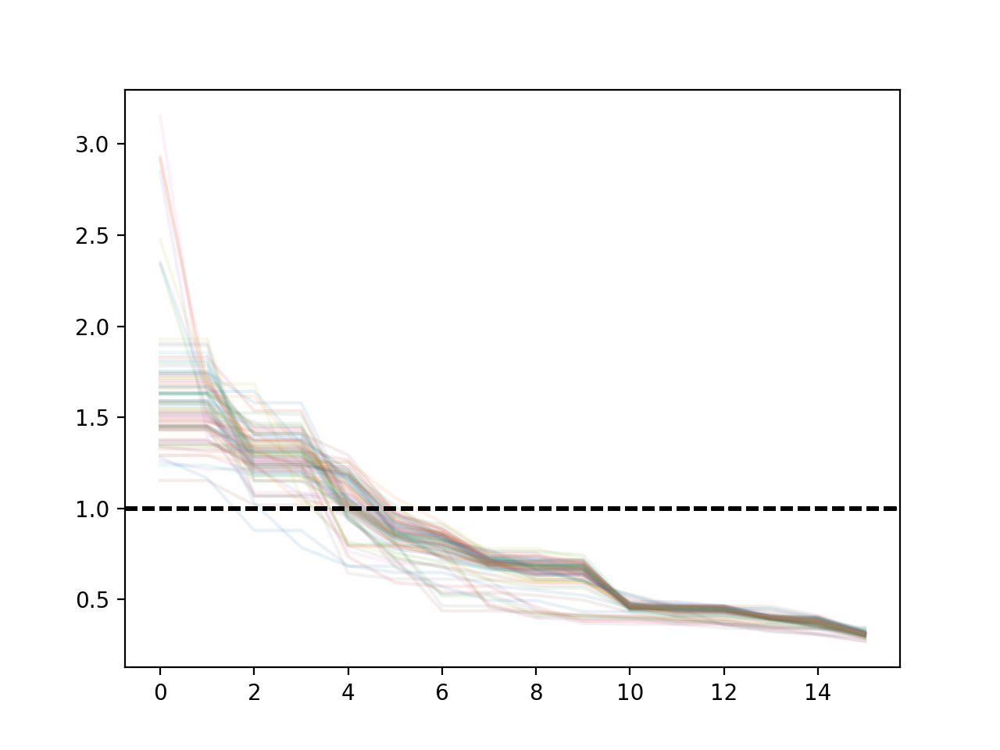

In [400]:
nwt = couplings.shape[0]
plt.figure()
for iwt in range(nwt):
    isize,icontrast = 0,0
    w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)
#     w,v = np.linalg.eig(Wmys[iwt].T)
    data = v[:,np.argmax(np.abs(w))]
#     plt.plot(data*np.sign(data[0]),alpha=0.1)
    plt.plot(-np.sort(-np.abs(w)),alpha=0.1)
    plt.axhline(1,c='k',linestyle='dashed')
plt.figure()
for iwt in range(nwt):
    isize,icontrast = -1,-1
    w,v = np.linalg.eig(couplings[iwt,isize,icontrast].T)
#     w,v = np.linalg.eig(Wmys[iwt].T)
    data = v[:,np.argmax(np.abs(w))]
#     plt.plot(data*np.sign(data[0]),alpha=0.1)
    plt.plot(-np.sort(-np.abs(w)),alpha=0.1)
    plt.axhline(1,c='k',linestyle='dashed')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


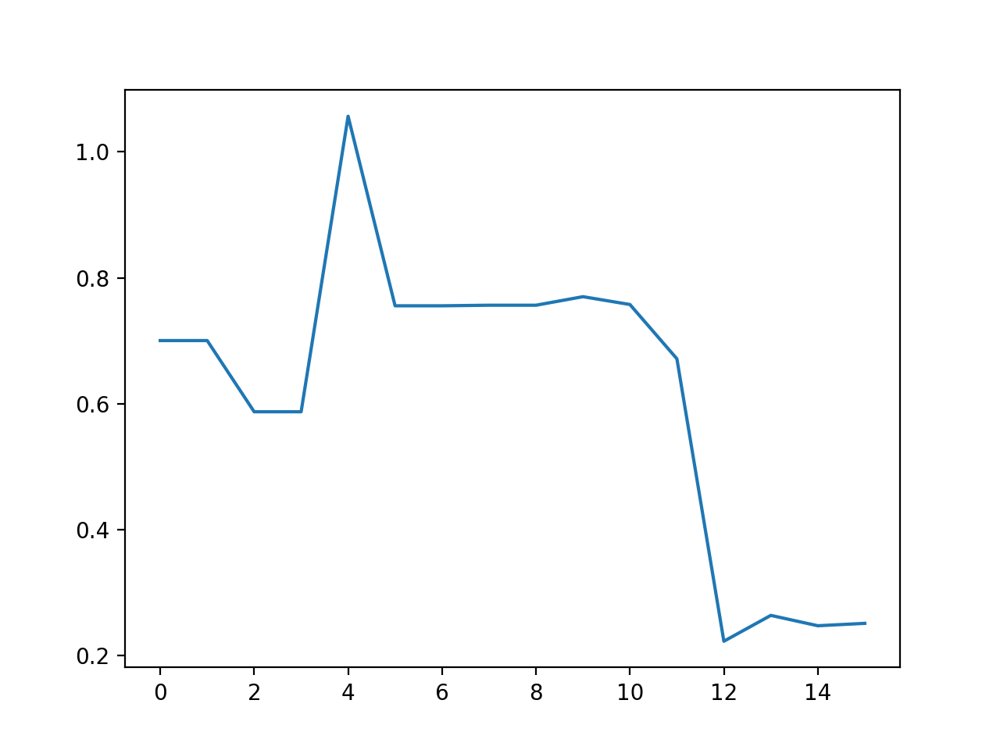

In [369]:
plt.figure()
plt.plot(np.abs(w))

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


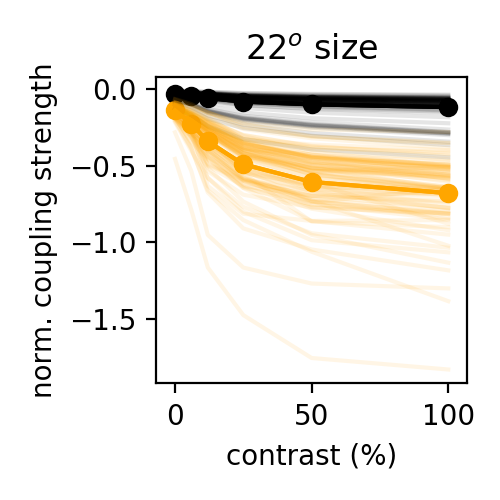

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.03917280614686907
-0.150050953198579


In [379]:
plt.figure(figsize=(2.5,2.5))
isize = 3
i,j = 1,0
polysyn_sst = phis[:,isize,:,i]*Wmys[:,np.newaxis,i,j]*phis[:,isize,:,j]
datas = [polysyn_sst,couplings[:,isize,:,i,j]]
colors = [np.array((0,0,0)),np.array((1,0.65,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend(['$\phi_{PC}$','$\phi_{SST}\phi_{PC}$','$\phi_{VIP}\phi_{SST}\phi_{PC}$'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data).T,alpha=0.1,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
# plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/sst_vip_pv_pc_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


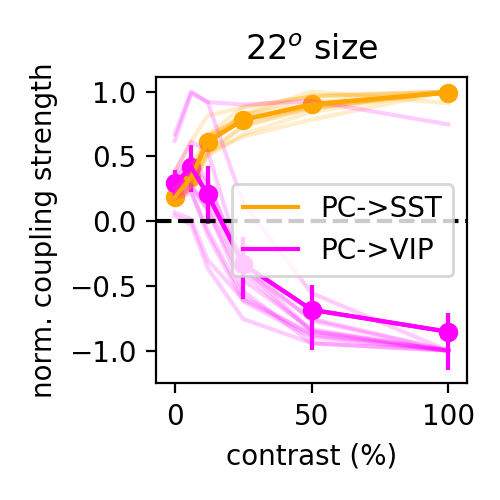

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9775239571935156
0.2438549595342812


In [262]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[:,isize,:,0,1][lkat],couplings[:,isize,:,0,2][lkat]]
colors = [np.array((1,0.65,0)),np.array((1,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['PC->SST','PC->VIP'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
plt.savefig('figures/pc_sst_vip_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


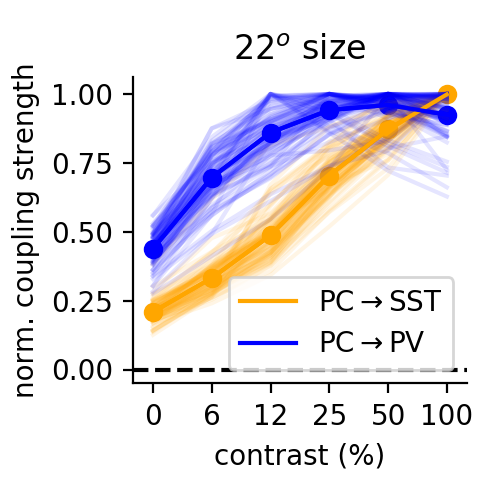

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9954072593906618
0.9445815973788986


In [460]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[:,isize,:,0,1],couplings[:,isize,:,0,3]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'PC$\rightarrow$SST',r'PC$\rightarrow$PV'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
erase_top_right()
plt.tight_layout()
plt.savefig('figures/pc_sst_pv_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


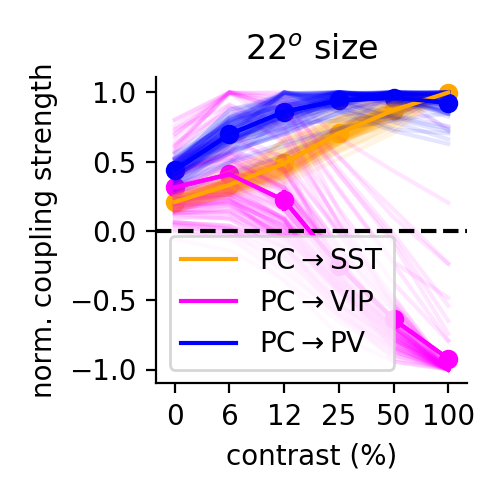

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.9954072593906618
0.33959046626249945
0.9445815973788986


In [244]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[:,isize,:,0,1],couplings[:,isize,:,0,2],couplings[:,isize,:,0,3]]
colors = [np.array((1,0.65,0)),np.array((1,0,1)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend([r'PC$\rightarrow$SST',r'PC$\rightarrow$VIP',r'PC$\rightarrow$PV'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
erase_top_right()
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
plt.savefig('figures/pc_sst_vip_pv_coupling_traces.jpg',dpi=300)

<IPython.core.display.Javascript object>


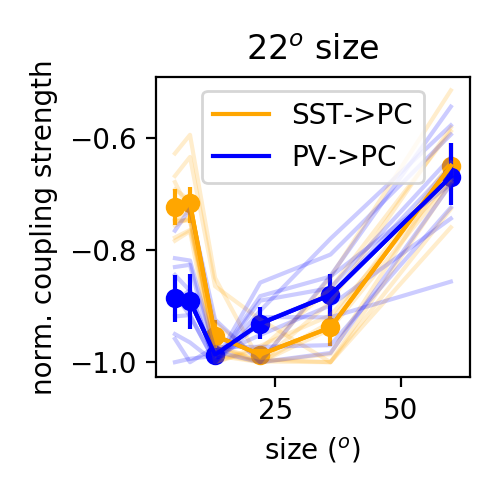

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.6913826093226111
-0.7283928801069505


In [193]:
plt.figure(figsize=(2.5,2.5))
icontrast = 5
datas = [couplings[:,:,icontrast,1,0][lkat],couplings[:,:,icontrast,3,0][lkat]]
colors = [np.array((1,0.65,0)),np.array((0,0,1))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(usize,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['SST->PC','PV->PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(usize,(data/mx).T,alpha=0.2,c=color)
plt.xlabel('size ($^o$)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

In [257]:
nlkat

12

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


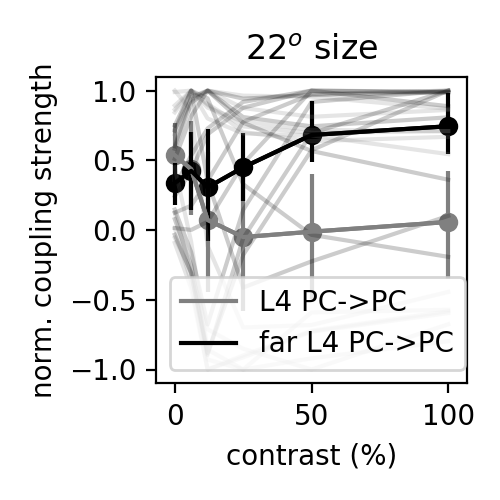

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.
'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


0.3030547878623264
0.5045479222596704


In [318]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [Xcouplings[:,isize,:,0,0][lkat],Xcouplings[:,isize,:,4,0][lkat]]
colors = [np.array((0.5,0.5,0.5)),np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['L4 PC->PC','far L4 PC->PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.tight_layout()
# plt.savefig('figures/far_pc_near_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


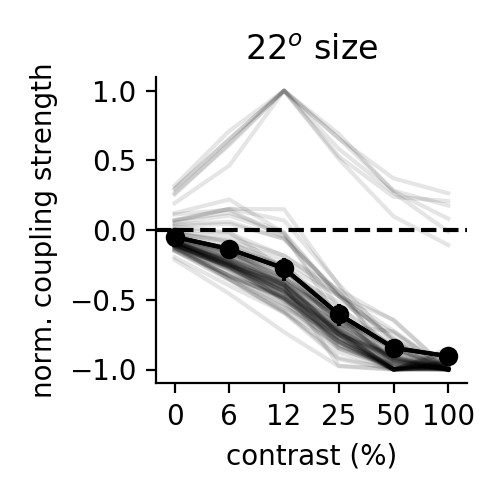

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.07160307643207439


In [374]:
plt.figure(figsize=(2.5,2.5))
isize = 3
x = np.arange(6)
datas = [couplings[:,isize,:,8,0]] #couplings[:,isize,:,0,0],
colors = [np.array((0,0,0))] #np.array((0.5,0.5,0.5)),
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(x,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend([r'PC$\rightarrow$PC',r'far PC$\rightarrow$PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(x,(data/mx).T,alpha=0.1,c=color)
plt.xticks(x,ucontrast)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
erase_top_right()
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
plt.savefig('figures/far_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


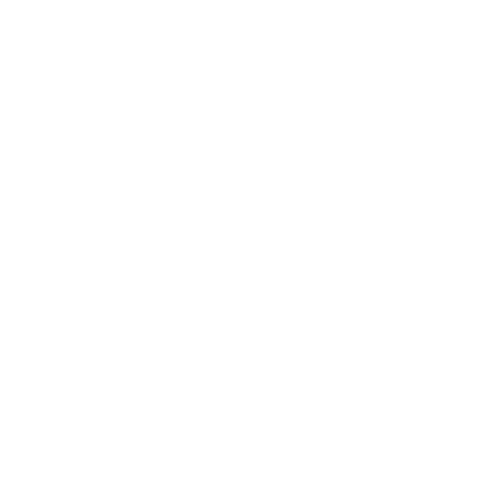

TypeError: list indices must be integers or slices, not tuple

In [292]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [couplings[:,isize,:,0,0],couplings[:,isize,:,8,0]]
colors = [np.array((0.5,0.5,0.5)),np.array((0,0,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
plt.legend(['PC->PC','far PC->PC'])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.1,c=color)
plt.xlabel('contrast (%)')
plt.ylabel('norm. coupling strength')
plt.title('%d$^o$ size'%usize[isize])
plt.axhline(0,linestyle='dashed',c='k')
plt.tight_layout()
# plt.savefig('figures/far_pc_near_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


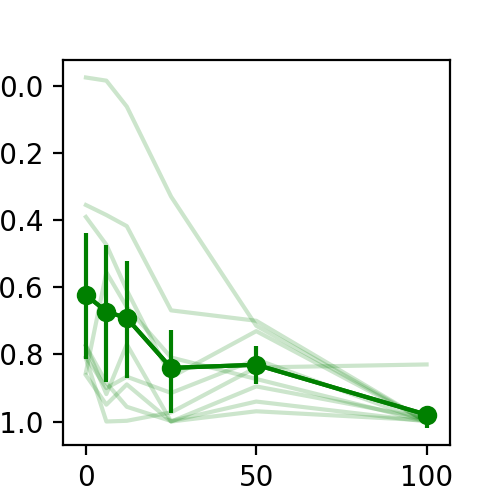

'c' argument looks like a single numeric RGB or RGBA sequence, which should be avoided as value-mapping will have precedence in case its length matches with 'x' & 'y'.  Please use a 2-D array with a single row if you really want to specify the same RGB or RGBA value for all points.


-0.808474426536969


In [978]:
plt.figure(figsize=(2.5,2.5))
isize = 3
datas = [Xcouplings[:,isize,:,4,0]]
colors = [np.array((0,0.5,0))]
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    ut.plot_bootstrapped_errorbars_hillel(ucontrast,(data/mx)[:,np.newaxis],pct=(2.5,97.5),colors=color[np.newaxis])
# plt.legend(['far PC->near])
for data,color in zip(datas,colors):
    mx = np.max(np.abs(data),axis=1)[:,np.newaxis]
    plt.plot(ucontrast,(data/mx).T,alpha=0.2,c=color)
# plt.xlabel('contrast (%)')
# plt.ylabel('norm. coupling strength')
# plt.tight_layout()
# # plt.savefig('figures/sst_pc_coupling_traces.jpg',dpi=300)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


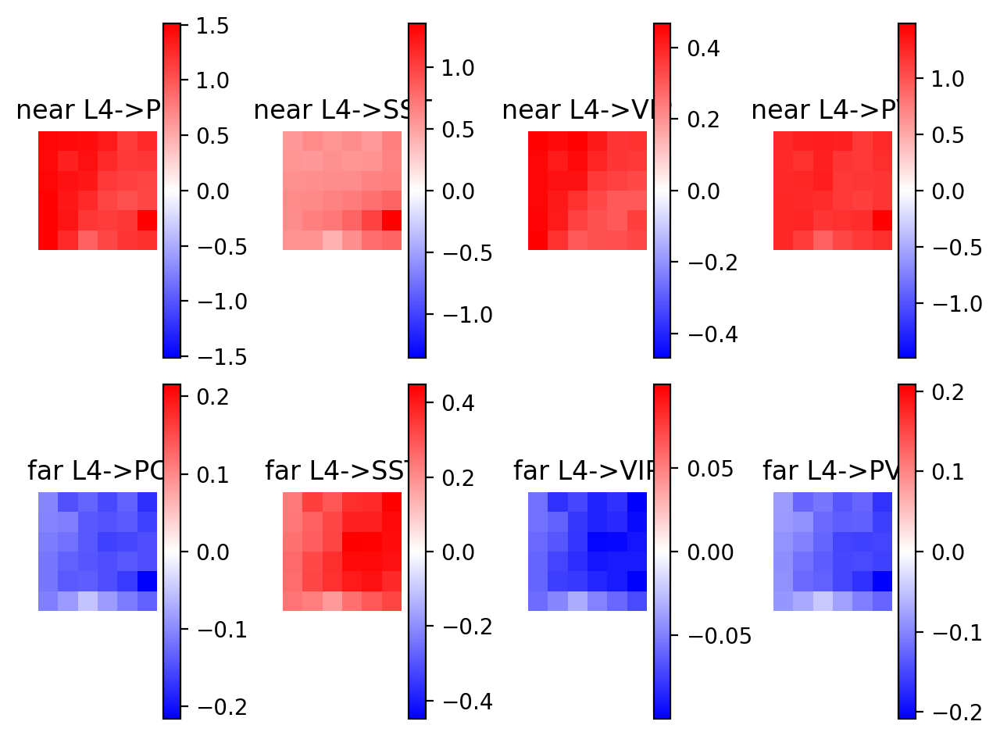

<IPython.core.display.Javascript object>


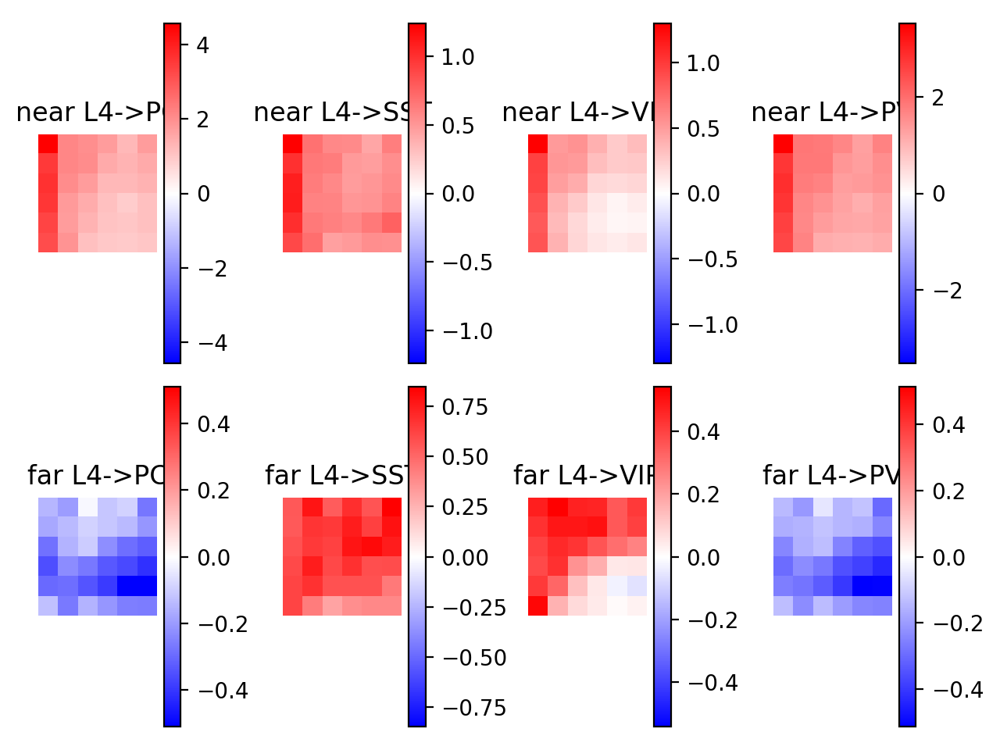

<IPython.core.display.Javascript object>


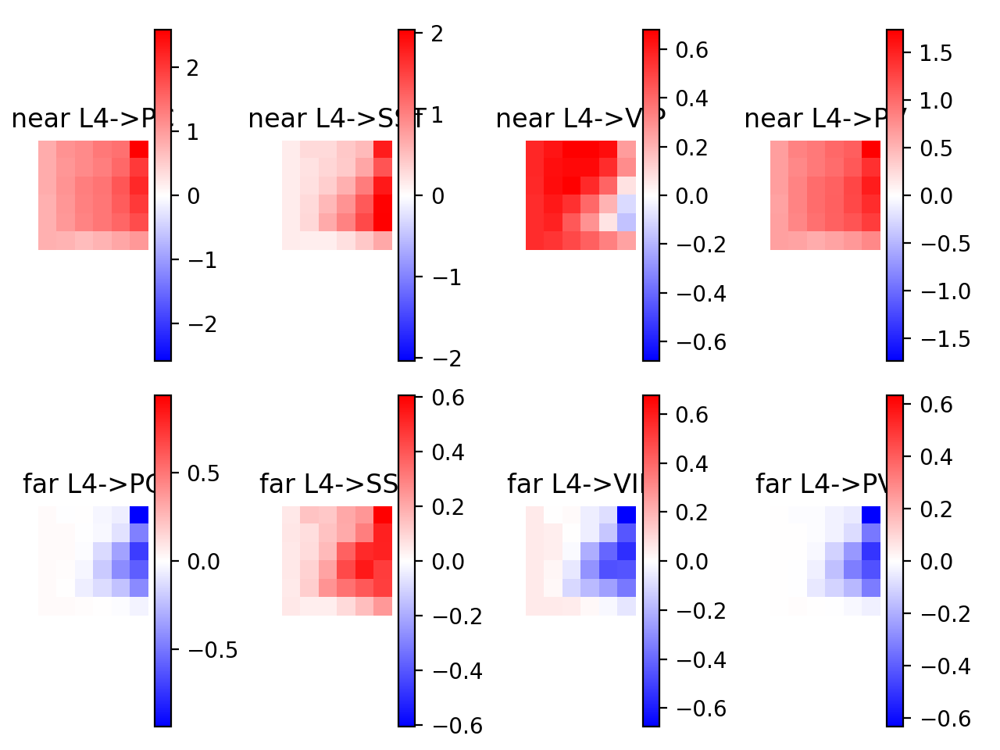

<IPython.core.display.Javascript object>


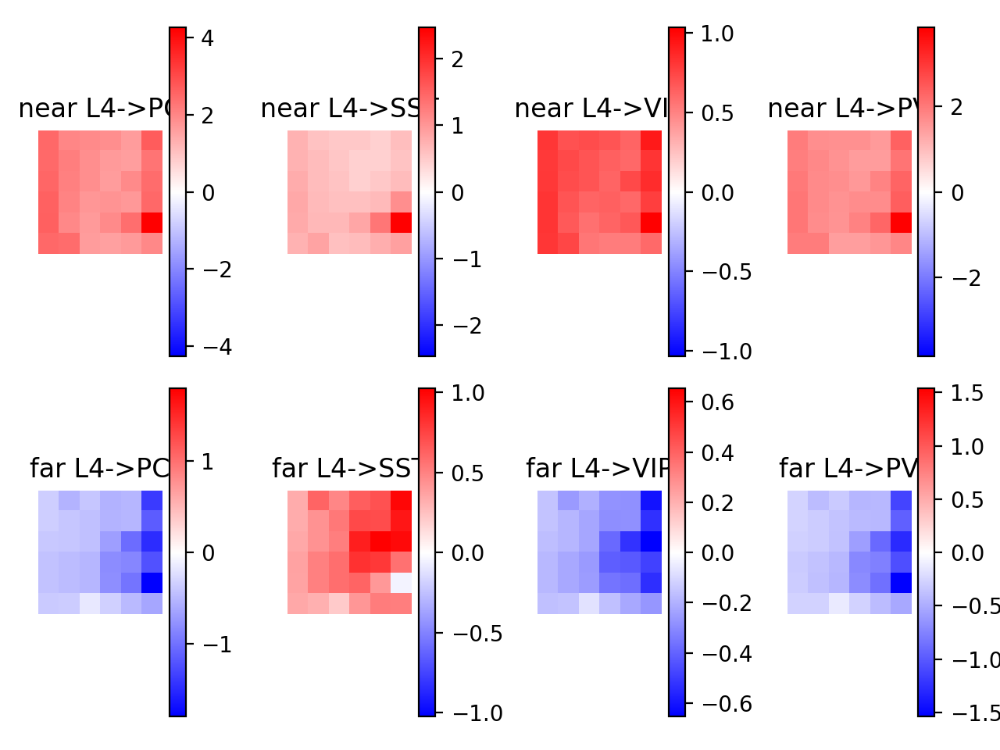

<IPython.core.display.Javascript object>


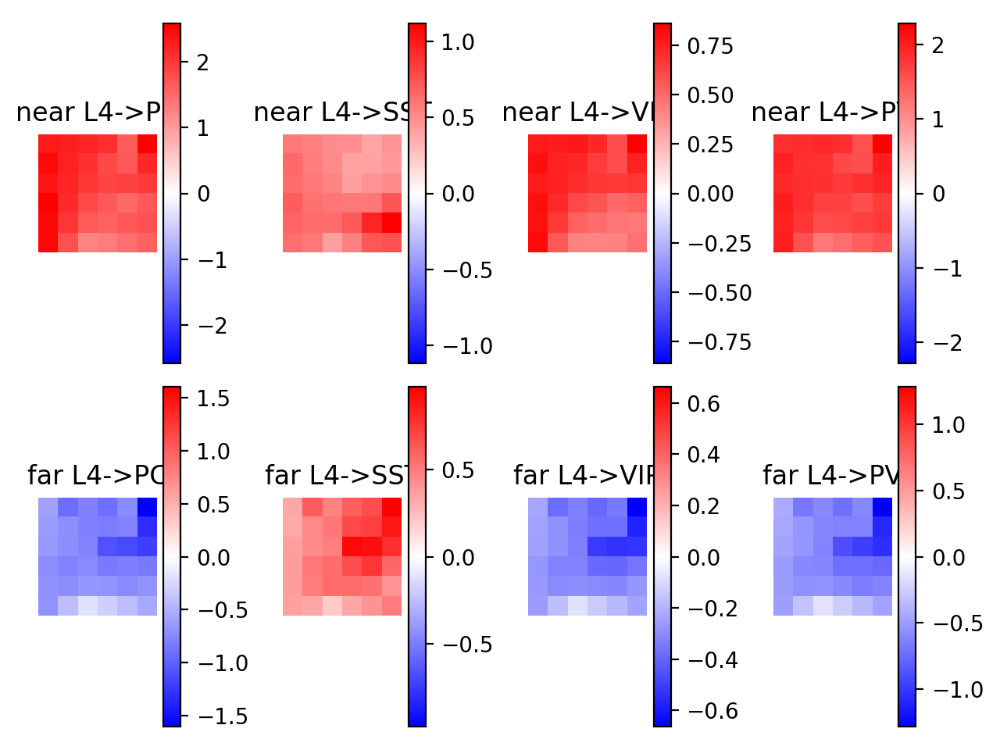

<IPython.core.display.Javascript object>


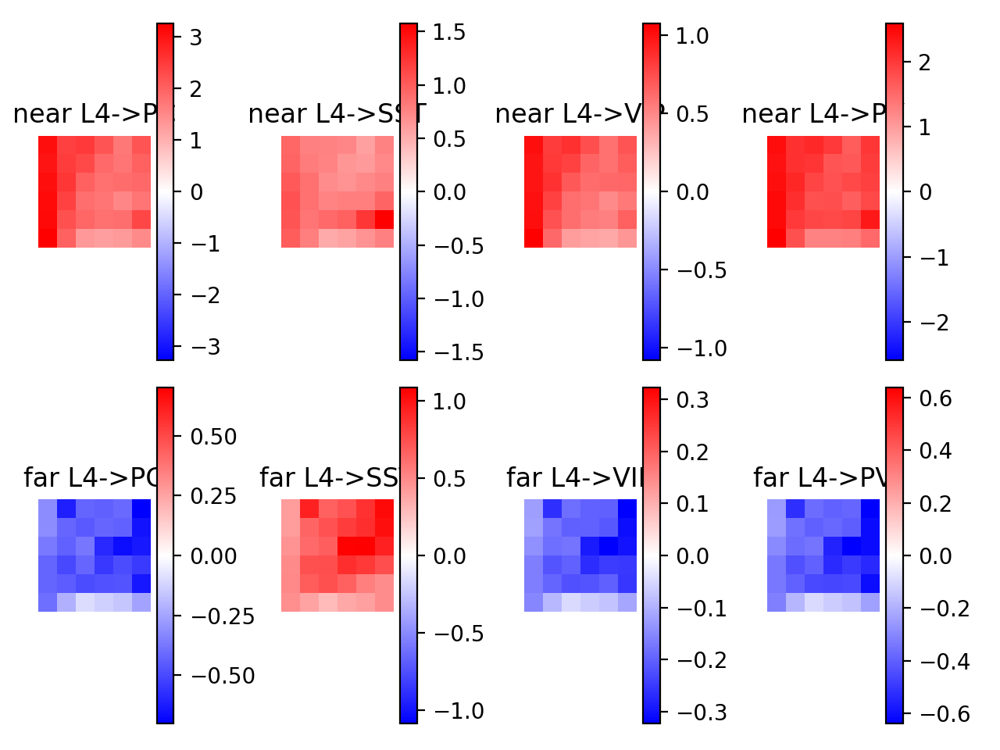

<IPython.core.display.Javascript object>


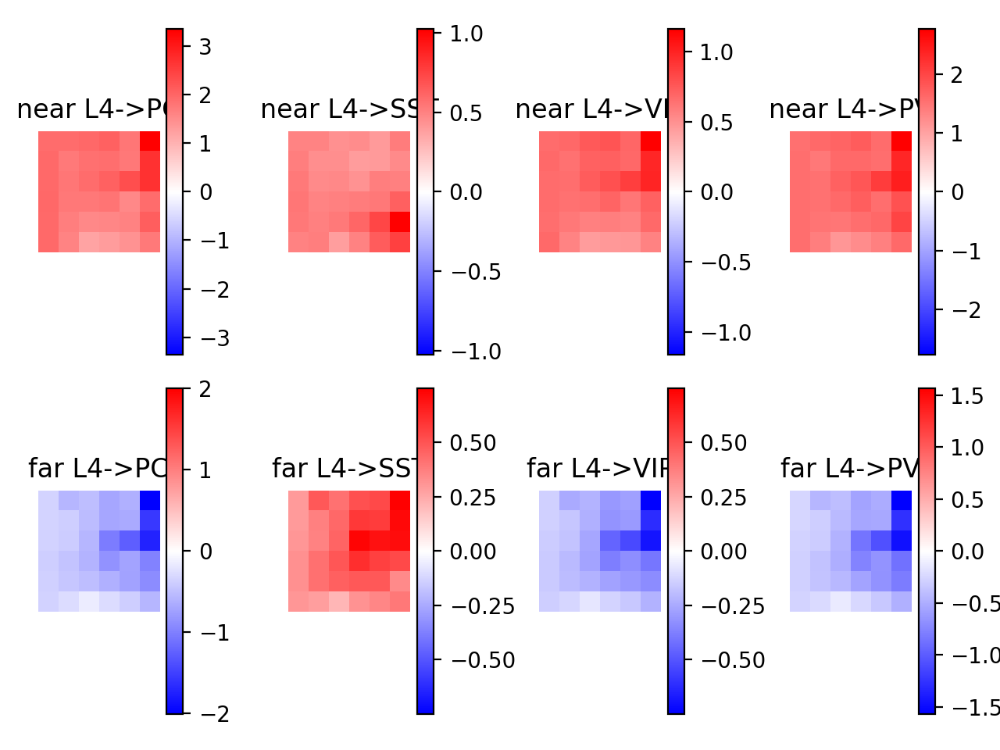

<IPython.core.display.Javascript object>


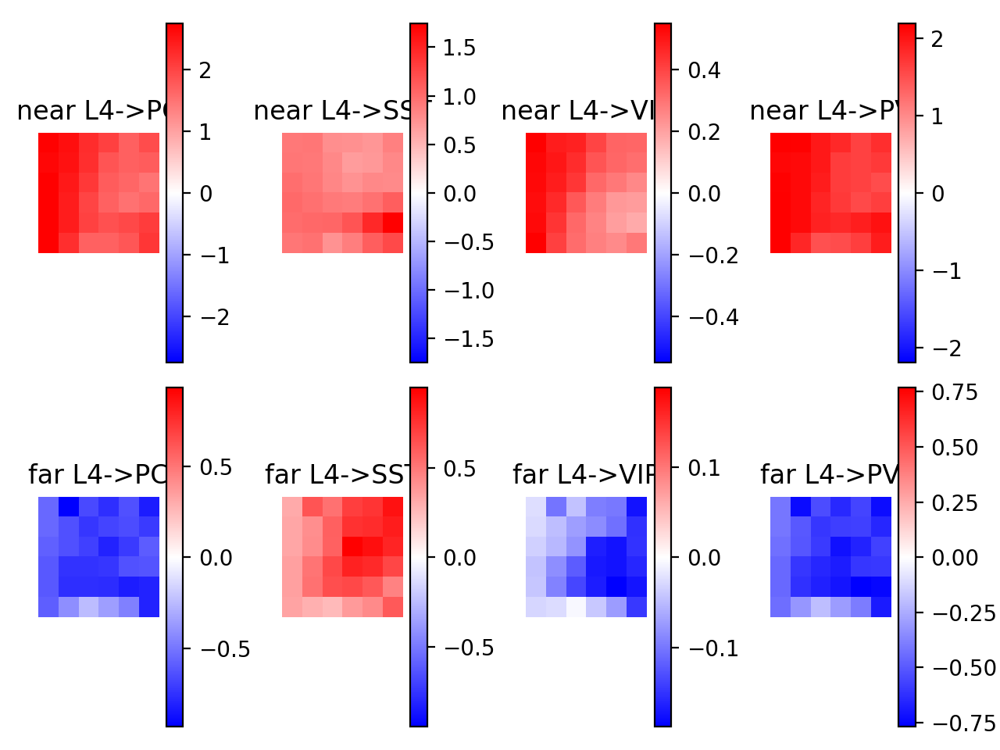

<IPython.core.display.Javascript object>


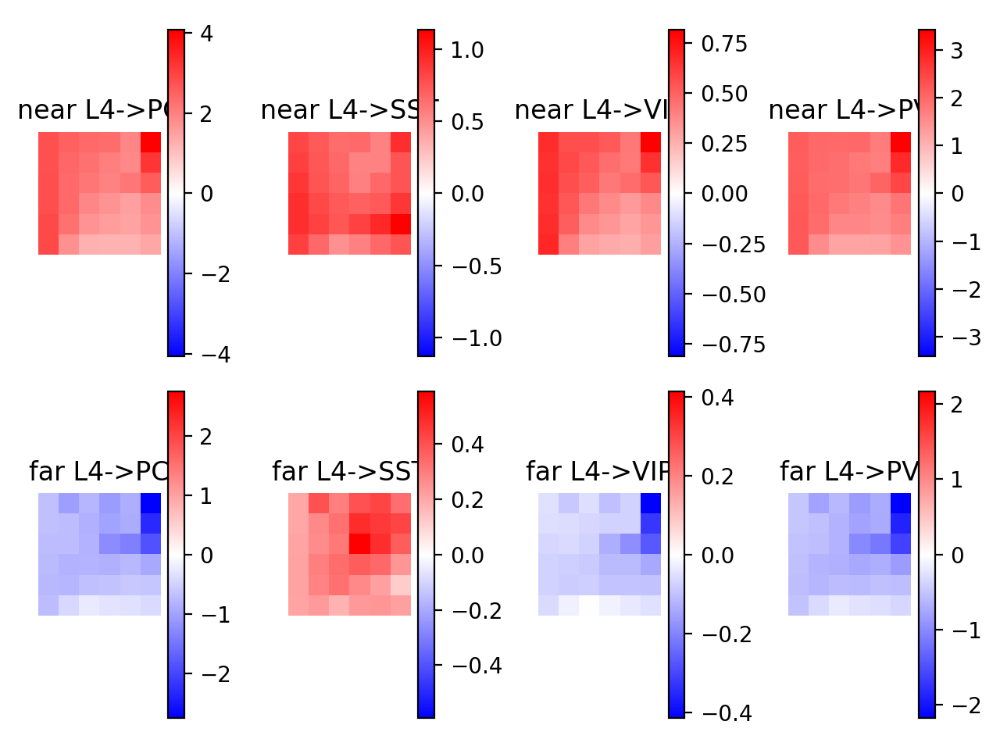

In [979]:
l4_lbls = ['near L4','far L4']
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i2 in range(4):
        plt.subplot(2,4,i2+1)
        data = Xcouplings[iwt][:,:,0,i2]
        plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
        plt.colorbar()
        plt.axis('off')
        plt.title('%s->%s'%(l4_lbls[0],lbls[i2]))
        
        plt.subplot(2,4,4+i2+1)
        data = Xcouplings[iwt][:,:,4,i2]
        plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
        plt.colorbar()
        plt.axis('off')
        plt.title('%s->%s'%(l4_lbls[1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


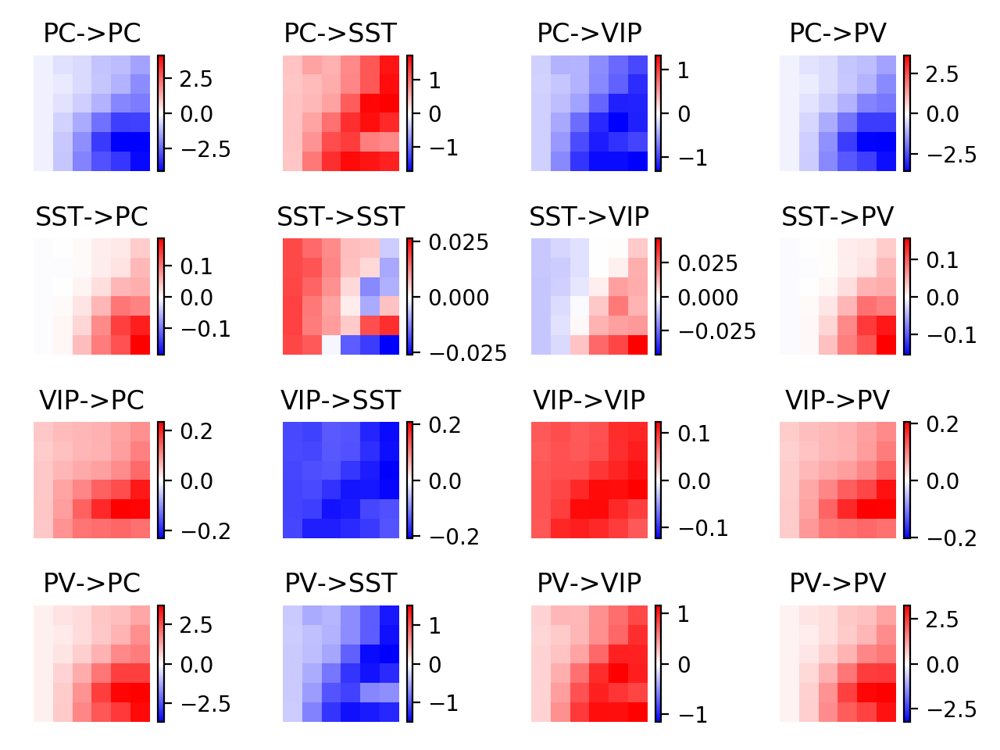

<IPython.core.display.Javascript object>


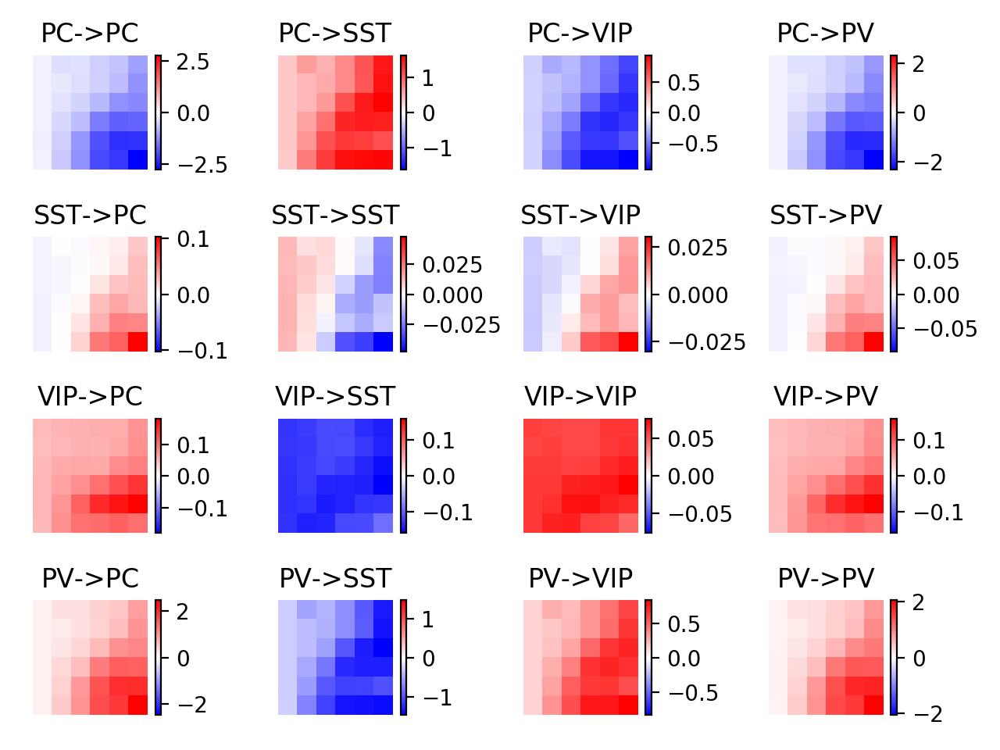

<IPython.core.display.Javascript object>


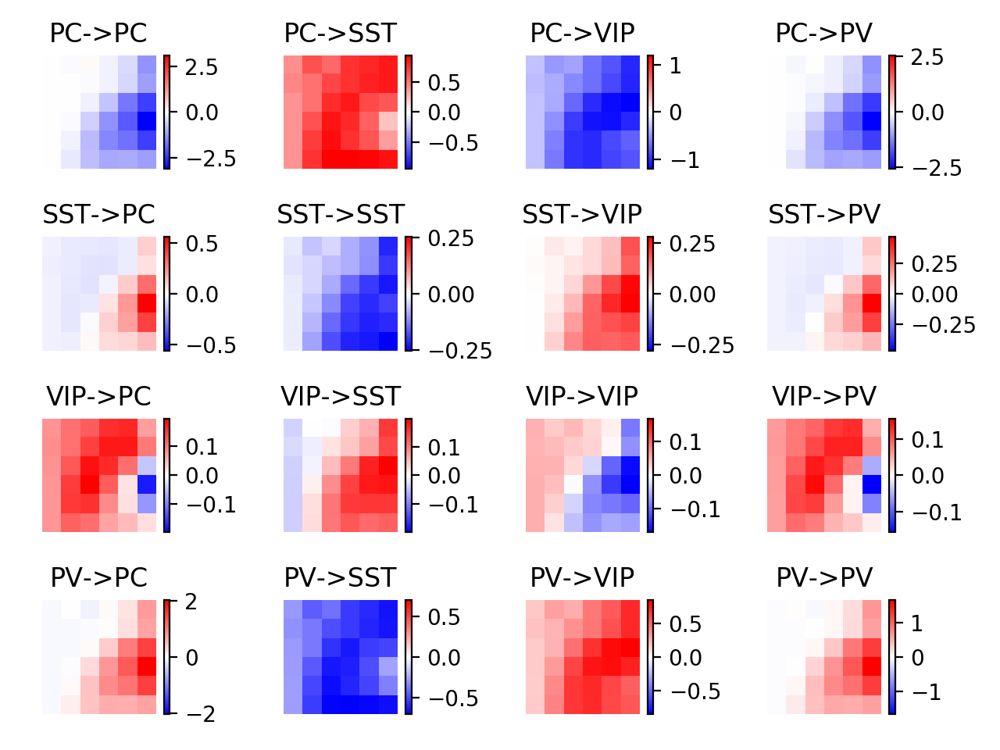

<IPython.core.display.Javascript object>


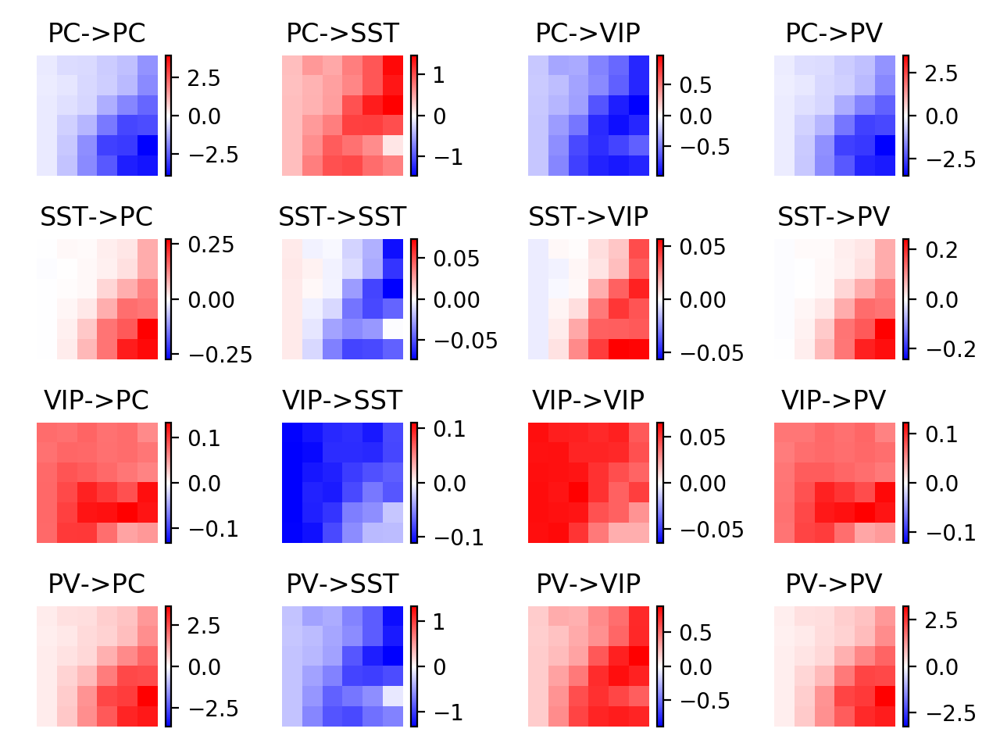

<IPython.core.display.Javascript object>


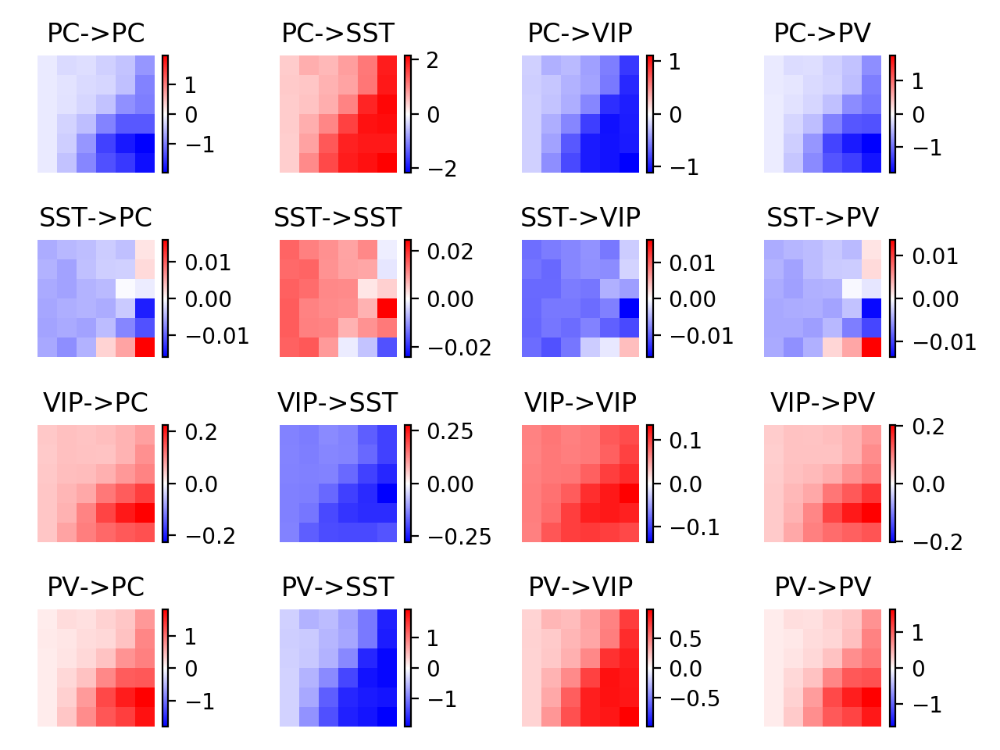

<IPython.core.display.Javascript object>


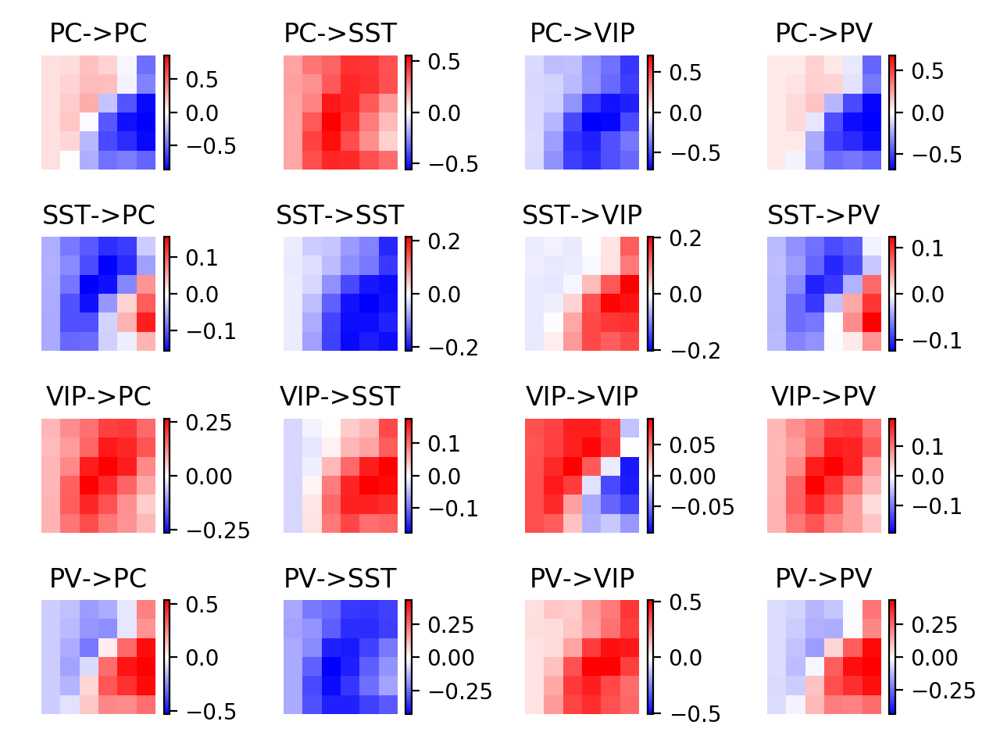

<IPython.core.display.Javascript object>


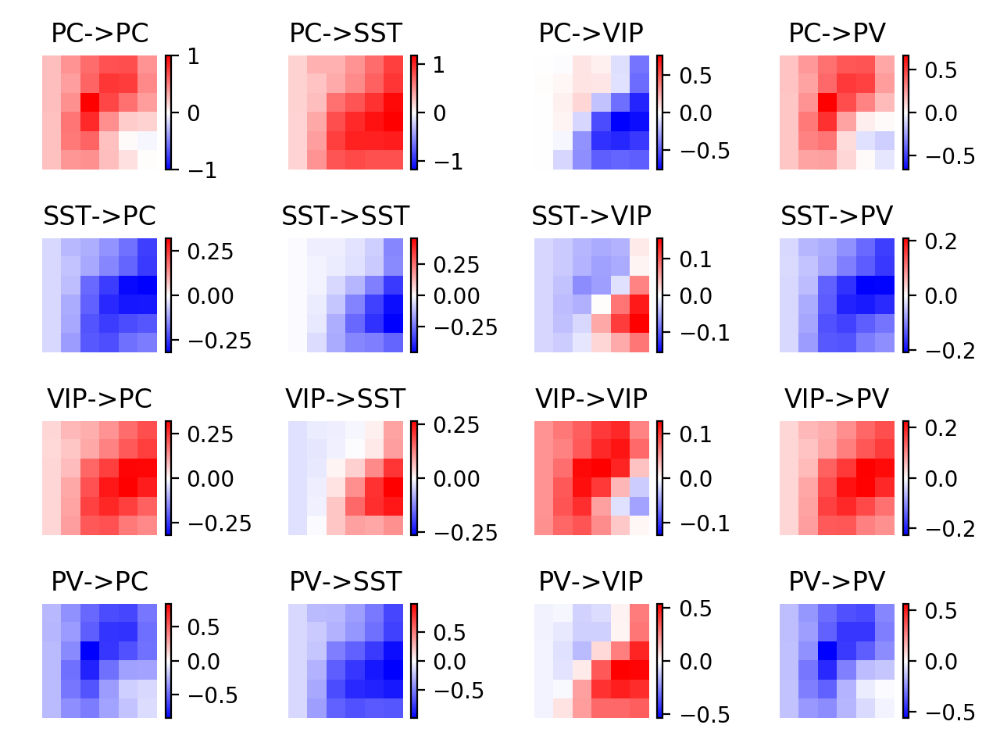

<IPython.core.display.Javascript object>


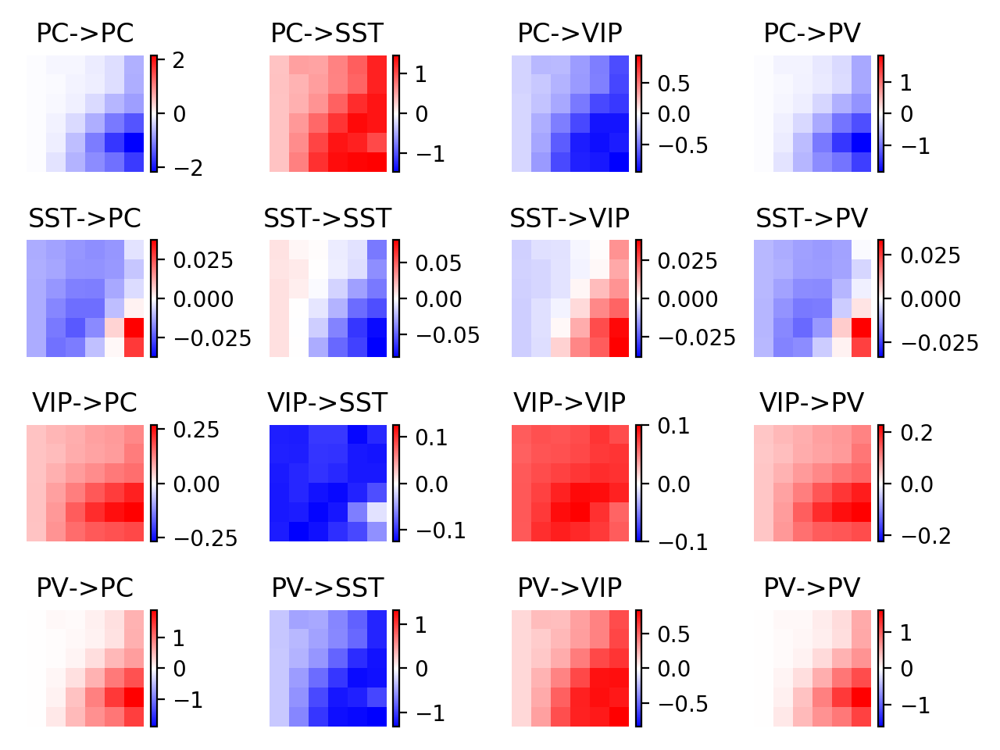

<IPython.core.display.Javascript object>


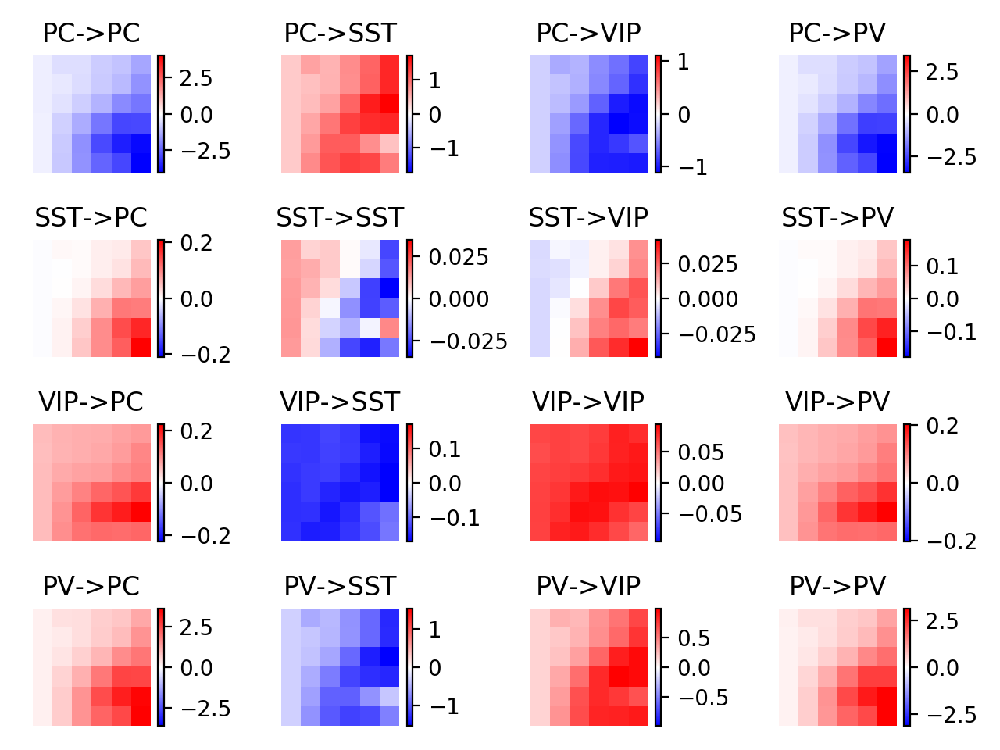

<IPython.core.display.Javascript object>


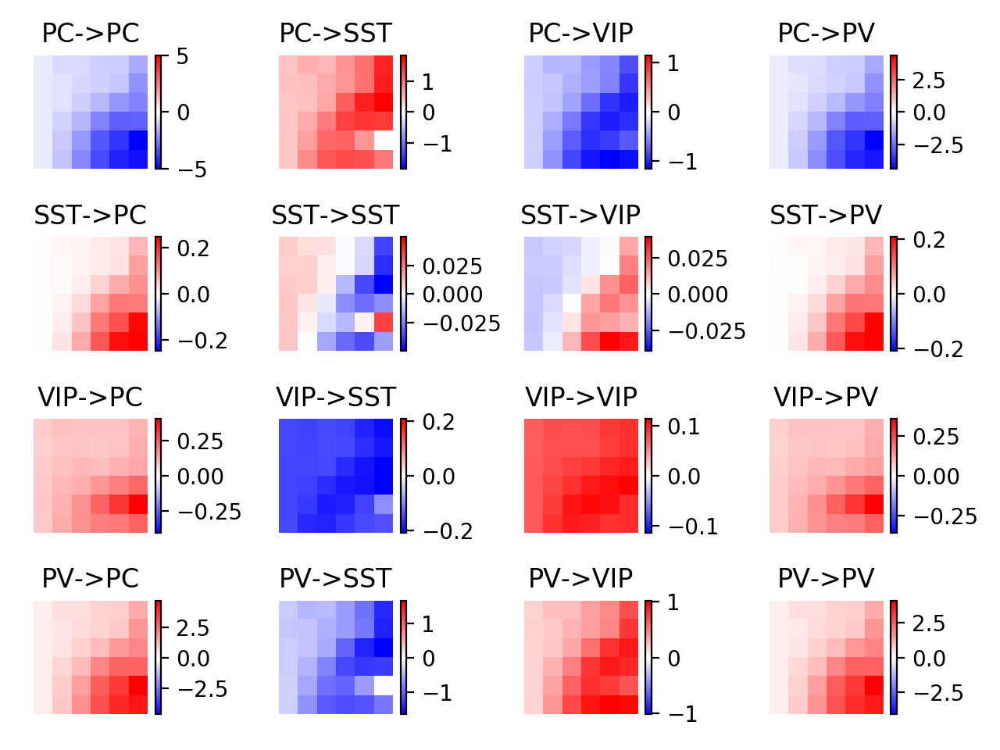

<IPython.core.display.Javascript object>


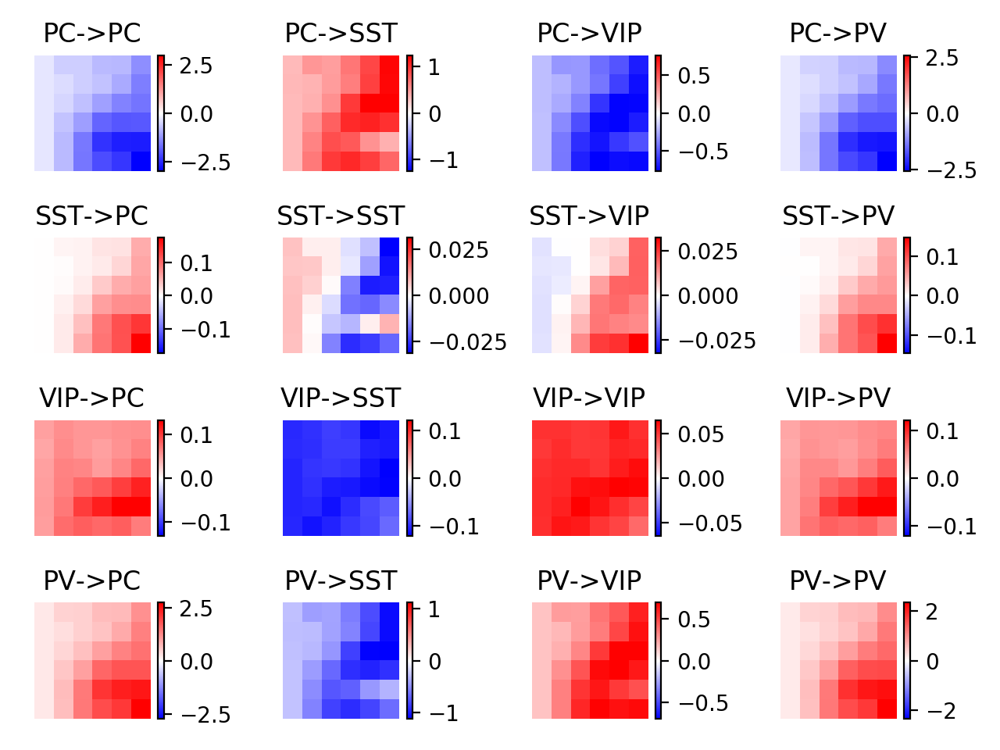

<IPython.core.display.Javascript object>


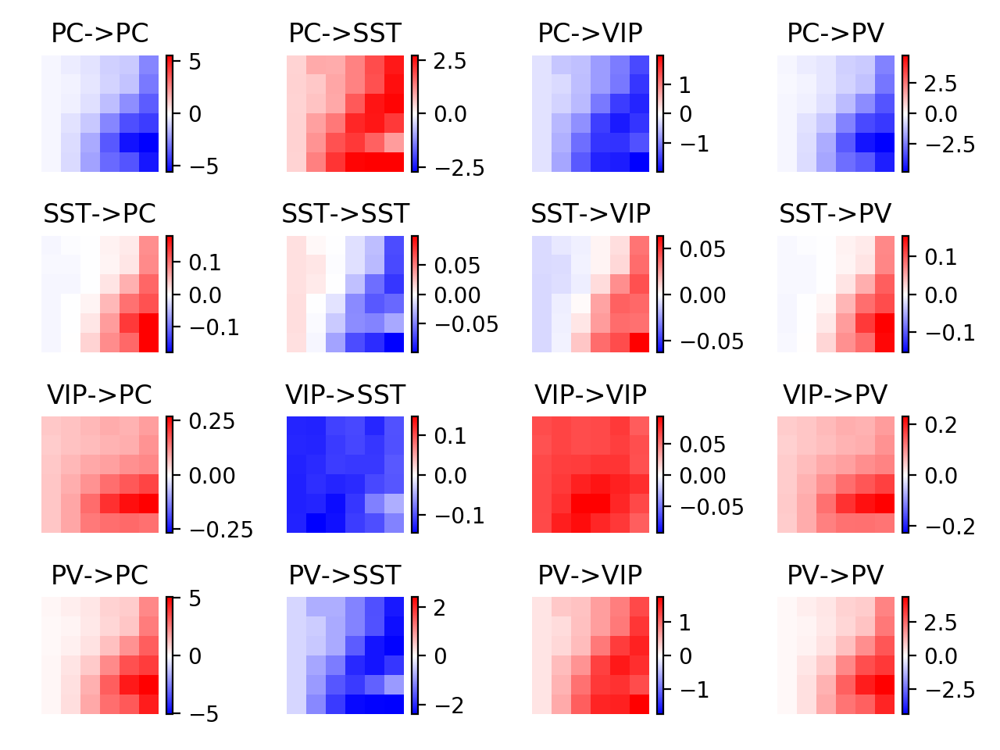

<IPython.core.display.Javascript object>


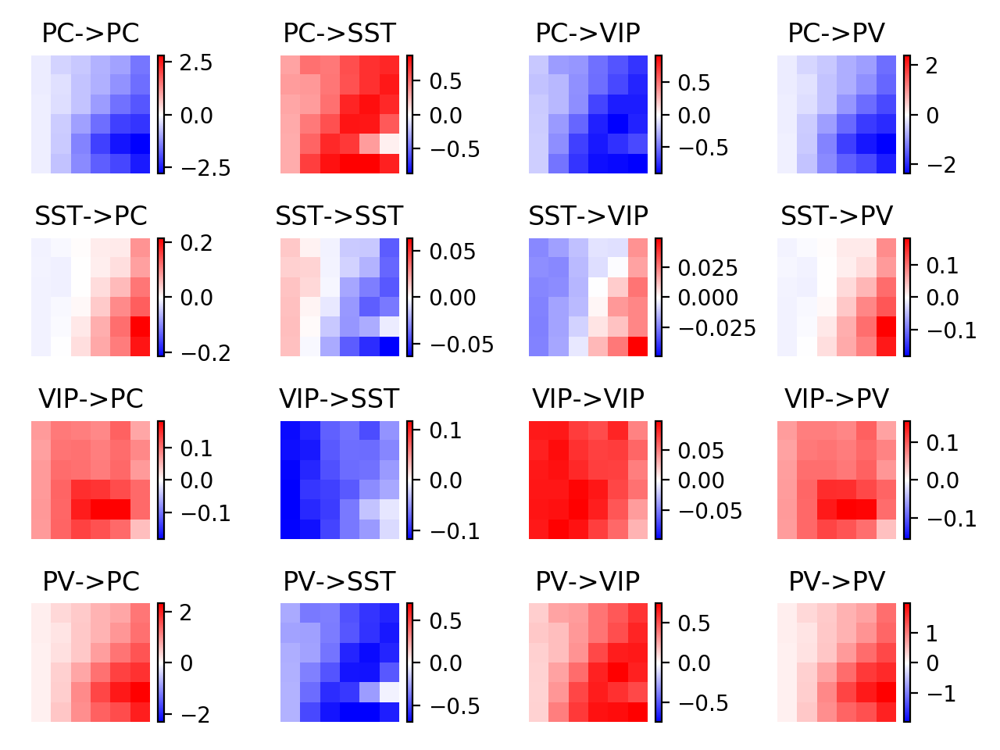

<IPython.core.display.Javascript object>


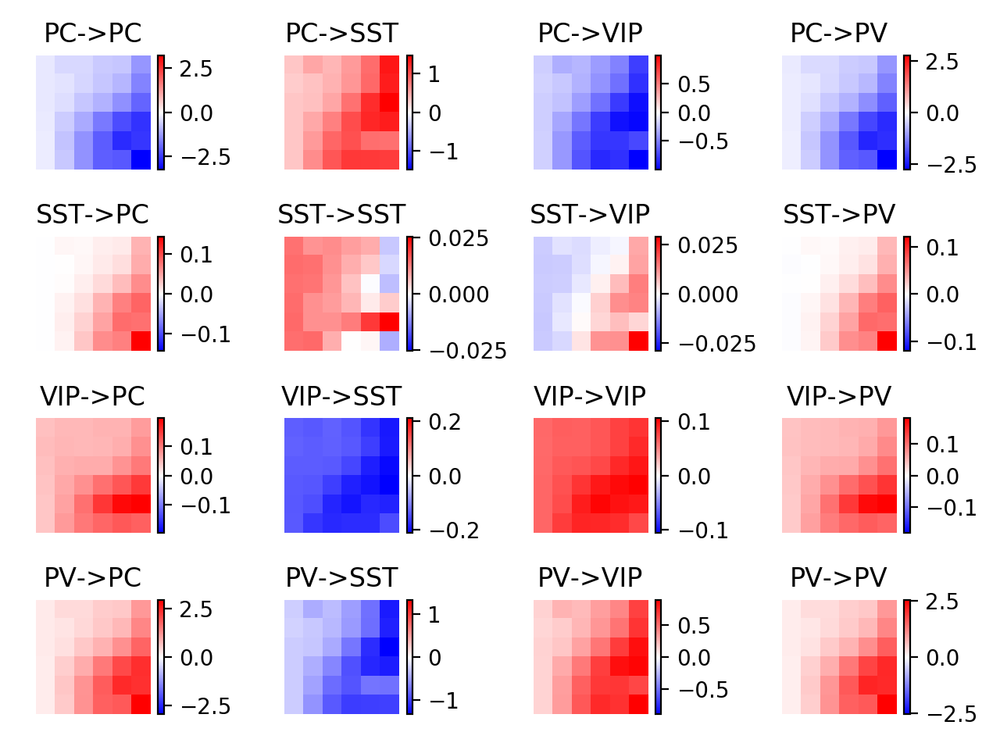

<IPython.core.display.Javascript object>


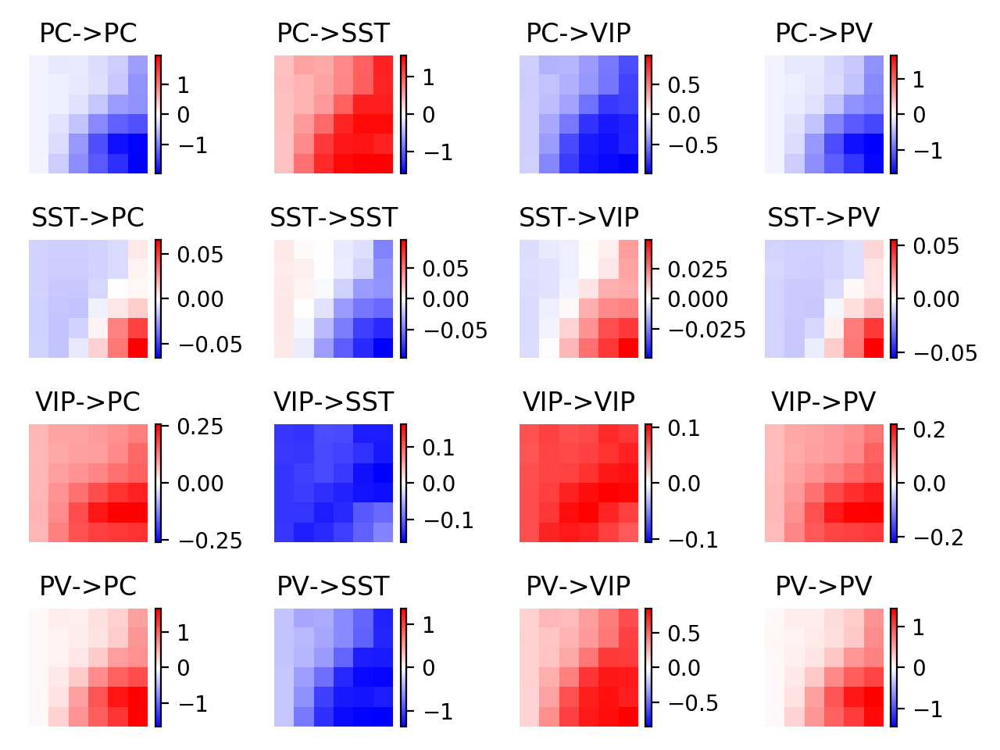

<IPython.core.display.Javascript object>


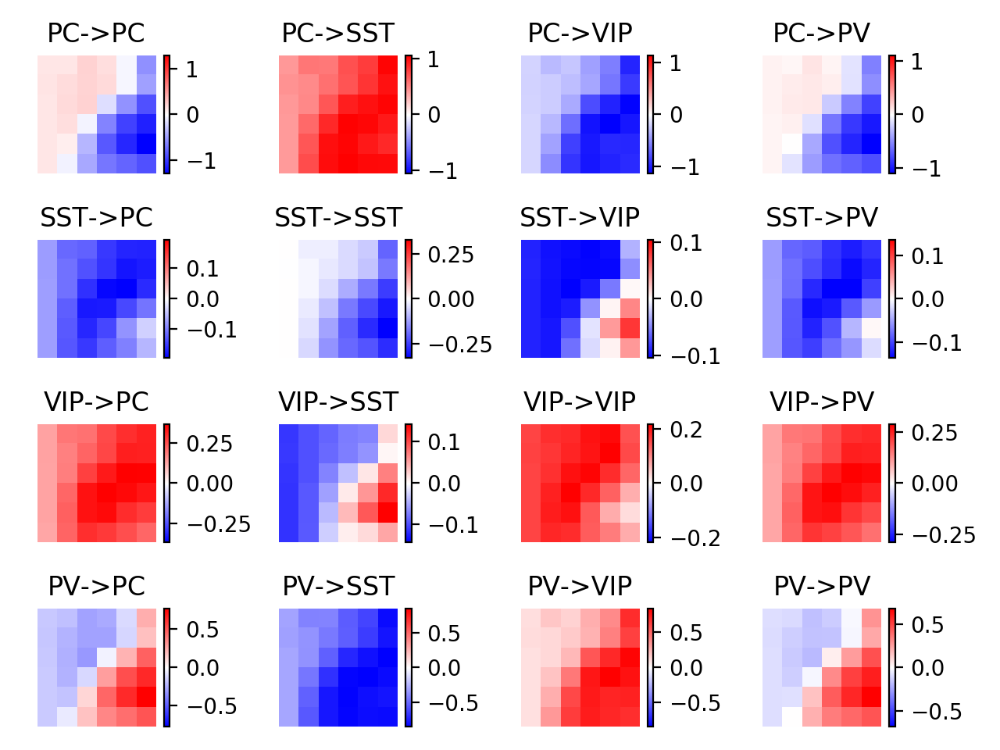

<IPython.core.display.Javascript object>


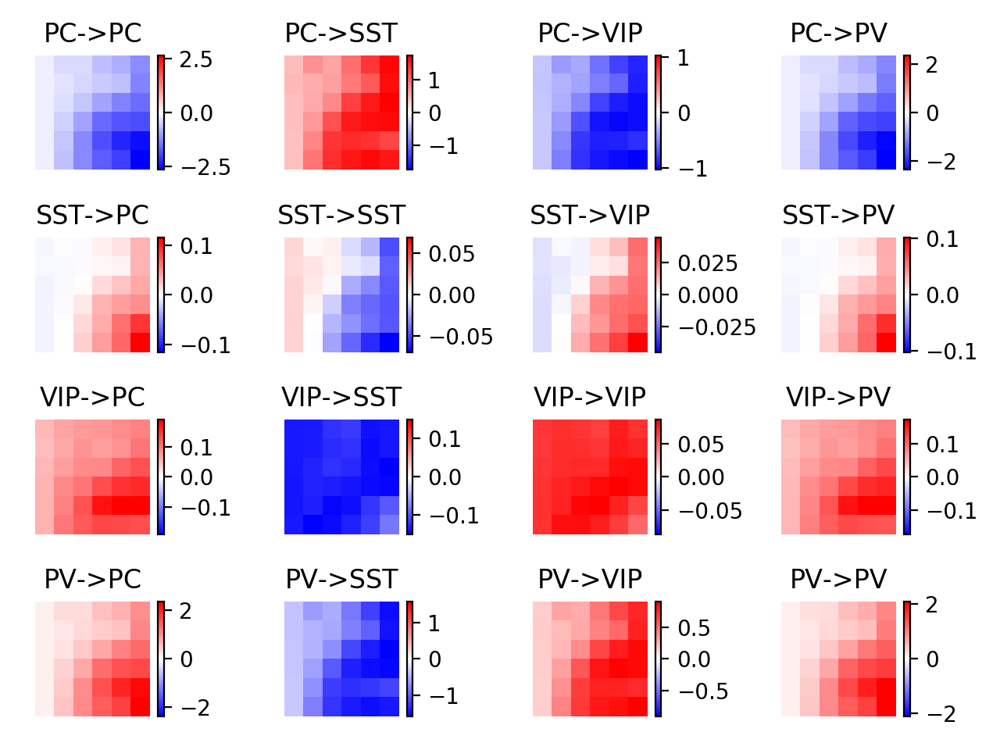

<IPython.core.display.Javascript object>


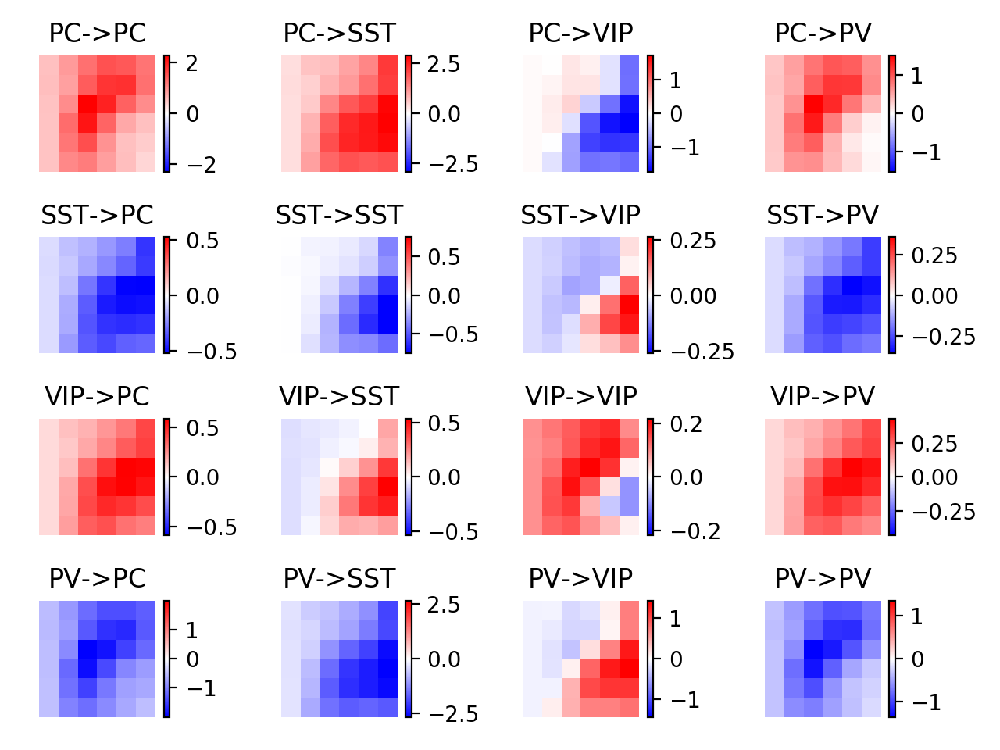

<IPython.core.display.Javascript object>


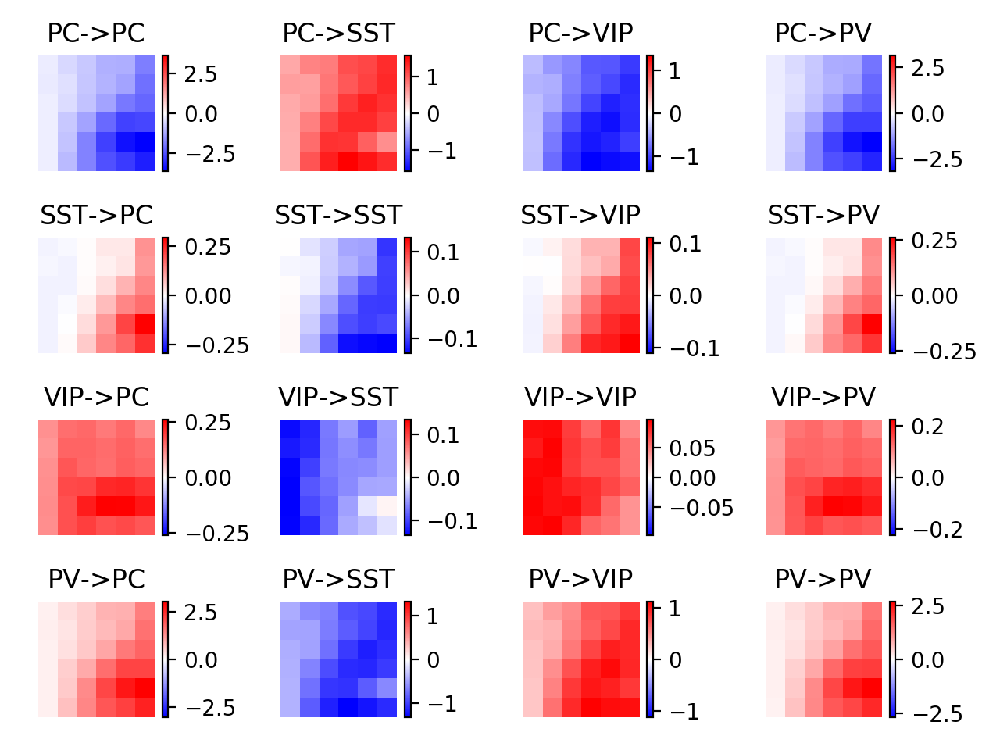

<IPython.core.display.Javascript object>


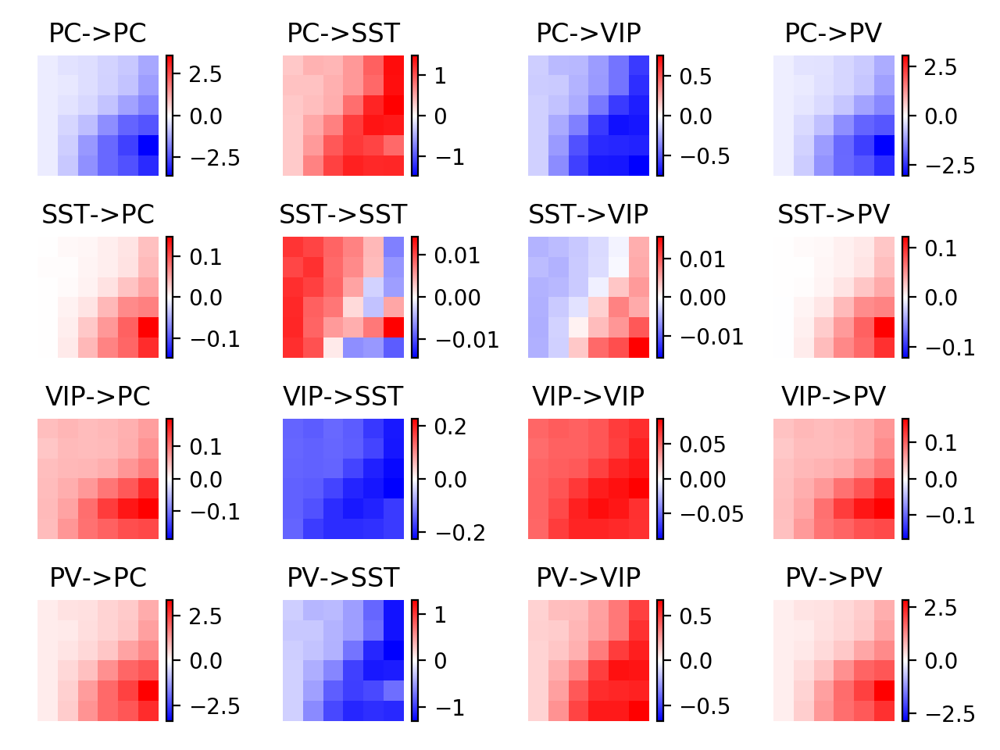

<IPython.core.display.Javascript object>


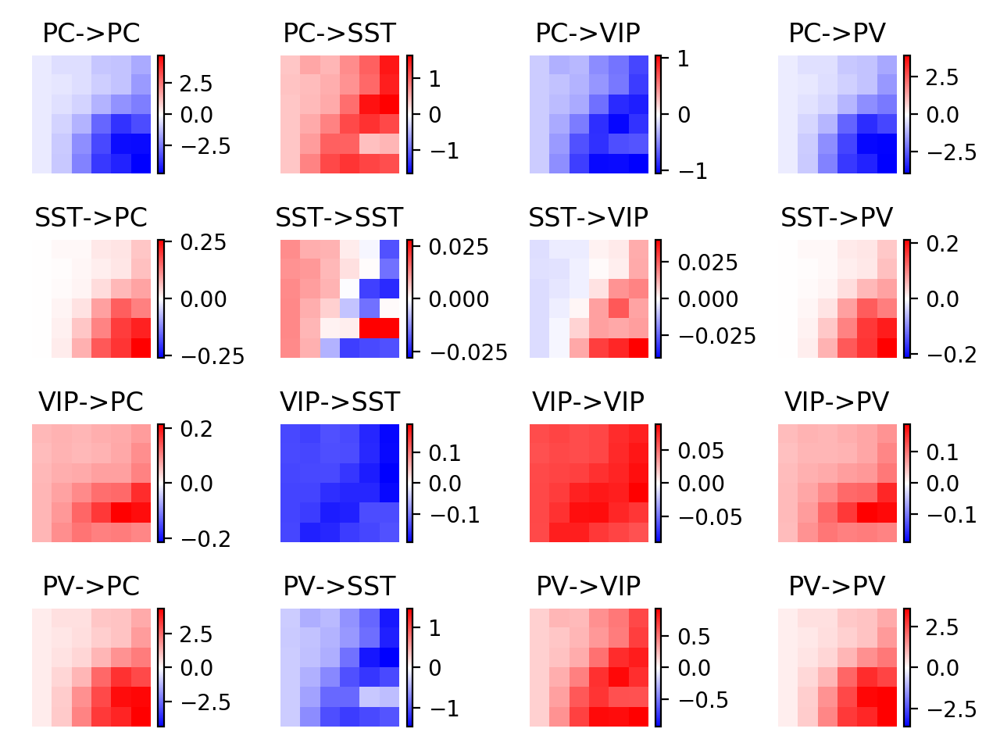

<IPython.core.display.Javascript object>


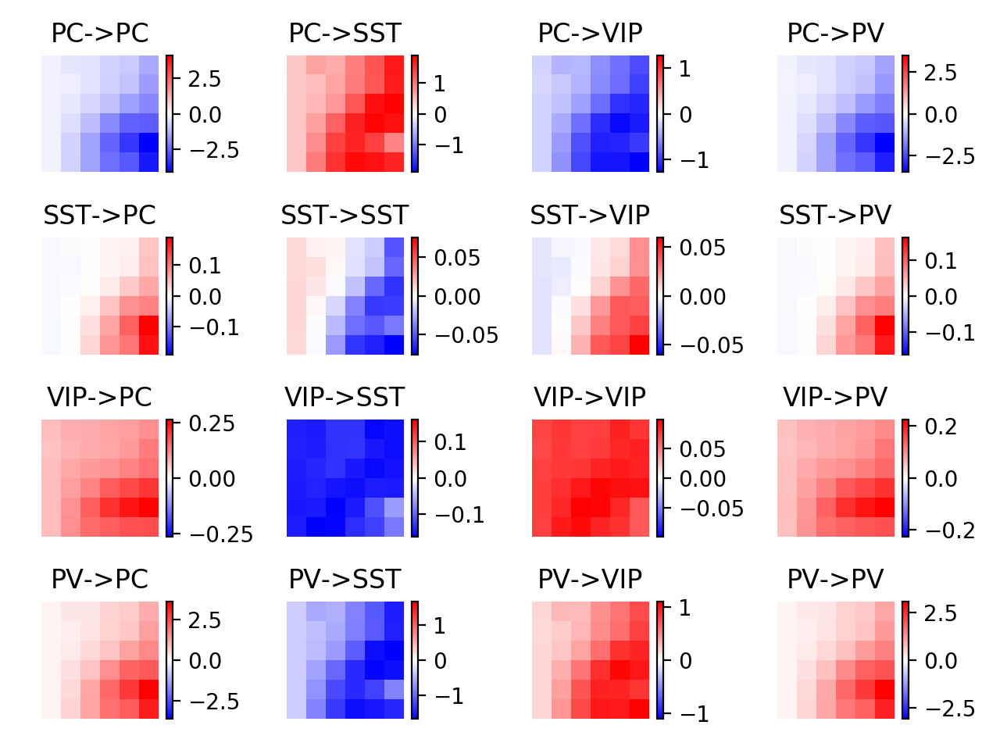

In [74]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,8+i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


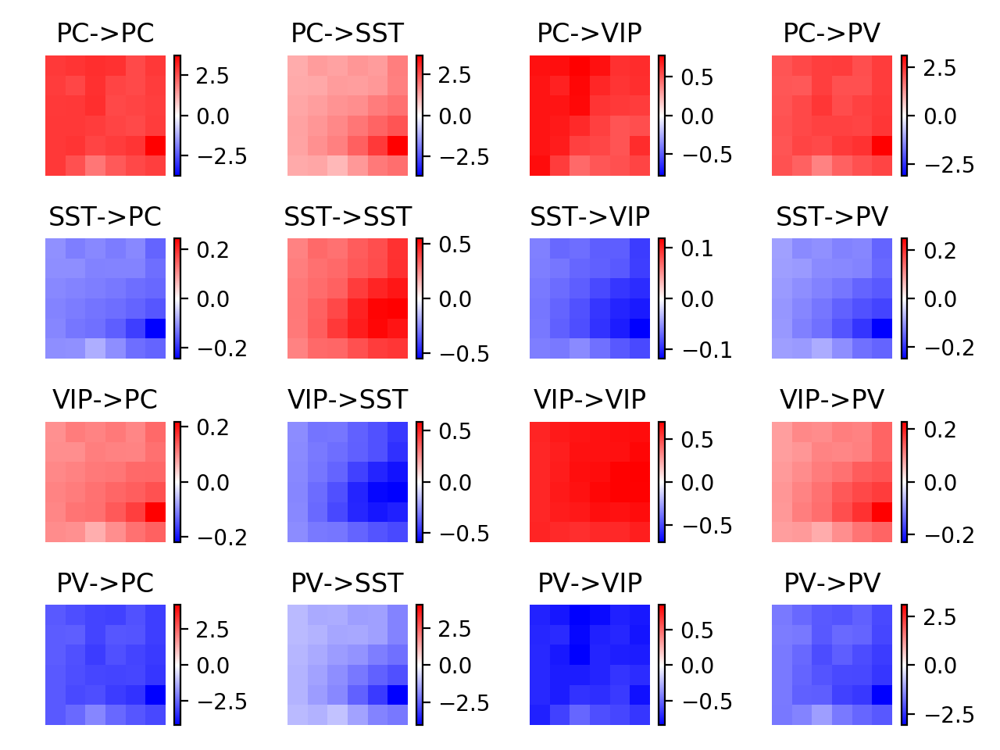

<IPython.core.display.Javascript object>


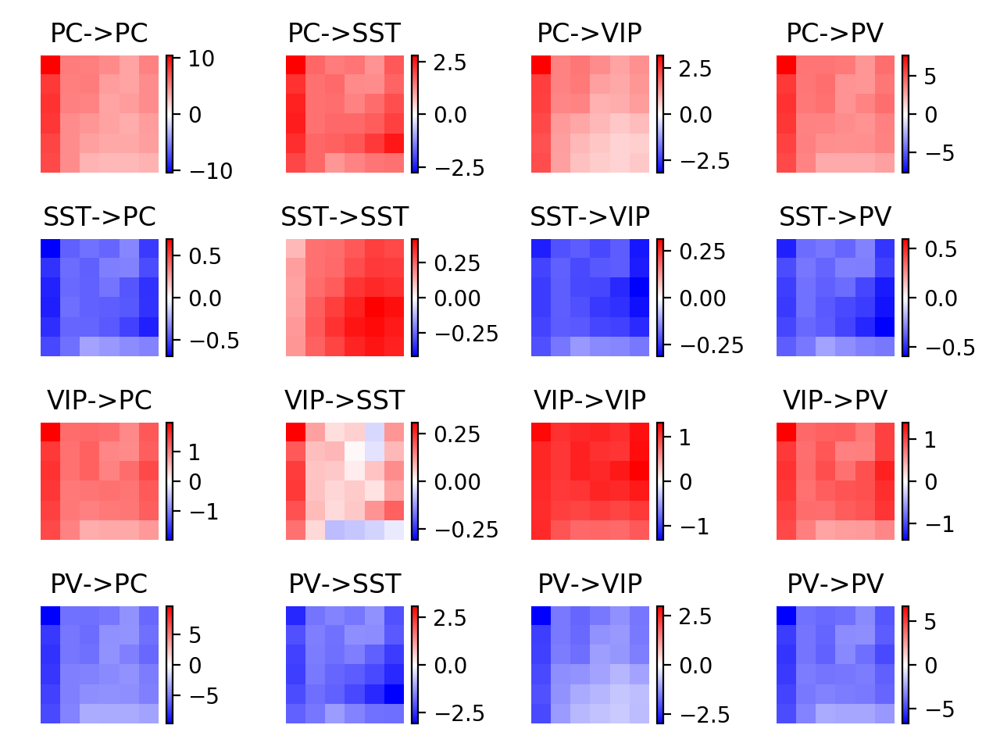

<IPython.core.display.Javascript object>


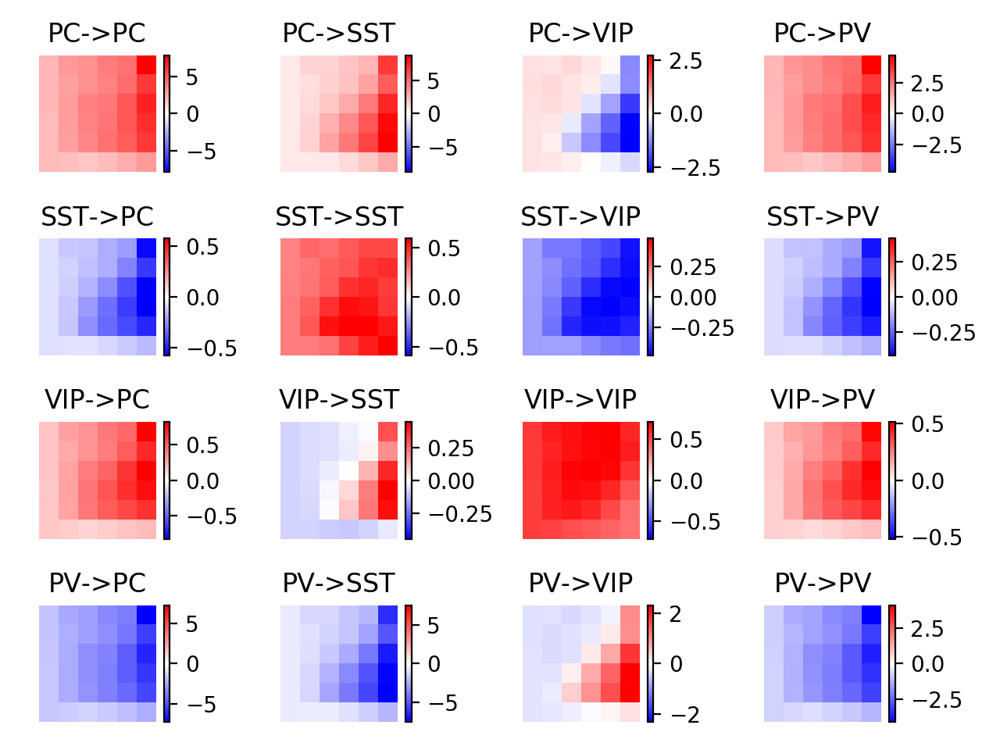

<IPython.core.display.Javascript object>


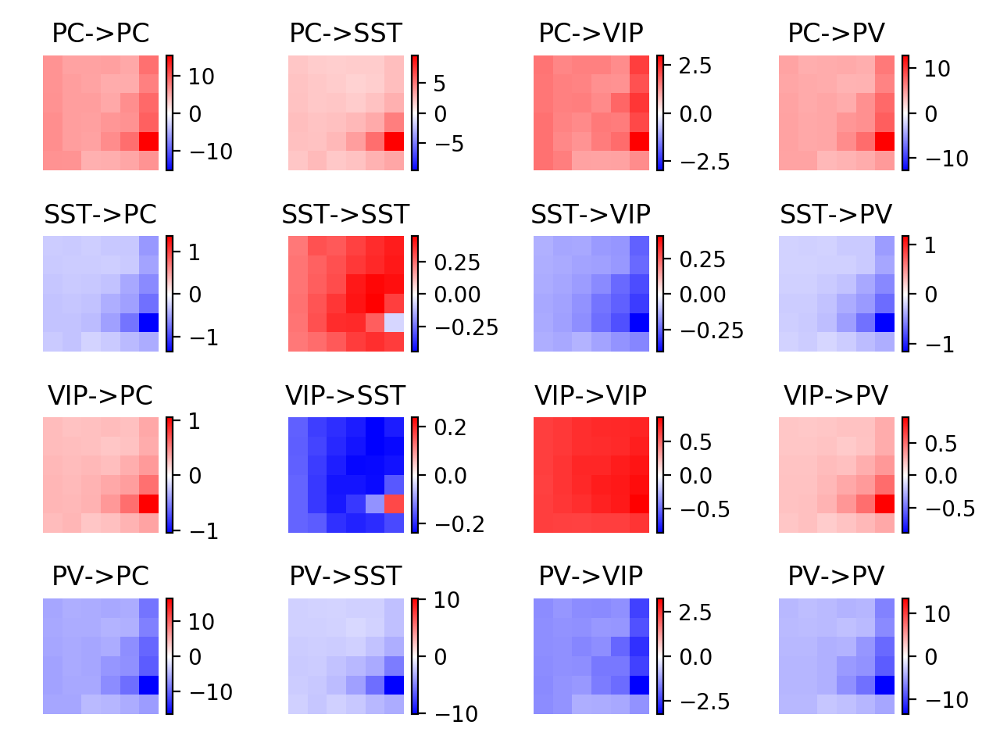

<IPython.core.display.Javascript object>


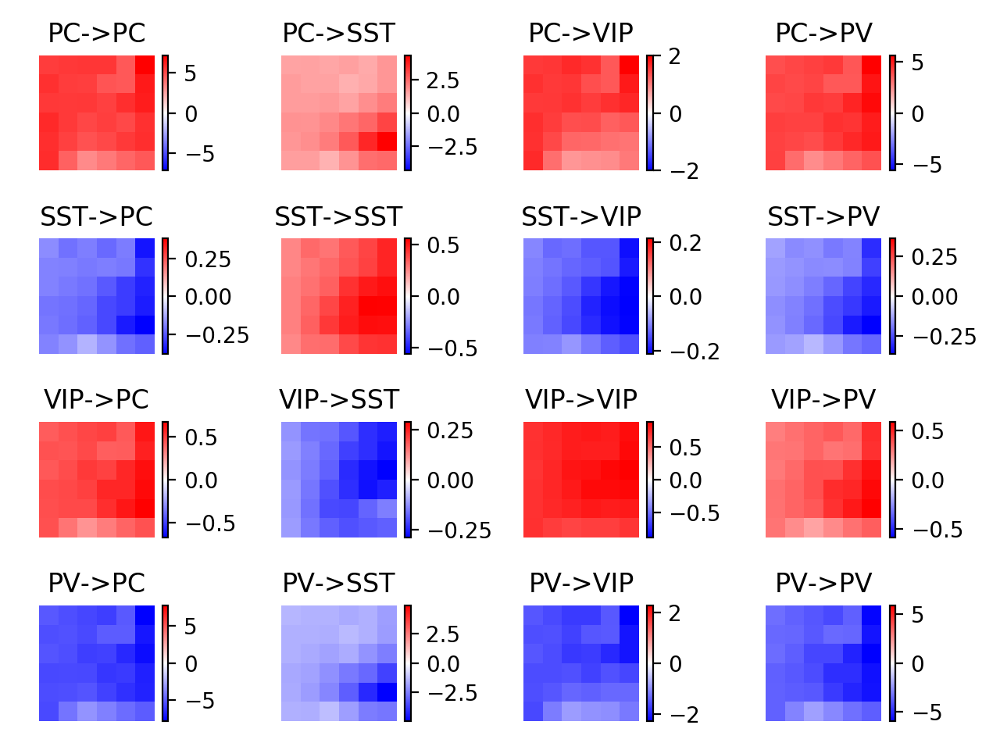

<IPython.core.display.Javascript object>


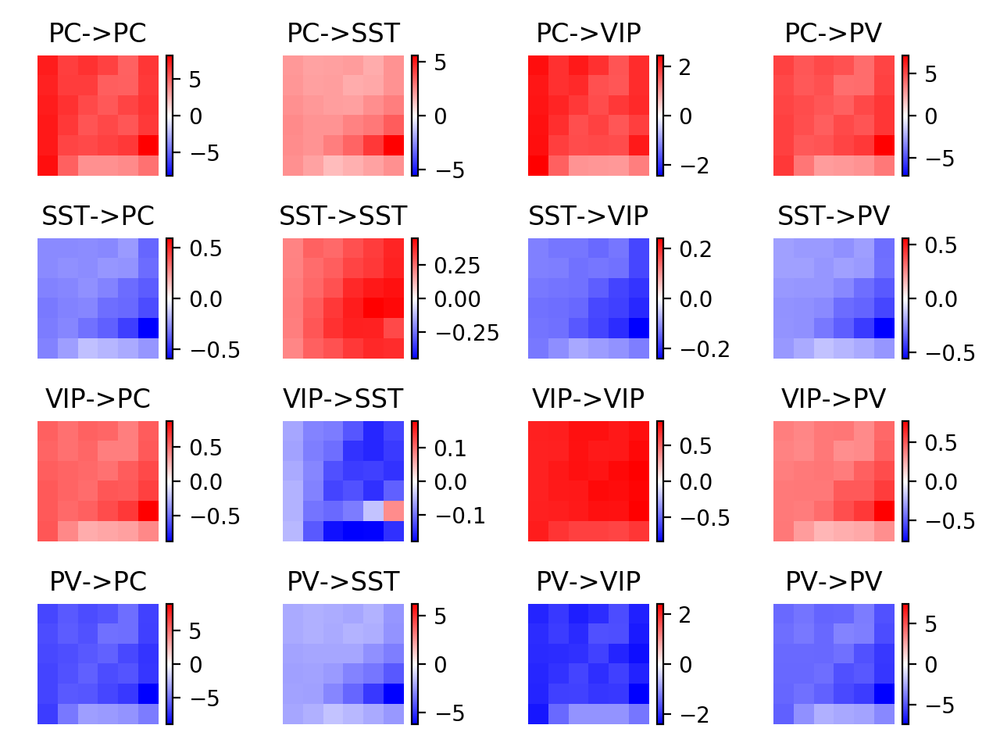

<IPython.core.display.Javascript object>


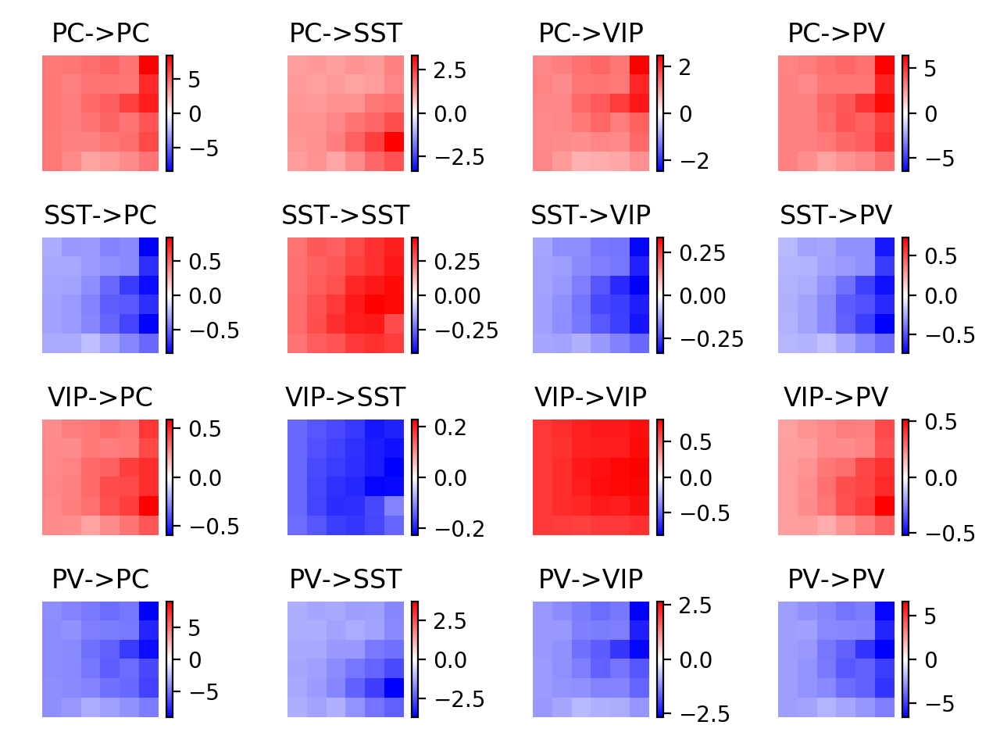

<IPython.core.display.Javascript object>


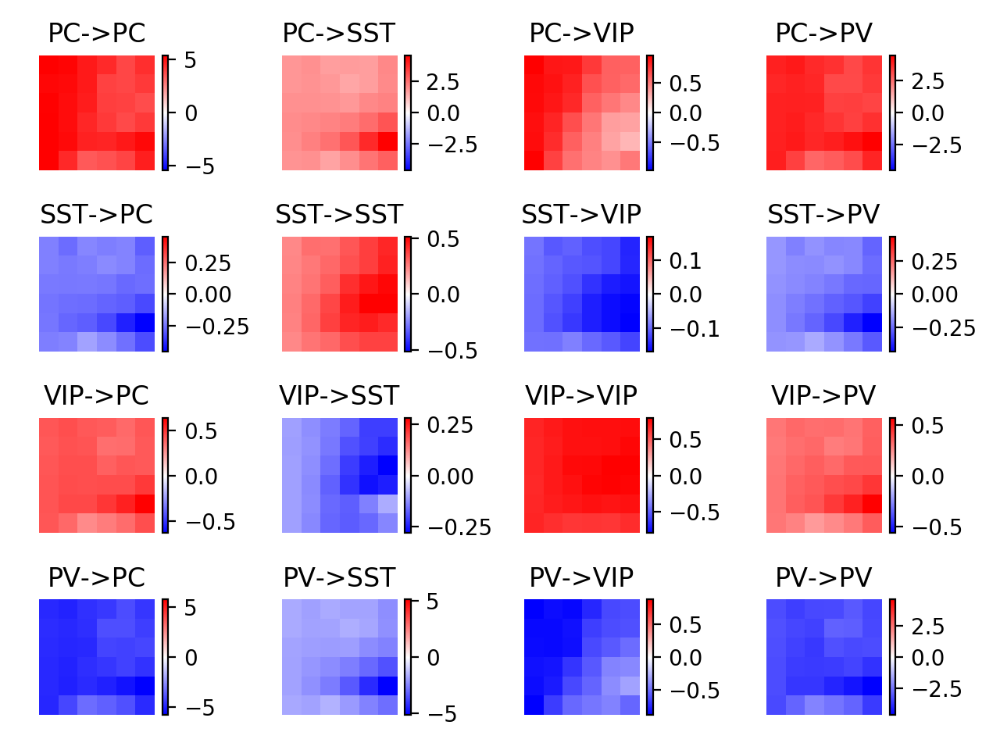

<IPython.core.display.Javascript object>


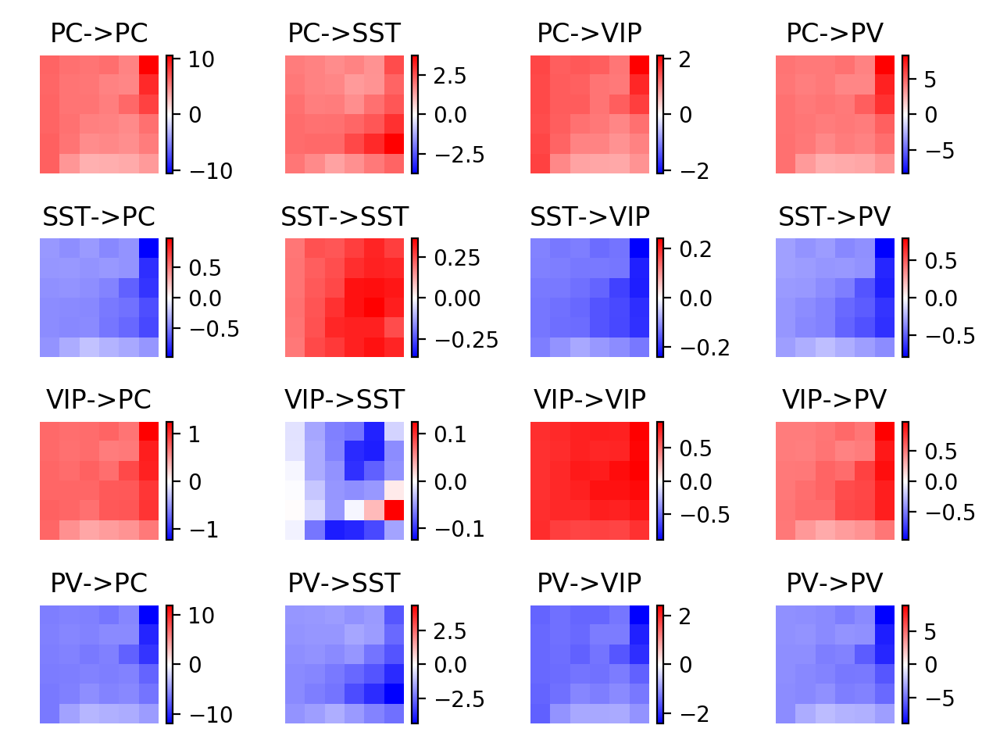

In [988]:
lbls = ['PC','SST','VIP','PV']
for iwt in range(len(weights_files)):
    plt.figure()
    for i1 in range(4):
        for i2 in range(4):
            plt.subplot(4,4,4*i1+i2+1)
            data = couplings[iwt][:,:,i1,i2]
            plt.imshow(data,cmap='bwr',vmin=-np.abs(data).max(),vmax=np.abs(data).max())
            plt.colorbar()
            plt.axis('off')
            plt.title('%s->%s'%(lbls[i1],lbls[i2]))
    plt.tight_layout()

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  


<IPython.core.display.Javascript object>


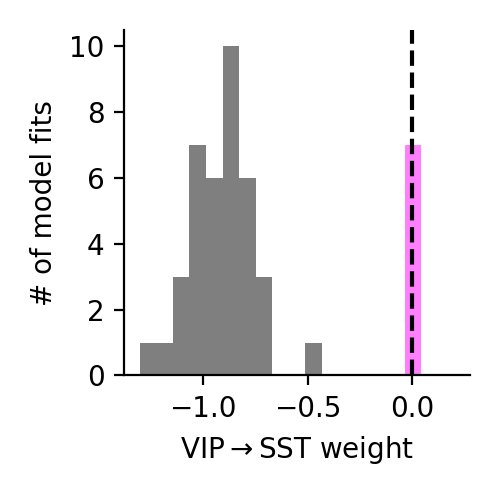

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


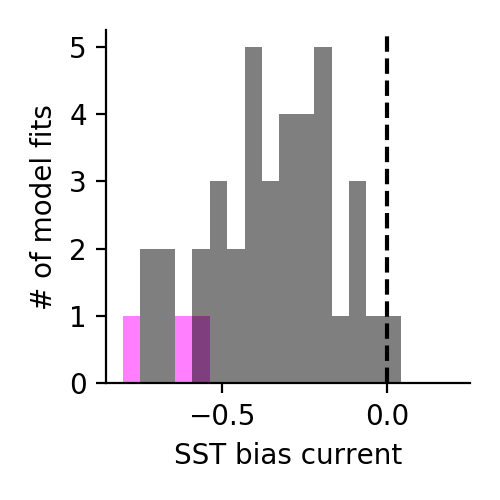

In [1425]:
cs = [np.array((1,0,1)),'','k']
plt.figure(figsize=(2.5,2.5))
for ifit in [0,2]:
    plt.hist(Wmys[ifit][low_loss[ifit]][:,2,1],alpha=0.5,bins=np.linspace(-1.3,0.2,20),facecolor=cs[ifit])
plt.axvline(0,c='k',linestyle='dashed')
plt.xlabel(r'VIP$\rightarrow$SST weight')
plt.ylabel('# of model fits')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/vip_sst_weight_allowed_disallowed.jpg',dpi=300)

plt.figure(figsize=(2.5,2.5))
for ifit in [0,2]:
    plt.hist(Wmxs[ifit][low_loss[ifit]][:,1,1],alpha=0.5,bins=np.linspace(-0.8,0.2,20),facecolor=cs[ifit])
plt.axvline(0,c='k',linestyle='dashed')
plt.xlabel('SST bias current')
plt.ylabel('# of model fits')
ut.erase_top_right()
plt.tight_layout()
plt.savefig('figures/sst_bias_vip_sst_weight_allowed_disallowed.jpg',dpi=300)

In [1373]:
ifit = 0
np.unique(Wmxs[ifit][low_loss[ifit]][:,1,1])

array([-0.78063768, -0.7746122 , -0.73437171])

In [759]:
titles[disp_order]

TypeError: list indices must be integers or slices, not list

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


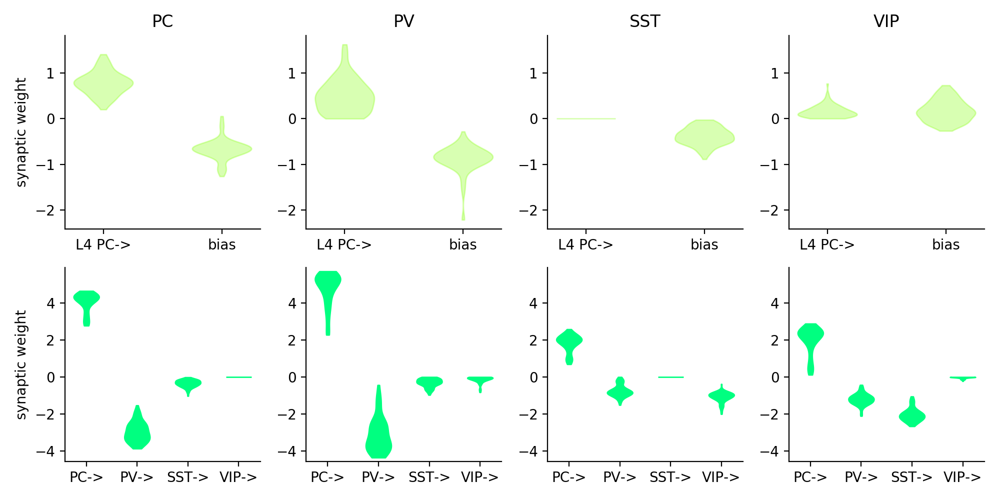

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:36: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:38: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


In [761]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(10,5))
for ifit in [0]:
    for datas in [[Wmxs[ifit][low_loss[ifit]],Wmys[ifit][low_loss[ifit]]]]:#,[Wsx,Wsy]]:
        titles = ['PC','SST','VIP','PV']
        data = datas[0]
        x = np.arange(1,data.shape[1]+1)
        xlbl = ['L4 PC->','bias']
        for icelltype in range(nQ):
            plt.subplot(2,nQ,icelltype+1)
            violin_parts = plt.violinplot([data[:,:,disp_order][:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
            for pc in violin_parts['bodies']:
                pc.set_facecolor([0.5,1,0.0])
                pc.set_edgecolor([0.5,1,0.0])
            plt.xticks(x,xlbl)
            plt.ylim(data.min()-0.2,data.max()+0.2)
            plt.title(titles[disp_order[icelltype]])
            ut.erase_top_right()
    #     plt.figure(figsize=(7.5,2))
        data = datas[1]
        x = np.arange(1,data.shape[1]+1)
        xlbl = ['PC->','SST->','VIP->','PV->']
        for icelltype in range(nQ):
            plt.subplot(2,nQ,nQ+icelltype+1)
    #         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
            violin_parts = plt.violinplot([data[:,disp_order][:,:,disp_order][:,i,icelltype] for i in range(data.shape[1])],showextrema=False)
            for pc in violin_parts['bodies']:
                pc.set_facecolor([0.0,1,0.5])
                pc.set_edgecolor([0.0,1,0.5])
                pc.set_alpha(1)
            plt.xticks(x,[xlbl[do] for do in disp_order])
            plt.ylim(data.min()-0.2,data.max()+0.2)
            ut.erase_top_right()
    #         plt.title(titles[icelltype])
        plt.subplot(2,4,1)
        plt.ylabel('synaptic weight')
        plt.subplot(2,4,5)
        plt.ylabel('synaptic weight')
        plt.tight_layout()
plt.savefig('figures/violinplots_fit_weights.jpg',dpi=300)

In [78]:
disp_order = [0,3,1,2]
plt.figure(figsize=(2.5,2.5))
data = np.mean(Wmys[ifit][low_loss[ifit]],0)[disp_order][:,disp_order]
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks(np.arange(4),[lbls[i] for i in disp_order])
plt.ylim(3.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
# plt.savefig('figures/Wmy_heatmap.eps')

<IPython.core.display.Javascript object>

NameError: name 'lbls' is not defined

In [32]:
np.mean(Wmys[lkat],0)[disp_order][:,disp_order]

array([[0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.],
       [0., 0., 0., 0.]])

<IPython.core.display.Javascript object>


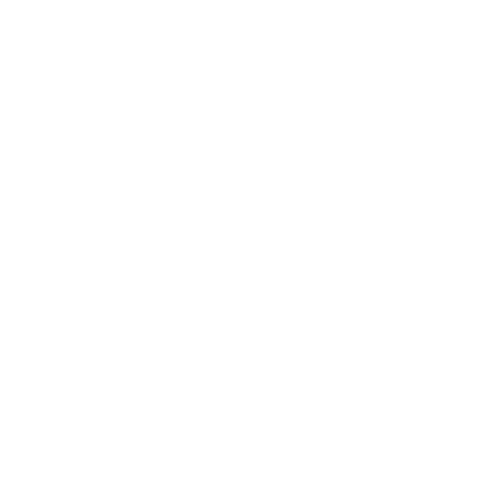

TypeError: only integer scalar arrays can be converted to a scalar index

In [79]:
lbls = ['PC','SST','VIP','PV']
plt.figure(figsize=(2.5,2.5))
data = np.concatenate((np.mean(Wmys[lkat],0)[disp_order][:,disp_order],np.mean(Wmxs[lkat],0)[0:1][:,disp_order]),axis=0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks(np.arange(5),[lbls[i] for i in disp_order]+['L4 PC'])
plt.ylim(4.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
# plt.savefig('figures/Wmy_extended_heatmap_no_opto.eps')

In [80]:
Wmys[lkat].shape

TypeError: only integer scalar arrays can be converted to a scalar index

In [942]:
np.mean(Wmys[ifit][low_loss[ifit]],0).shape

(4, 4)

<IPython.core.display.Javascript object>


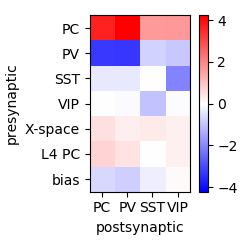

In [335]:
ifit = -1
plt.figure(figsize=(2.5,2.5))
data = np.concatenate((np.mean(Wmys[ifit][low_loss[ifit]],0)[disp_order][:,disp_order],np.mean(Ks[ifit][low_loss[ifit]],0)[np.newaxis,disp_order],np.mean(Wmxs[ifit][low_loss[ifit]],0)[:,disp_order]),axis=0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks(np.arange(7),[lbls[i] for i in disp_order]+['X-space','L4 PC','bias'])
plt.ylim(6.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
plt.savefig('figures/Wmy_very_extended_heatmap_no_opto.eps')

<IPython.core.display.Javascript object>


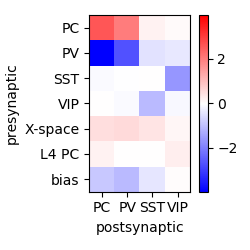

In [350]:
ifit = -1
plt.figure(figsize=(2.5,2.5))
data = np.concatenate((Wmys[ifit][np.nanargmin(losses[ifit])][disp_order][:,disp_order],Ks[ifit][np.nanargmin(low_loss[ifit])][np.newaxis,disp_order],Wmxs[ifit][np.nanargmin(low_loss[ifit])][:,disp_order]),axis=0)
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks(np.arange(7),[lbls[i] for i in disp_order]+['X-space','L4 PC','bias'])
plt.ylim(6.5,-0.5)
plt.colorbar()
plt.xlabel('postsynaptic')
plt.ylabel('presynaptic')
plt.tight_layout()
plt.savefig('figures/Wmy_very_extended_heatmap_no_opto_example.eps')

In [351]:
losses[ifit][np.nanargmin(losses[ifit])]

20.556401880997786

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """Entry point for launching an IPython kernel.


<IPython.core.display.Javascript object>


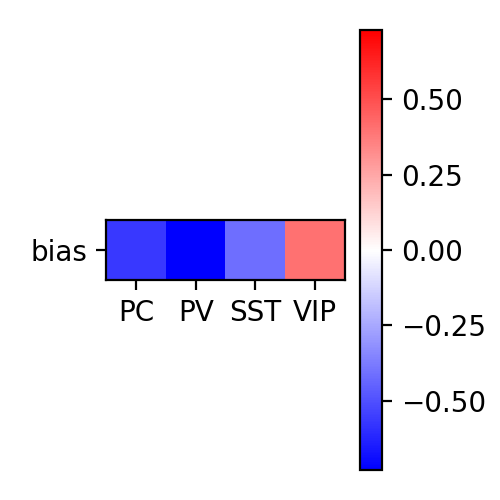

In [948]:
plt.figure(figsize=(2.5,2.5))
data = np.mean(Wmxs[ifit][low_loss[ifit]],0)[1:2][:,disp_order]
mx = np.max(np.abs(data))
plt.imshow(data,cmap='bwr',vmin=-mx,vmax=mx)
plt.xticks(np.arange(4),[lbls[i] for i in disp_order])
plt.yticks([0],['bias'])
plt.ylim(0.5,-0.5)
plt.colorbar()
# plt.xlabel('postsynaptic')
# plt.ylabel('presynaptic')
plt.tight_layout()
# plt.savefig('figures/bias_heatmap.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:3: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  This is separate from the ipykernel package so we can avoid doing imports until


<IPython.core.display.Javascript object>


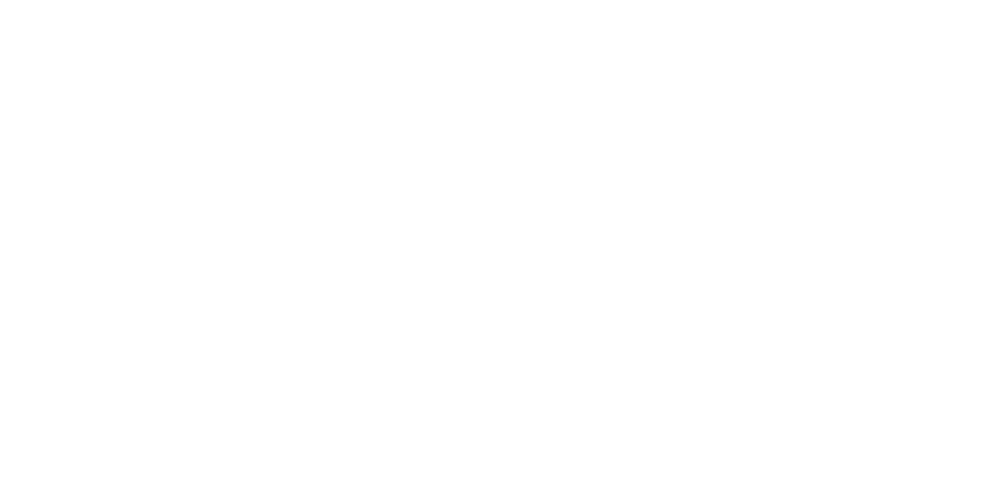

NameError: name 'Ts' is not defined

In [949]:
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
plt.figure(figsize=(5,2.5))
ylbls = ['cross-space weight','cross-orientation weight']
colors = [[1,0.5,0.5],[0.5,0,0.5]]
for idata,data in enumerate([Ks,Ts]):#,[Wsx,Wsy]]:
#     titles = ['PC','SST','VIP','PV']
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC','SST','VIP','PV']
    plt.subplot(1,2,idata+1)
#     for icelltype in range(nQ)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
    violin_parts = plt.violinplot([data[:,icelltype] for icelltype in range(data.shape[1])],showextrema=False)
    for pc in violin_parts['bodies']:
        pc.set_facecolor(colors[idata])
        pc.set_edgecolor(colors[idata])
        pc.set_alpha(1)
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.ylabel(ylbls[idata])
plt.tight_layout()
#         plt.title(titles[icelltype])
# plt.savefig('figures/violinplots_fit_k_t.jpg',dpi=300)

In [655]:
np.concatenate([np.arange(this_nS*this_nT*this_ncelltypes).reshape((1,this_nS,this_nT,this_ncelltypes))[0,:,iT].reshape((1,-1)) for iT in range(this_nT)],axis=0)

array([[ 0,  1,  2,  3,  8,  9, 10, 11],
       [ 4,  5,  6,  7, 12, 13, 14, 15]])

In [672]:
import os
npyfile_chrimson = np.load('../shared_data/calnet_data/vip_chrimson_data_for_sim.npy',allow_pickle=True)[()]
npyfile_halo = np.load('../shared_data/calnet_data/vip_halo_data_for_sim_vip_full_info.npy',allow_pickle=True)[()]

In [696]:
npyfile_halo['Yhat_orig'][0].shape

AttributeError: 'list' object has no attribute 'shape'

In [692]:
npyfile_halo['scallanimal_aligned'].shape

(6, 4, 6, 8, 2)

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:4: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  after removing the cwd from sys.path.


<IPython.core.display.Javascript object>


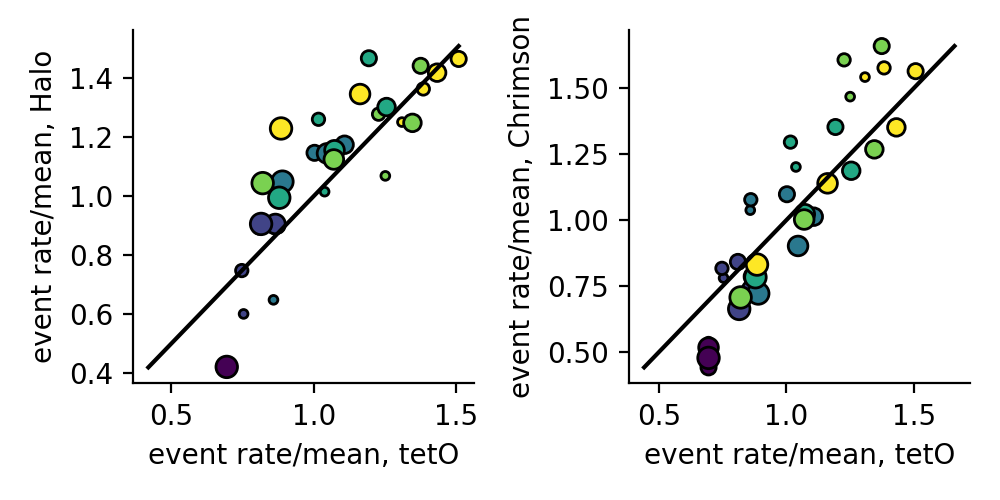

In [690]:
xdata = npyfile_halo['Yhat_opto'][0::2,0]/np.nanmean(npyfile_halo['Yhat_opto'][0::2,0])
ydata = npyfile_chrimson['Yhat_opto'][0::2,0]/np.nanmean(npyfile_chrimson['Yhat_opto'][0::2,0])
zdata = YYhat[:,0]/np.nanmean(YYhat[:,0])
plt.figure(figsize=(5,2.5))
plt.subplot(1,2,1)
sca.scatter_size_contrast(zdata,xdata,nsize=6,ncontrast=6)#,equality_line=False,square=False)
ut.erase_top_right()
plt.xlabel('event rate/mean, tetO')
plt.ylabel('event rate/mean, Halo')
plt.subplot(1,2,2)
sca.scatter_size_contrast(zdata,ydata,nsize=6,ncontrast=6)#,equality_line=False,square=False)
ut.erase_top_right()
plt.xlabel('event rate/mean, tetO')
plt.ylabel('event rate/mean, Chrimson')
plt.tight_layout()
plt.savefig('figures/vip_halo_chrimson_comparison_to_teto.eps')

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:12: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  if sys.path[0] == '':


<IPython.core.display.Javascript object>


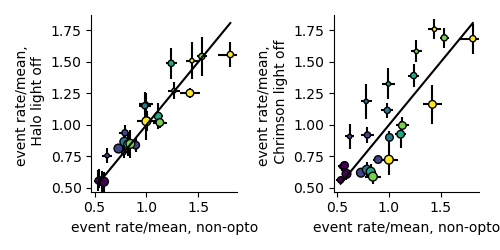

In [744]:
#rsexpt: [irun][itype][ialign]
reload(ut)
def compute_xdata(npyfile):
    this_data = np.nanmean(npyfile['scallanimal_aligned'][:,:,:,:,0],3)
    mn = np.nanmean(np.nanmean(this_data,1),1)[:,np.newaxis,np.newaxis]
    return this_data/mn
xdata = compute_xdata(npyfile_halo)
ydata = compute_xdata(npyfile_chrimson)
# zdata = (YYhat[:,0]/np.nanmean(YYhat[:,0])).reshape((1,6,6))
zdata = np.nanmean(rsexpt[0][1][0],3)
zdata = ut.interp_axis(zdata,axis=1,usize=np.logspace(np.log10(5),np.log10(60),6),desired_usize=np.logspace(np.log10(5),np.log10(60),4))
plt.figure(figsize=(5,2.5))
plt.subplot(1,2,1)
sca.scatter_size_contrast_errorbar(zdata,xdata,nsize=4,ncontrast=6)#,equality_line=False,square=False)
ut.erase_top_right()
plt.xlabel('event rate/mean, non-opto')
plt.ylabel('event rate/mean, \n Halo light off')
plt.subplot(1,2,2)
sca.scatter_size_contrast_errorbar(zdata,ydata,nsize=4,ncontrast=6)#,equality_line=False,square=False)
ut.erase_top_right()
plt.xlabel('event rate/mean, non-opto')
plt.ylabel('event rate/mean, \n Chrimson light off')
plt.tight_layout()
# plt.savefig('figures/vip_halo_chrimson_comparison_to_teto_errorbars.eps')

In [747]:
for this_data in [xdata,ydata]:
    slope, intercept, r_value, p_value, std_err = sst.linregress(np.nanmean(this_data,0).flatten(), np.nanmean(zdata,0).flatten())
    print((r_value,p_value))

(0.9461952887027048, 2.936262379786522e-12)
(0.8389329333656581, 3.0341326760515356e-07)


In [731]:
len(rsexpt[0][0][0])

TypeError: object of type 'NoneType' has no len()

In [717]:
pdb.pm()

> /Users/dan/Documents/code/adesnal/pyute.py(1989)interp_axis()
-> slc[i_non_axis] = np.unravel_index(iflat,shp_non_axis)
(Pdb) i_non_axis
array([0, 2])
(Pdb) slc[i_non_axis]
*** TypeError: only integer scalar arrays can be converted to a scalar index
(Pdb) slc[list(i_non_axis)]
*** TypeError: list indices must be integers or slices, not list
(Pdb) exit


In [699]:
zdata.reshape((1,6,6))[:,[0,2,3,5]].shape

(1, 4, 6)

In [656]:
this_nS,this_nT,this_ncelltypes = 2,2,4
[np.unravel_index(iel,(this_nS,this_nT,this_ncelltypes)) for iel in range(16)]

[(0, 0, 0),
 (0, 0, 1),
 (0, 0, 2),
 (0, 0, 3),
 (0, 1, 0),
 (0, 1, 1),
 (0, 1, 2),
 (0, 1, 3),
 (1, 0, 0),
 (1, 0, 1),
 (1, 0, 2),
 (1, 0, 3),
 (1, 1, 0),
 (1, 1, 1),
 (1, 1, 2),
 (1, 1, 3)]

<IPython.core.display.Javascript object>


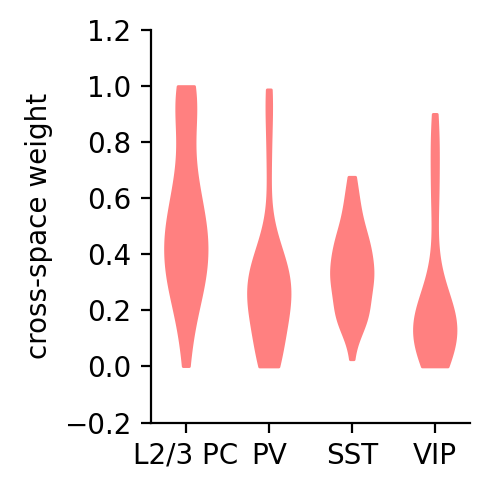

<IPython.core.display.Javascript object>


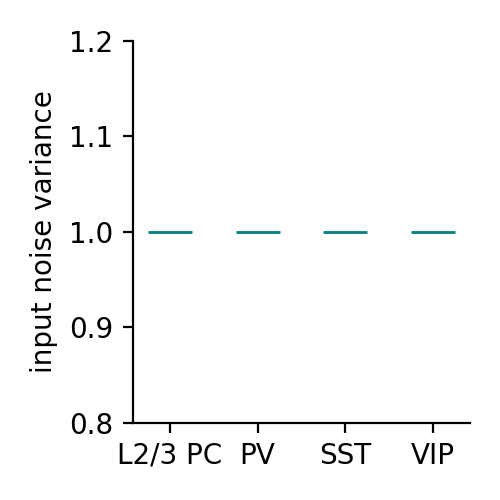

<IPython.core.display.Javascript object>


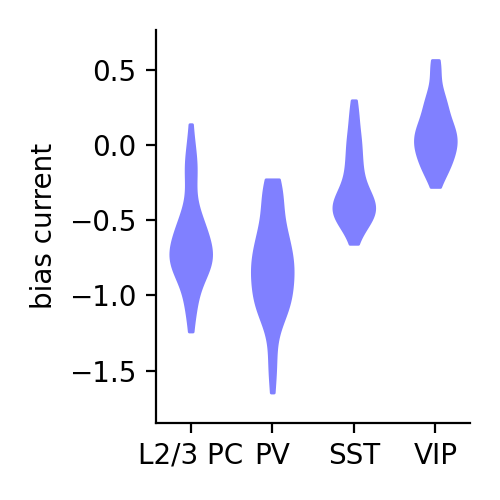

<IPython.core.display.Javascript object>


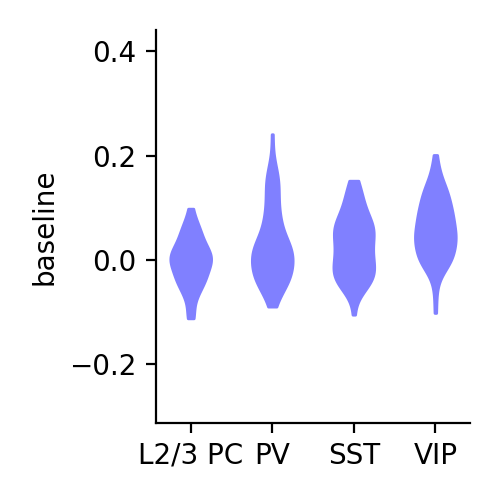

In [84]:
ifit = -1
# ws = [np.concatenate([w[q][np.newaxis] for w in np.concatenate(Wt)],axis=0) for q in range(len(Wt[0][0]))]
# [Wmx,Wmy,Wsx,Wsy,s02,k,kappa,XX,YY,Eta,Xi] = ws
ylbls = ['cross-space weight','input noise variance','bias current','baseline']
titles = ['figures/violinplots_fit_k_pre_opto.jpg','figures/violinplots_fit_s02_pre_opto.jpg','figures/violinplots_fit_bias_pre_opto.jpg','figures/violinplots_fit_bls_pre_opto.jpg']
colors = [[1,0.5,0.5],[0,0.5,0.5],[0.5,0.5,1],[0.5,0.5,1]]
for idata,data in enumerate([Ks[ifit][low_loss[ifit]][:,disp_order],s02s[ifit][low_loss[ifit]][:,disp_order],Wmxs[ifit][low_loss[ifit]][:,1,:][:,disp_order],bls[ifit][low_loss[ifit]][:,disp_order]]):#,[Wsx,Wsy]]:
    plt.figure(figsize=(2.5,2.5))
#     titles = ['PC','SST','VIP','PV']
    x = np.arange(1,data.shape[1]+1)
    xlbl = ['L2/3 PC','SST','VIP','PV']
    xlbl = [xlbl[i] for i in disp_order]
#     plt.subplot(1,2,idata+1)
#     for icelltype in range(nQ)
#         plt.violinplot([data[:,i,icelltype] for i in range(data.shape[1])])
    violin_parts = plt.violinplot([data[:,icelltype] for icelltype in range(data.shape[1])],showextrema=False)
    for pc in violin_parts['bodies']:
        pc.set_facecolor(colors[idata])
        pc.set_edgecolor(colors[idata])
        pc.set_alpha(1)
    plt.xticks(x,xlbl)
    plt.ylim(data.min()-0.2,data.max()+0.2)
    plt.ylabel(ylbls[idata])
    plt.tight_layout()
    #         plt.title(titles[icelltype])
    ut.erase_top_right()
    plt.savefig(titles[idata],dpi=300)


In [902]:
Ks[ifit][low_loss[ifit]][:,disp_order].shape

(39, 4)

In [901]:
Wmxs[ifit][low_loss[ifit]][:,1,:]

[0, 3, 1, 2]

In [779]:
iwt = 5
i1,i2 = 0,0
# data = couplings[iwt][:,8+i1,i2].reshape((6,6))
data = np.nanmean(couplings[:,:,:,8+i1,i2],0)
mx = np.max(np.abs(data))
plt.figure(figsize=(2.5,2.5))
sca.show_size_contrast(data,cmap='bwr',vmin=-mx,vmax=mx,flipud=True)
plt.title('far PC -> near PC coupling')
plt.colorbar()
# plt.savefig('figures/far_pc_near_pc_coupling_tuning.eps')


IndexError: index 8 is out of bounds for axis 3 with size 8

/opt/anaconda3/envs/py3/lib/python3.6/site-packages/ipykernel_launcher.py:5: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  """


<IPython.core.display.Javascript object>


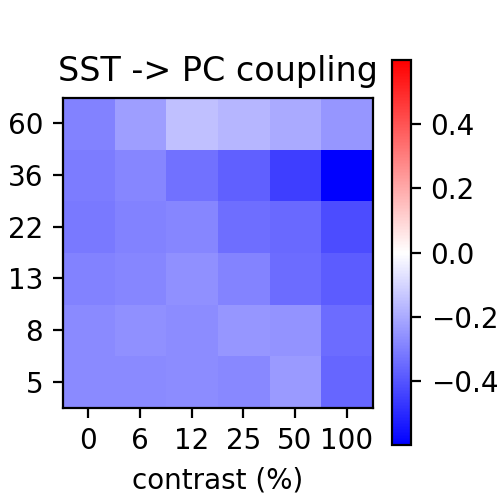

In [987]:
iwt = 5
i1,i2 = 1,0
data = couplings[iwt][:,:,i1,i2]
mx = np.max(np.abs(data))
plt.figure(figsize=(2.5,2.5))
sca.show_size_contrast(data,cmap='bwr',vmin=-mx,vmax=mx,flipud=True)
plt.title('SST -> PC coupling')
plt.colorbar()
# plt.savefig('figures/sst_pc_coupling_tuning.eps')